# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [19]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

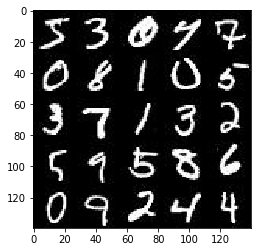

In [20]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

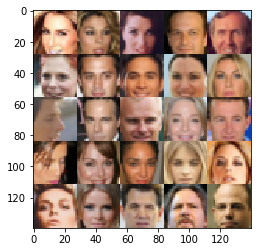

In [21]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [22]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [105]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function

    inputs_real=tf.placeholder(tf.float32,[None,image_width,image_height,image_channels],name='inputs_real')
    inputs_z = tf.placeholder(tf.float32,[None,z_dim],name='inputs_z')
    learning_rate=tf.placeholder(tf.float32,name="l_rate")
    return inputs_real,inputs_z,learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [106]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    #input is 28x28x3
    alpha=.2
    
    with tf.variable_scope('discriminator',reuse=reuse):
        
        x1=tf.layers.conv2d(images,64,5,strides=2,padding='same',activation=None)
        x1=tf.maximum(alpha*x1,x1)
        # 14x14x64
        
        x2=tf.layers.conv2d(x1,128,5,strides=2,padding='same',activation=None)
        x2=tf.layers.batch_normalization(x2,training=True)
        x2=tf.maximum(alpha*x2,x2)
        # 7x7x128

        x3=tf.layers.conv2d(x2,256,5,strides=2,padding='same',activation=None)
        x3=tf.layers.batch_normalization(x3,training=True)
        x3=tf.maximum(alpha*x3,x3)
        # 3x3x256

        x4=tf.layers.conv2d(x3,512,5,strides=2,padding='same',activation=None)
        x4=tf.layers.batch_normalization(x4,training=True)
        x4=tf.maximum(alpha*x4,x4)

        x3_flat=tf.reshape(x4,(-1,2*2*512))
        logits=tf.layers.dense(x3_flat,1)
        out=tf.nn.sigmoid(logits)
        
    return out,logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [109]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    alpha=.2
    with tf.variable_scope('generator',reuse= not is_train):
        x1=tf.layers.dense(z,2*2*512)
        # 2048
        # print(x1.shape)
    
        x1 = tf.reshape(x1, (-1, 2,2, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        x1 = tf.layers.dropout(x1,0.6)
        # print(x1.shape)
        # 2x2x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='valid')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # print(x2.shape)
        # 7x7x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        # 14x14x128
        # print(x3.shape)
        


        # Output layer
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 2, strides=2, padding='same')
        # print(logits.shape)
        # 28x28x5 now
        
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [110]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    smooth=.1
    
    g_model=generator(input_z,out_channel_dim,is_train=True)
    
    d_model_real,d_logits_real=discriminator(input_real)
    d_model_fake,d_logits_fake=discriminator(g_model,reuse=True)

    d_loss_real=tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,labels=tf.ones_like(d_logits_real)*(1-smooth)))
    d_loss_fake=tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,labels=tf.zeros_like(d_logits_real)))
    
    discriminator_loss=d_loss_real+d_loss_fake

    generator_loss=tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,labels=tf.ones_like(d_logits_fake)))
    
    return discriminator_loss,generator_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [96]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    trainables=tf.trainable_variables()
    discriminator_vars=[trainable for trainable in trainables if 'discriminator' in trainable.name ]
    generator_vars=[trainable for trainable in trainables if 'generator' in trainable.name ]
    
    update_ops=tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    generator_update_ops=[trainable for trainable in update_ops if 'generator' in trainable.name ]
    discriminator_update_ops=[trainable for trainable in update_ops if 'discriminator' in trainable.name ]
    
    with tf.control_dependencies(discriminator_update_ops):
        d_train_opt=tf.train.AdamOptimizer(learning_rate=learning_rate,beta1=beta1).minimize(d_loss,var_list=discriminator_vars)

    with tf.control_dependencies(generator_update_ops):
        g_train_opt=tf.train.AdamOptimizer(learning_rate=learning_rate,beta1=beta1).minimize(g_loss,var_list=generator_vars)
    
    return d_train_opt, g_train_opt

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [97]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [98]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    inputs_real,inputs_z,l_rate=model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss,g_loss=model_loss(inputs_real, inputs_z, data_shape[3])
    d_train_opt, g_train_opt=model_opt(d_loss, g_loss, learning_rate, beta1)
    
    step=0
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                step +=1
                # TODO: Train Model
                batch_images = batch_images.reshape(batch_size, data_shape[1], data_shape[2], data_shape[3])
                batch_images = batch_images*2.
                
                # print(z_dim)
                batch_z=np.random.uniform(-1,1,size=(batch_size,z_dim))

                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict={ inputs_real: batch_images,inputs_z: batch_z,l_rate:learning_rate})
                _ = sess.run(g_train_opt, feed_dict={inputs_z: batch_z, l_rate:learning_rate})
                
                
                if step % 10 == 0:
                    train_loss_d = d_loss.eval({inputs_z: batch_z, inputs_real: batch_images})
                    train_loss_g = g_loss.eval({inputs_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                            "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
        

                if step % 100 == 0:
                    _ = show_generator_output(sess, 25, inputs_z, data_shape[3], data_image_mode)
                
            # At the end of each epoch, get the losses and print them out
            train_loss_d = d_loss.eval({inputs_z: batch_z, inputs_real: batch_images})
            train_loss_g = g_loss.eval({inputs_z: batch_z})            
            print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                      "Discriminator Loss: {:.4f}...".format(train_loss_d),
                      "Generator Loss: {:.4f}".format(train_loss_g))


### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 0.9532... Generator Loss: 0.8186
Epoch 1/2... Discriminator Loss: 0.3771... Generator Loss: 3.1303
Epoch 1/2... Discriminator Loss: 1.0840... Generator Loss: 0.6402
Epoch 1/2... Discriminator Loss: 0.9122... Generator Loss: 0.9263
Epoch 1/2... Discriminator Loss: 1.3149... Generator Loss: 0.5091
Epoch 1/2... Discriminator Loss: 1.8948... Generator Loss: 0.8006
Epoch 1/2... Discriminator Loss: 1.4248... Generator Loss: 0.6305
Epoch 1/2... Discriminator Loss: 2.4786... Generator Loss: 4.6117
Epoch 1/2... Discriminator Loss: 1.1471... Generator Loss: 1.3337
Epoch 1/2... Discriminator Loss: 1.6257... Generator Loss: 0.3426


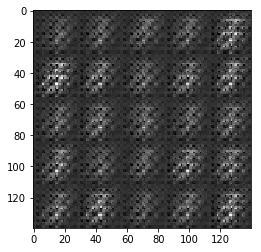

Epoch 1/2... Discriminator Loss: 0.6171... Generator Loss: 1.6628
Epoch 1/2... Discriminator Loss: 0.9937... Generator Loss: 1.0261
Epoch 1/2... Discriminator Loss: 0.7559... Generator Loss: 1.1588
Epoch 1/2... Discriminator Loss: 2.4904... Generator Loss: 0.1349
Epoch 1/2... Discriminator Loss: 1.3570... Generator Loss: 0.6356
Epoch 1/2... Discriminator Loss: 0.9289... Generator Loss: 1.0831
Epoch 1/2... Discriminator Loss: 1.4064... Generator Loss: 0.4867
Epoch 1/2... Discriminator Loss: 1.2534... Generator Loss: 0.7457
Epoch 1/2... Discriminator Loss: 1.0369... Generator Loss: 0.9363
Epoch 1/2... Discriminator Loss: 2.0784... Generator Loss: 0.2085


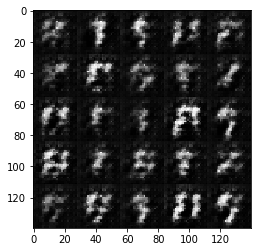

Epoch 1/2... Discriminator Loss: 2.1960... Generator Loss: 0.2241
Epoch 1/2... Discriminator Loss: 1.4064... Generator Loss: 2.4100
Epoch 1/2... Discriminator Loss: 1.1515... Generator Loss: 0.6064
Epoch 1/2... Discriminator Loss: 1.6492... Generator Loss: 0.7030
Epoch 1/2... Discriminator Loss: 1.0612... Generator Loss: 0.7872
Epoch 1/2... Discriminator Loss: 1.7515... Generator Loss: 0.2926
Epoch 1/2... Discriminator Loss: 1.3639... Generator Loss: 0.5257
Epoch 1/2... Discriminator Loss: 1.2420... Generator Loss: 0.8294
Epoch 1/2... Discriminator Loss: 1.2759... Generator Loss: 0.7582
Epoch 1/2... Discriminator Loss: 1.8210... Generator Loss: 0.2651


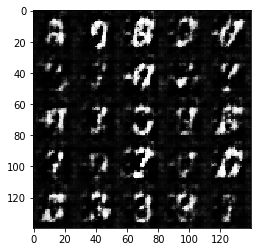

Epoch 1/2... Discriminator Loss: 1.5268... Generator Loss: 0.3918
Epoch 1/2... Discriminator Loss: 1.0015... Generator Loss: 1.0098
Epoch 1/2... Discriminator Loss: 1.3500... Generator Loss: 0.8384
Epoch 1/2... Discriminator Loss: 1.5023... Generator Loss: 0.4136
Epoch 1/2... Discriminator Loss: 2.1242... Generator Loss: 0.3673
Epoch 1/2... Discriminator Loss: 2.7188... Generator Loss: 0.1236
Epoch 1/2... Discriminator Loss: 1.2037... Generator Loss: 0.5959
Epoch 1/2... Discriminator Loss: 2.9746... Generator Loss: 0.0811
Epoch 1/2... Discriminator Loss: 1.3704... Generator Loss: 0.4831
Epoch 1/2... Discriminator Loss: 1.6895... Generator Loss: 0.3578


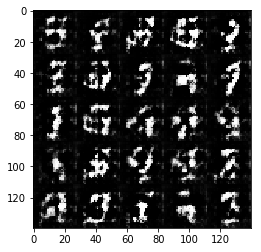

Epoch 1/2... Discriminator Loss: 1.1356... Generator Loss: 1.3328
Epoch 1/2... Discriminator Loss: 1.2632... Generator Loss: 0.7349
Epoch 1/2... Discriminator Loss: 1.7660... Generator Loss: 0.3272
Epoch 1/2... Discriminator Loss: 0.7699... Generator Loss: 1.1401
Epoch 1/2... Discriminator Loss: 1.1086... Generator Loss: 1.1827
Epoch 1/2... Discriminator Loss: 1.3916... Generator Loss: 0.4737
Epoch 1/2... Discriminator Loss: 2.8394... Generator Loss: 0.0983
Epoch 1/2... Discriminator Loss: 1.2528... Generator Loss: 0.8383
Epoch 1/2... Discriminator Loss: 1.4745... Generator Loss: 0.4357
Epoch 1/2... Discriminator Loss: 1.7289... Generator Loss: 0.3186


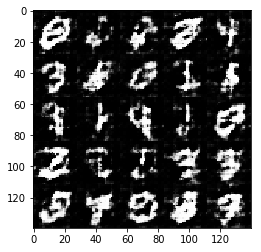

Epoch 1/2... Discriminator Loss: 0.9334... Generator Loss: 0.9927
Epoch 1/2... Discriminator Loss: 1.3780... Generator Loss: 0.5543
Epoch 1/2... Discriminator Loss: 1.5143... Generator Loss: 0.5592
Epoch 1/2... Discriminator Loss: 0.7741... Generator Loss: 1.4194
Epoch 1/2... Discriminator Loss: 1.4345... Generator Loss: 0.4349
Epoch 1/2... Discriminator Loss: 2.6776... Generator Loss: 0.1034
Epoch 1/2... Discriminator Loss: 1.9706... Generator Loss: 0.2796
Epoch 1/2... Discriminator Loss: 2.5512... Generator Loss: 0.1655
Epoch 1/2... Discriminator Loss: 2.0882... Generator Loss: 0.2641
Epoch 1/2... Discriminator Loss: 0.8488... Generator Loss: 0.9604


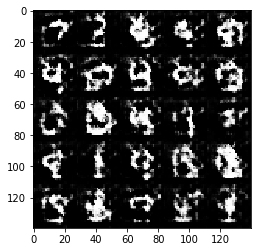

Epoch 1/2... Discriminator Loss: 2.0091... Generator Loss: 0.2212
Epoch 1/2... Discriminator Loss: 1.4378... Generator Loss: 0.4458
Epoch 1/2... Discriminator Loss: 1.2266... Generator Loss: 0.6058
Epoch 1/2... Discriminator Loss: 1.4808... Generator Loss: 0.3958
Epoch 1/2... Discriminator Loss: 1.4061... Generator Loss: 0.5718
Epoch 1/2... Discriminator Loss: 3.4621... Generator Loss: 0.0656
Epoch 1/2... Discriminator Loss: 2.5399... Generator Loss: 0.1247
Epoch 1/2... Discriminator Loss: 1.4185... Generator Loss: 0.4388
Epoch 1/2... Discriminator Loss: 1.6476... Generator Loss: 0.3647
Epoch 1/2... Discriminator Loss: 1.8179... Generator Loss: 0.3123


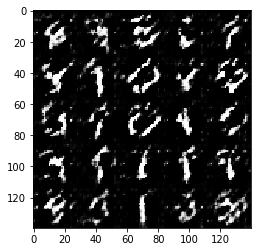

Epoch 1/2... Discriminator Loss: 0.7808... Generator Loss: 1.6336
Epoch 1/2... Discriminator Loss: 0.8015... Generator Loss: 2.6226
Epoch 1/2... Discriminator Loss: 1.5712... Generator Loss: 0.4036
Epoch 1/2... Discriminator Loss: 2.2116... Generator Loss: 0.2176
Epoch 1/2... Discriminator Loss: 1.2390... Generator Loss: 0.5901
Epoch 1/2... Discriminator Loss: 0.9797... Generator Loss: 0.9237
Epoch 1/2... Discriminator Loss: 2.2533... Generator Loss: 0.1756
Epoch 1/2... Discriminator Loss: 2.8217... Generator Loss: 0.1002
Epoch 1/2... Discriminator Loss: 1.8733... Generator Loss: 0.2543
Epoch 1/2... Discriminator Loss: 1.2530... Generator Loss: 0.5587


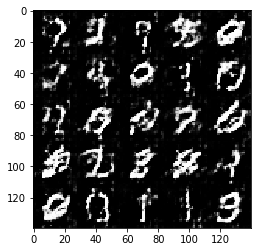

Epoch 1/2... Discriminator Loss: 1.2272... Generator Loss: 0.5439
Epoch 1/2... Discriminator Loss: 0.6784... Generator Loss: 1.6944
Epoch 1/2... Discriminator Loss: 1.8460... Generator Loss: 0.2926
Epoch 1/2... Discriminator Loss: 1.0511... Generator Loss: 1.0279
Epoch 1/2... Discriminator Loss: 1.3711... Generator Loss: 0.4564
Epoch 1/2... Discriminator Loss: 1.0112... Generator Loss: 1.6721
Epoch 1/2... Discriminator Loss: 1.0930... Generator Loss: 0.6951
Epoch 1/2... Discriminator Loss: 0.8583... Generator Loss: 1.0259
Epoch 1/2... Discriminator Loss: 1.3529... Generator Loss: 0.5940
Epoch 1/2... Discriminator Loss: 1.3536... Generator Loss: 0.6414


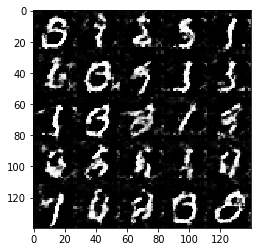

Epoch 1/2... Discriminator Loss: 1.0124... Generator Loss: 1.0575
Epoch 1/2... Discriminator Loss: 0.7278... Generator Loss: 1.2569
Epoch 1/2... Discriminator Loss: 1.6574... Generator Loss: 0.3155
Epoch 1/2... Discriminator Loss: 1.0287... Generator Loss: 1.6419
Epoch 1/2... Discriminator Loss: 0.8898... Generator Loss: 1.2581
Epoch 1/2... Discriminator Loss: 2.3787... Generator Loss: 0.1848
Epoch 1/2... Discriminator Loss: 1.3397... Generator Loss: 1.8428
Epoch 1/2... Discriminator Loss: 1.1325... Generator Loss: 0.6893
Epoch 1/2... Discriminator Loss: 2.0296... Generator Loss: 3.8308
Epoch 1/2... Discriminator Loss: 1.8781... Generator Loss: 0.2580


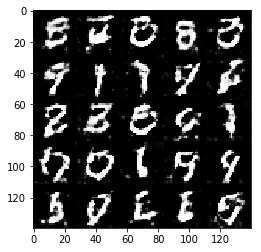

Epoch 1/2... Discriminator Loss: 1.1924... Generator Loss: 0.6378
Epoch 1/2... Discriminator Loss: 1.0933... Generator Loss: 0.8342
Epoch 1/2... Discriminator Loss: 1.1540... Generator Loss: 0.6077
Epoch 1/2... Discriminator Loss: 1.8561... Generator Loss: 0.2715
Epoch 1/2... Discriminator Loss: 1.5460... Generator Loss: 0.3795
Epoch 1/2... Discriminator Loss: 1.8765... Generator Loss: 0.2878
Epoch 1/2... Discriminator Loss: 1.5039... Generator Loss: 0.3908
Epoch 1/2... Discriminator Loss: 1.2820... Generator Loss: 0.5310
Epoch 1/2... Discriminator Loss: 1.1202... Generator Loss: 0.7659
Epoch 1/2... Discriminator Loss: 1.0378... Generator Loss: 0.7195


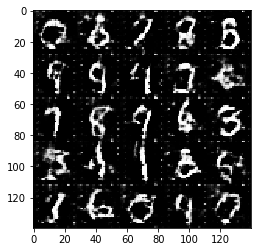

Epoch 1/2... Discriminator Loss: 2.2959... Generator Loss: 0.1940
Epoch 1/2... Discriminator Loss: 2.6924... Generator Loss: 0.1303
Epoch 1/2... Discriminator Loss: 1.1884... Generator Loss: 0.7103
Epoch 1/2... Discriminator Loss: 1.9145... Generator Loss: 0.2622
Epoch 1/2... Discriminator Loss: 2.6966... Generator Loss: 0.1138
Epoch 1/2... Discriminator Loss: 2.7887... Generator Loss: 0.0998
Epoch 1/2... Discriminator Loss: 0.9092... Generator Loss: 0.9840
Epoch 1/2... Discriminator Loss: 2.2461... Generator Loss: 0.1763
Epoch 1/2... Discriminator Loss: 0.7385... Generator Loss: 1.2460
Epoch 1/2... Discriminator Loss: 1.8198... Generator Loss: 0.3421


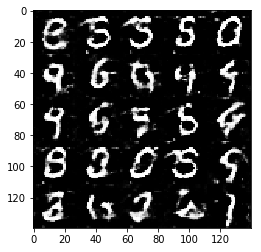

Epoch 1/2... Discriminator Loss: 0.7306... Generator Loss: 1.4818
Epoch 1/2... Discriminator Loss: 0.6472... Generator Loss: 1.9630
Epoch 1/2... Discriminator Loss: 0.7488... Generator Loss: 1.2064
Epoch 1/2... Discriminator Loss: 3.0617... Generator Loss: 0.0873
Epoch 1/2... Discriminator Loss: 1.3513... Generator Loss: 0.4864
Epoch 1/2... Discriminator Loss: 3.1550... Generator Loss: 0.0746
Epoch 1/2... Discriminator Loss: 1.0873... Generator Loss: 0.7748
Epoch 1/2... Discriminator Loss: 0.7607... Generator Loss: 2.3194
Epoch 1/2... Discriminator Loss: 1.7883... Generator Loss: 3.5997
Epoch 1/2... Discriminator Loss: 1.9396... Generator Loss: 0.2597


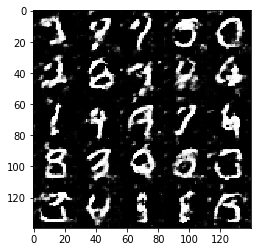

Epoch 1/2... Discriminator Loss: 2.0477... Generator Loss: 0.2171
Epoch 1/2... Discriminator Loss: 1.6554... Generator Loss: 0.3226
Epoch 1/2... Discriminator Loss: 1.1458... Generator Loss: 0.6281
Epoch 1/2... Discriminator Loss: 1.9727... Generator Loss: 0.2830
Epoch 1/2... Discriminator Loss: 1.7073... Generator Loss: 0.3475
Epoch 1/2... Discriminator Loss: 1.6908... Generator Loss: 2.2053
Epoch 1/2... Discriminator Loss: 1.1268... Generator Loss: 1.0760
Epoch 1/2... Discriminator Loss: 0.8181... Generator Loss: 1.2275
Epoch 1/2... Discriminator Loss: 0.7522... Generator Loss: 2.1803
Epoch 1/2... Discriminator Loss: 0.8787... Generator Loss: 1.8655


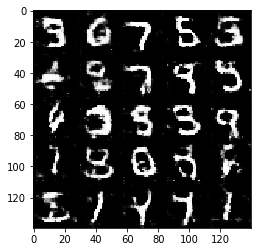

Epoch 1/2... Discriminator Loss: 0.9579... Generator Loss: 0.8192
Epoch 1/2... Discriminator Loss: 1.2135... Generator Loss: 0.7168
Epoch 1/2... Discriminator Loss: 0.9605... Generator Loss: 0.8276
Epoch 1/2... Discriminator Loss: 1.0387... Generator Loss: 0.9633
Epoch 1/2... Discriminator Loss: 0.8507... Generator Loss: 1.3488
Epoch 1/2... Discriminator Loss: 2.2714... Generator Loss: 0.1990
Epoch 1/2... Discriminator Loss: 1.0501... Generator Loss: 2.8569
Epoch 1/2... Discriminator Loss: 0.6259... Generator Loss: 1.4348
Epoch 1/2... Discriminator Loss: 1.0463... Generator Loss: 0.7616
Epoch 1/2... Discriminator Loss: 0.7768... Generator Loss: 1.7043


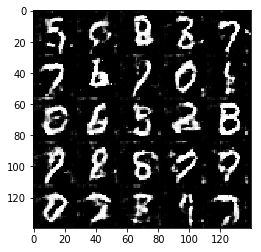

Epoch 1/2... Discriminator Loss: 0.9832... Generator Loss: 1.0039
Epoch 1/2... Discriminator Loss: 2.3138... Generator Loss: 0.1810
Epoch 1/2... Discriminator Loss: 0.6867... Generator Loss: 1.2764
Epoch 1/2... Discriminator Loss: 1.2925... Generator Loss: 0.5514
Epoch 1/2... Discriminator Loss: 1.5809... Generator Loss: 0.4475
Epoch 1/2... Discriminator Loss: 0.7641... Generator Loss: 1.1415
Epoch 1/2... Discriminator Loss: 1.0616... Generator Loss: 2.6026
Epoch 1/2... Discriminator Loss: 0.6339... Generator Loss: 1.4568
Epoch 1/2... Discriminator Loss: 1.4501... Generator Loss: 0.4662
Epoch 1/2... Discriminator Loss: 2.0780... Generator Loss: 0.2371


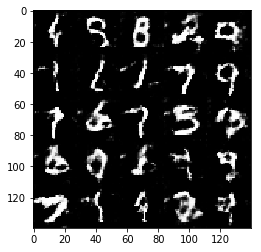

Epoch 1/2... Discriminator Loss: 0.5517... Generator Loss: 1.8188
Epoch 1/2... Discriminator Loss: 1.2622... Generator Loss: 0.5622
Epoch 1/2... Discriminator Loss: 2.9598... Generator Loss: 0.1112
Epoch 1/2... Discriminator Loss: 0.5703... Generator Loss: 2.0717
Epoch 1/2... Discriminator Loss: 0.8688... Generator Loss: 0.9666
Epoch 1/2... Discriminator Loss: 0.8509... Generator Loss: 0.9580
Epoch 1/2... Discriminator Loss: 0.5493... Generator Loss: 3.7257
Epoch 1/2... Discriminator Loss: 0.6764... Generator Loss: 1.4040
Epoch 1/2... Discriminator Loss: 0.5721... Generator Loss: 4.5983
Epoch 1/2... Discriminator Loss: 2.9330... Generator Loss: 0.1000


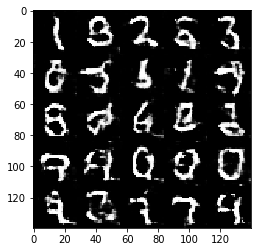

Epoch 1/2... Discriminator Loss: 1.4280... Generator Loss: 0.4193
Epoch 1/2... Discriminator Loss: 0.6677... Generator Loss: 1.3392
Epoch 1/2... Discriminator Loss: 1.3383... Generator Loss: 6.1207
Epoch 1/2... Discriminator Loss: 1.0970... Generator Loss: 0.6640
Epoch 1/2... Discriminator Loss: 0.8914... Generator Loss: 2.0584
Epoch 1/2... Discriminator Loss: 0.9309... Generator Loss: 0.9669
Epoch 1/2... Discriminator Loss: 0.9187... Generator Loss: 0.9288
Epoch 1/2... Discriminator Loss: 0.9734... Generator Loss: 1.6737
Epoch 1/2... Discriminator Loss: 0.6789... Generator Loss: 2.5714
Epoch 1/2... Discriminator Loss: 0.5646... Generator Loss: 2.1393


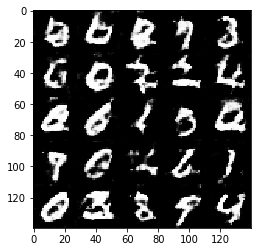

Epoch 1/2... Discriminator Loss: 1.6558... Generator Loss: 0.3406
Epoch 1/2... Discriminator Loss: 1.3015... Generator Loss: 0.5306
Epoch 1/2... Discriminator Loss: 0.6216... Generator Loss: 1.4551
Epoch 1/2... Discriminator Loss: 0.6504... Generator Loss: 1.5431
Epoch 1/2... Discriminator Loss: 2.0442... Generator Loss: 0.2128
Epoch 1/2... Discriminator Loss: 3.3160... Generator Loss: 0.0674
Epoch 1/2... Discriminator Loss: 0.6379... Generator Loss: 1.7774
Epoch 1/2... Discriminator Loss: 2.0807... Generator Loss: 0.2290
Epoch 1/2... Discriminator Loss: 3.0764... Generator Loss: 0.0895
Epoch 1/2... Discriminator Loss: 1.0382... Generator Loss: 0.7488


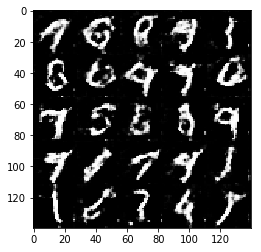

Epoch 1/2... Discriminator Loss: 0.7665... Generator Loss: 1.1111
Epoch 1/2... Discriminator Loss: 0.9645... Generator Loss: 0.8385
Epoch 1/2... Discriminator Loss: 1.1571... Generator Loss: 0.7151
Epoch 1/2... Discriminator Loss: 0.7651... Generator Loss: 1.0969
Epoch 1/2... Discriminator Loss: 2.3874... Generator Loss: 0.2075
Epoch 1/2... Discriminator Loss: 2.6234... Generator Loss: 0.1765
Epoch 1/2... Discriminator Loss: 1.4926... Generator Loss: 0.4493
Epoch 1/2... Discriminator Loss: 1.1339... Generator Loss: 0.6745
Epoch 1/2... Discriminator Loss: 0.7345... Generator Loss: 1.1562
Epoch 1/2... Discriminator Loss: 0.9277... Generator Loss: 0.8500


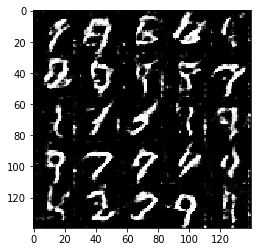

Epoch 1/2... Discriminator Loss: 0.6481... Generator Loss: 1.4561
Epoch 1/2... Discriminator Loss: 0.5170... Generator Loss: 3.2304
Epoch 1/2... Discriminator Loss: 0.5233... Generator Loss: 2.1620
Epoch 1/2... Discriminator Loss: 0.6859... Generator Loss: 1.3030
Epoch 1/2... Discriminator Loss: 0.7370... Generator Loss: 1.1977
Epoch 1/2... Discriminator Loss: 2.0616... Generator Loss: 3.0902
Epoch 1/2... Discriminator Loss: 0.9525... Generator Loss: 0.8447
Epoch 1/2... Discriminator Loss: 3.4747... Generator Loss: 0.0595
Epoch 1/2... Discriminator Loss: 0.6128... Generator Loss: 2.6338
Epoch 1/2... Discriminator Loss: 1.0898... Generator Loss: 0.7589


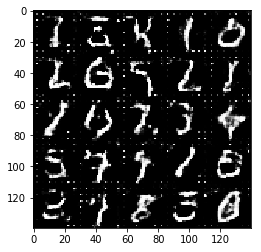

Epoch 1/2... Discriminator Loss: 1.7085... Generator Loss: 0.3887
Epoch 1/2... Discriminator Loss: 1.3419... Generator Loss: 0.5062
Epoch 1/2... Discriminator Loss: 1.3199... Generator Loss: 0.5492
Epoch 1/2... Discriminator Loss: 0.7978... Generator Loss: 1.4351
Epoch 1/2... Discriminator Loss: 0.7864... Generator Loss: 1.1576
Epoch 1/2... Discriminator Loss: 0.8208... Generator Loss: 1.1384
Epoch 1/2... Discriminator Loss: 0.6317... Generator Loss: 1.7077
Epoch 1/2... Discriminator Loss: 1.3731... Generator Loss: 0.5158
Epoch 1/2... Discriminator Loss: 1.2226... Generator Loss: 0.6915
Epoch 1/2... Discriminator Loss: 1.7237... Generator Loss: 0.3221


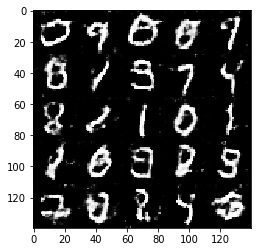

Epoch 1/2... Discriminator Loss: 1.4245... Generator Loss: 0.4330
Epoch 1/2... Discriminator Loss: 0.7972... Generator Loss: 1.2605
Epoch 1/2... Discriminator Loss: 0.9523... Generator Loss: 0.9411
Epoch 1/2... Discriminator Loss: 1.4220... Generator Loss: 0.4991
Epoch 1/2... Discriminator Loss: 0.6792... Generator Loss: 1.3108
Epoch 1/2... Discriminator Loss: 0.5857... Generator Loss: 1.7661
Epoch 1/2... Discriminator Loss: 1.1770... Generator Loss: 0.6066
Epoch 1/2... Discriminator Loss: 0.5861... Generator Loss: 1.6526
Epoch 1/2... Discriminator Loss: 2.0635... Generator Loss: 0.2637
Epoch 1/2... Discriminator Loss: 1.4399... Generator Loss: 0.7268


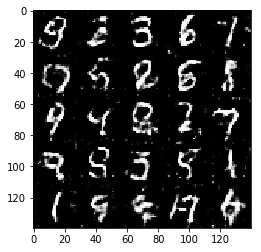

Epoch 1/2... Discriminator Loss: 1.7051... Generator Loss: 0.4438
Epoch 1/2... Discriminator Loss: 0.8466... Generator Loss: 1.0248
Epoch 1/2... Discriminator Loss: 0.8009... Generator Loss: 1.0394
Epoch 1/2... Discriminator Loss: 1.0496... Generator Loss: 0.7722
Epoch 1/2... Discriminator Loss: 2.6725... Generator Loss: 0.1421
Epoch 1/2... Discriminator Loss: 1.3856... Generator Loss: 0.4860
Epoch 1/2... Discriminator Loss: 1.3329... Generator Loss: 0.6421
Epoch 1/2... Discriminator Loss: 1.9092... Generator Loss: 0.3868
Epoch 1/2... Discriminator Loss: 0.8559... Generator Loss: 1.2079
Epoch 1/2... Discriminator Loss: 0.7226... Generator Loss: 1.6630


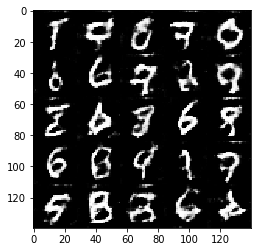

Epoch 1/2... Discriminator Loss: 0.8490... Generator Loss: 0.9651
Epoch 1/2... Discriminator Loss: 1.0727... Generator Loss: 0.6903
Epoch 1/2... Discriminator Loss: 1.8318... Generator Loss: 0.3339
Epoch 1/2... Discriminator Loss: 2.4083... Generator Loss: 0.1818
Epoch 1/2... Discriminator Loss: 1.4273... Generator Loss: 0.4599
Epoch 1/2... Discriminator Loss: 0.8042... Generator Loss: 1.0772
Epoch 1/2... Discriminator Loss: 0.7741... Generator Loss: 1.2732
Epoch 1/2... Discriminator Loss: 1.5882... Generator Loss: 0.3864
Epoch 1/2... Discriminator Loss: 0.4817... Generator Loss: 2.4386
Epoch 1/2... Discriminator Loss: 0.9423... Generator Loss: 1.0555


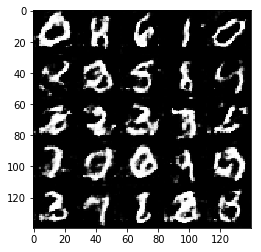

Epoch 1/2... Discriminator Loss: 1.1500... Generator Loss: 0.6346
Epoch 1/2... Discriminator Loss: 1.7461... Generator Loss: 0.3021
Epoch 1/2... Discriminator Loss: 0.6068... Generator Loss: 1.5647
Epoch 1/2... Discriminator Loss: 0.5723... Generator Loss: 2.3119
Epoch 1/2... Discriminator Loss: 0.8020... Generator Loss: 1.2012
Epoch 1/2... Discriminator Loss: 0.8252... Generator Loss: 2.9720
Epoch 1/2... Discriminator Loss: 2.6814... Generator Loss: 0.1789
Epoch 1/2... Discriminator Loss: 0.8753... Generator Loss: 0.9226
Epoch 1/2... Discriminator Loss: 2.5015... Generator Loss: 0.1892
Epoch 1/2... Discriminator Loss: 1.2472... Generator Loss: 0.6065


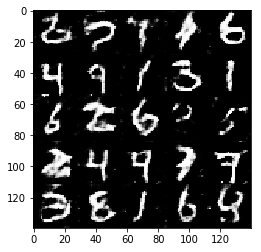

Epoch 1/2... Discriminator Loss: 1.1764... Generator Loss: 0.7524
Epoch 1/2... Discriminator Loss: 2.3808... Generator Loss: 0.1678
Epoch 1/2... Discriminator Loss: 1.7457... Generator Loss: 0.3774
Epoch 1/2... Discriminator Loss: 1.3913... Generator Loss: 0.4753
Epoch 1/2... Discriminator Loss: 1.0066... Generator Loss: 2.2921
Epoch 1/2... Discriminator Loss: 0.7411... Generator Loss: 1.3039
Epoch 1/2... Discriminator Loss: 0.5510... Generator Loss: 2.0208
Epoch 1/2... Discriminator Loss: 0.8868... Generator Loss: 2.8952
Epoch 1/2... Discriminator Loss: 0.5618... Generator Loss: 1.8080
Epoch 1/2... Discriminator Loss: 1.5014... Generator Loss: 0.4146


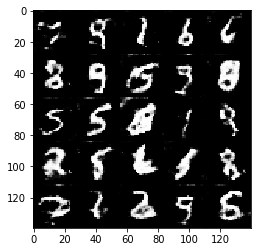

Epoch 1/2... Discriminator Loss: 1.1713... Generator Loss: 0.6801
Epoch 1/2... Discriminator Loss: 0.8178... Generator Loss: 1.0064
Epoch 1/2... Discriminator Loss: 0.6870... Generator Loss: 2.7843
Epoch 1/2... Discriminator Loss: 1.3197... Generator Loss: 0.4950
Epoch 1/2... Discriminator Loss: 1.0205... Generator Loss: 0.7119
Epoch 1/2... Discriminator Loss: 0.7998... Generator Loss: 3.5596
Epoch 1/2... Discriminator Loss: 0.8652... Generator Loss: 1.0127
Epoch 1/2... Discriminator Loss: 0.9965... Generator Loss: 0.7598
Epoch 1/2... Discriminator Loss: 0.8555... Generator Loss: 1.1045
Epoch 1/2... Discriminator Loss: 3.3059... Generator Loss: 0.0723


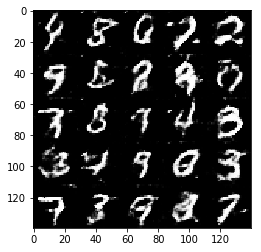

Epoch 1/2... Discriminator Loss: 0.4415... Generator Loss: 2.8156
Epoch 1/2... Discriminator Loss: 0.4819... Generator Loss: 2.2619
Epoch 1/2... Discriminator Loss: 0.4760... Generator Loss: 2.1854
Epoch 1/2... Discriminator Loss: 0.9337... Generator Loss: 4.8725
Epoch 1/2... Discriminator Loss: 1.8520... Generator Loss: 0.2897
Epoch 1/2... Discriminator Loss: 1.1496... Generator Loss: 0.7700
Epoch 1/2... Discriminator Loss: 0.7394... Generator Loss: 2.2825
Epoch 1/2... Discriminator Loss: 1.6335... Generator Loss: 0.3647
Epoch 1/2... Discriminator Loss: 0.9327... Generator Loss: 1.0749
Epoch 1/2... Discriminator Loss: 0.8615... Generator Loss: 0.9929


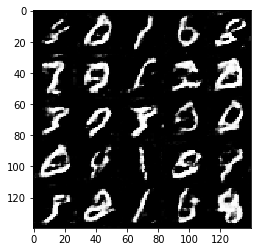

Epoch 1/2... Discriminator Loss: 0.7626... Generator Loss: 1.1430
Epoch 1/2... Discriminator Loss: 0.8786... Generator Loss: 1.5752
Epoch 1/2... Discriminator Loss: 2.9818... Generator Loss: 0.0939
Epoch 1/2... Discriminator Loss: 0.9856... Generator Loss: 0.8129
Epoch 1/2... Discriminator Loss: 2.4626... Generator Loss: 0.2767
Epoch 1/2... Discriminator Loss: 1.8416... Generator Loss: 0.2911
Epoch 1/2... Discriminator Loss: 0.9970... Generator Loss: 0.8848
Epoch 1/2... Discriminator Loss: 2.7806... Generator Loss: 0.1472
Epoch 1/2... Discriminator Loss: 1.5852... Generator Loss: 0.3945
Epoch 1/2... Discriminator Loss: 2.7544... Generator Loss: 0.1074


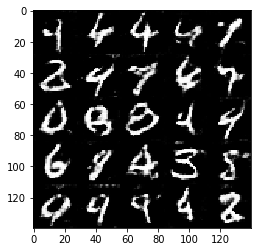

Epoch 1/2... Discriminator Loss: 1.2428... Generator Loss: 0.5957
Epoch 1/2... Discriminator Loss: 2.2399... Generator Loss: 0.2504
Epoch 1/2... Discriminator Loss: 0.6485... Generator Loss: 1.3929
Epoch 1/2... Discriminator Loss: 0.7026... Generator Loss: 1.2599
Epoch 1/2... Discriminator Loss: 1.6705... Generator Loss: 0.3360
Epoch 1/2... Discriminator Loss: 1.1937... Generator Loss: 4.2651
Epoch 1/2... Discriminator Loss: 0.6068... Generator Loss: 1.6407
Epoch 1/2... Discriminator Loss: 1.1807... Generator Loss: 0.6174
Epoch 1/2... Discriminator Loss: 1.1184... Generator Loss: 0.7617
Epoch 1/2... Discriminator Loss: 2.3980... Generator Loss: 0.2427


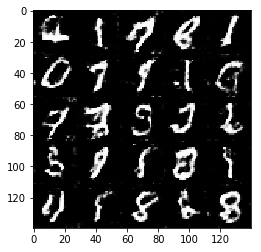

Epoch 1/2... Discriminator Loss: 1.5980... Generator Loss: 0.3905
Epoch 1/2... Discriminator Loss: 0.5997... Generator Loss: 1.5537
Epoch 1/2... Discriminator Loss: 1.2025... Generator Loss: 0.6142
Epoch 1/2... Discriminator Loss: 2.2265... Generator Loss: 0.1760
Epoch 1/2... Discriminator Loss: 0.9894... Generator Loss: 1.1451
Epoch 1/2... Discriminator Loss: 1.2809... Generator Loss: 0.7023
Epoch 1/2... Discriminator Loss: 2.7188... Generator Loss: 0.1331
Epoch 1/2... Discriminator Loss: 1.4193... Generator Loss: 0.4307
Epoch 1/2... Discriminator Loss: 1.7543... Generator Loss: 0.3514
Epoch 1/2... Discriminator Loss: 1.5716... Generator Loss: 0.4071


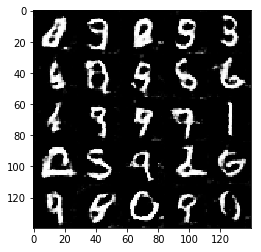

Epoch 1/2... Discriminator Loss: 0.5210... Generator Loss: 1.8566
Epoch 1/2... Discriminator Loss: 1.0338... Generator Loss: 0.7569
Epoch 1/2... Discriminator Loss: 1.1662... Generator Loss: 0.8799
Epoch 1/2... Discriminator Loss: 0.4663... Generator Loss: 2.0955
Epoch 1/2... Discriminator Loss: 1.5415... Generator Loss: 0.5347
Epoch 1/2... Discriminator Loss: 1.9233... Generator Loss: 0.3173
Epoch 1/2... Discriminator Loss: 2.5396... Generator Loss: 0.1716
Epoch 1/2... Discriminator Loss: 2.3028... Generator Loss: 0.1957
Epoch 1/2... Discriminator Loss: 2.5462... Generator Loss: 0.1921
Epoch 1/2... Discriminator Loss: 1.0299... Generator Loss: 1.1497


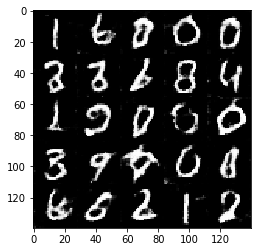

Epoch 1/2... Discriminator Loss: 1.8531... Generator Loss: 0.2777
Epoch 1/2... Discriminator Loss: 1.6983... Generator Loss: 0.3396
Epoch 1/2... Discriminator Loss: 0.4854... Generator Loss: 2.2175
Epoch 1/2... Discriminator Loss: 0.9260... Generator Loss: 0.8683
Epoch 1/2... Discriminator Loss: 0.8127... Generator Loss: 1.3685
Epoch 1/2... Discriminator Loss: 1.4412... Generator Loss: 0.4779
Epoch 1/2... Discriminator Loss: 0.6770... Generator Loss: 2.2650
Epoch 1/2... Discriminator Loss: 0.9585... Generator Loss: 1.4234
Epoch 1/2... Discriminator Loss: 0.7524... Generator Loss: 1.2210
Epoch 1/2... Discriminator Loss: 2.2558... Generator Loss: 0.3803


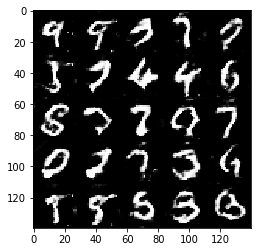

Epoch 1/2... Discriminator Loss: 1.2985... Generator Loss: 0.6755
Epoch 1/2... Discriminator Loss: 0.9654... Generator Loss: 0.8948
Epoch 1/2... Discriminator Loss: 0.6313... Generator Loss: 1.5475
Epoch 1/2... Discriminator Loss: 1.3069... Generator Loss: 0.5288
Epoch 1/2... Discriminator Loss: 0.6984... Generator Loss: 1.3887
Epoch 1/2... Discriminator Loss: 0.7826... Generator Loss: 1.5108
Epoch 1/2... Discriminator Loss: 1.9320... Generator Loss: 0.2778
Epoch 1/2... Discriminator Loss: 0.9831... Generator Loss: 0.7534
Epoch 1/2... Discriminator Loss: 1.7958... Generator Loss: 0.4275
Epoch 1/2... Discriminator Loss: 1.2558... Generator Loss: 0.5773


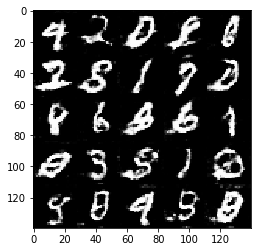

Epoch 1/2... Discriminator Loss: 1.6665... Generator Loss: 0.3859
Epoch 1/2... Discriminator Loss: 2.5919... Generator Loss: 0.2584
Epoch 1/2... Discriminator Loss: 2.6628... Generator Loss: 0.1956
Epoch 1/2... Discriminator Loss: 2.6639... Generator Loss: 0.1477
Epoch 1/2... Discriminator Loss: 1.2802... Generator Loss: 0.5932
Epoch 1/2... Discriminator Loss: 0.6214... Generator Loss: 1.6844
Epoch 1/2... Discriminator Loss: 1.0925... Generator Loss: 0.6871
Epoch 1/2... Discriminator Loss: 0.8731... Generator Loss: 1.1517
Epoch 1/2... Discriminator Loss: 0.9317... Generator Loss: 1.2415
Epoch 1/2... Discriminator Loss: 2.6425... Generator Loss: 0.1735


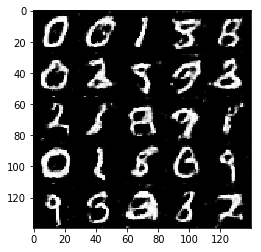

Epoch 1/2... Discriminator Loss: 0.5729... Generator Loss: 2.3180
Epoch 1/2... Discriminator Loss: 1.6017... Generator Loss: 0.3704
Epoch 1/2... Discriminator Loss: 0.6238... Generator Loss: 1.5051
Epoch 1/2... Discriminator Loss: 2.5409... Generator Loss: 0.2199
Epoch 1/2... Discriminator Loss: 0.5274... Generator Loss: 2.0186
Epoch 1/2... Discriminator Loss: 0.7986... Generator Loss: 1.2163
Epoch 1/2... Discriminator Loss: 0.9230... Generator Loss: 1.2937
Epoch 1/2... Discriminator Loss: 1.3892... Generator Loss: 0.6224
Epoch 1/2... Discriminator Loss: 2.4885... Generator Loss: 0.1974
Epoch 1/2... Discriminator Loss: 0.7436... Generator Loss: 2.0145


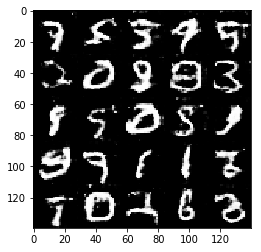

Epoch 1/2... Discriminator Loss: 1.1743... Generator Loss: 0.6205
Epoch 1/2... Discriminator Loss: 0.6619... Generator Loss: 1.6460
Epoch 1/2... Discriminator Loss: 0.7875... Generator Loss: 1.1451
Epoch 1/2... Discriminator Loss: 1.5985... Generator Loss: 0.4130
Epoch 1/2... Discriminator Loss: 0.8919... Generator Loss: 0.9314
Epoch 1/2... Discriminator Loss: 0.7348... Generator Loss: 1.5656
Epoch 1/2... Discriminator Loss: 1.2265... Generator Loss: 0.8297
Epoch 1/2... Discriminator Loss: 0.7127... Generator Loss: 1.4426
Epoch 1/2... Discriminator Loss: 0.8819... Generator Loss: 1.1389
Epoch 1/2... Discriminator Loss: 0.7232... Generator Loss: 1.4613


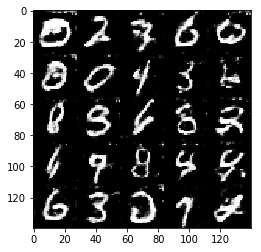

Epoch 1/2... Discriminator Loss: 0.9198... Generator Loss: 3.5083
Epoch 1/2... Discriminator Loss: 1.9393... Generator Loss: 0.3257
Epoch 1/2... Discriminator Loss: 1.4489... Generator Loss: 0.5092
Epoch 1/2... Discriminator Loss: 1.0240... Generator Loss: 0.8123
Epoch 1/2... Discriminator Loss: 1.2594... Generator Loss: 0.6365
Epoch 1/2... Discriminator Loss: 1.5404... Generator Loss: 0.4775
Epoch 1/2... Discriminator Loss: 2.4176... Generator Loss: 0.1858
Epoch 1/2... Discriminator Loss: 0.8685... Generator Loss: 1.0731
Epoch 1/2... Discriminator Loss: 0.5586... Generator Loss: 1.6943
Epoch 1/2... Discriminator Loss: 0.9698... Generator Loss: 0.8586


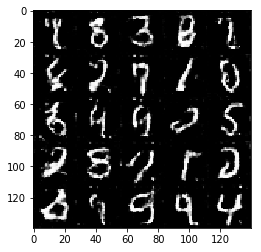

Epoch 1/2... Discriminator Loss: 2.5673... Generator Loss: 4.4211
Epoch 1/2... Discriminator Loss: 0.9149... Generator Loss: 1.0558
Epoch 1/2... Discriminator Loss: 0.5976... Generator Loss: 1.5914
Epoch 1/2... Discriminator Loss: 1.2635... Generator Loss: 0.5236
Epoch 1/2... Discriminator Loss: 1.2906... Generator Loss: 0.5162
Epoch 1/2... Discriminator Loss: 2.5071... Generator Loss: 0.2474
Epoch 1/2... Discriminator Loss: 1.4328... Generator Loss: 0.4942
Epoch 1/2... Discriminator Loss: 1.3676... Generator Loss: 0.6057
Epoch 1/2... Discriminator Loss: 2.6725... Generator Loss: 0.1363
Epoch 1/2... Discriminator Loss: 1.3010... Generator Loss: 0.5604


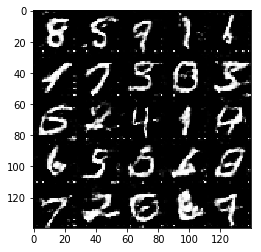

Epoch 1/2... Discriminator Loss: 1.4009... Generator Loss: 0.4597
Epoch 1/2... Discriminator Loss: 0.8355... Generator Loss: 1.0659
Epoch 1/2... Discriminator Loss: 0.9633... Generator Loss: 0.8650
Epoch 1/2... Discriminator Loss: 2.2686... Generator Loss: 0.2547
Epoch 1/2... Discriminator Loss: 1.0553... Generator Loss: 0.7620
Epoch 1/2... Discriminator Loss: 1.1321... Generator Loss: 0.9549
Epoch 1/2... Discriminator Loss: 0.6821... Generator Loss: 1.3818
Epoch 1/2... Discriminator Loss: 0.8325... Generator Loss: 1.3420
Epoch 1/2... Discriminator Loss: 0.4912... Generator Loss: 2.3661
Epoch 1/2... Discriminator Loss: 0.4873... Generator Loss: 2.8333


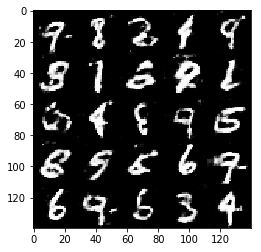

Epoch 1/2... Discriminator Loss: 0.8491... Generator Loss: 1.0677
Epoch 1/2... Discriminator Loss: 0.9604... Generator Loss: 0.8532
Epoch 1/2... Discriminator Loss: 1.0706... Generator Loss: 0.8061
Epoch 1/2... Discriminator Loss: 2.6029... Generator Loss: 0.1429
Epoch 1/2... Discriminator Loss: 1.1120... Generator Loss: 0.6662
Epoch 1/2... Discriminator Loss: 3.4785... Generator Loss: 0.0668
Epoch 1/2... Discriminator Loss: 1.3903... Generator Loss: 0.5024
Epoch 1/2... Discriminator Loss: 0.8316... Generator Loss: 4.0816
Epoch 1/2... Discriminator Loss: 0.9936... Generator Loss: 0.8070
Epoch 1/2... Discriminator Loss: 0.9959... Generator Loss: 0.8245


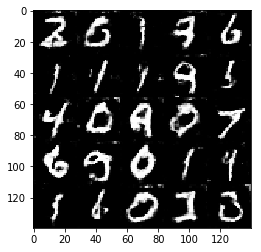

Epoch 1/2... Discriminator Loss: 0.7973... Generator Loss: 1.2508
Epoch 1/2... Discriminator Loss: 3.1461... Generator Loss: 0.0911
Epoch 1/2... Discriminator Loss: 0.9419... Generator Loss: 1.0305
Epoch 1/2... Discriminator Loss: 1.1661... Generator Loss: 0.5896
Epoch 1/2... Discriminator Loss: 1.2584... Generator Loss: 0.6637
Epoch 1/2... Discriminator Loss: 2.1628... Generator Loss: 0.1950
Epoch 1/2... Discriminator Loss: 1.3729... Generator Loss: 0.5453
Epoch 1/2... Discriminator Loss: 1.8489... Generator Loss: 0.3083
Epoch 1/2... Discriminator Loss: 0.4179... Generator Loss: 3.3050
Epoch 1/2... Discriminator Loss: 0.5570... Generator Loss: 1.8082


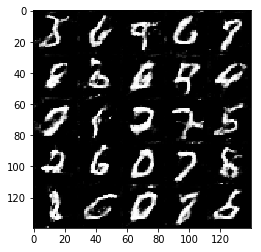

Epoch 1/2... Discriminator Loss: 1.9540... Generator Loss: 0.2785
Epoch 1/2... Discriminator Loss: 3.0957... Generator Loss: 0.1154
Epoch 1/2... Discriminator Loss: 0.9150... Generator Loss: 0.9175
Epoch 1/2... Discriminator Loss: 0.9940... Generator Loss: 0.9430
Epoch 1/2... Discriminator Loss: 1.6668... Generator Loss: 0.3111
Epoch 1/2... Discriminator Loss: 1.1292... Generator Loss: 0.7199
Epoch 1/2... Discriminator Loss: 0.8622... Generator Loss: 1.2403
Epoch 1/2... Discriminator Loss: 0.9590... Generator Loss: 1.2089
Epoch 1/2... Discriminator Loss: 3.0212... Generator Loss: 0.1139
Epoch 1/2... Discriminator Loss: 1.9938... Generator Loss: 0.2306


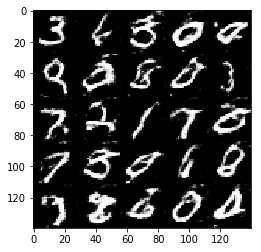

Epoch 1/2... Discriminator Loss: 1.2747... Generator Loss: 0.6439
Epoch 1/2... Discriminator Loss: 1.0136... Generator Loss: 0.8369
Epoch 1/2... Discriminator Loss: 0.5211... Generator Loss: 1.8833
Epoch 1/2... Discriminator Loss: 1.5777... Generator Loss: 0.3741
Epoch 1/2... Discriminator Loss: 1.3297... Generator Loss: 0.5463
Epoch 1/2... Discriminator Loss: 0.7299... Generator Loss: 2.0357
Epoch 1/2... Discriminator Loss: 1.0193... Generator Loss: 0.7357
Epoch 1/2... Discriminator Loss: 0.5660... Generator Loss: 1.8197
Epoch 1/2... Discriminator Loss: 0.4948... Generator Loss: 1.9660
Epoch 1/2... Discriminator Loss: 0.8018... Generator Loss: 1.0986


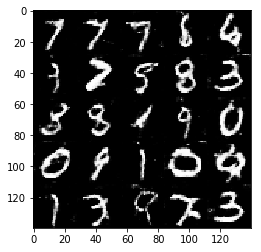

Epoch 1/2... Discriminator Loss: 1.4559... Generator Loss: 0.4444
Epoch 1/2... Discriminator Loss: 0.7456... Generator Loss: 1.1951
Epoch 1/2... Discriminator Loss: 0.6196... Generator Loss: 1.6052
Epoch 1/2... Discriminator Loss: 0.9730... Generator Loss: 2.3651
Epoch 1/2... Discriminator Loss: 1.7738... Generator Loss: 0.5297
Epoch 1/2... Discriminator Loss: 1.1653... Generator Loss: 0.6381
Epoch 1/2... Discriminator Loss: 0.5783... Generator Loss: 1.7991
Epoch 1/2... Discriminator Loss: 0.3970... Generator Loss: 5.1516
Epoch 1/2... Discriminator Loss: 1.5445... Generator Loss: 0.3662
Epoch 1/2... Discriminator Loss: 0.6726... Generator Loss: 1.6129


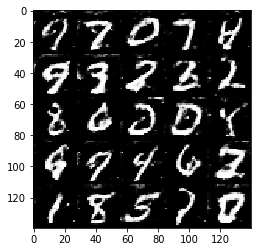

Epoch 1/2... Discriminator Loss: 1.0285... Generator Loss: 0.8720
Epoch 1/2... Discriminator Loss: 0.4512... Generator Loss: 2.8443
Epoch 1/2... Discriminator Loss: 0.7814... Generator Loss: 3.5962
Epoch 1/2... Discriminator Loss: 1.9332... Generator Loss: 0.3427
Epoch 1/2... Discriminator Loss: 0.9441... Generator Loss: 0.9006
Epoch 1/2... Discriminator Loss: 1.1375... Generator Loss: 0.6095
Epoch 1/2... Discriminator Loss: 0.5921... Generator Loss: 2.3615
Epoch 1/2... Discriminator Loss: 0.8340... Generator Loss: 1.3660
Epoch 1/2... Discriminator Loss: 1.4723... Generator Loss: 0.5461
Epoch 1/2... Discriminator Loss: 0.6457... Generator Loss: 1.4860


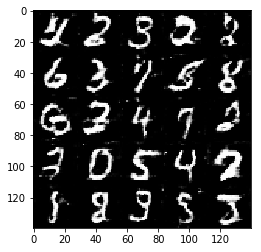

Epoch 1/2... Discriminator Loss: 0.5532... Generator Loss: 2.0789
Epoch 1/2... Discriminator Loss: 0.8555... Generator Loss: 0.9922
Epoch 1/2... Discriminator Loss: 0.6497... Generator Loss: 2.1645
Epoch 1/2... Discriminator Loss: 0.9765... Generator Loss: 0.7676
Epoch 1/2... Discriminator Loss: 1.6437... Generator Loss: 0.3642
Epoch 1/2... Discriminator Loss: 1.3469... Generator Loss: 0.6077
Epoch 1/2... Discriminator Loss: 0.4050... Generator Loss: 3.2487
Epoch 1/2... Discriminator Loss: 1.5064... Generator Loss: 0.4146
Epoch 1/2... Discriminator Loss: 0.5910... Generator Loss: 2.0283
Epoch 1/2... Discriminator Loss: 2.6839... Generator Loss: 0.1710


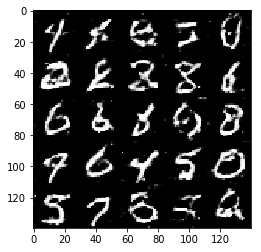

Epoch 1/2... Discriminator Loss: 1.2094... Generator Loss: 0.6545
Epoch 1/2... Discriminator Loss: 2.6854... Generator Loss: 0.1406
Epoch 1/2... Discriminator Loss: 0.6986... Generator Loss: 1.7006
Epoch 1/2... Discriminator Loss: 0.4295... Generator Loss: 2.9765
Epoch 1/2... Discriminator Loss: 2.4724... Generator Loss: 0.2828
Epoch 1/2... Discriminator Loss: 0.7040... Generator Loss: 1.3259
Epoch 1/2... Discriminator Loss: 1.0469... Generator Loss: 0.8595
Epoch 1/2... Discriminator Loss: 1.4431... Generator Loss: 0.5305
Epoch 1/2... Discriminator Loss: 1.4011... Generator Loss: 0.5993
Epoch 1/2... Discriminator Loss: 1.2525... Generator Loss: 0.6654


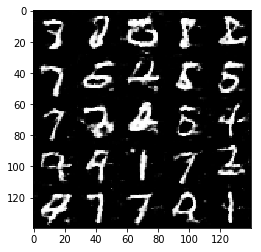

Epoch 1/2... Discriminator Loss: 2.4314... Generator Loss: 0.1959
Epoch 1/2... Discriminator Loss: 1.4086... Generator Loss: 0.4900
Epoch 1/2... Discriminator Loss: 1.3500... Generator Loss: 0.5338
Epoch 1/2... Discriminator Loss: 0.5812... Generator Loss: 1.8295
Epoch 1/2... Discriminator Loss: 0.8351... Generator Loss: 1.3209
Epoch 1/2... Discriminator Loss: 2.6895... Generator Loss: 0.1680
Epoch 1/2... Discriminator Loss: 3.1933... Generator Loss: 0.0892
Epoch 1/2... Discriminator Loss: 0.4422... Generator Loss: 2.9558
Epoch 1/2... Discriminator Loss: 0.7877... Generator Loss: 1.7898
Epoch 1/2... Discriminator Loss: 2.1864... Generator Loss: 0.2203


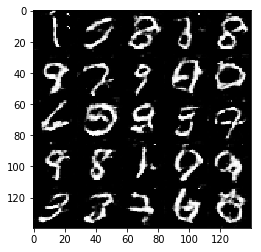

Epoch 1/2... Discriminator Loss: 0.7957... Generator Loss: 1.0835
Epoch 1/2... Discriminator Loss: 1.6844... Generator Loss: 0.5618
Epoch 1/2... Discriminator Loss: 1.0688... Generator Loss: 0.9527
Epoch 1/2... Discriminator Loss: 2.2345... Generator Loss: 0.2336
Epoch 1/2... Discriminator Loss: 2.3320... Generator Loss: 0.3886
Epoch 1/2... Discriminator Loss: 2.4924... Generator Loss: 0.1802
Epoch 1/2... Discriminator Loss: 1.3332... Generator Loss: 0.4935
Epoch 1/2... Discriminator Loss: 2.1336... Generator Loss: 0.2057
Epoch 1/2... Discriminator Loss: 1.4778... Generator Loss: 0.4990
Epoch 1/2... Discriminator Loss: 0.9826... Generator Loss: 0.8252


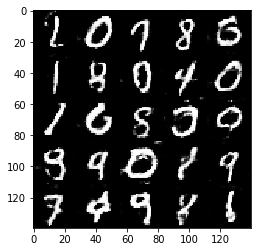

Epoch 1/2... Discriminator Loss: 0.5779... Generator Loss: 1.8729
Epoch 1/2... Discriminator Loss: 0.7079... Generator Loss: 1.2745
Epoch 1/2... Discriminator Loss: 0.3709... Generator Loss: 4.1513
Epoch 1/2... Discriminator Loss: 1.8873... Generator Loss: 0.3142
Epoch 1/2... Discriminator Loss: 0.7323... Generator Loss: 1.2671
Epoch 1/2... Discriminator Loss: 0.7173... Generator Loss: 1.3070
Epoch 1/2... Discriminator Loss: 0.8762... Generator Loss: 0.9098
Epoch 1/2... Discriminator Loss: 2.9240... Generator Loss: 0.1124
Epoch 1/2... Discriminator Loss: 1.4752... Generator Loss: 0.4090
Epoch 1/2... Discriminator Loss: 0.7816... Generator Loss: 1.1557


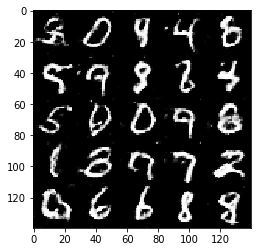

Epoch 1/2... Discriminator Loss: 0.6544... Generator Loss: 1.4828
Epoch 1/2... Discriminator Loss: 1.8523... Generator Loss: 0.4742
Epoch 1/2... Discriminator Loss: 0.9148... Generator Loss: 2.3165
Epoch 1/2... Discriminator Loss: 0.7263... Generator Loss: 1.4590
Epoch 1/2... Discriminator Loss: 0.9951... Generator Loss: 1.3674
Epoch 1/2... Discriminator Loss: 1.0293... Generator Loss: 0.7242
Epoch 1/2... Discriminator Loss: 1.2741... Generator Loss: 0.5368
Epoch 1/2... Discriminator Loss: 1.6620... Generator Loss: 0.4730
Epoch 1/2... Discriminator Loss: 0.6822... Generator Loss: 1.5842
Epoch 1/2... Discriminator Loss: 1.0070... Generator Loss: 0.7338


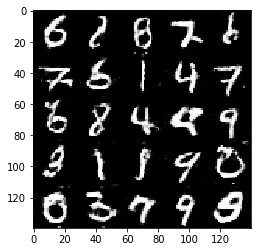

Epoch 1/2... Discriminator Loss: 0.6929... Generator Loss: 1.2530
Epoch 1/2... Discriminator Loss: 1.3228... Generator Loss: 0.5000
Epoch 1/2... Discriminator Loss: 2.6832... Generator Loss: 0.2018
Epoch 1/2... Discriminator Loss: 1.2244... Generator Loss: 0.6401
Epoch 1/2... Discriminator Loss: 0.8148... Generator Loss: 1.6032
Epoch 1/2... Discriminator Loss: 0.5210... Generator Loss: 3.7328
Epoch 1/2... Discriminator Loss: 0.7897... Generator Loss: 1.2054
Epoch 1/2... Discriminator Loss: 0.9342... Generator Loss: 1.1620
Epoch 1/2... Discriminator Loss: 0.9811... Generator Loss: 0.8002
Epoch 1/2... Discriminator Loss: 1.5225... Generator Loss: 0.4884


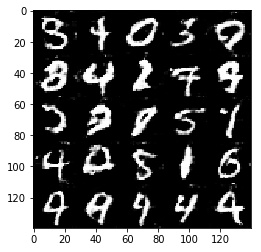

Epoch 1/2... Discriminator Loss: 1.8152... Generator Loss: 0.4613
Epoch 1/2... Discriminator Loss: 1.1239... Generator Loss: 0.8371
Epoch 1/2... Discriminator Loss: 0.5591... Generator Loss: 2.5181
Epoch 1/2... Discriminator Loss: 1.0545... Generator Loss: 0.7919
Epoch 1/2... Discriminator Loss: 0.5187... Generator Loss: 2.0697
Epoch 1/2... Discriminator Loss: 0.9445... Generator Loss: 3.2417
Epoch 1/2... Discriminator Loss: 1.0173... Generator Loss: 0.7707
Epoch 1/2... Discriminator Loss: 1.6965... Generator Loss: 0.3298
Epoch 1/2... Discriminator Loss: 1.1702... Generator Loss: 0.6143
Epoch 1/2... Discriminator Loss: 1.0635... Generator Loss: 0.7286


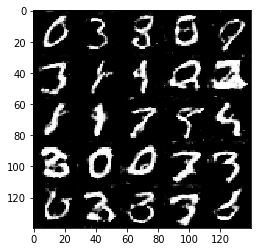

Epoch 1/2... Discriminator Loss: 0.7198... Generator Loss: 1.2064
Epoch 1/2... Discriminator Loss: 1.5938... Generator Loss: 0.4369
Epoch 1/2... Discriminator Loss: 0.8819... Generator Loss: 0.9769
Epoch 1/2... Discriminator Loss: 0.5751... Generator Loss: 1.6075
Epoch 1/2... Discriminator Loss: 0.4988... Generator Loss: 2.6139
Epoch 1/2... Discriminator Loss: 0.9398... Generator Loss: 0.8378
Epoch 1/2... Discriminator Loss: 1.3793... Generator Loss: 0.5723
Epoch 1/2... Discriminator Loss: 1.8111... Generator Loss: 0.3918
Epoch 1/2... Discriminator Loss: 1.5698... Generator Loss: 0.4853
Epoch 1/2... Discriminator Loss: 0.9826... Generator Loss: 4.1980


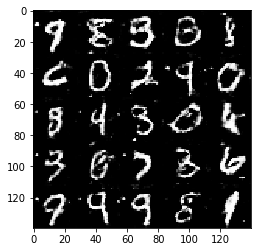

Epoch 1/2... Discriminator Loss: 2.8018... Generator Loss: 0.1519
Epoch 1/2... Discriminator Loss: 0.5617... Generator Loss: 2.2179
Epoch 1/2... Discriminator Loss: 1.1596... Generator Loss: 0.6486
Epoch 1/2... Discriminator Loss: 0.6183... Generator Loss: 1.8551
Epoch 1/2... Discriminator Loss: 0.8928... Generator Loss: 2.5895
Epoch 1/2... Discriminator Loss: 1.9365... Generator Loss: 0.2917
Epoch 1/2... Discriminator Loss: 0.9356... Generator Loss: 0.9061
Epoch 1/2... Discriminator Loss: 1.4933... Generator Loss: 0.4749
Epoch 1/2... Discriminator Loss: 1.3063... Generator Loss: 0.5771
Epoch 1/2... Discriminator Loss: 0.5712... Generator Loss: 2.3216


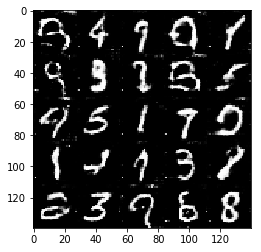

Epoch 1/2... Discriminator Loss: 0.6866... Generator Loss: 1.3078
Epoch 1/2... Discriminator Loss: 1.6069... Generator Loss: 0.4337
Epoch 1/2... Discriminator Loss: 0.7097... Generator Loss: 1.3172
Epoch 1/2... Discriminator Loss: 0.4966... Generator Loss: 2.1264
Epoch 1/2... Discriminator Loss: 1.4277... Generator Loss: 0.5703
Epoch 1/2... Discriminator Loss: 1.2116... Generator Loss: 0.6200
Epoch 1/2... Discriminator Loss: 0.6168... Generator Loss: 1.4524
Epoch 1/2... Discriminator Loss: 1.6901... Generator Loss: 0.3655
Epoch 1/2... Discriminator Loss: 0.9597... Generator Loss: 0.8716
Epoch 1/2... Discriminator Loss: 1.0079... Generator Loss: 0.9062


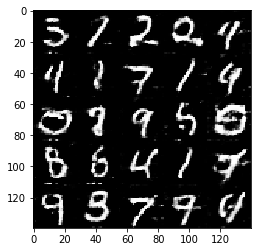

Epoch 1/2... Discriminator Loss: 0.8894... Generator Loss: 1.0597
Epoch 1/2... Discriminator Loss: 0.9355... Generator Loss: 0.7997
Epoch 1/2... Discriminator Loss: 1.1245... Generator Loss: 3.4357
Epoch 1/2... Discriminator Loss: 1.7620... Generator Loss: 0.2959
Epoch 1/2... Discriminator Loss: 0.6951... Generator Loss: 1.2819
Epoch 1/2... Discriminator Loss: 1.3699... Generator Loss: 0.5219
Epoch 1/2... Discriminator Loss: 0.9916... Generator Loss: 0.7851
Epoch 1/2... Discriminator Loss: 2.2537... Generator Loss: 0.2020
Epoch 1/2... Discriminator Loss: 1.4559... Generator Loss: 0.4194
Epoch 1/2... Discriminator Loss: 1.0508... Generator Loss: 0.7712


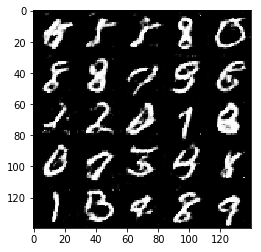

Epoch 1/2... Discriminator Loss: 0.9499... Generator Loss: 1.3502
Epoch 1/2... Discriminator Loss: 1.2087... Generator Loss: 0.7656
Epoch 1/2... Discriminator Loss: 1.3286... Generator Loss: 0.4904
Epoch 1/2... Discriminator Loss: 1.7701... Generator Loss: 0.3978
Epoch 1/2... Discriminator Loss: 1.3413... Generator Loss: 0.5803
Epoch 1/2... Discriminator Loss: 2.2813... Generator Loss: 0.2084
Epoch 1/2... Discriminator Loss: 2.3559... Generator Loss: 0.3362
Epoch 1/2... Discriminator Loss: 1.8494... Generator Loss: 0.3040
Epoch 1/2... Discriminator Loss: 0.7185... Generator Loss: 1.6656
Epoch 1/2... Discriminator Loss: 1.2388... Generator Loss: 0.6873


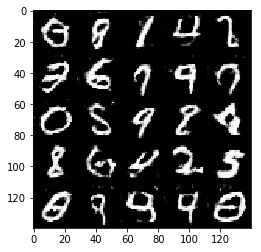

Epoch 1/2... Discriminator Loss: 1.0010... Generator Loss: 0.8116
Epoch 1/2... Discriminator Loss: 0.4441... Generator Loss: 2.7985
Epoch 1/2... Discriminator Loss: 0.9178... Generator Loss: 0.9047
Epoch 1/2... Discriminator Loss: 2.1792... Generator Loss: 0.1954
Epoch 1/2... Discriminator Loss: 1.5153... Generator Loss: 0.4339
Epoch 1/2... Discriminator Loss: 1.5047... Generator Loss: 0.4006
Epoch 1/2... Discriminator Loss: 1.9318... Generator Loss: 0.2399
Epoch 1/2... Discriminator Loss: 0.7379... Generator Loss: 1.1213
Epoch 1/2... Discriminator Loss: 0.7680... Generator Loss: 1.0767
Epoch 1/2... Discriminator Loss: 0.4800... Generator Loss: 3.2069


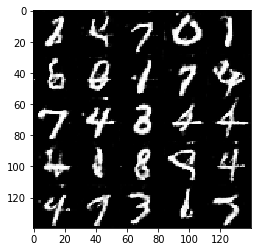

Epoch 1/2... Discriminator Loss: 0.5843... Generator Loss: 3.5226
Epoch 1/2... Discriminator Loss: 2.2703... Generator Loss: 0.2496
Epoch 1/2... Discriminator Loss: 0.9616... Generator Loss: 1.3712
Epoch 1/2... Discriminator Loss: 0.4406... Generator Loss: 3.4993
Epoch 1/2... Discriminator Loss: 1.0126... Generator Loss: 0.7802
Epoch 1/2... Discriminator Loss: 0.5956... Generator Loss: 1.9159
Epoch 1/2... Discriminator Loss: 0.5925... Generator Loss: 1.5763
Epoch 1/2... Discriminator Loss: 0.9358... Generator Loss: 0.8620
Epoch 1/2... Discriminator Loss: 2.5662... Generator Loss: 0.2542
Epoch 1/2... Discriminator Loss: 1.2454... Generator Loss: 0.5784


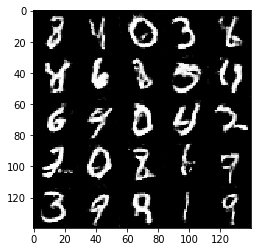

Epoch 1/2... Discriminator Loss: 3.0543... Generator Loss: 0.1041
Epoch 1/2... Discriminator Loss: 1.3404... Generator Loss: 0.4967
Epoch 1/2... Discriminator Loss: 3.1417... Generator Loss: 0.1540
Epoch 1/2... Discriminator Loss: 1.6849... Generator Loss: 0.4313
Epoch 1/2... Discriminator Loss: 1.5644... Generator Loss: 0.4376
Epoch 1/2... Discriminator Loss: 0.6921... Generator Loss: 1.8402
Epoch 1/2... Discriminator Loss: 0.5758... Generator Loss: 1.6293
Epoch 1/2... Discriminator Loss: 0.7512... Generator Loss: 1.1116
Epoch 1/2... Discriminator Loss: 1.5452... Generator Loss: 0.4347
Epoch 1/2... Discriminator Loss: 1.9253... Generator Loss: 0.3021


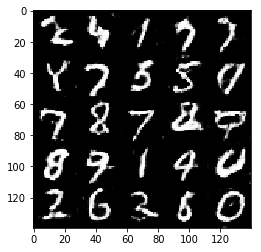

Epoch 1/2... Discriminator Loss: 4.0749... Generator Loss: 0.0396
Epoch 1/2... Discriminator Loss: 0.6337... Generator Loss: 2.2673
Epoch 1/2... Discriminator Loss: 0.7057... Generator Loss: 1.2727
Epoch 1/2... Discriminator Loss: 0.9949... Generator Loss: 0.9848
Epoch 1/2... Discriminator Loss: 1.1070... Generator Loss: 0.6414
Epoch 1/2... Discriminator Loss: 0.5893... Generator Loss: 1.6520
Epoch 1/2... Discriminator Loss: 0.9694... Generator Loss: 0.8333
Epoch 1/2... Discriminator Loss: 0.8459... Generator Loss: 1.0857
Epoch 1/2... Discriminator Loss: 1.9481... Generator Loss: 0.2580
Epoch 1/2... Discriminator Loss: 1.9971... Generator Loss: 0.2544


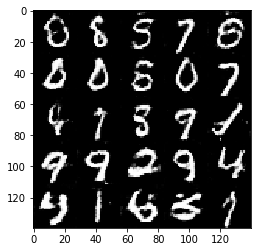

Epoch 1/2... Discriminator Loss: 1.5553... Generator Loss: 0.3953
Epoch 1/2... Discriminator Loss: 2.6663... Generator Loss: 0.2927
Epoch 1/2... Discriminator Loss: 0.5303... Generator Loss: 2.7959
Epoch 1/2... Discriminator Loss: 1.2294... Generator Loss: 0.5804
Epoch 1/2... Discriminator Loss: 1.5056... Generator Loss: 0.4071
Epoch 1/2... Discriminator Loss: 0.6494... Generator Loss: 1.3944
Epoch 1/2... Discriminator Loss: 0.9773... Generator Loss: 0.8894
Epoch 1/2... Discriminator Loss: 0.7613... Generator Loss: 1.2370
Epoch 1/2... Discriminator Loss: 1.0879... Generator Loss: 0.7683
Epoch 1/2... Discriminator Loss: 1.8261... Generator Loss: 0.3599


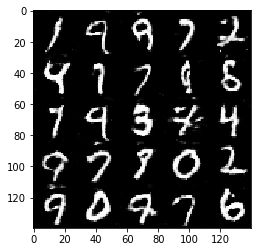

Epoch 1/2... Discriminator Loss: 0.5887... Generator Loss: 2.1249
Epoch 1/2... Discriminator Loss: 0.6424... Generator Loss: 1.3857
Epoch 1/2... Discriminator Loss: 0.7749... Generator Loss: 1.1067
Epoch 1/2... Discriminator Loss: 0.6383... Generator Loss: 2.2361
Epoch 1/2... Discriminator Loss: 2.1255... Generator Loss: 0.2511
Epoch 1/2... Discriminator Loss: 0.8339... Generator Loss: 1.2261
Epoch 1/2... Discriminator Loss: 3.0816... Generator Loss: 0.1009
Epoch 1/2... Discriminator Loss: 0.5787... Generator Loss: 1.8939
Epoch 1/2... Discriminator Loss: 0.5886... Generator Loss: 2.1753
Epoch 1/2... Discriminator Loss: 0.8619... Generator Loss: 1.0047


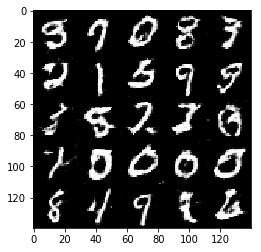

Epoch 1/2... Discriminator Loss: 0.7207... Generator Loss: 1.2121
Epoch 1/2... Discriminator Loss: 0.7766... Generator Loss: 1.1913
Epoch 1/2... Discriminator Loss: 3.7297... Generator Loss: 0.0595
Epoch 1/2... Discriminator Loss: 1.4990... Generator Loss: 0.4122
Epoch 1/2... Discriminator Loss: 1.1093... Generator Loss: 0.9830
Epoch 1/2... Discriminator Loss: 0.4392... Generator Loss: 2.4118
Epoch 1/2... Discriminator Loss: 1.1839... Generator Loss: 0.6169
Epoch 1/2... Discriminator Loss: 2.8892... Generator Loss: 0.1225
Epoch 1/2... Discriminator Loss: 1.5654... Generator Loss: 0.3936
Epoch 1/2... Discriminator Loss: 0.5970... Generator Loss: 1.9939


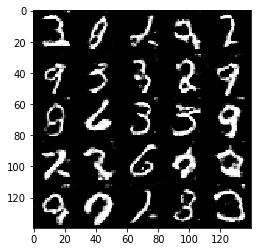

Epoch 1/2... Discriminator Loss: 0.4033... Generator Loss: 2.8224
Epoch 1/2... Discriminator Loss: 0.9063... Generator Loss: 0.8675
Epoch 1/2... Discriminator Loss: 1.3464... Generator Loss: 0.6056
Epoch 1/2... Discriminator Loss: 0.7330... Generator Loss: 1.2609
Epoch 1/2... Discriminator Loss: 1.9173... Generator Loss: 0.2623
Epoch 1/2... Discriminator Loss: 2.6253... Generator Loss: 0.1134
Epoch 1/2... Discriminator Loss: 1.4085... Generator Loss: 0.5026
Epoch 1/2... Discriminator Loss: 2.7198... Generator Loss: 0.1310
Epoch 1/2... Discriminator Loss: 0.9985... Generator Loss: 0.9594
Epoch 1/2... Discriminator Loss: 0.8741... Generator Loss: 1.6122


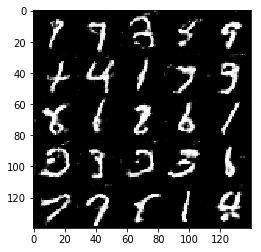

Epoch 1/2... Discriminator Loss: 1.2267... Generator Loss: 0.6704
Epoch 1/2... Discriminator Loss: 0.8606... Generator Loss: 1.0373
Epoch 1/2... Discriminator Loss: 0.8073... Generator Loss: 1.1972
Epoch 1/2... Discriminator Loss: 1.4410... Generator Loss: 0.5473
Epoch 1/2... Discriminator Loss: 0.6907... Generator Loss: 1.3587
Epoch 1/2... Discriminator Loss: 0.5415... Generator Loss: 2.0210
Epoch 1/2... Discriminator Loss: 0.8872... Generator Loss: 1.1663
Epoch 1/2... Discriminator Loss: 0.5154... Generator Loss: 2.0793
Epoch 1/2... Discriminator Loss: 0.5248... Generator Loss: 1.8682
Epoch 1/2... Discriminator Loss: 1.5561... Generator Loss: 0.3682


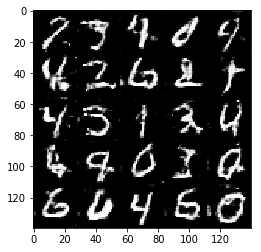

Epoch 1/2... Discriminator Loss: 1.0217... Generator Loss: 0.7625
Epoch 1/2... Discriminator Loss: 0.7265... Generator Loss: 1.4140
Epoch 1/2... Discriminator Loss: 1.1955... Generator Loss: 0.5814
Epoch 1/2... Discriminator Loss: 0.4780... Generator Loss: 2.6089
Epoch 1/2... Discriminator Loss: 2.3421... Generator Loss: 0.3087
Epoch 1/2... Discriminator Loss: 1.4725... Generator Loss: 0.4292
Epoch 1/2... Discriminator Loss: 0.3934... Generator Loss: 3.1753
Epoch 1/2... Discriminator Loss: 1.4150... Generator Loss: 0.5896
Epoch 1/2... Discriminator Loss: 0.6461... Generator Loss: 1.6383
Epoch 1/2... Discriminator Loss: 0.7112... Generator Loss: 1.3443


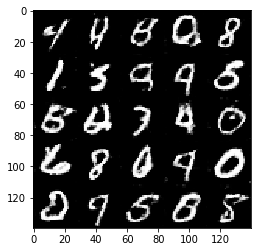

Epoch 1/2... Discriminator Loss: 0.5271... Generator Loss: 2.0776
Epoch 1/2... Discriminator Loss: 0.9557... Generator Loss: 0.8576
Epoch 1/2... Discriminator Loss: 2.2023... Generator Loss: 0.1954
Epoch 1/2... Discriminator Loss: 0.8975... Generator Loss: 1.0208
Epoch 1/2... Discriminator Loss: 1.4210... Generator Loss: 0.4263
Epoch 1/2... Discriminator Loss: 2.4395... Generator Loss: 0.2043
Epoch 1/2... Discriminator Loss: 1.4359... Generator Loss: 0.4548
Epoch 1/2... Discriminator Loss: 2.2523... Generator Loss: 0.2287
Epoch 1/2... Discriminator Loss: 0.6980... Generator Loss: 1.2691
Epoch 1/2... Discriminator Loss: 1.8193... Generator Loss: 0.3127


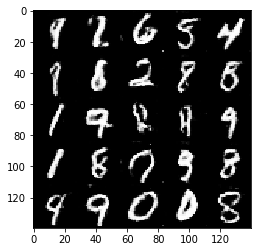

Epoch 1/2... Discriminator Loss: 1.2798... Generator Loss: 0.6487
Epoch 1/2... Discriminator Loss: 0.9034... Generator Loss: 1.1786
Epoch 1/2... Discriminator Loss: 1.1034... Generator Loss: 0.6371
Epoch 1/2... Discriminator Loss: 2.9161... Generator Loss: 0.1075
Epoch 1/2... Discriminator Loss: 0.6178... Generator Loss: 1.4574
Epoch 1/2... Discriminator Loss: 2.2761... Generator Loss: 0.1961
Epoch 1/2... Discriminator Loss: 1.5469... Generator Loss: 0.3586
Epoch 1/2... Discriminator Loss: 0.6838... Generator Loss: 1.2792
Epoch 1/2... Discriminator Loss: 1.5907... Generator Loss: 0.4113
Epoch 1/2... Discriminator Loss: 2.1028... Generator Loss: 0.2779


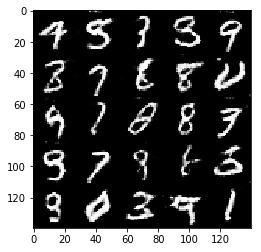

Epoch 1/2... Discriminator Loss: 0.6708... Generator Loss: 1.3640
Epoch 1/2... Discriminator Loss: 0.7102... Generator Loss: 1.3330
Epoch 1/2... Discriminator Loss: 0.6540... Generator Loss: 1.4367
Epoch 1/2... Discriminator Loss: 0.3920... Generator Loss: 3.6958
Epoch 1/2... Discriminator Loss: 0.9859... Generator Loss: 0.8687
Epoch 1/2... Discriminator Loss: 0.4816... Generator Loss: 3.8134
Epoch 1/2... Discriminator Loss: 1.7375... Generator Loss: 0.3009
Epoch 1/2... Discriminator Loss: 0.6877... Generator Loss: 1.2466
Epoch 1/2... Discriminator Loss: 2.2661... Generator Loss: 0.2434
Epoch 1/2... Discriminator Loss: 1.2333... Generator Loss: 0.6324


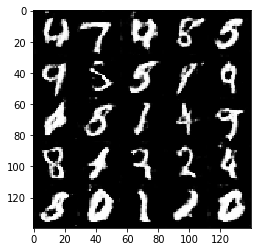

Epoch 1/2... Discriminator Loss: 1.5827... Generator Loss: 0.4713
Epoch 1/2... Discriminator Loss: 1.7476... Generator Loss: 0.4433
Epoch 1/2... Discriminator Loss: 0.6137... Generator Loss: 1.5619
Epoch 1/2... Discriminator Loss: 0.6887... Generator Loss: 1.2400
Epoch 1/2... Discriminator Loss: 2.1921... Generator Loss: 0.2092
Epoch 1/2... Discriminator Loss: 1.0002... Generator Loss: 0.7760
Epoch 1/2... Discriminator Loss: 0.9663... Generator Loss: 0.8406
Epoch 1/2... Discriminator Loss: 3.5786... Generator Loss: 0.0653
Epoch 1/2... Discriminator Loss: 0.9446... Generator Loss: 0.9027
Epoch 1/2... Discriminator Loss: 1.9720... Generator Loss: 0.5017


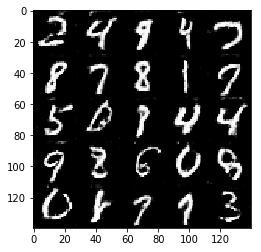

Epoch 1/2... Discriminator Loss: 0.5331... Generator Loss: 1.9208
Epoch 1/2... Discriminator Loss: 1.0001... Generator Loss: 0.7412
Epoch 1/2... Discriminator Loss: 1.2366... Generator Loss: 0.7190
Epoch 1/2... Discriminator Loss: 1.2056... Generator Loss: 0.7461
Epoch 1/2... Discriminator Loss: 1.3410... Generator Loss: 0.4818
Epoch 1/2... Discriminator Loss: 0.9491... Generator Loss: 0.8470
Epoch 1/2... Discriminator Loss: 0.8699... Generator Loss: 1.0060
Epoch 1/2... Discriminator Loss: 1.1010... Generator Loss: 0.8727
Epoch 1/2... Discriminator Loss: 1.9264... Generator Loss: 0.3693
Epoch 1/2... Discriminator Loss: 0.9258... Generator Loss: 0.8640


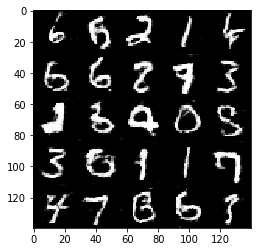

Epoch 1/2... Discriminator Loss: 0.9258... Generator Loss: 0.8640
Epoch 2/2... Discriminator Loss: 0.8394... Generator Loss: 1.0769
Epoch 2/2... Discriminator Loss: 0.8541... Generator Loss: 1.2399
Epoch 2/2... Discriminator Loss: 3.3435... Generator Loss: 0.0863
Epoch 2/2... Discriminator Loss: 1.0758... Generator Loss: 4.1815
Epoch 2/2... Discriminator Loss: 0.7038... Generator Loss: 1.3370
Epoch 2/2... Discriminator Loss: 0.7926... Generator Loss: 1.2579
Epoch 2/2... Discriminator Loss: 0.6793... Generator Loss: 2.9973
Epoch 2/2... Discriminator Loss: 1.0019... Generator Loss: 0.8379
Epoch 2/2... Discriminator Loss: 0.7962... Generator Loss: 1.2379
Epoch 2/2... Discriminator Loss: 1.7071... Generator Loss: 0.3305


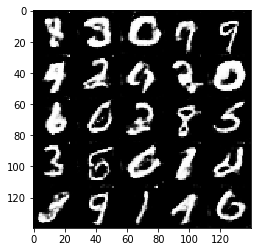

Epoch 2/2... Discriminator Loss: 1.3979... Generator Loss: 0.4560
Epoch 2/2... Discriminator Loss: 0.8669... Generator Loss: 1.1375
Epoch 2/2... Discriminator Loss: 0.8720... Generator Loss: 1.0497
Epoch 2/2... Discriminator Loss: 0.9862... Generator Loss: 0.7763
Epoch 2/2... Discriminator Loss: 1.4510... Generator Loss: 0.4901
Epoch 2/2... Discriminator Loss: 0.8380... Generator Loss: 1.1826
Epoch 2/2... Discriminator Loss: 1.6229... Generator Loss: 0.3690
Epoch 2/2... Discriminator Loss: 0.5901... Generator Loss: 1.5582
Epoch 2/2... Discriminator Loss: 1.8422... Generator Loss: 0.5186
Epoch 2/2... Discriminator Loss: 0.6001... Generator Loss: 1.6051


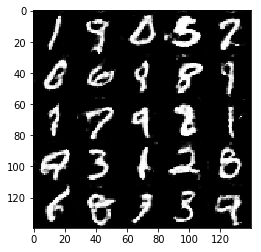

Epoch 2/2... Discriminator Loss: 0.5158... Generator Loss: 2.2274
Epoch 2/2... Discriminator Loss: 1.2537... Generator Loss: 0.7473
Epoch 2/2... Discriminator Loss: 0.6750... Generator Loss: 1.5743
Epoch 2/2... Discriminator Loss: 1.3597... Generator Loss: 0.5639
Epoch 2/2... Discriminator Loss: 0.9521... Generator Loss: 1.0922
Epoch 2/2... Discriminator Loss: 0.7857... Generator Loss: 1.1248
Epoch 2/2... Discriminator Loss: 2.4449... Generator Loss: 0.2218
Epoch 2/2... Discriminator Loss: 0.7709... Generator Loss: 1.5040
Epoch 2/2... Discriminator Loss: 1.2216... Generator Loss: 0.9255
Epoch 2/2... Discriminator Loss: 0.4576... Generator Loss: 2.2451


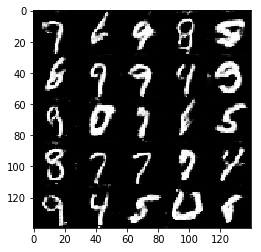

Epoch 2/2... Discriminator Loss: 0.7384... Generator Loss: 1.3159
Epoch 2/2... Discriminator Loss: 0.7287... Generator Loss: 1.2633
Epoch 2/2... Discriminator Loss: 0.7137... Generator Loss: 1.3188
Epoch 2/2... Discriminator Loss: 0.9859... Generator Loss: 0.7582
Epoch 2/2... Discriminator Loss: 1.4063... Generator Loss: 0.5354
Epoch 2/2... Discriminator Loss: 0.5651... Generator Loss: 1.6214
Epoch 2/2... Discriminator Loss: 0.5865... Generator Loss: 1.6863
Epoch 2/2... Discriminator Loss: 2.3740... Generator Loss: 0.2143
Epoch 2/2... Discriminator Loss: 0.6347... Generator Loss: 1.8265
Epoch 2/2... Discriminator Loss: 0.7050... Generator Loss: 1.3645


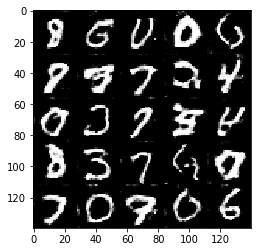

Epoch 2/2... Discriminator Loss: 1.5950... Generator Loss: 0.4497
Epoch 2/2... Discriminator Loss: 0.4882... Generator Loss: 2.1430
Epoch 2/2... Discriminator Loss: 0.9134... Generator Loss: 0.9416
Epoch 2/2... Discriminator Loss: 0.5822... Generator Loss: 1.8038
Epoch 2/2... Discriminator Loss: 2.6046... Generator Loss: 0.1870
Epoch 2/2... Discriminator Loss: 0.6849... Generator Loss: 1.2813
Epoch 2/2... Discriminator Loss: 1.4564... Generator Loss: 0.4636
Epoch 2/2... Discriminator Loss: 1.9062... Generator Loss: 0.2640
Epoch 2/2... Discriminator Loss: 0.7770... Generator Loss: 2.2486
Epoch 2/2... Discriminator Loss: 1.7826... Generator Loss: 0.4689


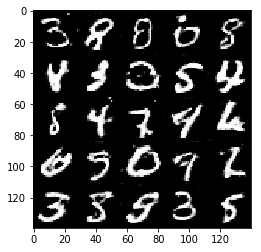

Epoch 2/2... Discriminator Loss: 1.1770... Generator Loss: 0.6231
Epoch 2/2... Discriminator Loss: 1.1356... Generator Loss: 0.6856
Epoch 2/2... Discriminator Loss: 0.7169... Generator Loss: 1.2697
Epoch 2/2... Discriminator Loss: 0.5496... Generator Loss: 1.9399
Epoch 2/2... Discriminator Loss: 1.5322... Generator Loss: 0.3934
Epoch 2/2... Discriminator Loss: 1.8243... Generator Loss: 0.3063
Epoch 2/2... Discriminator Loss: 1.4594... Generator Loss: 0.4381
Epoch 2/2... Discriminator Loss: 1.0359... Generator Loss: 1.0082
Epoch 2/2... Discriminator Loss: 0.5925... Generator Loss: 1.5771
Epoch 2/2... Discriminator Loss: 1.5536... Generator Loss: 0.3592


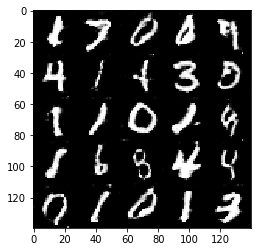

Epoch 2/2... Discriminator Loss: 0.5707... Generator Loss: 1.9532
Epoch 2/2... Discriminator Loss: 0.5016... Generator Loss: 2.3160
Epoch 2/2... Discriminator Loss: 1.0898... Generator Loss: 0.7345
Epoch 2/2... Discriminator Loss: 1.5276... Generator Loss: 0.3740
Epoch 2/2... Discriminator Loss: 1.0348... Generator Loss: 0.8117
Epoch 2/2... Discriminator Loss: 0.7543... Generator Loss: 1.1482
Epoch 2/2... Discriminator Loss: 2.8887... Generator Loss: 0.1304
Epoch 2/2... Discriminator Loss: 1.9576... Generator Loss: 0.4131
Epoch 2/2... Discriminator Loss: 0.9279... Generator Loss: 1.1217
Epoch 2/2... Discriminator Loss: 0.7685... Generator Loss: 1.0682


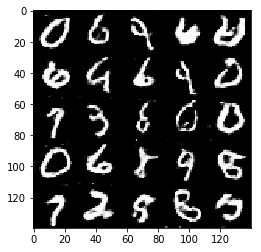

Epoch 2/2... Discriminator Loss: 0.8930... Generator Loss: 0.9056
Epoch 2/2... Discriminator Loss: 0.5099... Generator Loss: 2.0714
Epoch 2/2... Discriminator Loss: 1.3885... Generator Loss: 0.5888
Epoch 2/2... Discriminator Loss: 1.2374... Generator Loss: 0.5808
Epoch 2/2... Discriminator Loss: 0.7768... Generator Loss: 1.1610
Epoch 2/2... Discriminator Loss: 1.8597... Generator Loss: 0.2545
Epoch 2/2... Discriminator Loss: 0.9169... Generator Loss: 0.8433
Epoch 2/2... Discriminator Loss: 0.5319... Generator Loss: 1.9349
Epoch 2/2... Discriminator Loss: 0.6804... Generator Loss: 4.1073
Epoch 2/2... Discriminator Loss: 1.7802... Generator Loss: 0.2957


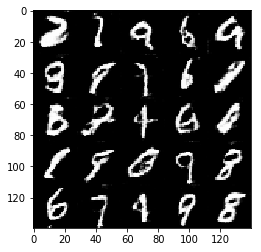

Epoch 2/2... Discriminator Loss: 0.8112... Generator Loss: 1.0665
Epoch 2/2... Discriminator Loss: 0.9375... Generator Loss: 1.1805
Epoch 2/2... Discriminator Loss: 0.8475... Generator Loss: 0.9634
Epoch 2/2... Discriminator Loss: 0.8673... Generator Loss: 0.9497
Epoch 2/2... Discriminator Loss: 1.5663... Generator Loss: 0.3855
Epoch 2/2... Discriminator Loss: 0.4950... Generator Loss: 2.3662
Epoch 2/2... Discriminator Loss: 0.9567... Generator Loss: 0.9640
Epoch 2/2... Discriminator Loss: 0.6370... Generator Loss: 1.6325
Epoch 2/2... Discriminator Loss: 1.1190... Generator Loss: 0.6555
Epoch 2/2... Discriminator Loss: 0.8349... Generator Loss: 1.0457


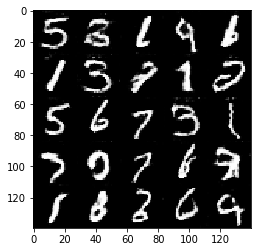

Epoch 2/2... Discriminator Loss: 1.5093... Generator Loss: 0.4158
Epoch 2/2... Discriminator Loss: 0.4243... Generator Loss: 3.3341
Epoch 2/2... Discriminator Loss: 1.9794... Generator Loss: 0.2794
Epoch 2/2... Discriminator Loss: 1.2199... Generator Loss: 0.5733
Epoch 2/2... Discriminator Loss: 0.9110... Generator Loss: 0.8723
Epoch 2/2... Discriminator Loss: 2.3359... Generator Loss: 0.2437
Epoch 2/2... Discriminator Loss: 2.1344... Generator Loss: 0.1955
Epoch 2/2... Discriminator Loss: 1.2734... Generator Loss: 0.5424
Epoch 2/2... Discriminator Loss: 1.8249... Generator Loss: 0.2799
Epoch 2/2... Discriminator Loss: 0.7198... Generator Loss: 1.6771


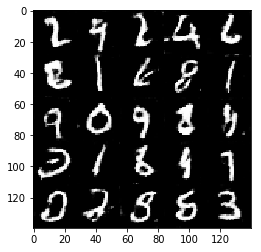

Epoch 2/2... Discriminator Loss: 1.3061... Generator Loss: 0.6185
Epoch 2/2... Discriminator Loss: 1.8164... Generator Loss: 0.5116
Epoch 2/2... Discriminator Loss: 2.1311... Generator Loss: 5.9934
Epoch 2/2... Discriminator Loss: 0.7694... Generator Loss: 1.2497
Epoch 2/2... Discriminator Loss: 1.4198... Generator Loss: 0.5630
Epoch 2/2... Discriminator Loss: 1.2308... Generator Loss: 0.5893
Epoch 2/2... Discriminator Loss: 1.7941... Generator Loss: 0.3524
Epoch 2/2... Discriminator Loss: 1.5232... Generator Loss: 0.4114
Epoch 2/2... Discriminator Loss: 1.2023... Generator Loss: 0.6273
Epoch 2/2... Discriminator Loss: 0.8633... Generator Loss: 0.9172


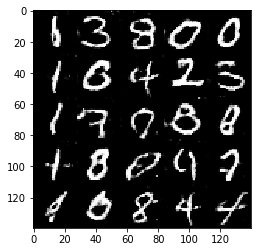

Epoch 2/2... Discriminator Loss: 0.4560... Generator Loss: 2.4711
Epoch 2/2... Discriminator Loss: 0.5751... Generator Loss: 2.5137
Epoch 2/2... Discriminator Loss: 0.7519... Generator Loss: 1.2169
Epoch 2/2... Discriminator Loss: 0.8568... Generator Loss: 0.9117
Epoch 2/2... Discriminator Loss: 0.5093... Generator Loss: 1.9699
Epoch 2/2... Discriminator Loss: 1.4589... Generator Loss: 0.4494
Epoch 2/2... Discriminator Loss: 2.5128... Generator Loss: 0.2180
Epoch 2/2... Discriminator Loss: 0.4514... Generator Loss: 2.3933
Epoch 2/2... Discriminator Loss: 0.9229... Generator Loss: 1.0178
Epoch 2/2... Discriminator Loss: 0.3697... Generator Loss: 3.8304


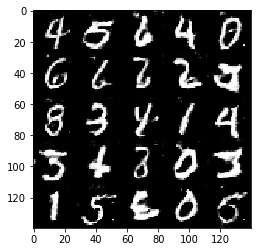

Epoch 2/2... Discriminator Loss: 0.7278... Generator Loss: 1.5138
Epoch 2/2... Discriminator Loss: 0.4375... Generator Loss: 2.6525
Epoch 2/2... Discriminator Loss: 1.8614... Generator Loss: 0.3707
Epoch 2/2... Discriminator Loss: 0.6579... Generator Loss: 1.3990
Epoch 2/2... Discriminator Loss: 0.5057... Generator Loss: 1.9014
Epoch 2/2... Discriminator Loss: 0.6538... Generator Loss: 1.3515
Epoch 2/2... Discriminator Loss: 0.9906... Generator Loss: 0.8372
Epoch 2/2... Discriminator Loss: 1.3976... Generator Loss: 0.7402
Epoch 2/2... Discriminator Loss: 0.4462... Generator Loss: 2.3352
Epoch 2/2... Discriminator Loss: 2.5285... Generator Loss: 0.1573


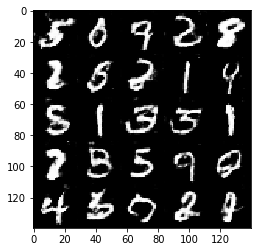

Epoch 2/2... Discriminator Loss: 0.5730... Generator Loss: 1.6333
Epoch 2/2... Discriminator Loss: 1.7817... Generator Loss: 0.3055
Epoch 2/2... Discriminator Loss: 1.1711... Generator Loss: 0.6546
Epoch 2/2... Discriminator Loss: 1.6139... Generator Loss: 0.4224
Epoch 2/2... Discriminator Loss: 1.8966... Generator Loss: 0.2983
Epoch 2/2... Discriminator Loss: 0.6381... Generator Loss: 1.3818
Epoch 2/2... Discriminator Loss: 3.0009... Generator Loss: 0.1143
Epoch 2/2... Discriminator Loss: 0.7140... Generator Loss: 1.3443
Epoch 2/2... Discriminator Loss: 1.3514... Generator Loss: 0.5272
Epoch 2/2... Discriminator Loss: 0.6513... Generator Loss: 1.3387


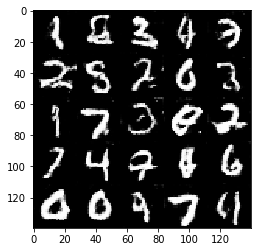

Epoch 2/2... Discriminator Loss: 1.4360... Generator Loss: 0.4740
Epoch 2/2... Discriminator Loss: 0.9931... Generator Loss: 0.9163
Epoch 2/2... Discriminator Loss: 0.5364... Generator Loss: 1.9506
Epoch 2/2... Discriminator Loss: 0.8738... Generator Loss: 1.0043
Epoch 2/2... Discriminator Loss: 0.6122... Generator Loss: 2.6282
Epoch 2/2... Discriminator Loss: 1.6646... Generator Loss: 0.3954
Epoch 2/2... Discriminator Loss: 0.9625... Generator Loss: 4.0262
Epoch 2/2... Discriminator Loss: 1.6497... Generator Loss: 0.3514
Epoch 2/2... Discriminator Loss: 0.8072... Generator Loss: 1.1079
Epoch 2/2... Discriminator Loss: 1.0952... Generator Loss: 0.6531


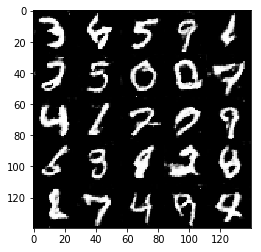

Epoch 2/2... Discriminator Loss: 0.8412... Generator Loss: 1.1417
Epoch 2/2... Discriminator Loss: 0.7328... Generator Loss: 1.3360
Epoch 2/2... Discriminator Loss: 0.9629... Generator Loss: 1.0447
Epoch 2/2... Discriminator Loss: 1.0212... Generator Loss: 0.8828
Epoch 2/2... Discriminator Loss: 0.9614... Generator Loss: 0.8598
Epoch 2/2... Discriminator Loss: 0.6698... Generator Loss: 1.2910
Epoch 2/2... Discriminator Loss: 0.6828... Generator Loss: 1.2973
Epoch 2/2... Discriminator Loss: 0.8330... Generator Loss: 1.0183
Epoch 2/2... Discriminator Loss: 1.6139... Generator Loss: 0.3578
Epoch 2/2... Discriminator Loss: 1.0295... Generator Loss: 3.0290


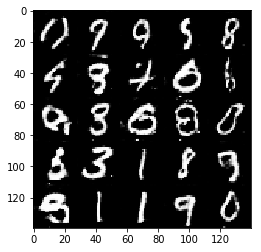

Epoch 2/2... Discriminator Loss: 1.1199... Generator Loss: 0.6332
Epoch 2/2... Discriminator Loss: 0.5054... Generator Loss: 2.0853
Epoch 2/2... Discriminator Loss: 0.5815... Generator Loss: 1.6166
Epoch 2/2... Discriminator Loss: 0.8114... Generator Loss: 0.9921
Epoch 2/2... Discriminator Loss: 2.1162... Generator Loss: 0.3225
Epoch 2/2... Discriminator Loss: 0.7563... Generator Loss: 4.1735
Epoch 2/2... Discriminator Loss: 0.6383... Generator Loss: 1.7378
Epoch 2/2... Discriminator Loss: 0.6117... Generator Loss: 1.4682
Epoch 2/2... Discriminator Loss: 0.7481... Generator Loss: 1.3286
Epoch 2/2... Discriminator Loss: 0.8959... Generator Loss: 1.2068


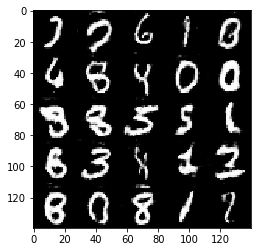

Epoch 2/2... Discriminator Loss: 0.6416... Generator Loss: 1.4940
Epoch 2/2... Discriminator Loss: 0.8425... Generator Loss: 1.0877
Epoch 2/2... Discriminator Loss: 0.5063... Generator Loss: 2.1767
Epoch 2/2... Discriminator Loss: 0.5912... Generator Loss: 1.7637
Epoch 2/2... Discriminator Loss: 0.6832... Generator Loss: 1.3326
Epoch 2/2... Discriminator Loss: 2.1051... Generator Loss: 0.2119
Epoch 2/2... Discriminator Loss: 2.2956... Generator Loss: 0.1966
Epoch 2/2... Discriminator Loss: 0.5862... Generator Loss: 1.5973
Epoch 2/2... Discriminator Loss: 0.8483... Generator Loss: 1.0877
Epoch 2/2... Discriminator Loss: 1.1622... Generator Loss: 0.6045


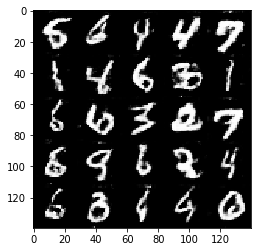

Epoch 2/2... Discriminator Loss: 0.6697... Generator Loss: 1.5135
Epoch 2/2... Discriminator Loss: 0.8062... Generator Loss: 1.0044
Epoch 2/2... Discriminator Loss: 0.9020... Generator Loss: 0.9064
Epoch 2/2... Discriminator Loss: 1.0998... Generator Loss: 0.8063
Epoch 2/2... Discriminator Loss: 0.9677... Generator Loss: 0.8266
Epoch 2/2... Discriminator Loss: 2.3232... Generator Loss: 0.2093
Epoch 2/2... Discriminator Loss: 0.5729... Generator Loss: 1.8495
Epoch 2/2... Discriminator Loss: 0.6304... Generator Loss: 1.4680
Epoch 2/2... Discriminator Loss: 0.7548... Generator Loss: 1.1941
Epoch 2/2... Discriminator Loss: 0.7224... Generator Loss: 1.1710


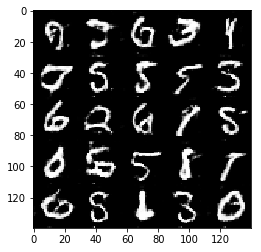

Epoch 2/2... Discriminator Loss: 0.7271... Generator Loss: 1.2103
Epoch 2/2... Discriminator Loss: 0.7556... Generator Loss: 1.1908
Epoch 2/2... Discriminator Loss: 0.5103... Generator Loss: 2.1124
Epoch 2/2... Discriminator Loss: 0.5968... Generator Loss: 1.7793
Epoch 2/2... Discriminator Loss: 0.6931... Generator Loss: 4.0666
Epoch 2/2... Discriminator Loss: 2.1314... Generator Loss: 0.2546
Epoch 2/2... Discriminator Loss: 0.5430... Generator Loss: 1.8087
Epoch 2/2... Discriminator Loss: 0.7318... Generator Loss: 1.3525
Epoch 2/2... Discriminator Loss: 1.1925... Generator Loss: 0.7425
Epoch 2/2... Discriminator Loss: 0.7908... Generator Loss: 1.0743


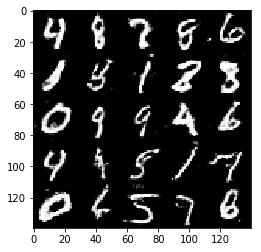

Epoch 2/2... Discriminator Loss: 0.9321... Generator Loss: 0.9148
Epoch 2/2... Discriminator Loss: 0.6323... Generator Loss: 1.5598
Epoch 2/2... Discriminator Loss: 1.3302... Generator Loss: 0.5399
Epoch 2/2... Discriminator Loss: 1.5838... Generator Loss: 0.3840
Epoch 2/2... Discriminator Loss: 1.1746... Generator Loss: 0.6296
Epoch 2/2... Discriminator Loss: 0.6564... Generator Loss: 3.3582
Epoch 2/2... Discriminator Loss: 1.2761... Generator Loss: 0.5568
Epoch 2/2... Discriminator Loss: 0.8221... Generator Loss: 1.1792
Epoch 2/2... Discriminator Loss: 0.7951... Generator Loss: 1.1908
Epoch 2/2... Discriminator Loss: 2.0872... Generator Loss: 0.2752


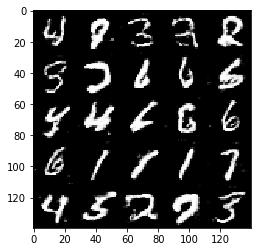

Epoch 2/2... Discriminator Loss: 0.6048... Generator Loss: 1.6303
Epoch 2/2... Discriminator Loss: 0.8781... Generator Loss: 1.0400
Epoch 2/2... Discriminator Loss: 1.8896... Generator Loss: 0.3543
Epoch 2/2... Discriminator Loss: 1.1393... Generator Loss: 0.6339
Epoch 2/2... Discriminator Loss: 1.5150... Generator Loss: 0.4296
Epoch 2/2... Discriminator Loss: 2.2359... Generator Loss: 0.2304
Epoch 2/2... Discriminator Loss: 1.5287... Generator Loss: 0.4231
Epoch 2/2... Discriminator Loss: 1.5061... Generator Loss: 0.7577
Epoch 2/2... Discriminator Loss: 1.2635... Generator Loss: 0.7325
Epoch 2/2... Discriminator Loss: 0.6556... Generator Loss: 1.4977


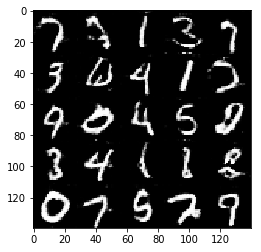

Epoch 2/2... Discriminator Loss: 1.3627... Generator Loss: 0.5840
Epoch 2/2... Discriminator Loss: 1.4116... Generator Loss: 0.5094
Epoch 2/2... Discriminator Loss: 0.7720... Generator Loss: 1.0763
Epoch 2/2... Discriminator Loss: 0.4453... Generator Loss: 2.2809
Epoch 2/2... Discriminator Loss: 1.2306... Generator Loss: 0.6102
Epoch 2/2... Discriminator Loss: 0.7410... Generator Loss: 1.4313
Epoch 2/2... Discriminator Loss: 1.1416... Generator Loss: 0.6232
Epoch 2/2... Discriminator Loss: 0.6484... Generator Loss: 1.4420
Epoch 2/2... Discriminator Loss: 0.9249... Generator Loss: 0.8953
Epoch 2/2... Discriminator Loss: 0.8610... Generator Loss: 1.0600


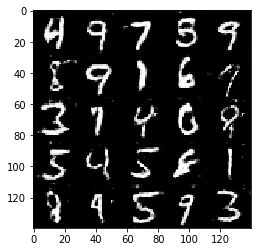

Epoch 2/2... Discriminator Loss: 2.8586... Generator Loss: 0.1476
Epoch 2/2... Discriminator Loss: 0.6204... Generator Loss: 1.5129
Epoch 2/2... Discriminator Loss: 1.0986... Generator Loss: 0.7513
Epoch 2/2... Discriminator Loss: 0.4758... Generator Loss: 2.0500
Epoch 2/2... Discriminator Loss: 0.8667... Generator Loss: 1.0277
Epoch 2/2... Discriminator Loss: 0.4997... Generator Loss: 1.9159
Epoch 2/2... Discriminator Loss: 1.3973... Generator Loss: 0.4598
Epoch 2/2... Discriminator Loss: 0.8919... Generator Loss: 0.8970
Epoch 2/2... Discriminator Loss: 1.3500... Generator Loss: 0.4551
Epoch 2/2... Discriminator Loss: 0.5013... Generator Loss: 2.3127


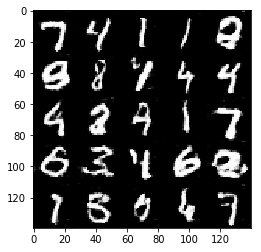

Epoch 2/2... Discriminator Loss: 0.5823... Generator Loss: 2.3667
Epoch 2/2... Discriminator Loss: 1.3884... Generator Loss: 0.5291
Epoch 2/2... Discriminator Loss: 0.5384... Generator Loss: 1.7095
Epoch 2/2... Discriminator Loss: 2.5894... Generator Loss: 0.1656
Epoch 2/2... Discriminator Loss: 0.5338... Generator Loss: 2.0443
Epoch 2/2... Discriminator Loss: 1.1280... Generator Loss: 0.8276
Epoch 2/2... Discriminator Loss: 1.9154... Generator Loss: 0.2474
Epoch 2/2... Discriminator Loss: 1.1948... Generator Loss: 0.7698
Epoch 2/2... Discriminator Loss: 0.9510... Generator Loss: 2.6957
Epoch 2/2... Discriminator Loss: 0.6155... Generator Loss: 1.6870


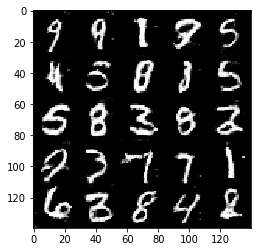

Epoch 2/2... Discriminator Loss: 0.8025... Generator Loss: 1.0418
Epoch 2/2... Discriminator Loss: 1.8549... Generator Loss: 0.3481
Epoch 2/2... Discriminator Loss: 0.8685... Generator Loss: 2.1944
Epoch 2/2... Discriminator Loss: 1.4654... Generator Loss: 0.4423
Epoch 2/2... Discriminator Loss: 0.9054... Generator Loss: 1.0426
Epoch 2/2... Discriminator Loss: 2.6859... Generator Loss: 0.1393
Epoch 2/2... Discriminator Loss: 2.3011... Generator Loss: 0.2403
Epoch 2/2... Discriminator Loss: 0.6820... Generator Loss: 1.2859
Epoch 2/2... Discriminator Loss: 1.7036... Generator Loss: 0.3882
Epoch 2/2... Discriminator Loss: 0.3979... Generator Loss: 3.9558


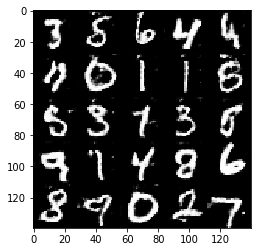

Epoch 2/2... Discriminator Loss: 0.4273... Generator Loss: 2.7194
Epoch 2/2... Discriminator Loss: 0.8314... Generator Loss: 1.0021
Epoch 2/2... Discriminator Loss: 0.6560... Generator Loss: 1.6412
Epoch 2/2... Discriminator Loss: 0.6133... Generator Loss: 1.5921
Epoch 2/2... Discriminator Loss: 0.4269... Generator Loss: 2.8522
Epoch 2/2... Discriminator Loss: 0.6260... Generator Loss: 1.5919
Epoch 2/2... Discriminator Loss: 0.3665... Generator Loss: 3.5498
Epoch 2/2... Discriminator Loss: 0.5505... Generator Loss: 2.2733
Epoch 2/2... Discriminator Loss: 0.6032... Generator Loss: 2.1254
Epoch 2/2... Discriminator Loss: 1.0070... Generator Loss: 3.8496


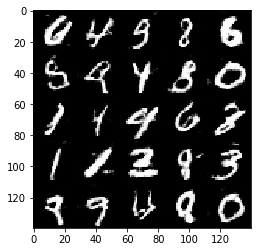

Epoch 2/2... Discriminator Loss: 2.1871... Generator Loss: 0.2109
Epoch 2/2... Discriminator Loss: 0.7129... Generator Loss: 1.2580
Epoch 2/2... Discriminator Loss: 1.6862... Generator Loss: 0.3203
Epoch 2/2... Discriminator Loss: 0.8297... Generator Loss: 0.9992
Epoch 2/2... Discriminator Loss: 0.6890... Generator Loss: 1.3712
Epoch 2/2... Discriminator Loss: 0.6481... Generator Loss: 1.3856
Epoch 2/2... Discriminator Loss: 0.3928... Generator Loss: 3.0713
Epoch 2/2... Discriminator Loss: 0.7607... Generator Loss: 1.2416
Epoch 2/2... Discriminator Loss: 0.7941... Generator Loss: 1.1159
Epoch 2/2... Discriminator Loss: 1.3015... Generator Loss: 0.8387


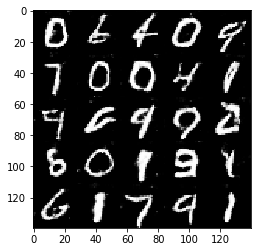

Epoch 2/2... Discriminator Loss: 1.2809... Generator Loss: 0.6453
Epoch 2/2... Discriminator Loss: 0.5884... Generator Loss: 1.5230
Epoch 2/2... Discriminator Loss: 0.5015... Generator Loss: 2.0049
Epoch 2/2... Discriminator Loss: 0.7722... Generator Loss: 1.1120
Epoch 2/2... Discriminator Loss: 0.6668... Generator Loss: 1.3575
Epoch 2/2... Discriminator Loss: 1.1533... Generator Loss: 0.6314
Epoch 2/2... Discriminator Loss: 0.8915... Generator Loss: 1.0499
Epoch 2/2... Discriminator Loss: 0.4370... Generator Loss: 2.3910
Epoch 2/2... Discriminator Loss: 0.9416... Generator Loss: 0.8922
Epoch 2/2... Discriminator Loss: 2.4790... Generator Loss: 0.1696


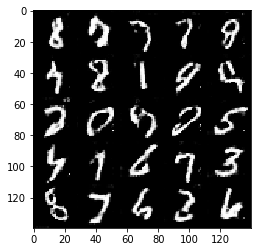

Epoch 2/2... Discriminator Loss: 1.3443... Generator Loss: 0.5164
Epoch 2/2... Discriminator Loss: 1.8234... Generator Loss: 0.2834
Epoch 2/2... Discriminator Loss: 1.1785... Generator Loss: 0.5945
Epoch 2/2... Discriminator Loss: 1.7050... Generator Loss: 0.3092
Epoch 2/2... Discriminator Loss: 1.1790... Generator Loss: 0.6828
Epoch 2/2... Discriminator Loss: 0.4980... Generator Loss: 3.5525
Epoch 2/2... Discriminator Loss: 2.8470... Generator Loss: 0.1155
Epoch 2/2... Discriminator Loss: 0.7514... Generator Loss: 1.3686
Epoch 2/2... Discriminator Loss: 0.4334... Generator Loss: 2.4775
Epoch 2/2... Discriminator Loss: 2.3882... Generator Loss: 0.2110


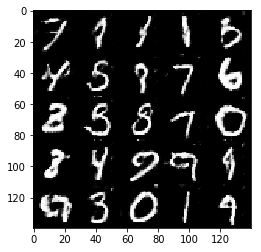

Epoch 2/2... Discriminator Loss: 0.9227... Generator Loss: 0.9021
Epoch 2/2... Discriminator Loss: 0.5535... Generator Loss: 1.7975
Epoch 2/2... Discriminator Loss: 0.7432... Generator Loss: 1.4339
Epoch 2/2... Discriminator Loss: 0.3983... Generator Loss: 3.0380
Epoch 2/2... Discriminator Loss: 0.4053... Generator Loss: 3.2323
Epoch 2/2... Discriminator Loss: 0.4111... Generator Loss: 2.8784
Epoch 2/2... Discriminator Loss: 1.9174... Generator Loss: 0.4497
Epoch 2/2... Discriminator Loss: 0.6962... Generator Loss: 1.3471
Epoch 2/2... Discriminator Loss: 0.6856... Generator Loss: 1.3169
Epoch 2/2... Discriminator Loss: 1.3966... Generator Loss: 0.5830


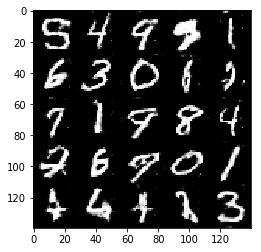

Epoch 2/2... Discriminator Loss: 0.6292... Generator Loss: 3.3045
Epoch 2/2... Discriminator Loss: 1.7090... Generator Loss: 0.3763
Epoch 2/2... Discriminator Loss: 0.8100... Generator Loss: 1.0534
Epoch 2/2... Discriminator Loss: 0.7958... Generator Loss: 1.1393
Epoch 2/2... Discriminator Loss: 1.5108... Generator Loss: 0.4227
Epoch 2/2... Discriminator Loss: 2.4141... Generator Loss: 0.1688
Epoch 2/2... Discriminator Loss: 0.7973... Generator Loss: 1.0745
Epoch 2/2... Discriminator Loss: 1.8695... Generator Loss: 0.3737
Epoch 2/2... Discriminator Loss: 1.6778... Generator Loss: 0.5371
Epoch 2/2... Discriminator Loss: 1.2643... Generator Loss: 4.5714


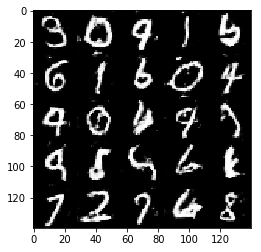

Epoch 2/2... Discriminator Loss: 0.7413... Generator Loss: 1.1362
Epoch 2/2... Discriminator Loss: 0.9988... Generator Loss: 0.8605
Epoch 2/2... Discriminator Loss: 1.5089... Generator Loss: 0.6136
Epoch 2/2... Discriminator Loss: 0.6271... Generator Loss: 1.5770
Epoch 2/2... Discriminator Loss: 0.8035... Generator Loss: 1.0349
Epoch 2/2... Discriminator Loss: 1.6845... Generator Loss: 0.3569
Epoch 2/2... Discriminator Loss: 2.0722... Generator Loss: 0.2654
Epoch 2/2... Discriminator Loss: 0.6569... Generator Loss: 1.5913
Epoch 2/2... Discriminator Loss: 0.6248... Generator Loss: 1.4020
Epoch 2/2... Discriminator Loss: 1.5652... Generator Loss: 0.4290


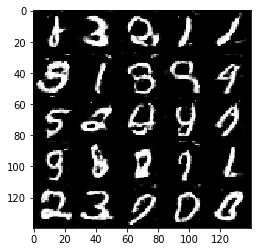

Epoch 2/2... Discriminator Loss: 0.9068... Generator Loss: 0.9793
Epoch 2/2... Discriminator Loss: 0.5800... Generator Loss: 1.7099
Epoch 2/2... Discriminator Loss: 0.5250... Generator Loss: 2.0852
Epoch 2/2... Discriminator Loss: 0.6699... Generator Loss: 1.4486
Epoch 2/2... Discriminator Loss: 0.8262... Generator Loss: 1.0770
Epoch 2/2... Discriminator Loss: 0.9642... Generator Loss: 0.8796
Epoch 2/2... Discriminator Loss: 0.7380... Generator Loss: 1.1593
Epoch 2/2... Discriminator Loss: 0.8430... Generator Loss: 1.1139
Epoch 2/2... Discriminator Loss: 1.0661... Generator Loss: 0.7674
Epoch 2/2... Discriminator Loss: 0.6309... Generator Loss: 1.6047


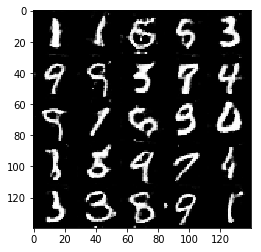

Epoch 2/2... Discriminator Loss: 1.1049... Generator Loss: 2.9208
Epoch 2/2... Discriminator Loss: 1.2962... Generator Loss: 0.5405
Epoch 2/2... Discriminator Loss: 0.6827... Generator Loss: 1.3868
Epoch 2/2... Discriminator Loss: 1.8963... Generator Loss: 0.4450
Epoch 2/2... Discriminator Loss: 1.2420... Generator Loss: 0.5517
Epoch 2/2... Discriminator Loss: 0.9446... Generator Loss: 0.8642
Epoch 2/2... Discriminator Loss: 0.5881... Generator Loss: 1.8091
Epoch 2/2... Discriminator Loss: 1.5466... Generator Loss: 0.4394
Epoch 2/2... Discriminator Loss: 0.8823... Generator Loss: 0.8888
Epoch 2/2... Discriminator Loss: 0.6661... Generator Loss: 1.3030


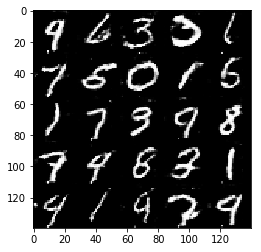

Epoch 2/2... Discriminator Loss: 1.1158... Generator Loss: 0.6352
Epoch 2/2... Discriminator Loss: 0.8737... Generator Loss: 2.9512
Epoch 2/2... Discriminator Loss: 1.2414... Generator Loss: 0.5781
Epoch 2/2... Discriminator Loss: 1.1798... Generator Loss: 0.6143
Epoch 2/2... Discriminator Loss: 0.9398... Generator Loss: 0.8929
Epoch 2/2... Discriminator Loss: 0.5794... Generator Loss: 1.6719
Epoch 2/2... Discriminator Loss: 0.8339... Generator Loss: 0.9930
Epoch 2/2... Discriminator Loss: 0.8007... Generator Loss: 1.0921
Epoch 2/2... Discriminator Loss: 1.3273... Generator Loss: 0.6038
Epoch 2/2... Discriminator Loss: 1.2145... Generator Loss: 0.6788


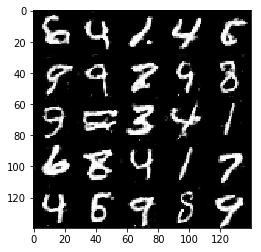

Epoch 2/2... Discriminator Loss: 1.4273... Generator Loss: 0.5124
Epoch 2/2... Discriminator Loss: 1.3113... Generator Loss: 0.5107
Epoch 2/2... Discriminator Loss: 1.9044... Generator Loss: 0.4823
Epoch 2/2... Discriminator Loss: 1.1534... Generator Loss: 0.8356
Epoch 2/2... Discriminator Loss: 0.6359... Generator Loss: 1.4199
Epoch 2/2... Discriminator Loss: 0.7499... Generator Loss: 1.1938
Epoch 2/2... Discriminator Loss: 1.9574... Generator Loss: 0.2893
Epoch 2/2... Discriminator Loss: 0.5275... Generator Loss: 1.8139
Epoch 2/2... Discriminator Loss: 1.5953... Generator Loss: 0.4432
Epoch 2/2... Discriminator Loss: 0.7907... Generator Loss: 1.2631


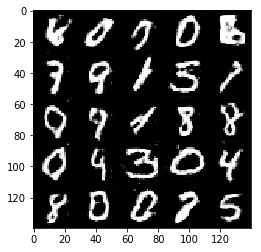

Epoch 2/2... Discriminator Loss: 0.5204... Generator Loss: 1.9581
Epoch 2/2... Discriminator Loss: 0.8773... Generator Loss: 0.8808
Epoch 2/2... Discriminator Loss: 1.0496... Generator Loss: 0.9127
Epoch 2/2... Discriminator Loss: 1.4615... Generator Loss: 0.4587
Epoch 2/2... Discriminator Loss: 1.6948... Generator Loss: 0.3688
Epoch 2/2... Discriminator Loss: 0.9306... Generator Loss: 0.8940
Epoch 2/2... Discriminator Loss: 0.8150... Generator Loss: 1.2757
Epoch 2/2... Discriminator Loss: 0.5969... Generator Loss: 2.6438
Epoch 2/2... Discriminator Loss: 0.7964... Generator Loss: 1.0828
Epoch 2/2... Discriminator Loss: 0.8717... Generator Loss: 1.2206


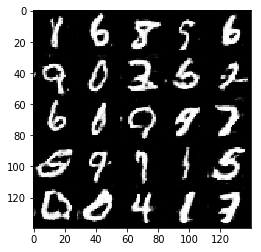

Epoch 2/2... Discriminator Loss: 0.8623... Generator Loss: 2.8242
Epoch 2/2... Discriminator Loss: 0.7129... Generator Loss: 1.5088
Epoch 2/2... Discriminator Loss: 0.6135... Generator Loss: 1.7307
Epoch 2/2... Discriminator Loss: 1.2954... Generator Loss: 0.5504
Epoch 2/2... Discriminator Loss: 0.9345... Generator Loss: 0.8640
Epoch 2/2... Discriminator Loss: 1.6444... Generator Loss: 0.4811
Epoch 2/2... Discriminator Loss: 1.1899... Generator Loss: 0.5749
Epoch 2/2... Discriminator Loss: 1.3992... Generator Loss: 0.5283
Epoch 2/2... Discriminator Loss: 0.8989... Generator Loss: 1.1432
Epoch 2/2... Discriminator Loss: 0.9503... Generator Loss: 0.9343


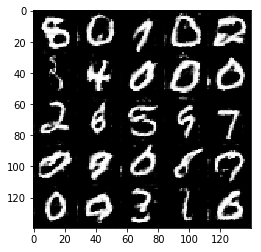

Epoch 2/2... Discriminator Loss: 1.5142... Generator Loss: 0.4450
Epoch 2/2... Discriminator Loss: 0.7059... Generator Loss: 1.2969
Epoch 2/2... Discriminator Loss: 1.1153... Generator Loss: 0.7269
Epoch 2/2... Discriminator Loss: 1.3565... Generator Loss: 0.5742
Epoch 2/2... Discriminator Loss: 1.0575... Generator Loss: 0.9273
Epoch 2/2... Discriminator Loss: 1.0737... Generator Loss: 1.1184
Epoch 2/2... Discriminator Loss: 2.5064... Generator Loss: 0.1626
Epoch 2/2... Discriminator Loss: 0.9961... Generator Loss: 0.8780
Epoch 2/2... Discriminator Loss: 0.9197... Generator Loss: 0.9684
Epoch 2/2... Discriminator Loss: 1.1376... Generator Loss: 0.7390


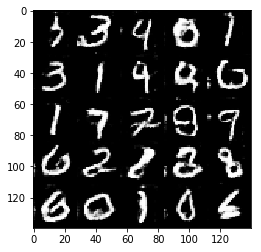

Epoch 2/2... Discriminator Loss: 0.6752... Generator Loss: 1.3053
Epoch 2/2... Discriminator Loss: 1.5786... Generator Loss: 0.5997
Epoch 2/2... Discriminator Loss: 1.1542... Generator Loss: 0.6018
Epoch 2/2... Discriminator Loss: 0.7663... Generator Loss: 1.3831
Epoch 2/2... Discriminator Loss: 0.9157... Generator Loss: 0.8919
Epoch 2/2... Discriminator Loss: 0.8522... Generator Loss: 0.9922
Epoch 2/2... Discriminator Loss: 0.8500... Generator Loss: 1.2344
Epoch 2/2... Discriminator Loss: 0.3576... Generator Loss: 4.8703
Epoch 2/2... Discriminator Loss: 0.4901... Generator Loss: 2.0699
Epoch 2/2... Discriminator Loss: 1.1230... Generator Loss: 0.7277


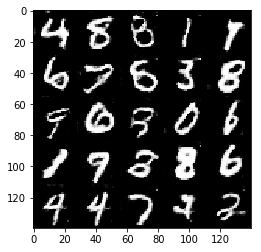

Epoch 2/2... Discriminator Loss: 0.9245... Generator Loss: 0.9381
Epoch 2/2... Discriminator Loss: 0.9173... Generator Loss: 0.8596
Epoch 2/2... Discriminator Loss: 1.1324... Generator Loss: 0.6235
Epoch 2/2... Discriminator Loss: 0.9102... Generator Loss: 0.9429
Epoch 2/2... Discriminator Loss: 1.3591... Generator Loss: 0.5627
Epoch 2/2... Discriminator Loss: 1.4651... Generator Loss: 0.4465
Epoch 2/2... Discriminator Loss: 0.8359... Generator Loss: 0.9688
Epoch 2/2... Discriminator Loss: 0.5909... Generator Loss: 1.6299
Epoch 2/2... Discriminator Loss: 1.7622... Generator Loss: 0.3317
Epoch 2/2... Discriminator Loss: 0.6281... Generator Loss: 1.4354


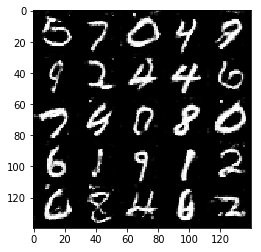

Epoch 2/2... Discriminator Loss: 1.6299... Generator Loss: 0.4501
Epoch 2/2... Discriminator Loss: 0.4268... Generator Loss: 3.3650
Epoch 2/2... Discriminator Loss: 0.7881... Generator Loss: 1.4250
Epoch 2/2... Discriminator Loss: 0.5463... Generator Loss: 1.7846
Epoch 2/2... Discriminator Loss: 0.3946... Generator Loss: 3.0119
Epoch 2/2... Discriminator Loss: 1.2532... Generator Loss: 0.6581
Epoch 2/2... Discriminator Loss: 0.4158... Generator Loss: 3.1848
Epoch 2/2... Discriminator Loss: 1.7211... Generator Loss: 0.3453
Epoch 2/2... Discriminator Loss: 0.7418... Generator Loss: 1.2636
Epoch 2/2... Discriminator Loss: 0.4536... Generator Loss: 2.5274


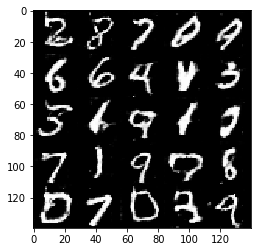

Epoch 2/2... Discriminator Loss: 0.9442... Generator Loss: 1.1556
Epoch 2/2... Discriminator Loss: 2.1953... Generator Loss: 0.2568
Epoch 2/2... Discriminator Loss: 1.0899... Generator Loss: 0.7239
Epoch 2/2... Discriminator Loss: 1.1084... Generator Loss: 0.6741
Epoch 2/2... Discriminator Loss: 2.5458... Generator Loss: 0.1713
Epoch 2/2... Discriminator Loss: 0.6271... Generator Loss: 1.5783
Epoch 2/2... Discriminator Loss: 0.7226... Generator Loss: 1.2846
Epoch 2/2... Discriminator Loss: 1.1398... Generator Loss: 0.6562
Epoch 2/2... Discriminator Loss: 2.2772... Generator Loss: 0.2508
Epoch 2/2... Discriminator Loss: 1.5009... Generator Loss: 0.5597


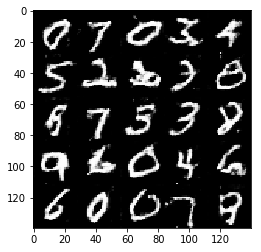

Epoch 2/2... Discriminator Loss: 0.6241... Generator Loss: 1.4040
Epoch 2/2... Discriminator Loss: 1.6047... Generator Loss: 0.3906
Epoch 2/2... Discriminator Loss: 1.4220... Generator Loss: 0.4942
Epoch 2/2... Discriminator Loss: 1.3886... Generator Loss: 0.6463
Epoch 2/2... Discriminator Loss: 2.3147... Generator Loss: 0.2110
Epoch 2/2... Discriminator Loss: 0.9695... Generator Loss: 0.7960
Epoch 2/2... Discriminator Loss: 0.7542... Generator Loss: 1.7361
Epoch 2/2... Discriminator Loss: 0.8668... Generator Loss: 1.0208
Epoch 2/2... Discriminator Loss: 0.6147... Generator Loss: 1.8230
Epoch 2/2... Discriminator Loss: 1.4058... Generator Loss: 0.5834


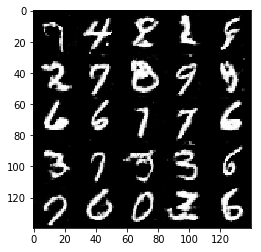

Epoch 2/2... Discriminator Loss: 1.4489... Generator Loss: 0.4305
Epoch 2/2... Discriminator Loss: 0.9808... Generator Loss: 0.7667
Epoch 2/2... Discriminator Loss: 1.7374... Generator Loss: 0.3455
Epoch 2/2... Discriminator Loss: 0.9487... Generator Loss: 0.8956
Epoch 2/2... Discriminator Loss: 0.5916... Generator Loss: 1.6073
Epoch 2/2... Discriminator Loss: 1.2169... Generator Loss: 0.7745
Epoch 2/2... Discriminator Loss: 0.7753... Generator Loss: 1.4958
Epoch 2/2... Discriminator Loss: 0.5986... Generator Loss: 1.7132
Epoch 2/2... Discriminator Loss: 0.6659... Generator Loss: 1.2748
Epoch 2/2... Discriminator Loss: 1.2271... Generator Loss: 0.6084


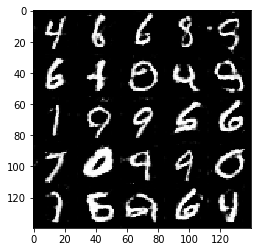

Epoch 2/2... Discriminator Loss: 1.6955... Generator Loss: 0.4084
Epoch 2/2... Discriminator Loss: 0.4641... Generator Loss: 2.2040
Epoch 2/2... Discriminator Loss: 0.4595... Generator Loss: 2.2925
Epoch 2/2... Discriminator Loss: 1.1894... Generator Loss: 0.5891
Epoch 2/2... Discriminator Loss: 0.6661... Generator Loss: 1.4229
Epoch 2/2... Discriminator Loss: 0.8905... Generator Loss: 0.9118
Epoch 2/2... Discriminator Loss: 0.8115... Generator Loss: 1.0109
Epoch 2/2... Discriminator Loss: 0.6542... Generator Loss: 1.6593
Epoch 2/2... Discriminator Loss: 1.5696... Generator Loss: 0.4098
Epoch 2/2... Discriminator Loss: 0.6193... Generator Loss: 1.4251


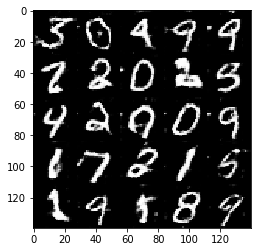

Epoch 2/2... Discriminator Loss: 0.4145... Generator Loss: 3.0257
Epoch 2/2... Discriminator Loss: 0.5830... Generator Loss: 2.2899
Epoch 2/2... Discriminator Loss: 0.9924... Generator Loss: 0.7638
Epoch 2/2... Discriminator Loss: 0.3783... Generator Loss: 3.1463
Epoch 2/2... Discriminator Loss: 0.6609... Generator Loss: 1.3031
Epoch 2/2... Discriminator Loss: 2.2337... Generator Loss: 0.1837
Epoch 2/2... Discriminator Loss: 0.9029... Generator Loss: 0.8790
Epoch 2/2... Discriminator Loss: 0.8026... Generator Loss: 0.9951
Epoch 2/2... Discriminator Loss: 0.5130... Generator Loss: 1.8503
Epoch 2/2... Discriminator Loss: 1.1223... Generator Loss: 0.8119


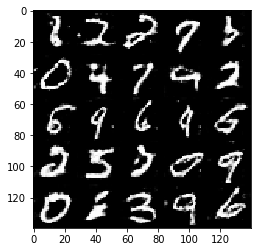

Epoch 2/2... Discriminator Loss: 0.3416... Generator Loss: 4.6901
Epoch 2/2... Discriminator Loss: 3.4286... Generator Loss: 0.1180
Epoch 2/2... Discriminator Loss: 0.8379... Generator Loss: 1.1092
Epoch 2/2... Discriminator Loss: 1.2874... Generator Loss: 0.5838
Epoch 2/2... Discriminator Loss: 0.6636... Generator Loss: 1.3536
Epoch 2/2... Discriminator Loss: 1.1124... Generator Loss: 0.6659
Epoch 2/2... Discriminator Loss: 0.7141... Generator Loss: 1.4414
Epoch 2/2... Discriminator Loss: 0.4289... Generator Loss: 2.7980
Epoch 2/2... Discriminator Loss: 1.4167... Generator Loss: 0.5283
Epoch 2/2... Discriminator Loss: 0.4486... Generator Loss: 2.2581


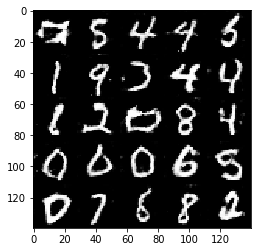

Epoch 2/2... Discriminator Loss: 0.8179... Generator Loss: 1.2688
Epoch 2/2... Discriminator Loss: 2.0070... Generator Loss: 0.4492
Epoch 2/2... Discriminator Loss: 0.5208... Generator Loss: 2.3472
Epoch 2/2... Discriminator Loss: 0.7365... Generator Loss: 1.3077
Epoch 2/2... Discriminator Loss: 0.5800... Generator Loss: 1.5737
Epoch 2/2... Discriminator Loss: 1.4727... Generator Loss: 0.4937
Epoch 2/2... Discriminator Loss: 2.1709... Generator Loss: 0.2399
Epoch 2/2... Discriminator Loss: 0.5673... Generator Loss: 1.8541
Epoch 2/2... Discriminator Loss: 0.5926... Generator Loss: 2.2590
Epoch 2/2... Discriminator Loss: 0.6292... Generator Loss: 1.4841


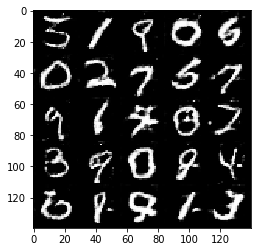

Epoch 2/2... Discriminator Loss: 0.5322... Generator Loss: 1.9419
Epoch 2/2... Discriminator Loss: 3.9054... Generator Loss: 0.0381
Epoch 2/2... Discriminator Loss: 1.4947... Generator Loss: 0.4614
Epoch 2/2... Discriminator Loss: 1.1472... Generator Loss: 0.8746
Epoch 2/2... Discriminator Loss: 0.9731... Generator Loss: 0.9306
Epoch 2/2... Discriminator Loss: 2.2363... Generator Loss: 6.7313
Epoch 2/2... Discriminator Loss: 0.7972... Generator Loss: 1.1593
Epoch 2/2... Discriminator Loss: 0.9323... Generator Loss: 0.8858
Epoch 2/2... Discriminator Loss: 0.3800... Generator Loss: 3.0862
Epoch 2/2... Discriminator Loss: 0.8811... Generator Loss: 0.9731


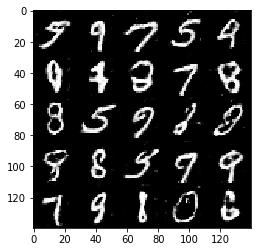

Epoch 2/2... Discriminator Loss: 0.7706... Generator Loss: 1.8694
Epoch 2/2... Discriminator Loss: 2.4281... Generator Loss: 0.2463
Epoch 2/2... Discriminator Loss: 1.3037... Generator Loss: 0.5876
Epoch 2/2... Discriminator Loss: 0.7451... Generator Loss: 1.1410
Epoch 2/2... Discriminator Loss: 1.4167... Generator Loss: 0.4739
Epoch 2/2... Discriminator Loss: 0.5810... Generator Loss: 1.6375
Epoch 2/2... Discriminator Loss: 0.6851... Generator Loss: 1.3410
Epoch 2/2... Discriminator Loss: 1.6554... Generator Loss: 0.4971
Epoch 2/2... Discriminator Loss: 1.3365... Generator Loss: 0.6920
Epoch 2/2... Discriminator Loss: 0.7386... Generator Loss: 1.1395


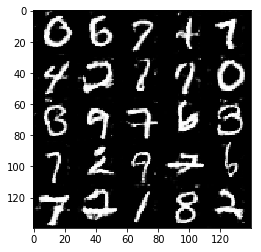

Epoch 2/2... Discriminator Loss: 0.4742... Generator Loss: 2.1568
Epoch 2/2... Discriminator Loss: 0.9657... Generator Loss: 0.9246
Epoch 2/2... Discriminator Loss: 0.5435... Generator Loss: 1.8371
Epoch 2/2... Discriminator Loss: 0.7791... Generator Loss: 1.0857
Epoch 2/2... Discriminator Loss: 1.2901... Generator Loss: 0.5621
Epoch 2/2... Discriminator Loss: 1.6834... Generator Loss: 0.3758
Epoch 2/2... Discriminator Loss: 1.1001... Generator Loss: 5.1327
Epoch 2/2... Discriminator Loss: 1.2556... Generator Loss: 0.7203
Epoch 2/2... Discriminator Loss: 1.4654... Generator Loss: 0.5421
Epoch 2/2... Discriminator Loss: 0.5478... Generator Loss: 1.8131


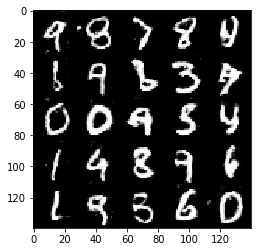

Epoch 2/2... Discriminator Loss: 0.6827... Generator Loss: 1.3954
Epoch 2/2... Discriminator Loss: 2.5352... Generator Loss: 0.1868
Epoch 2/2... Discriminator Loss: 0.5695... Generator Loss: 2.5244
Epoch 2/2... Discriminator Loss: 0.9230... Generator Loss: 0.8784
Epoch 2/2... Discriminator Loss: 0.7736... Generator Loss: 1.3125
Epoch 2/2... Discriminator Loss: 0.4371... Generator Loss: 2.6101
Epoch 2/2... Discriminator Loss: 0.6055... Generator Loss: 1.7201
Epoch 2/2... Discriminator Loss: 1.3818... Generator Loss: 0.5396
Epoch 2/2... Discriminator Loss: 0.5272... Generator Loss: 1.9489
Epoch 2/2... Discriminator Loss: 0.7092... Generator Loss: 1.2772


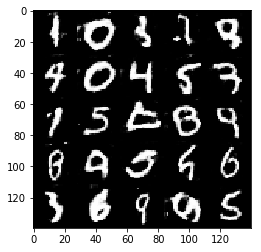

Epoch 2/2... Discriminator Loss: 0.5144... Generator Loss: 2.0259
Epoch 2/2... Discriminator Loss: 0.9352... Generator Loss: 1.0142
Epoch 2/2... Discriminator Loss: 1.3951... Generator Loss: 0.4844
Epoch 2/2... Discriminator Loss: 2.3655... Generator Loss: 0.2718
Epoch 2/2... Discriminator Loss: 0.8693... Generator Loss: 1.1407
Epoch 2/2... Discriminator Loss: 0.9446... Generator Loss: 0.8140
Epoch 2/2... Discriminator Loss: 0.8871... Generator Loss: 0.9156
Epoch 2/2... Discriminator Loss: 0.9389... Generator Loss: 0.7982
Epoch 2/2... Discriminator Loss: 0.7115... Generator Loss: 1.2052
Epoch 2/2... Discriminator Loss: 0.7301... Generator Loss: 1.1804


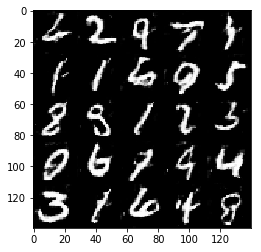

Epoch 2/2... Discriminator Loss: 1.0771... Generator Loss: 0.6671
Epoch 2/2... Discriminator Loss: 0.6080... Generator Loss: 1.6926
Epoch 2/2... Discriminator Loss: 0.9521... Generator Loss: 0.8960
Epoch 2/2... Discriminator Loss: 0.4847... Generator Loss: 1.9684
Epoch 2/2... Discriminator Loss: 0.3962... Generator Loss: 2.8129
Epoch 2/2... Discriminator Loss: 0.4158... Generator Loss: 2.5959
Epoch 2/2... Discriminator Loss: 1.2465... Generator Loss: 4.9278
Epoch 2/2... Discriminator Loss: 0.8188... Generator Loss: 1.0615
Epoch 2/2... Discriminator Loss: 0.4602... Generator Loss: 2.4245
Epoch 2/2... Discriminator Loss: 2.0085... Generator Loss: 0.2578


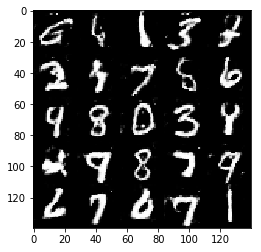

Epoch 2/2... Discriminator Loss: 0.8340... Generator Loss: 0.9732
Epoch 2/2... Discriminator Loss: 0.9082... Generator Loss: 0.9617
Epoch 2/2... Discriminator Loss: 0.6286... Generator Loss: 3.1157
Epoch 2/2... Discriminator Loss: 0.5674... Generator Loss: 3.7142
Epoch 2/2... Discriminator Loss: 1.3283... Generator Loss: 0.5208
Epoch 2/2... Discriminator Loss: 0.4691... Generator Loss: 2.2944
Epoch 2/2... Discriminator Loss: 1.7222... Generator Loss: 0.4164
Epoch 2/2... Discriminator Loss: 0.6819... Generator Loss: 1.3358
Epoch 2/2... Discriminator Loss: 0.4761... Generator Loss: 3.0716
Epoch 2/2... Discriminator Loss: 0.8584... Generator Loss: 1.3975


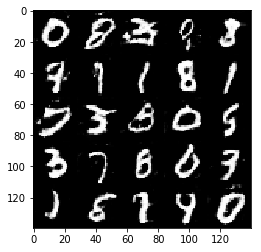

Epoch 2/2... Discriminator Loss: 0.7348... Generator Loss: 1.1934
Epoch 2/2... Discriminator Loss: 0.7894... Generator Loss: 1.0858
Epoch 2/2... Discriminator Loss: 0.5916... Generator Loss: 1.7165
Epoch 2/2... Discriminator Loss: 1.0666... Generator Loss: 0.9300
Epoch 2/2... Discriminator Loss: 1.3746... Generator Loss: 0.5874
Epoch 2/2... Discriminator Loss: 1.5399... Generator Loss: 0.3793
Epoch 2/2... Discriminator Loss: 0.9283... Generator Loss: 0.8425
Epoch 2/2... Discriminator Loss: 0.5513... Generator Loss: 1.8271
Epoch 2/2... Discriminator Loss: 1.2597... Generator Loss: 0.5778
Epoch 2/2... Discriminator Loss: 0.9446... Generator Loss: 1.0428


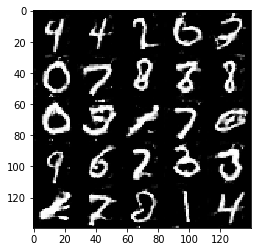

Epoch 2/2... Discriminator Loss: 1.0543... Generator Loss: 0.7570
Epoch 2/2... Discriminator Loss: 0.7010... Generator Loss: 1.6637
Epoch 2/2... Discriminator Loss: 0.7165... Generator Loss: 1.4308
Epoch 2/2... Discriminator Loss: 0.8384... Generator Loss: 1.0719
Epoch 2/2... Discriminator Loss: 0.8775... Generator Loss: 1.0077
Epoch 2/2... Discriminator Loss: 1.3315... Generator Loss: 0.5240
Epoch 2/2... Discriminator Loss: 0.5278... Generator Loss: 1.7332
Epoch 2/2... Discriminator Loss: 1.3649... Generator Loss: 0.6348
Epoch 2/2... Discriminator Loss: 1.0902... Generator Loss: 0.7365
Epoch 2/2... Discriminator Loss: 1.2359... Generator Loss: 0.5895


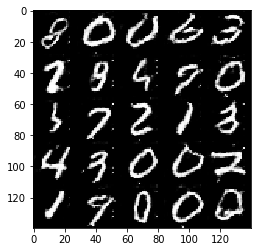

Epoch 2/2... Discriminator Loss: 0.6405... Generator Loss: 1.3654
Epoch 2/2... Discriminator Loss: 0.7074... Generator Loss: 1.3944
Epoch 2/2... Discriminator Loss: 0.7653... Generator Loss: 1.1064
Epoch 2/2... Discriminator Loss: 1.2715... Generator Loss: 0.5634
Epoch 2/2... Discriminator Loss: 0.6614... Generator Loss: 1.4415
Epoch 2/2... Discriminator Loss: 2.4601... Generator Loss: 0.1787
Epoch 2/2... Discriminator Loss: 0.6667... Generator Loss: 1.6359
Epoch 2/2... Discriminator Loss: 1.3213... Generator Loss: 0.5379
Epoch 2/2... Discriminator Loss: 0.8107... Generator Loss: 1.0017
Epoch 2/2... Discriminator Loss: 0.7687... Generator Loss: 1.1638


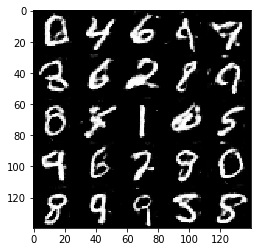

Epoch 2/2... Discriminator Loss: 0.4291... Generator Loss: 2.4531
Epoch 2/2... Discriminator Loss: 0.7189... Generator Loss: 1.1905
Epoch 2/2... Discriminator Loss: 0.5078... Generator Loss: 2.1397
Epoch 2/2... Discriminator Loss: 0.9212... Generator Loss: 0.8592
Epoch 2/2... Discriminator Loss: 1.2748... Generator Loss: 0.5326
Epoch 2/2... Discriminator Loss: 0.4815... Generator Loss: 2.1033
Epoch 2/2... Discriminator Loss: 0.6668... Generator Loss: 1.4197
Epoch 2/2... Discriminator Loss: 0.4848... Generator Loss: 2.0234
Epoch 2/2... Discriminator Loss: 0.3770... Generator Loss: 3.1599
Epoch 2/2... Discriminator Loss: 1.2104... Generator Loss: 0.6251


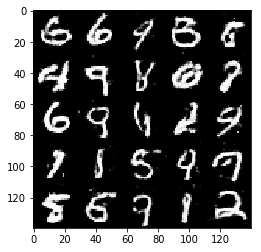

Epoch 2/2... Discriminator Loss: 0.8104... Generator Loss: 1.0597
Epoch 2/2... Discriminator Loss: 2.6885... Generator Loss: 0.1567
Epoch 2/2... Discriminator Loss: 0.8140... Generator Loss: 1.1532
Epoch 2/2... Discriminator Loss: 0.5647... Generator Loss: 1.7922
Epoch 2/2... Discriminator Loss: 0.6582... Generator Loss: 1.3500
Epoch 2/2... Discriminator Loss: 0.4456... Generator Loss: 2.3469
Epoch 2/2... Discriminator Loss: 0.7999... Generator Loss: 1.0621
Epoch 2/2... Discriminator Loss: 0.7884... Generator Loss: 1.0155
Epoch 2/2... Discriminator Loss: 0.5037... Generator Loss: 2.2856
Epoch 2/2... Discriminator Loss: 1.1161... Generator Loss: 0.6318


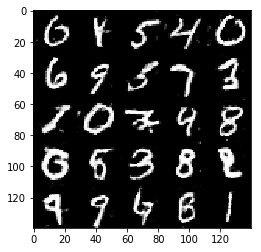

Epoch 2/2... Discriminator Loss: 2.2794... Generator Loss: 0.2733
Epoch 2/2... Discriminator Loss: 1.0759... Generator Loss: 0.6773
Epoch 2/2... Discriminator Loss: 2.0679... Generator Loss: 0.2722
Epoch 2/2... Discriminator Loss: 1.9597... Generator Loss: 0.3311
Epoch 2/2... Discriminator Loss: 0.7132... Generator Loss: 1.1925
Epoch 2/2... Discriminator Loss: 2.8427... Generator Loss: 0.1061
Epoch 2/2... Discriminator Loss: 0.8485... Generator Loss: 0.9352
Epoch 2/2... Discriminator Loss: 0.9717... Generator Loss: 0.8050
Epoch 2/2... Discriminator Loss: 0.4201... Generator Loss: 2.5945
Epoch 2/2... Discriminator Loss: 1.4554... Generator Loss: 0.5911


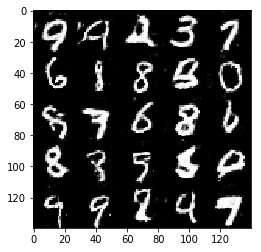

Epoch 2/2... Discriminator Loss: 0.7267... Generator Loss: 1.1731
Epoch 2/2... Discriminator Loss: 0.5448... Generator Loss: 1.8909
Epoch 2/2... Discriminator Loss: 1.1446... Generator Loss: 0.6371
Epoch 2/2... Discriminator Loss: 0.8693... Generator Loss: 1.0112
Epoch 2/2... Discriminator Loss: 0.8422... Generator Loss: 1.4271
Epoch 2/2... Discriminator Loss: 1.0019... Generator Loss: 0.8250
Epoch 2/2... Discriminator Loss: 1.8985... Generator Loss: 0.3015
Epoch 2/2... Discriminator Loss: 0.6863... Generator Loss: 1.2174
Epoch 2/2... Discriminator Loss: 0.8987... Generator Loss: 0.8680
Epoch 2/2... Discriminator Loss: 0.6750... Generator Loss: 1.3612


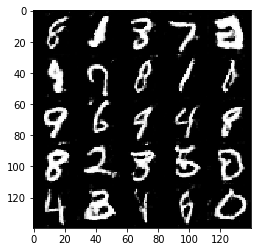

Epoch 2/2... Discriminator Loss: 0.7081... Generator Loss: 1.2661
Epoch 2/2... Discriminator Loss: 0.3912... Generator Loss: 3.8211
Epoch 2/2... Discriminator Loss: 1.4506... Generator Loss: 0.4699
Epoch 2/2... Discriminator Loss: 0.8937... Generator Loss: 1.0451
Epoch 2/2... Discriminator Loss: 0.4351... Generator Loss: 2.4061
Epoch 2/2... Discriminator Loss: 1.0226... Generator Loss: 0.7500
Epoch 2/2... Discriminator Loss: 0.9168... Generator Loss: 0.8853
Epoch 2/2... Discriminator Loss: 0.4823... Generator Loss: 1.9926
Epoch 2/2... Discriminator Loss: 0.5870... Generator Loss: 1.6376
Epoch 2/2... Discriminator Loss: 2.7185... Generator Loss: 0.3602


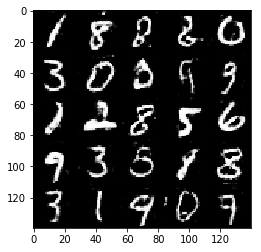

Epoch 2/2... Discriminator Loss: 0.8512... Generator Loss: 1.0035
Epoch 2/2... Discriminator Loss: 0.4948... Generator Loss: 2.3192
Epoch 2/2... Discriminator Loss: 0.6228... Generator Loss: 1.5257
Epoch 2/2... Discriminator Loss: 0.6392... Generator Loss: 1.7629
Epoch 2/2... Discriminator Loss: 1.1902... Generator Loss: 0.5783
Epoch 2/2... Discriminator Loss: 1.1566... Generator Loss: 0.6709
Epoch 2/2... Discriminator Loss: 1.4974... Generator Loss: 0.4654
Epoch 2/2... Discriminator Loss: 0.6795... Generator Loss: 1.3272
Epoch 2/2... Discriminator Loss: 0.5378... Generator Loss: 3.0905
Epoch 2/2... Discriminator Loss: 0.4789... Generator Loss: 2.1459


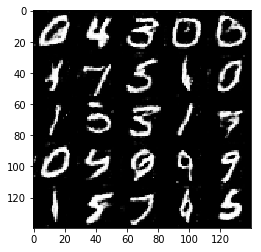

Epoch 2/2... Discriminator Loss: 0.6775... Generator Loss: 1.2859
Epoch 2/2... Discriminator Loss: 0.4027... Generator Loss: 2.9192
Epoch 2/2... Discriminator Loss: 0.5298... Generator Loss: 2.2474
Epoch 2/2... Discriminator Loss: 0.9321... Generator Loss: 0.9835
Epoch 2/2... Discriminator Loss: 0.4704... Generator Loss: 2.3695
Epoch 2/2... Discriminator Loss: 0.6411... Generator Loss: 1.5347
Epoch 2/2... Discriminator Loss: 0.5292... Generator Loss: 2.5143
Epoch 2/2... Discriminator Loss: 0.5928... Generator Loss: 2.5167
Epoch 2/2... Discriminator Loss: 1.1598... Generator Loss: 0.6104
Epoch 2/2... Discriminator Loss: 1.2261... Generator Loss: 0.5766


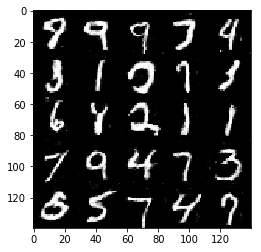

Epoch 2/2... Discriminator Loss: 0.7052... Generator Loss: 1.2018
Epoch 2/2... Discriminator Loss: 0.5005... Generator Loss: 2.3318
Epoch 2/2... Discriminator Loss: 0.4814... Generator Loss: 2.5326
Epoch 2/2... Discriminator Loss: 0.6313... Generator Loss: 1.4917
Epoch 2/2... Discriminator Loss: 0.9236... Generator Loss: 1.1964
Epoch 2/2... Discriminator Loss: 0.7183... Generator Loss: 1.4079
Epoch 2/2... Discriminator Loss: 1.3030... Generator Loss: 0.5623
Epoch 2/2... Discriminator Loss: 1.1936... Generator Loss: 0.7562
Epoch 2/2... Discriminator Loss: 1.3088... Generator Loss: 0.5204
Epoch 2/2... Discriminator Loss: 0.6459... Generator Loss: 1.4115


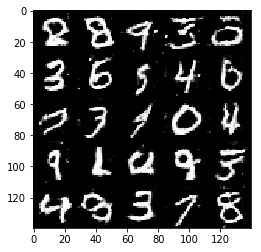

Epoch 2/2... Discriminator Loss: 0.4684... Generator Loss: 2.3843
Epoch 2/2... Discriminator Loss: 0.8458... Generator Loss: 1.0113
Epoch 2/2... Discriminator Loss: 0.4354... Generator Loss: 2.3899
Epoch 2/2... Discriminator Loss: 1.4267... Generator Loss: 0.5325
Epoch 2/2... Discriminator Loss: 0.6409... Generator Loss: 1.3640
Epoch 2/2... Discriminator Loss: 0.7180... Generator Loss: 1.2452
Epoch 2/2... Discriminator Loss: 0.4473... Generator Loss: 2.5311
Epoch 2/2... Discriminator Loss: 0.4887... Generator Loss: 1.9909
Epoch 2/2... Discriminator Loss: 0.6048... Generator Loss: 1.4834
Epoch 2/2... Discriminator Loss: 0.6678... Generator Loss: 1.3649


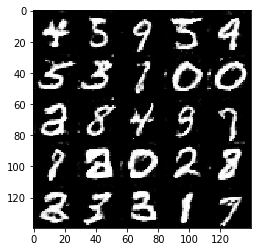

Epoch 2/2... Discriminator Loss: 0.8427... Generator Loss: 1.0139
Epoch 2/2... Discriminator Loss: 0.4681... Generator Loss: 2.2459
Epoch 2/2... Discriminator Loss: 0.9424... Generator Loss: 0.8537
Epoch 2/2... Discriminator Loss: 0.6182... Generator Loss: 1.4311
Epoch 2/2... Discriminator Loss: 1.8777... Generator Loss: 0.2803
Epoch 2/2... Discriminator Loss: 0.8224... Generator Loss: 2.8278
Epoch 2/2... Discriminator Loss: 0.4865... Generator Loss: 2.4231
Epoch 2/2... Discriminator Loss: 0.7682... Generator Loss: 1.3261
Epoch 2/2... Discriminator Loss: 0.5586... Generator Loss: 1.7960
Epoch 2/2... Discriminator Loss: 0.4459... Generator Loss: 2.6414


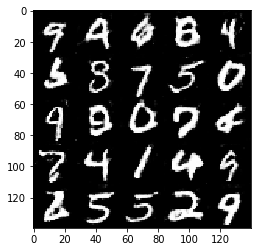

Epoch 2/2... Discriminator Loss: 0.7331... Generator Loss: 1.1234
Epoch 2/2... Discriminator Loss: 0.7337... Generator Loss: 1.1756
Epoch 2/2... Discriminator Loss: 1.0060... Generator Loss: 0.9159
Epoch 2/2... Discriminator Loss: 0.6642... Generator Loss: 1.3220
Epoch 2/2... Discriminator Loss: 0.9312... Generator Loss: 0.8957
Epoch 2/2... Discriminator Loss: 0.8579... Generator Loss: 1.2294
Epoch 2/2... Discriminator Loss: 0.8657... Generator Loss: 0.9689
Epoch 2/2... Discriminator Loss: 0.7973... Generator Loss: 1.0462
Epoch 2/2... Discriminator Loss: 1.3978... Generator Loss: 0.4403
Epoch 2/2... Discriminator Loss: 0.6487... Generator Loss: 1.5563


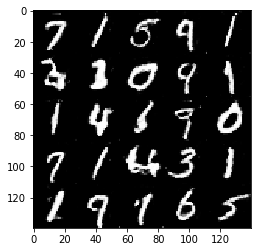

Epoch 2/2... Discriminator Loss: 1.1617... Generator Loss: 0.6590
Epoch 2/2... Discriminator Loss: 0.9220... Generator Loss: 0.9737
Epoch 2/2... Discriminator Loss: 0.5145... Generator Loss: 1.9505
Epoch 2/2... Discriminator Loss: 3.0631... Generator Loss: 0.1138
Epoch 2/2... Discriminator Loss: 0.4880... Generator Loss: 2.1804
Epoch 2/2... Discriminator Loss: 2.4473... Generator Loss: 0.1774
Epoch 2/2... Discriminator Loss: 0.8385... Generator Loss: 1.0963
Epoch 2/2... Discriminator Loss: 1.0399... Generator Loss: 0.7277
Epoch 2/2... Discriminator Loss: 1.1327... Generator Loss: 0.7542
Epoch 2/2... Discriminator Loss: 1.2585... Generator Loss: 0.6057


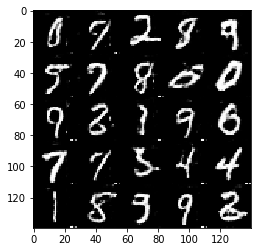

Epoch 2/2... Discriminator Loss: 1.0644... Generator Loss: 0.7036
Epoch 2/2... Discriminator Loss: 0.5491... Generator Loss: 2.1052
Epoch 2/2... Discriminator Loss: 0.5087... Generator Loss: 2.0572
Epoch 2/2... Discriminator Loss: 0.3741... Generator Loss: 3.3491
Epoch 2/2... Discriminator Loss: 0.4346... Generator Loss: 2.8116
Epoch 2/2... Discriminator Loss: 0.5040... Generator Loss: 3.1286
Epoch 2/2... Discriminator Loss: 0.8927... Generator Loss: 1.0074
Epoch 2/2... Discriminator Loss: 0.8207... Generator Loss: 1.1003
Epoch 2/2... Discriminator Loss: 1.6197... Generator Loss: 0.3861
Epoch 2/2... Discriminator Loss: 0.4992... Generator Loss: 2.2206


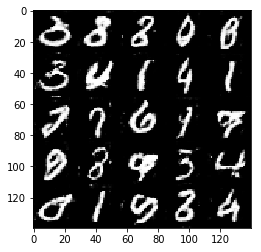

Epoch 2/2... Discriminator Loss: 0.5440... Generator Loss: 1.9714
Epoch 2/2... Discriminator Loss: 0.9905... Generator Loss: 0.7998
Epoch 2/2... Discriminator Loss: 0.5723... Generator Loss: 1.6058
Epoch 2/2... Discriminator Loss: 0.9654... Generator Loss: 0.8662
Epoch 2/2... Discriminator Loss: 1.7750... Generator Loss: 0.3480
Epoch 2/2... Discriminator Loss: 0.5702... Generator Loss: 1.6740
Epoch 2/2... Discriminator Loss: 1.6742... Generator Loss: 0.3872
Epoch 2/2... Discriminator Loss: 2.3083... Generator Loss: 0.2128
Epoch 2/2... Discriminator Loss: 0.4296... Generator Loss: 2.8036
Epoch 2/2... Discriminator Loss: 1.1158... Generator Loss: 0.7095


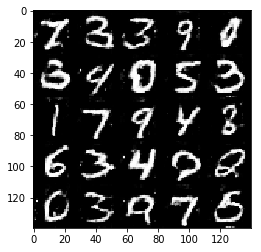

Epoch 2/2... Discriminator Loss: 1.0538... Generator Loss: 0.8084
Epoch 2/2... Discriminator Loss: 2.0978... Generator Loss: 0.3590
Epoch 2/2... Discriminator Loss: 0.6841... Generator Loss: 1.2805
Epoch 2/2... Discriminator Loss: 0.6367... Generator Loss: 1.5871
Epoch 2/2... Discriminator Loss: 0.6943... Generator Loss: 1.4409
Epoch 2/2... Discriminator Loss: 0.7524... Generator Loss: 1.2666
Epoch 2/2... Discriminator Loss: 2.0872... Generator Loss: 0.2257
Epoch 2/2... Discriminator Loss: 0.9579... Generator Loss: 0.9843
Epoch 2/2... Discriminator Loss: 1.6067... Generator Loss: 0.4480
Epoch 2/2... Discriminator Loss: 0.3986... Generator Loss: 3.0341


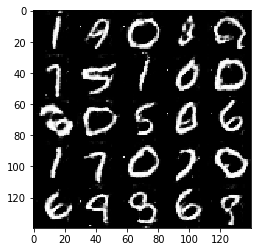

Epoch 2/2... Discriminator Loss: 0.3986... Generator Loss: 3.0341


In [112]:
batch_size = 8
z_dim = 100
learning_rate = .001
beta1 = .2

# tf.reset_default_graph()
"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

100
(?, 28, 28, 3)
28
(?, 100)
inputz1 100
out 3
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)
Epoch 1/1... Discriminator Loss: 1.2189... Generator Loss: 3.6081
Epoch 1/1... Discriminator Loss: 2.5897... Generator Loss: 0.1565
Epoch 1/1... Discriminator Loss: 3.7127... Generator Loss: 0.0602
Epoch 1/1... Discriminator Loss: 2.3352... Generator Loss: 0.2347
Epoch 1/1... Discriminator Loss: 0.8812... Generator Loss: 7.4372
Epoch 1/1... Discriminator Loss: 1.1257... Generator Loss: 7.3123
Epoch 1/1... Discriminator Loss: 0.5116... Generator Loss: 4.1007
Epoch 1/1... Discriminator Loss: 0.4336... Generator Loss: 3.5787
Epoch 1/1... Discriminator Loss: 0.5334... Generator Loss: 5.0651
Epoch 1/1... Discriminator Loss: 0.4439... Generator Loss: 2.6081
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


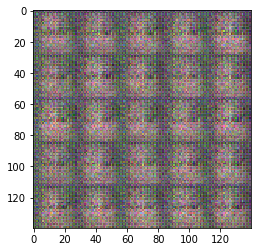

Epoch 1/1... Discriminator Loss: 1.9706... Generator Loss: 0.3274
Epoch 1/1... Discriminator Loss: 0.5528... Generator Loss: 2.4443
Epoch 1/1... Discriminator Loss: 1.1043... Generator Loss: 0.6739
Epoch 1/1... Discriminator Loss: 1.1114... Generator Loss: 0.6460
Epoch 1/1... Discriminator Loss: 0.8193... Generator Loss: 1.2051
Epoch 1/1... Discriminator Loss: 0.9229... Generator Loss: 3.4124
Epoch 1/1... Discriminator Loss: 1.1062... Generator Loss: 4.8738
Epoch 1/1... Discriminator Loss: 0.8592... Generator Loss: 1.4165
Epoch 1/1... Discriminator Loss: 1.1214... Generator Loss: 0.6314
Epoch 1/1... Discriminator Loss: 0.7139... Generator Loss: 2.9763
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


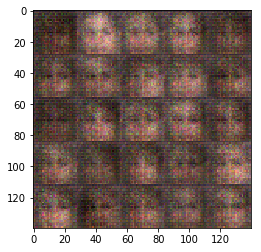

Epoch 1/1... Discriminator Loss: 0.9729... Generator Loss: 5.2825
Epoch 1/1... Discriminator Loss: 1.4439... Generator Loss: 0.4198
Epoch 1/1... Discriminator Loss: 1.5286... Generator Loss: 2.2928
Epoch 1/1... Discriminator Loss: 0.8420... Generator Loss: 0.9792
Epoch 1/1... Discriminator Loss: 1.2696... Generator Loss: 0.5376
Epoch 1/1... Discriminator Loss: 1.1872... Generator Loss: 0.8498
Epoch 1/1... Discriminator Loss: 2.4993... Generator Loss: 0.1386
Epoch 1/1... Discriminator Loss: 0.7746... Generator Loss: 1.6120
Epoch 1/1... Discriminator Loss: 1.0944... Generator Loss: 0.7470
Epoch 1/1... Discriminator Loss: 1.0738... Generator Loss: 3.4221
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


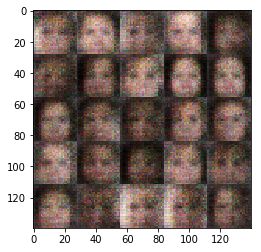

Epoch 1/1... Discriminator Loss: 1.6312... Generator Loss: 0.4289
Epoch 1/1... Discriminator Loss: 2.4038... Generator Loss: 0.1584
Epoch 1/1... Discriminator Loss: 1.6564... Generator Loss: 0.3491
Epoch 1/1... Discriminator Loss: 1.3014... Generator Loss: 0.5878
Epoch 1/1... Discriminator Loss: 1.2544... Generator Loss: 0.8239
Epoch 1/1... Discriminator Loss: 1.9449... Generator Loss: 0.3678
Epoch 1/1... Discriminator Loss: 1.2784... Generator Loss: 0.9941
Epoch 1/1... Discriminator Loss: 0.9358... Generator Loss: 1.0406
Epoch 1/1... Discriminator Loss: 1.8798... Generator Loss: 0.2877
Epoch 1/1... Discriminator Loss: 1.0914... Generator Loss: 0.7425
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


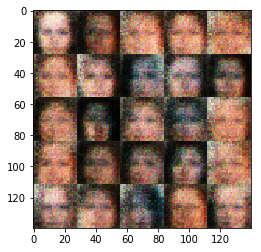

Epoch 1/1... Discriminator Loss: 0.7121... Generator Loss: 2.0084
Epoch 1/1... Discriminator Loss: 1.6317... Generator Loss: 0.3298
Epoch 1/1... Discriminator Loss: 1.7885... Generator Loss: 0.3045
Epoch 1/1... Discriminator Loss: 0.8316... Generator Loss: 0.9907
Epoch 1/1... Discriminator Loss: 0.8674... Generator Loss: 1.0005
Epoch 1/1... Discriminator Loss: 1.0245... Generator Loss: 0.9409
Epoch 1/1... Discriminator Loss: 1.3272... Generator Loss: 0.4950
Epoch 1/1... Discriminator Loss: 0.6441... Generator Loss: 1.9854
Epoch 1/1... Discriminator Loss: 0.9181... Generator Loss: 0.8525
Epoch 1/1... Discriminator Loss: 1.5676... Generator Loss: 0.4539
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


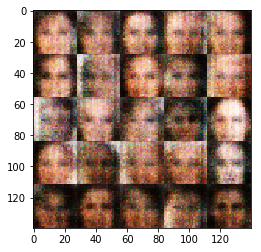

Epoch 1/1... Discriminator Loss: 0.9416... Generator Loss: 0.9062
Epoch 1/1... Discriminator Loss: 1.6777... Generator Loss: 0.3644
Epoch 1/1... Discriminator Loss: 1.1056... Generator Loss: 0.9577
Epoch 1/1... Discriminator Loss: 1.3791... Generator Loss: 0.4613
Epoch 1/1... Discriminator Loss: 2.0550... Generator Loss: 0.2418
Epoch 1/1... Discriminator Loss: 1.8310... Generator Loss: 0.2658
Epoch 1/1... Discriminator Loss: 2.1467... Generator Loss: 0.1985
Epoch 1/1... Discriminator Loss: 1.2112... Generator Loss: 0.8619
Epoch 1/1... Discriminator Loss: 1.8066... Generator Loss: 0.3148
Epoch 1/1... Discriminator Loss: 1.3035... Generator Loss: 0.5250
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


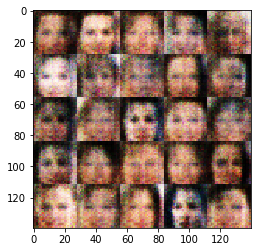

Epoch 1/1... Discriminator Loss: 2.0354... Generator Loss: 0.2361
Epoch 1/1... Discriminator Loss: 1.6954... Generator Loss: 0.3822
Epoch 1/1... Discriminator Loss: 1.1639... Generator Loss: 0.6030
Epoch 1/1... Discriminator Loss: 1.3417... Generator Loss: 0.5060
Epoch 1/1... Discriminator Loss: 1.5078... Generator Loss: 0.4284
Epoch 1/1... Discriminator Loss: 1.6527... Generator Loss: 0.5181
Epoch 1/1... Discriminator Loss: 1.9963... Generator Loss: 0.2419
Epoch 1/1... Discriminator Loss: 2.1350... Generator Loss: 0.1927
Epoch 1/1... Discriminator Loss: 1.0136... Generator Loss: 0.9971
Epoch 1/1... Discriminator Loss: 2.1225... Generator Loss: 0.2148
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


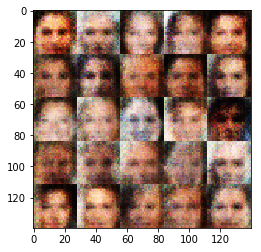

Epoch 1/1... Discriminator Loss: 0.9848... Generator Loss: 0.8615
Epoch 1/1... Discriminator Loss: 1.2004... Generator Loss: 1.0532
Epoch 1/1... Discriminator Loss: 1.3404... Generator Loss: 0.4931
Epoch 1/1... Discriminator Loss: 1.1891... Generator Loss: 0.6602
Epoch 1/1... Discriminator Loss: 2.2407... Generator Loss: 0.1948
Epoch 1/1... Discriminator Loss: 0.7061... Generator Loss: 1.1993
Epoch 1/1... Discriminator Loss: 1.1426... Generator Loss: 0.7165
Epoch 1/1... Discriminator Loss: 1.9622... Generator Loss: 0.2328
Epoch 1/1... Discriminator Loss: 2.0384... Generator Loss: 0.2103
Epoch 1/1... Discriminator Loss: 2.2111... Generator Loss: 0.1816
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


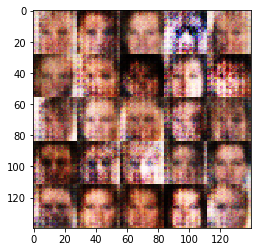

Epoch 1/1... Discriminator Loss: 1.0317... Generator Loss: 1.7908
Epoch 1/1... Discriminator Loss: 1.5972... Generator Loss: 0.3598
Epoch 1/1... Discriminator Loss: 1.6584... Generator Loss: 2.9435
Epoch 1/1... Discriminator Loss: 1.1272... Generator Loss: 0.6651
Epoch 1/1... Discriminator Loss: 0.9656... Generator Loss: 1.9873
Epoch 1/1... Discriminator Loss: 0.9495... Generator Loss: 2.1424
Epoch 1/1... Discriminator Loss: 1.5266... Generator Loss: 0.5114
Epoch 1/1... Discriminator Loss: 1.4524... Generator Loss: 0.4276
Epoch 1/1... Discriminator Loss: 1.3731... Generator Loss: 0.4983
Epoch 1/1... Discriminator Loss: 1.2156... Generator Loss: 0.6679
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


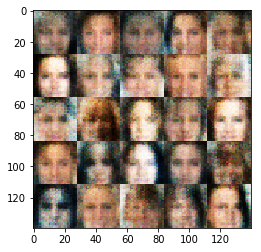

Epoch 1/1... Discriminator Loss: 1.1343... Generator Loss: 2.0854
Epoch 1/1... Discriminator Loss: 1.5163... Generator Loss: 0.4440
Epoch 1/1... Discriminator Loss: 1.1865... Generator Loss: 0.6218
Epoch 1/1... Discriminator Loss: 1.2588... Generator Loss: 0.5289
Epoch 1/1... Discriminator Loss: 1.4609... Generator Loss: 0.4545
Epoch 1/1... Discriminator Loss: 0.9047... Generator Loss: 1.3969
Epoch 1/1... Discriminator Loss: 1.2033... Generator Loss: 0.6213
Epoch 1/1... Discriminator Loss: 1.2275... Generator Loss: 0.5987
Epoch 1/1... Discriminator Loss: 1.0131... Generator Loss: 0.8830
Epoch 1/1... Discriminator Loss: 0.7257... Generator Loss: 1.1963
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


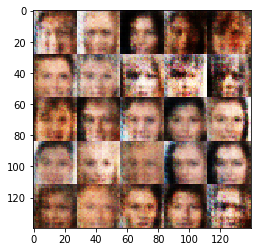

Epoch 1/1... Discriminator Loss: 0.7625... Generator Loss: 1.2884
Epoch 1/1... Discriminator Loss: 1.3905... Generator Loss: 0.5078
Epoch 1/1... Discriminator Loss: 1.4091... Generator Loss: 0.4747
Epoch 1/1... Discriminator Loss: 0.9473... Generator Loss: 1.5660
Epoch 1/1... Discriminator Loss: 0.7061... Generator Loss: 1.7053
Epoch 1/1... Discriminator Loss: 1.4605... Generator Loss: 0.4276
Epoch 1/1... Discriminator Loss: 1.6760... Generator Loss: 0.3220
Epoch 1/1... Discriminator Loss: 1.0632... Generator Loss: 2.3585
Epoch 1/1... Discriminator Loss: 1.0254... Generator Loss: 0.8809
Epoch 1/1... Discriminator Loss: 1.0399... Generator Loss: 1.3596
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


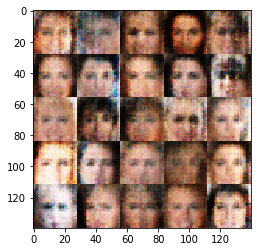

Epoch 1/1... Discriminator Loss: 0.7694... Generator Loss: 1.2649
Epoch 1/1... Discriminator Loss: 0.8971... Generator Loss: 1.7091
Epoch 1/1... Discriminator Loss: 1.3010... Generator Loss: 0.5964
Epoch 1/1... Discriminator Loss: 1.0930... Generator Loss: 1.0979
Epoch 1/1... Discriminator Loss: 1.8647... Generator Loss: 0.2726
Epoch 1/1... Discriminator Loss: 0.8482... Generator Loss: 1.0797
Epoch 1/1... Discriminator Loss: 1.0438... Generator Loss: 0.8874
Epoch 1/1... Discriminator Loss: 0.9752... Generator Loss: 1.0232
Epoch 1/1... Discriminator Loss: 1.6020... Generator Loss: 0.3493
Epoch 1/1... Discriminator Loss: 1.7734... Generator Loss: 0.2891
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


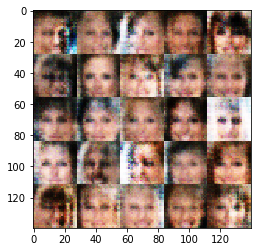

Epoch 1/1... Discriminator Loss: 0.7799... Generator Loss: 1.8401
Epoch 1/1... Discriminator Loss: 1.2094... Generator Loss: 0.5829
Epoch 1/1... Discriminator Loss: 1.1684... Generator Loss: 0.6399
Epoch 1/1... Discriminator Loss: 1.2983... Generator Loss: 0.5584
Epoch 1/1... Discriminator Loss: 0.6864... Generator Loss: 1.6031
Epoch 1/1... Discriminator Loss: 1.6076... Generator Loss: 0.3524
Epoch 1/1... Discriminator Loss: 1.3240... Generator Loss: 2.1485
Epoch 1/1... Discriminator Loss: 0.7750... Generator Loss: 1.2967
Epoch 1/1... Discriminator Loss: 1.0011... Generator Loss: 0.8025
Epoch 1/1... Discriminator Loss: 1.3268... Generator Loss: 0.4891
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


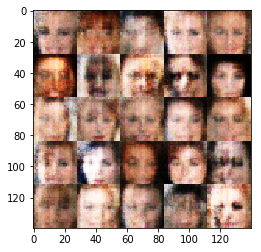

Epoch 1/1... Discriminator Loss: 1.6669... Generator Loss: 0.3467
Epoch 1/1... Discriminator Loss: 1.2258... Generator Loss: 0.6025
Epoch 1/1... Discriminator Loss: 1.5747... Generator Loss: 0.3540
Epoch 1/1... Discriminator Loss: 1.0227... Generator Loss: 0.8031
Epoch 1/1... Discriminator Loss: 1.2563... Generator Loss: 0.5696
Epoch 1/1... Discriminator Loss: 1.1345... Generator Loss: 0.6541
Epoch 1/1... Discriminator Loss: 0.9176... Generator Loss: 1.9719
Epoch 1/1... Discriminator Loss: 1.4892... Generator Loss: 0.4728
Epoch 1/1... Discriminator Loss: 0.9655... Generator Loss: 0.9372
Epoch 1/1... Discriminator Loss: 2.3445... Generator Loss: 0.1513
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


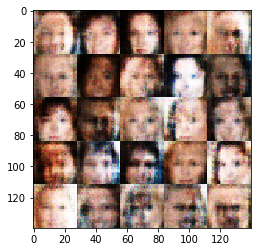

Epoch 1/1... Discriminator Loss: 1.3804... Generator Loss: 0.4784
Epoch 1/1... Discriminator Loss: 0.8135... Generator Loss: 1.0522
Epoch 1/1... Discriminator Loss: 1.0972... Generator Loss: 0.6753
Epoch 1/1... Discriminator Loss: 0.7844... Generator Loss: 1.2230
Epoch 1/1... Discriminator Loss: 0.6696... Generator Loss: 1.6156
Epoch 1/1... Discriminator Loss: 1.1036... Generator Loss: 0.6578
Epoch 1/1... Discriminator Loss: 1.0956... Generator Loss: 0.6883
Epoch 1/1... Discriminator Loss: 2.0189... Generator Loss: 0.2087
Epoch 1/1... Discriminator Loss: 0.8838... Generator Loss: 2.3406
Epoch 1/1... Discriminator Loss: 0.9519... Generator Loss: 0.8345
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


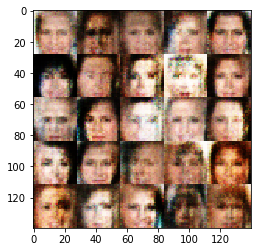

Epoch 1/1... Discriminator Loss: 1.4642... Generator Loss: 0.4570
Epoch 1/1... Discriminator Loss: 1.0151... Generator Loss: 0.8291
Epoch 1/1... Discriminator Loss: 1.7555... Generator Loss: 0.2944
Epoch 1/1... Discriminator Loss: 0.9324... Generator Loss: 1.0446
Epoch 1/1... Discriminator Loss: 1.0096... Generator Loss: 0.8088
Epoch 1/1... Discriminator Loss: 0.6838... Generator Loss: 1.8454
Epoch 1/1... Discriminator Loss: 1.0021... Generator Loss: 1.7104
Epoch 1/1... Discriminator Loss: 0.8681... Generator Loss: 0.9213
Epoch 1/1... Discriminator Loss: 1.2720... Generator Loss: 0.5268
Epoch 1/1... Discriminator Loss: 2.0435... Generator Loss: 0.2295
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


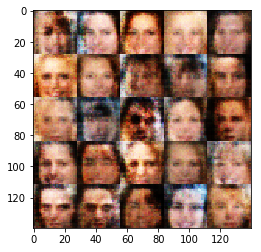

Epoch 1/1... Discriminator Loss: 1.5928... Generator Loss: 0.3561
Epoch 1/1... Discriminator Loss: 0.8167... Generator Loss: 1.0497
Epoch 1/1... Discriminator Loss: 0.9285... Generator Loss: 1.3047
Epoch 1/1... Discriminator Loss: 1.7809... Generator Loss: 0.2759
Epoch 1/1... Discriminator Loss: 1.7146... Generator Loss: 0.3548
Epoch 1/1... Discriminator Loss: 1.0994... Generator Loss: 0.8106
Epoch 1/1... Discriminator Loss: 0.9991... Generator Loss: 0.9187
Epoch 1/1... Discriminator Loss: 0.8815... Generator Loss: 1.2770
Epoch 1/1... Discriminator Loss: 1.4830... Generator Loss: 0.4549
Epoch 1/1... Discriminator Loss: 2.0603... Generator Loss: 0.2357
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


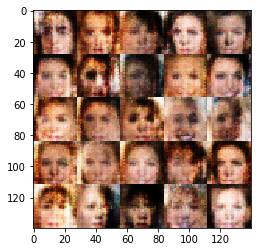

Epoch 1/1... Discriminator Loss: 0.9451... Generator Loss: 1.5616
Epoch 1/1... Discriminator Loss: 1.6499... Generator Loss: 0.3194
Epoch 1/1... Discriminator Loss: 1.0647... Generator Loss: 2.3230
Epoch 1/1... Discriminator Loss: 1.0614... Generator Loss: 1.8246
Epoch 1/1... Discriminator Loss: 1.8761... Generator Loss: 0.2479
Epoch 1/1... Discriminator Loss: 1.6243... Generator Loss: 0.3510
Epoch 1/1... Discriminator Loss: 1.9124... Generator Loss: 0.2457
Epoch 1/1... Discriminator Loss: 0.7849... Generator Loss: 1.8241
Epoch 1/1... Discriminator Loss: 1.1246... Generator Loss: 0.6719
Epoch 1/1... Discriminator Loss: 2.2045... Generator Loss: 0.1813
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


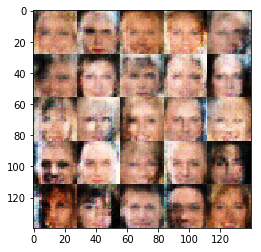

Epoch 1/1... Discriminator Loss: 1.9537... Generator Loss: 0.2478
Epoch 1/1... Discriminator Loss: 1.5258... Generator Loss: 0.3825
Epoch 1/1... Discriminator Loss: 1.5008... Generator Loss: 0.3972
Epoch 1/1... Discriminator Loss: 1.0921... Generator Loss: 0.9352
Epoch 1/1... Discriminator Loss: 1.2399... Generator Loss: 0.7045
Epoch 1/1... Discriminator Loss: 1.1980... Generator Loss: 0.6030
Epoch 1/1... Discriminator Loss: 1.3123... Generator Loss: 0.5139
Epoch 1/1... Discriminator Loss: 1.7604... Generator Loss: 0.3475
Epoch 1/1... Discriminator Loss: 1.0020... Generator Loss: 0.7543
Epoch 1/1... Discriminator Loss: 1.4232... Generator Loss: 0.4280
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


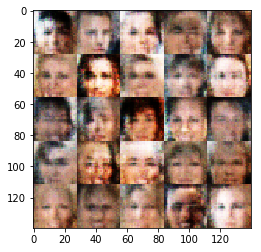

Epoch 1/1... Discriminator Loss: 1.4964... Generator Loss: 0.4082
Epoch 1/1... Discriminator Loss: 1.1949... Generator Loss: 0.6295
Epoch 1/1... Discriminator Loss: 0.9669... Generator Loss: 0.8346
Epoch 1/1... Discriminator Loss: 1.4544... Generator Loss: 0.4131
Epoch 1/1... Discriminator Loss: 1.0942... Generator Loss: 0.7335
Epoch 1/1... Discriminator Loss: 1.4849... Generator Loss: 0.4068
Epoch 1/1... Discriminator Loss: 0.6331... Generator Loss: 2.0584
Epoch 1/1... Discriminator Loss: 1.6989... Generator Loss: 0.3102
Epoch 1/1... Discriminator Loss: 1.2531... Generator Loss: 0.5637
Epoch 1/1... Discriminator Loss: 0.8174... Generator Loss: 1.6538
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


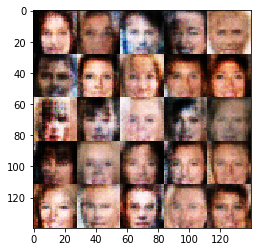

Epoch 1/1... Discriminator Loss: 2.3805... Generator Loss: 0.1605
Epoch 1/1... Discriminator Loss: 1.1064... Generator Loss: 0.7643
Epoch 1/1... Discriminator Loss: 0.9027... Generator Loss: 0.8718
Epoch 1/1... Discriminator Loss: 1.8030... Generator Loss: 0.2918
Epoch 1/1... Discriminator Loss: 0.9344... Generator Loss: 0.8715
Epoch 1/1... Discriminator Loss: 1.1632... Generator Loss: 0.6470
Epoch 1/1... Discriminator Loss: 1.9091... Generator Loss: 0.2526
Epoch 1/1... Discriminator Loss: 1.3032... Generator Loss: 0.5520
Epoch 1/1... Discriminator Loss: 0.9381... Generator Loss: 0.9394
Epoch 1/1... Discriminator Loss: 0.8669... Generator Loss: 1.2400
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


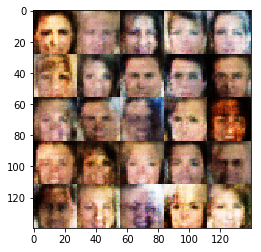

Epoch 1/1... Discriminator Loss: 1.2048... Generator Loss: 0.5770
Epoch 1/1... Discriminator Loss: 1.0942... Generator Loss: 0.6885
Epoch 1/1... Discriminator Loss: 1.2136... Generator Loss: 0.5877
Epoch 1/1... Discriminator Loss: 0.8013... Generator Loss: 1.5417
Epoch 1/1... Discriminator Loss: 0.7952... Generator Loss: 1.3413
Epoch 1/1... Discriminator Loss: 1.0983... Generator Loss: 1.0204
Epoch 1/1... Discriminator Loss: 0.7567... Generator Loss: 1.5009
Epoch 1/1... Discriminator Loss: 2.2832... Generator Loss: 0.1765
Epoch 1/1... Discriminator Loss: 1.5837... Generator Loss: 0.3621
Epoch 1/1... Discriminator Loss: 0.9462... Generator Loss: 0.8692
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


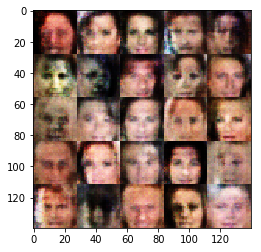

Epoch 1/1... Discriminator Loss: 1.3982... Generator Loss: 0.4777
Epoch 1/1... Discriminator Loss: 1.8281... Generator Loss: 0.2674
Epoch 1/1... Discriminator Loss: 1.0934... Generator Loss: 0.6930
Epoch 1/1... Discriminator Loss: 0.9124... Generator Loss: 2.2436
Epoch 1/1... Discriminator Loss: 1.1674... Generator Loss: 0.6463
Epoch 1/1... Discriminator Loss: 0.8295... Generator Loss: 1.2305
Epoch 1/1... Discriminator Loss: 1.5446... Generator Loss: 0.3640
Epoch 1/1... Discriminator Loss: 0.7045... Generator Loss: 1.4853
Epoch 1/1... Discriminator Loss: 1.5977... Generator Loss: 0.3420
Epoch 1/1... Discriminator Loss: 1.2158... Generator Loss: 0.5666
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


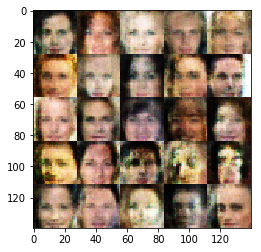

Epoch 1/1... Discriminator Loss: 0.9391... Generator Loss: 0.9535
Epoch 1/1... Discriminator Loss: 0.7535... Generator Loss: 1.2407
Epoch 1/1... Discriminator Loss: 1.4876... Generator Loss: 0.4013
Epoch 1/1... Discriminator Loss: 1.2017... Generator Loss: 0.8073
Epoch 1/1... Discriminator Loss: 1.2276... Generator Loss: 0.5914
Epoch 1/1... Discriminator Loss: 1.3884... Generator Loss: 0.4795
Epoch 1/1... Discriminator Loss: 2.5063... Generator Loss: 0.1565
Epoch 1/1... Discriminator Loss: 0.9885... Generator Loss: 0.7634
Epoch 1/1... Discriminator Loss: 1.6251... Generator Loss: 0.3502
Epoch 1/1... Discriminator Loss: 0.8382... Generator Loss: 1.1135
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


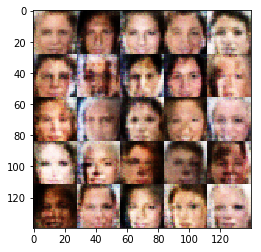

Epoch 1/1... Discriminator Loss: 0.8130... Generator Loss: 1.5581
Epoch 1/1... Discriminator Loss: 1.2923... Generator Loss: 0.5280
Epoch 1/1... Discriminator Loss: 1.0271... Generator Loss: 0.7525
Epoch 1/1... Discriminator Loss: 0.9838... Generator Loss: 1.5572
Epoch 1/1... Discriminator Loss: 1.1229... Generator Loss: 0.6723
Epoch 1/1... Discriminator Loss: 1.7228... Generator Loss: 0.3144
Epoch 1/1... Discriminator Loss: 1.8107... Generator Loss: 0.2793
Epoch 1/1... Discriminator Loss: 1.7011... Generator Loss: 0.3158
Epoch 1/1... Discriminator Loss: 1.1362... Generator Loss: 0.5980
Epoch 1/1... Discriminator Loss: 0.8151... Generator Loss: 1.1459
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


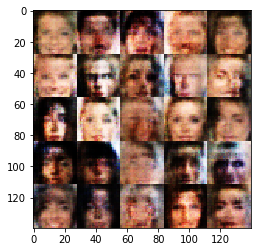

Epoch 1/1... Discriminator Loss: 1.1121... Generator Loss: 0.7561
Epoch 1/1... Discriminator Loss: 1.6274... Generator Loss: 0.3268
Epoch 1/1... Discriminator Loss: 2.0509... Generator Loss: 0.2079
Epoch 1/1... Discriminator Loss: 0.8252... Generator Loss: 1.4762
Epoch 1/1... Discriminator Loss: 2.0019... Generator Loss: 0.2296
Epoch 1/1... Discriminator Loss: 0.7352... Generator Loss: 1.2176
Epoch 1/1... Discriminator Loss: 1.7436... Generator Loss: 0.2990
Epoch 1/1... Discriminator Loss: 1.0088... Generator Loss: 0.7730
Epoch 1/1... Discriminator Loss: 0.8146... Generator Loss: 1.0027
Epoch 1/1... Discriminator Loss: 1.0794... Generator Loss: 0.6510
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


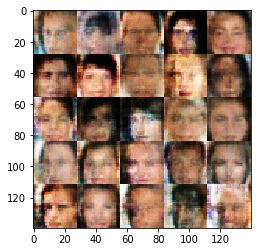

Epoch 1/1... Discriminator Loss: 0.8788... Generator Loss: 1.2677
Epoch 1/1... Discriminator Loss: 1.4462... Generator Loss: 0.4084
Epoch 1/1... Discriminator Loss: 0.8285... Generator Loss: 0.9972
Epoch 1/1... Discriminator Loss: 0.7723... Generator Loss: 1.0644
Epoch 1/1... Discriminator Loss: 1.2699... Generator Loss: 0.5440
Epoch 1/1... Discriminator Loss: 0.9413... Generator Loss: 2.5236
Epoch 1/1... Discriminator Loss: 1.1727... Generator Loss: 0.5970
Epoch 1/1... Discriminator Loss: 1.3927... Generator Loss: 0.4640
Epoch 1/1... Discriminator Loss: 0.8631... Generator Loss: 0.9286
Epoch 1/1... Discriminator Loss: 1.1577... Generator Loss: 0.5923
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


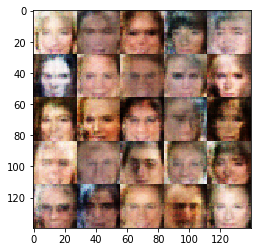

Epoch 1/1... Discriminator Loss: 1.2668... Generator Loss: 0.5078
Epoch 1/1... Discriminator Loss: 1.9792... Generator Loss: 0.2296
Epoch 1/1... Discriminator Loss: 0.9541... Generator Loss: 1.3431
Epoch 1/1... Discriminator Loss: 0.8442... Generator Loss: 1.0371
Epoch 1/1... Discriminator Loss: 1.8418... Generator Loss: 0.2751
Epoch 1/1... Discriminator Loss: 1.0067... Generator Loss: 0.9564
Epoch 1/1... Discriminator Loss: 1.2519... Generator Loss: 0.6188
Epoch 1/1... Discriminator Loss: 1.8295... Generator Loss: 0.2933
Epoch 1/1... Discriminator Loss: 1.6867... Generator Loss: 0.3918
Epoch 1/1... Discriminator Loss: 0.9398... Generator Loss: 0.8607
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


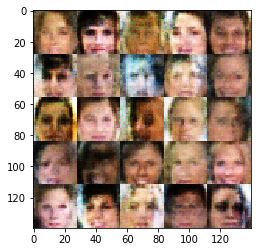

Epoch 1/1... Discriminator Loss: 0.8897... Generator Loss: 1.0668
Epoch 1/1... Discriminator Loss: 2.2777... Generator Loss: 0.1672
Epoch 1/1... Discriminator Loss: 1.5922... Generator Loss: 0.3571
Epoch 1/1... Discriminator Loss: 1.0824... Generator Loss: 0.8618
Epoch 1/1... Discriminator Loss: 1.6152... Generator Loss: 0.3617
Epoch 1/1... Discriminator Loss: 0.8864... Generator Loss: 0.9617
Epoch 1/1... Discriminator Loss: 1.4461... Generator Loss: 0.4413
Epoch 1/1... Discriminator Loss: 1.3324... Generator Loss: 0.4807
Epoch 1/1... Discriminator Loss: 1.6332... Generator Loss: 0.3369
Epoch 1/1... Discriminator Loss: 1.0705... Generator Loss: 0.6854
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


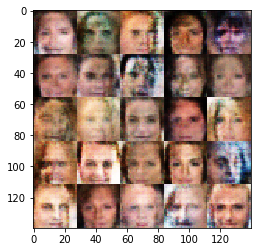

Epoch 1/1... Discriminator Loss: 0.9256... Generator Loss: 0.9264
Epoch 1/1... Discriminator Loss: 1.6942... Generator Loss: 0.3234
Epoch 1/1... Discriminator Loss: 0.9455... Generator Loss: 0.8935
Epoch 1/1... Discriminator Loss: 1.9445... Generator Loss: 0.2286
Epoch 1/1... Discriminator Loss: 1.4040... Generator Loss: 0.4384
Epoch 1/1... Discriminator Loss: 0.6870... Generator Loss: 1.4490
Epoch 1/1... Discriminator Loss: 1.3708... Generator Loss: 0.4565
Epoch 1/1... Discriminator Loss: 0.8735... Generator Loss: 1.1040
Epoch 1/1... Discriminator Loss: 0.9060... Generator Loss: 0.9443
Epoch 1/1... Discriminator Loss: 0.7425... Generator Loss: 1.8854
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


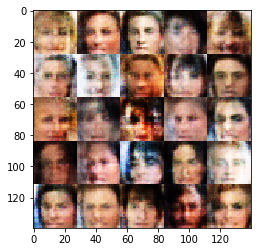

Epoch 1/1... Discriminator Loss: 0.9947... Generator Loss: 0.9097
Epoch 1/1... Discriminator Loss: 1.6368... Generator Loss: 0.3605
Epoch 1/1... Discriminator Loss: 0.9873... Generator Loss: 0.7522
Epoch 1/1... Discriminator Loss: 0.8478... Generator Loss: 1.2237
Epoch 1/1... Discriminator Loss: 1.5416... Generator Loss: 0.4077
Epoch 1/1... Discriminator Loss: 0.9213... Generator Loss: 0.9118
Epoch 1/1... Discriminator Loss: 0.7221... Generator Loss: 1.1596
Epoch 1/1... Discriminator Loss: 0.8593... Generator Loss: 0.9481
Epoch 1/1... Discriminator Loss: 1.2445... Generator Loss: 0.6267
Epoch 1/1... Discriminator Loss: 0.7222... Generator Loss: 1.2132
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


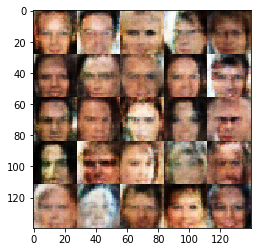

Epoch 1/1... Discriminator Loss: 0.8603... Generator Loss: 1.6741
Epoch 1/1... Discriminator Loss: 1.3080... Generator Loss: 0.5088
Epoch 1/1... Discriminator Loss: 0.6694... Generator Loss: 2.0460
Epoch 1/1... Discriminator Loss: 1.0568... Generator Loss: 0.7309
Epoch 1/1... Discriminator Loss: 1.1873... Generator Loss: 0.8101
Epoch 1/1... Discriminator Loss: 2.1025... Generator Loss: 0.1912
Epoch 1/1... Discriminator Loss: 1.3122... Generator Loss: 0.4919
Epoch 1/1... Discriminator Loss: 0.8196... Generator Loss: 1.1568
Epoch 1/1... Discriminator Loss: 1.6547... Generator Loss: 0.3625
Epoch 1/1... Discriminator Loss: 1.2735... Generator Loss: 0.5692
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


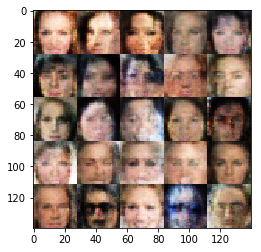

Epoch 1/1... Discriminator Loss: 0.8593... Generator Loss: 1.1394
Epoch 1/1... Discriminator Loss: 1.2032... Generator Loss: 0.6203
Epoch 1/1... Discriminator Loss: 0.9030... Generator Loss: 1.4531
Epoch 1/1... Discriminator Loss: 0.9818... Generator Loss: 1.2336
Epoch 1/1... Discriminator Loss: 0.7641... Generator Loss: 1.3262
Epoch 1/1... Discriminator Loss: 1.4357... Generator Loss: 0.4134
Epoch 1/1... Discriminator Loss: 0.8279... Generator Loss: 1.0801
Epoch 1/1... Discriminator Loss: 0.8857... Generator Loss: 1.0105
Epoch 1/1... Discriminator Loss: 1.6107... Generator Loss: 0.3750
Epoch 1/1... Discriminator Loss: 0.9946... Generator Loss: 1.5554
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


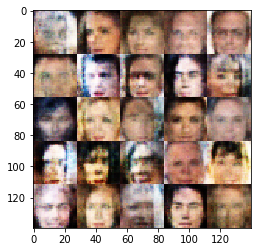

Epoch 1/1... Discriminator Loss: 0.9978... Generator Loss: 0.9066
Epoch 1/1... Discriminator Loss: 1.0375... Generator Loss: 0.7131
Epoch 1/1... Discriminator Loss: 1.2597... Generator Loss: 0.5304
Epoch 1/1... Discriminator Loss: 2.0394... Generator Loss: 0.2242
Epoch 1/1... Discriminator Loss: 1.7493... Generator Loss: 0.3005
Epoch 1/1... Discriminator Loss: 0.7222... Generator Loss: 1.2269
Epoch 1/1... Discriminator Loss: 0.9807... Generator Loss: 0.7988
Epoch 1/1... Discriminator Loss: 0.8888... Generator Loss: 0.8783
Epoch 1/1... Discriminator Loss: 1.1127... Generator Loss: 0.6405
Epoch 1/1... Discriminator Loss: 2.1309... Generator Loss: 0.2790
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


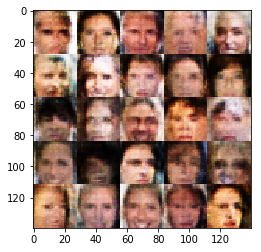

Epoch 1/1... Discriminator Loss: 0.6610... Generator Loss: 1.4381
Epoch 1/1... Discriminator Loss: 1.4751... Generator Loss: 0.4476
Epoch 1/1... Discriminator Loss: 1.6349... Generator Loss: 0.3558
Epoch 1/1... Discriminator Loss: 0.7360... Generator Loss: 1.4450
Epoch 1/1... Discriminator Loss: 1.5384... Generator Loss: 0.3848
Epoch 1/1... Discriminator Loss: 1.1456... Generator Loss: 0.6475
Epoch 1/1... Discriminator Loss: 1.2320... Generator Loss: 0.5337
Epoch 1/1... Discriminator Loss: 0.6062... Generator Loss: 1.7261
Epoch 1/1... Discriminator Loss: 1.2163... Generator Loss: 0.5982
Epoch 1/1... Discriminator Loss: 0.7082... Generator Loss: 1.3941
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


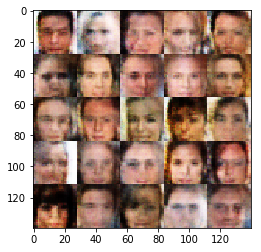

Epoch 1/1... Discriminator Loss: 2.4267... Generator Loss: 0.1558
Epoch 1/1... Discriminator Loss: 0.9704... Generator Loss: 1.0882
Epoch 1/1... Discriminator Loss: 0.8366... Generator Loss: 1.1505
Epoch 1/1... Discriminator Loss: 1.0615... Generator Loss: 0.7072
Epoch 1/1... Discriminator Loss: 0.7272... Generator Loss: 1.4751
Epoch 1/1... Discriminator Loss: 1.1468... Generator Loss: 0.6259
Epoch 1/1... Discriminator Loss: 0.9145... Generator Loss: 1.3958
Epoch 1/1... Discriminator Loss: 0.9244... Generator Loss: 0.9312
Epoch 1/1... Discriminator Loss: 1.0324... Generator Loss: 0.8770
Epoch 1/1... Discriminator Loss: 0.7752... Generator Loss: 1.1312
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


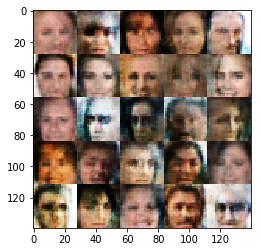

Epoch 1/1... Discriminator Loss: 1.2006... Generator Loss: 0.5967
Epoch 1/1... Discriminator Loss: 0.9212... Generator Loss: 0.9541
Epoch 1/1... Discriminator Loss: 1.9486... Generator Loss: 0.2758
Epoch 1/1... Discriminator Loss: 1.1597... Generator Loss: 0.6204
Epoch 1/1... Discriminator Loss: 2.2290... Generator Loss: 0.1897
Epoch 1/1... Discriminator Loss: 0.8641... Generator Loss: 1.2489
Epoch 1/1... Discriminator Loss: 1.0391... Generator Loss: 0.7193
Epoch 1/1... Discriminator Loss: 0.9342... Generator Loss: 0.8536
Epoch 1/1... Discriminator Loss: 1.5693... Generator Loss: 0.3530
Epoch 1/1... Discriminator Loss: 0.7890... Generator Loss: 1.0771
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


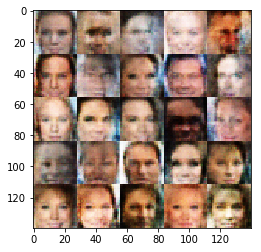

Epoch 1/1... Discriminator Loss: 1.3110... Generator Loss: 0.4799
Epoch 1/1... Discriminator Loss: 0.9713... Generator Loss: 0.7682
Epoch 1/1... Discriminator Loss: 1.2497... Generator Loss: 0.5602
Epoch 1/1... Discriminator Loss: 0.9165... Generator Loss: 0.8526
Epoch 1/1... Discriminator Loss: 1.3470... Generator Loss: 0.4939
Epoch 1/1... Discriminator Loss: 1.1811... Generator Loss: 0.6027
Epoch 1/1... Discriminator Loss: 1.0953... Generator Loss: 1.0547
Epoch 1/1... Discriminator Loss: 1.0178... Generator Loss: 0.7091
Epoch 1/1... Discriminator Loss: 0.6984... Generator Loss: 1.2307
Epoch 1/1... Discriminator Loss: 1.7835... Generator Loss: 0.2955
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


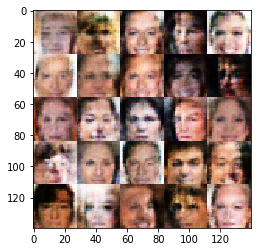

Epoch 1/1... Discriminator Loss: 0.7732... Generator Loss: 1.0861
Epoch 1/1... Discriminator Loss: 1.6603... Generator Loss: 0.3212
Epoch 1/1... Discriminator Loss: 0.7010... Generator Loss: 1.5784
Epoch 1/1... Discriminator Loss: 1.4858... Generator Loss: 0.3979
Epoch 1/1... Discriminator Loss: 0.9924... Generator Loss: 0.8094
Epoch 1/1... Discriminator Loss: 1.3488... Generator Loss: 0.5310
Epoch 1/1... Discriminator Loss: 1.8725... Generator Loss: 0.2537
Epoch 1/1... Discriminator Loss: 1.1510... Generator Loss: 0.5979
Epoch 1/1... Discriminator Loss: 0.7527... Generator Loss: 2.1959
Epoch 1/1... Discriminator Loss: 0.7757... Generator Loss: 1.1056
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


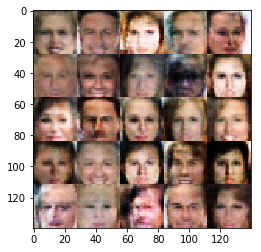

Epoch 1/1... Discriminator Loss: 0.9401... Generator Loss: 0.8290
Epoch 1/1... Discriminator Loss: 1.0217... Generator Loss: 0.7916
Epoch 1/1... Discriminator Loss: 1.1604... Generator Loss: 0.6146
Epoch 1/1... Discriminator Loss: 1.1129... Generator Loss: 0.7017
Epoch 1/1... Discriminator Loss: 1.0528... Generator Loss: 0.7331
Epoch 1/1... Discriminator Loss: 1.2108... Generator Loss: 0.6435
Epoch 1/1... Discriminator Loss: 1.3942... Generator Loss: 0.4855
Epoch 1/1... Discriminator Loss: 1.0885... Generator Loss: 0.7458
Epoch 1/1... Discriminator Loss: 1.2833... Generator Loss: 0.5548
Epoch 1/1... Discriminator Loss: 0.6525... Generator Loss: 1.3612
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


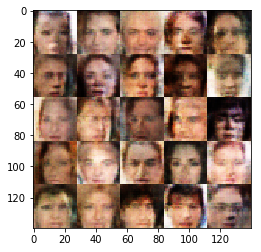

Epoch 1/1... Discriminator Loss: 0.9420... Generator Loss: 1.3768
Epoch 1/1... Discriminator Loss: 1.5448... Generator Loss: 0.3658
Epoch 1/1... Discriminator Loss: 0.6129... Generator Loss: 2.6745
Epoch 1/1... Discriminator Loss: 2.5154... Generator Loss: 0.1281
Epoch 1/1... Discriminator Loss: 1.0413... Generator Loss: 0.7164
Epoch 1/1... Discriminator Loss: 2.5811... Generator Loss: 0.1178
Epoch 1/1... Discriminator Loss: 1.6284... Generator Loss: 0.3338
Epoch 1/1... Discriminator Loss: 1.1784... Generator Loss: 0.5882
Epoch 1/1... Discriminator Loss: 1.4749... Generator Loss: 0.3905
Epoch 1/1... Discriminator Loss: 0.6781... Generator Loss: 2.2698
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


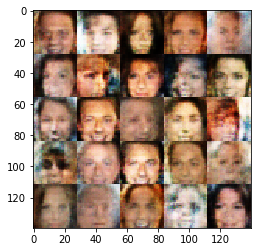

Epoch 1/1... Discriminator Loss: 1.1622... Generator Loss: 0.5931
Epoch 1/1... Discriminator Loss: 0.9168... Generator Loss: 2.6481
Epoch 1/1... Discriminator Loss: 0.5905... Generator Loss: 1.8425
Epoch 1/1... Discriminator Loss: 1.1494... Generator Loss: 0.6162
Epoch 1/1... Discriminator Loss: 1.4015... Generator Loss: 0.4247
Epoch 1/1... Discriminator Loss: 1.1510... Generator Loss: 0.6364
Epoch 1/1... Discriminator Loss: 1.3617... Generator Loss: 0.4609
Epoch 1/1... Discriminator Loss: 1.7293... Generator Loss: 0.2922
Epoch 1/1... Discriminator Loss: 1.8153... Generator Loss: 0.2777
Epoch 1/1... Discriminator Loss: 0.7817... Generator Loss: 1.1040
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


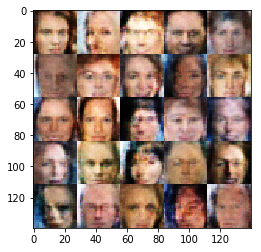

Epoch 1/1... Discriminator Loss: 0.8295... Generator Loss: 1.1656
Epoch 1/1... Discriminator Loss: 1.9157... Generator Loss: 0.2561
Epoch 1/1... Discriminator Loss: 0.7354... Generator Loss: 1.6475
Epoch 1/1... Discriminator Loss: 1.1338... Generator Loss: 0.6262
Epoch 1/1... Discriminator Loss: 1.0145... Generator Loss: 0.8551
Epoch 1/1... Discriminator Loss: 0.8464... Generator Loss: 0.9867
Epoch 1/1... Discriminator Loss: 0.6691... Generator Loss: 1.2970
Epoch 1/1... Discriminator Loss: 0.8638... Generator Loss: 0.9218
Epoch 1/1... Discriminator Loss: 0.7491... Generator Loss: 1.5929
Epoch 1/1... Discriminator Loss: 2.1731... Generator Loss: 0.1879
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


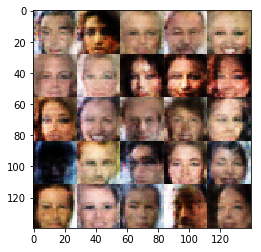

Epoch 1/1... Discriminator Loss: 1.2096... Generator Loss: 0.5539
Epoch 1/1... Discriminator Loss: 1.9064... Generator Loss: 0.2387
Epoch 1/1... Discriminator Loss: 0.8652... Generator Loss: 0.9148
Epoch 1/1... Discriminator Loss: 1.3759... Generator Loss: 0.4613
Epoch 1/1... Discriminator Loss: 0.9675... Generator Loss: 0.9339
Epoch 1/1... Discriminator Loss: 0.7915... Generator Loss: 1.1360
Epoch 1/1... Discriminator Loss: 1.0145... Generator Loss: 0.7385
Epoch 1/1... Discriminator Loss: 0.7735... Generator Loss: 1.0533
Epoch 1/1... Discriminator Loss: 0.9626... Generator Loss: 0.7863
Epoch 1/1... Discriminator Loss: 1.0665... Generator Loss: 0.6813
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


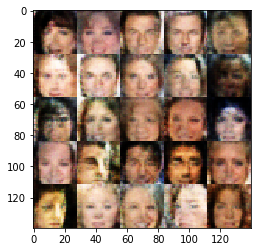

Epoch 1/1... Discriminator Loss: 0.6944... Generator Loss: 1.2516
Epoch 1/1... Discriminator Loss: 1.4760... Generator Loss: 0.4512
Epoch 1/1... Discriminator Loss: 1.2719... Generator Loss: 0.5259
Epoch 1/1... Discriminator Loss: 0.8146... Generator Loss: 1.0576
Epoch 1/1... Discriminator Loss: 1.1531... Generator Loss: 0.6713
Epoch 1/1... Discriminator Loss: 0.7920... Generator Loss: 1.3864
Epoch 1/1... Discriminator Loss: 1.5095... Generator Loss: 0.3806
Epoch 1/1... Discriminator Loss: 1.1650... Generator Loss: 0.5882
Epoch 1/1... Discriminator Loss: 2.0185... Generator Loss: 0.2263
Epoch 1/1... Discriminator Loss: 2.1764... Generator Loss: 0.1937
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


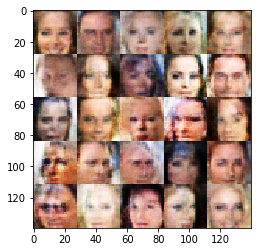

Epoch 1/1... Discriminator Loss: 1.2511... Generator Loss: 0.5268
Epoch 1/1... Discriminator Loss: 1.2532... Generator Loss: 0.5268
Epoch 1/1... Discriminator Loss: 1.3064... Generator Loss: 0.5400
Epoch 1/1... Discriminator Loss: 1.5978... Generator Loss: 0.3459
Epoch 1/1... Discriminator Loss: 1.2206... Generator Loss: 0.5678
Epoch 1/1... Discriminator Loss: 1.1390... Generator Loss: 0.7315
Epoch 1/1... Discriminator Loss: 1.2866... Generator Loss: 0.5011
Epoch 1/1... Discriminator Loss: 1.2506... Generator Loss: 0.6304
Epoch 1/1... Discriminator Loss: 1.1665... Generator Loss: 0.6119
Epoch 1/1... Discriminator Loss: 0.6464... Generator Loss: 1.7851
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


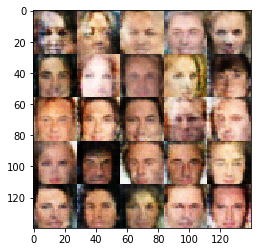

Epoch 1/1... Discriminator Loss: 1.6520... Generator Loss: 0.3309
Epoch 1/1... Discriminator Loss: 0.9703... Generator Loss: 0.7744
Epoch 1/1... Discriminator Loss: 1.1594... Generator Loss: 0.5946
Epoch 1/1... Discriminator Loss: 1.3956... Generator Loss: 0.4481
Epoch 1/1... Discriminator Loss: 0.5869... Generator Loss: 1.8522
Epoch 1/1... Discriminator Loss: 1.0065... Generator Loss: 0.9107
Epoch 1/1... Discriminator Loss: 1.7320... Generator Loss: 0.3088
Epoch 1/1... Discriminator Loss: 0.7383... Generator Loss: 1.1274
Epoch 1/1... Discriminator Loss: 0.6399... Generator Loss: 1.9451
Epoch 1/1... Discriminator Loss: 1.3452... Generator Loss: 0.4728
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


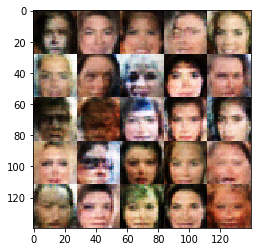

Epoch 1/1... Discriminator Loss: 0.9407... Generator Loss: 0.8134
Epoch 1/1... Discriminator Loss: 1.6030... Generator Loss: 0.3646
Epoch 1/1... Discriminator Loss: 1.1850... Generator Loss: 0.5810
Epoch 1/1... Discriminator Loss: 1.8171... Generator Loss: 0.2719
Epoch 1/1... Discriminator Loss: 1.0883... Generator Loss: 0.7076
Epoch 1/1... Discriminator Loss: 0.7956... Generator Loss: 1.1211
Epoch 1/1... Discriminator Loss: 1.0631... Generator Loss: 0.7175
Epoch 1/1... Discriminator Loss: 0.6335... Generator Loss: 1.4590
Epoch 1/1... Discriminator Loss: 1.1131... Generator Loss: 0.6288
Epoch 1/1... Discriminator Loss: 1.0841... Generator Loss: 0.6499
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


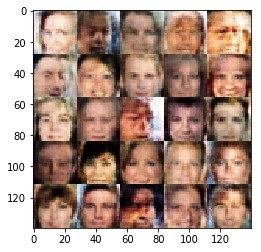

Epoch 1/1... Discriminator Loss: 1.2629... Generator Loss: 0.5688
Epoch 1/1... Discriminator Loss: 1.4730... Generator Loss: 0.4178
Epoch 1/1... Discriminator Loss: 1.0272... Generator Loss: 0.9142
Epoch 1/1... Discriminator Loss: 1.0557... Generator Loss: 0.7315
Epoch 1/1... Discriminator Loss: 1.4352... Generator Loss: 0.4100
Epoch 1/1... Discriminator Loss: 1.4045... Generator Loss: 0.4401
Epoch 1/1... Discriminator Loss: 0.7533... Generator Loss: 1.1250
Epoch 1/1... Discriminator Loss: 1.6615... Generator Loss: 0.3965
Epoch 1/1... Discriminator Loss: 0.9576... Generator Loss: 1.0081
Epoch 1/1... Discriminator Loss: 0.7577... Generator Loss: 1.1040
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


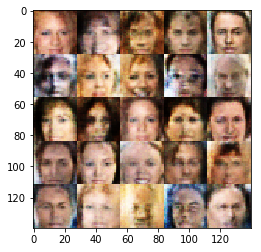

Epoch 1/1... Discriminator Loss: 1.5352... Generator Loss: 0.3666
Epoch 1/1... Discriminator Loss: 0.8046... Generator Loss: 1.0313
Epoch 1/1... Discriminator Loss: 0.8492... Generator Loss: 1.0002
Epoch 1/1... Discriminator Loss: 1.2139... Generator Loss: 0.6344
Epoch 1/1... Discriminator Loss: 0.8103... Generator Loss: 1.3361
Epoch 1/1... Discriminator Loss: 1.2950... Generator Loss: 0.5260
Epoch 1/1... Discriminator Loss: 0.7639... Generator Loss: 1.0845
Epoch 1/1... Discriminator Loss: 1.5537... Generator Loss: 0.4143
Epoch 1/1... Discriminator Loss: 1.0491... Generator Loss: 0.7027
Epoch 1/1... Discriminator Loss: 0.8302... Generator Loss: 1.0187
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


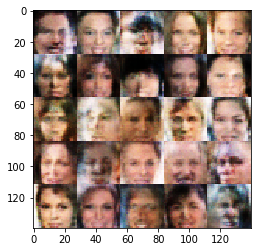

Epoch 1/1... Discriminator Loss: 1.7044... Generator Loss: 0.3037
Epoch 1/1... Discriminator Loss: 1.2908... Generator Loss: 0.4914
Epoch 1/1... Discriminator Loss: 0.8519... Generator Loss: 1.0166
Epoch 1/1... Discriminator Loss: 1.6859... Generator Loss: 0.3187
Epoch 1/1... Discriminator Loss: 1.2506... Generator Loss: 0.5489
Epoch 1/1... Discriminator Loss: 2.0660... Generator Loss: 0.1993
Epoch 1/1... Discriminator Loss: 1.1633... Generator Loss: 0.6114
Epoch 1/1... Discriminator Loss: 1.0146... Generator Loss: 0.7625
Epoch 1/1... Discriminator Loss: 1.2160... Generator Loss: 0.6155
Epoch 1/1... Discriminator Loss: 0.8545... Generator Loss: 1.6321
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


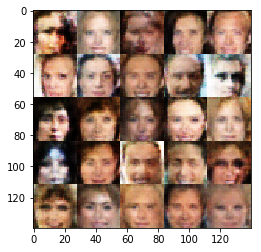

Epoch 1/1... Discriminator Loss: 1.8644... Generator Loss: 0.2533
Epoch 1/1... Discriminator Loss: 1.2591... Generator Loss: 0.5681
Epoch 1/1... Discriminator Loss: 0.9672... Generator Loss: 0.9161
Epoch 1/1... Discriminator Loss: 0.7713... Generator Loss: 1.2027
Epoch 1/1... Discriminator Loss: 1.0685... Generator Loss: 0.6991
Epoch 1/1... Discriminator Loss: 0.7847... Generator Loss: 2.0419
Epoch 1/1... Discriminator Loss: 1.5054... Generator Loss: 0.3888
Epoch 1/1... Discriminator Loss: 1.2020... Generator Loss: 0.6063
Epoch 1/1... Discriminator Loss: 1.2021... Generator Loss: 0.6000
Epoch 1/1... Discriminator Loss: 0.8203... Generator Loss: 1.1678
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


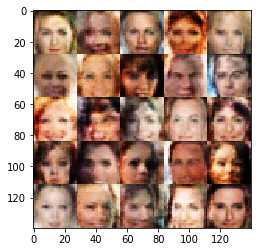

Epoch 1/1... Discriminator Loss: 1.4082... Generator Loss: 0.4381
Epoch 1/1... Discriminator Loss: 0.8670... Generator Loss: 1.3813
Epoch 1/1... Discriminator Loss: 1.9611... Generator Loss: 0.2388
Epoch 1/1... Discriminator Loss: 2.1737... Generator Loss: 0.1995
Epoch 1/1... Discriminator Loss: 1.3019... Generator Loss: 0.5139
Epoch 1/1... Discriminator Loss: 1.7549... Generator Loss: 0.2978
Epoch 1/1... Discriminator Loss: 1.1549... Generator Loss: 0.7159
Epoch 1/1... Discriminator Loss: 2.0988... Generator Loss: 0.2050
Epoch 1/1... Discriminator Loss: 1.5106... Generator Loss: 0.4075
Epoch 1/1... Discriminator Loss: 1.8733... Generator Loss: 0.2558
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


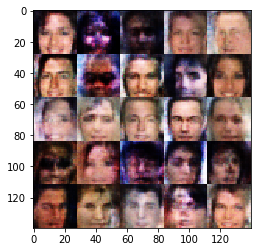

Epoch 1/1... Discriminator Loss: 0.9924... Generator Loss: 1.7101
Epoch 1/1... Discriminator Loss: 0.7101... Generator Loss: 1.2774
Epoch 1/1... Discriminator Loss: 0.6262... Generator Loss: 2.0094
Epoch 1/1... Discriminator Loss: 1.5100... Generator Loss: 0.3755
Epoch 1/1... Discriminator Loss: 1.1065... Generator Loss: 0.7656
Epoch 1/1... Discriminator Loss: 0.8408... Generator Loss: 1.1441
Epoch 1/1... Discriminator Loss: 1.2779... Generator Loss: 0.5563
Epoch 1/1... Discriminator Loss: 1.0142... Generator Loss: 0.7285
Epoch 1/1... Discriminator Loss: 0.8387... Generator Loss: 1.0624
Epoch 1/1... Discriminator Loss: 0.7524... Generator Loss: 1.1383
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


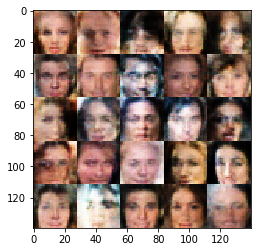

Epoch 1/1... Discriminator Loss: 0.8234... Generator Loss: 1.1309
Epoch 1/1... Discriminator Loss: 0.9525... Generator Loss: 1.0821
Epoch 1/1... Discriminator Loss: 2.0859... Generator Loss: 0.2031
Epoch 1/1... Discriminator Loss: 1.2390... Generator Loss: 0.6028
Epoch 1/1... Discriminator Loss: 2.0216... Generator Loss: 0.2150
Epoch 1/1... Discriminator Loss: 1.4246... Generator Loss: 0.4214
Epoch 1/1... Discriminator Loss: 1.1943... Generator Loss: 0.7239
Epoch 1/1... Discriminator Loss: 1.8587... Generator Loss: 0.2741
Epoch 1/1... Discriminator Loss: 1.0358... Generator Loss: 0.7240
Epoch 1/1... Discriminator Loss: 1.3008... Generator Loss: 0.4909
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


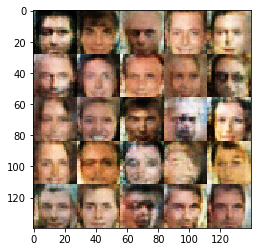

Epoch 1/1... Discriminator Loss: 0.9861... Generator Loss: 0.7686
Epoch 1/1... Discriminator Loss: 1.4158... Generator Loss: 0.4479
Epoch 1/1... Discriminator Loss: 1.1934... Generator Loss: 0.5820
Epoch 1/1... Discriminator Loss: 1.7444... Generator Loss: 0.3447
Epoch 1/1... Discriminator Loss: 1.1712... Generator Loss: 0.6117
Epoch 1/1... Discriminator Loss: 1.1566... Generator Loss: 0.5940
Epoch 1/1... Discriminator Loss: 1.1442... Generator Loss: 0.6257
Epoch 1/1... Discriminator Loss: 1.3196... Generator Loss: 0.4972
Epoch 1/1... Discriminator Loss: 0.7896... Generator Loss: 1.1573
Epoch 1/1... Discriminator Loss: 0.6657... Generator Loss: 1.3306
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


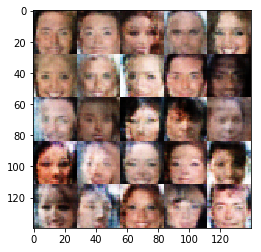

Epoch 1/1... Discriminator Loss: 0.8551... Generator Loss: 1.0715
Epoch 1/1... Discriminator Loss: 0.8914... Generator Loss: 0.8741
Epoch 1/1... Discriminator Loss: 0.7069... Generator Loss: 1.2277
Epoch 1/1... Discriminator Loss: 1.3755... Generator Loss: 0.4607
Epoch 1/1... Discriminator Loss: 0.8332... Generator Loss: 1.5776
Epoch 1/1... Discriminator Loss: 0.7960... Generator Loss: 1.0337
Epoch 1/1... Discriminator Loss: 1.1213... Generator Loss: 0.6570
Epoch 1/1... Discriminator Loss: 1.6464... Generator Loss: 0.3628
Epoch 1/1... Discriminator Loss: 1.0667... Generator Loss: 0.7279
Epoch 1/1... Discriminator Loss: 0.9095... Generator Loss: 0.9365
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


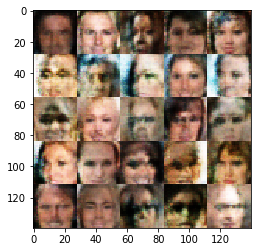

Epoch 1/1... Discriminator Loss: 0.7521... Generator Loss: 1.3091
Epoch 1/1... Discriminator Loss: 1.6549... Generator Loss: 0.3361
Epoch 1/1... Discriminator Loss: 0.9264... Generator Loss: 0.8733
Epoch 1/1... Discriminator Loss: 0.5747... Generator Loss: 1.8300
Epoch 1/1... Discriminator Loss: 0.7297... Generator Loss: 1.1649
Epoch 1/1... Discriminator Loss: 0.7565... Generator Loss: 1.6634
Epoch 1/1... Discriminator Loss: 0.6105... Generator Loss: 1.4410
Epoch 1/1... Discriminator Loss: 1.6620... Generator Loss: 0.3252
Epoch 1/1... Discriminator Loss: 1.1913... Generator Loss: 0.6101
Epoch 1/1... Discriminator Loss: 1.0293... Generator Loss: 1.1094
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


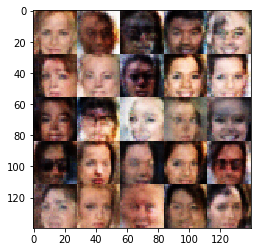

Epoch 1/1... Discriminator Loss: 1.6427... Generator Loss: 0.3870
Epoch 1/1... Discriminator Loss: 0.8537... Generator Loss: 1.3810
Epoch 1/1... Discriminator Loss: 1.6473... Generator Loss: 0.3344
Epoch 1/1... Discriminator Loss: 1.6340... Generator Loss: 0.3269
Epoch 1/1... Discriminator Loss: 2.8360... Generator Loss: 0.1015
Epoch 1/1... Discriminator Loss: 1.3706... Generator Loss: 0.4977
Epoch 1/1... Discriminator Loss: 0.6944... Generator Loss: 1.2334
Epoch 1/1... Discriminator Loss: 1.3039... Generator Loss: 0.5164
Epoch 1/1... Discriminator Loss: 0.7883... Generator Loss: 1.0823
Epoch 1/1... Discriminator Loss: 0.8690... Generator Loss: 0.8891
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


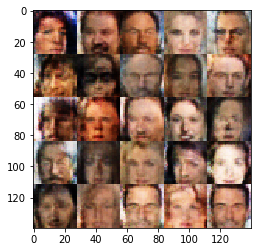

Epoch 1/1... Discriminator Loss: 2.1426... Generator Loss: 0.1926
Epoch 1/1... Discriminator Loss: 0.8754... Generator Loss: 0.9197
Epoch 1/1... Discriminator Loss: 1.8816... Generator Loss: 0.2508
Epoch 1/1... Discriminator Loss: 1.7655... Generator Loss: 0.2841
Epoch 1/1... Discriminator Loss: 0.6626... Generator Loss: 1.8037
Epoch 1/1... Discriminator Loss: 1.1668... Generator Loss: 0.6009
Epoch 1/1... Discriminator Loss: 0.4444... Generator Loss: 2.3611
Epoch 1/1... Discriminator Loss: 1.2735... Generator Loss: 0.5428
Epoch 1/1... Discriminator Loss: 0.9131... Generator Loss: 0.8577
Epoch 1/1... Discriminator Loss: 1.9677... Generator Loss: 0.2778
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


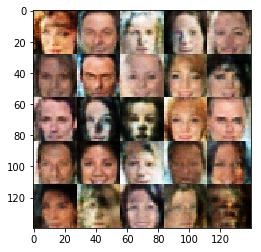

Epoch 1/1... Discriminator Loss: 1.2010... Generator Loss: 0.5700
Epoch 1/1... Discriminator Loss: 0.7374... Generator Loss: 1.2244
Epoch 1/1... Discriminator Loss: 0.8656... Generator Loss: 1.0099
Epoch 1/1... Discriminator Loss: 1.2229... Generator Loss: 0.5504
Epoch 1/1... Discriminator Loss: 0.7162... Generator Loss: 1.4497
Epoch 1/1... Discriminator Loss: 1.6753... Generator Loss: 0.3142
Epoch 1/1... Discriminator Loss: 1.3259... Generator Loss: 0.4986
Epoch 1/1... Discriminator Loss: 1.8073... Generator Loss: 0.2716
Epoch 1/1... Discriminator Loss: 0.7970... Generator Loss: 1.2325
Epoch 1/1... Discriminator Loss: 1.1189... Generator Loss: 0.6305
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


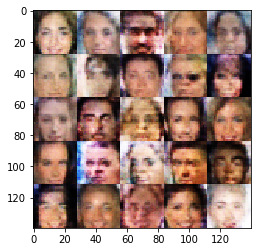

Epoch 1/1... Discriminator Loss: 1.3281... Generator Loss: 0.4870
Epoch 1/1... Discriminator Loss: 0.8629... Generator Loss: 0.9009
Epoch 1/1... Discriminator Loss: 1.0665... Generator Loss: 0.6734
Epoch 1/1... Discriminator Loss: 1.4081... Generator Loss: 0.4435
Epoch 1/1... Discriminator Loss: 1.6786... Generator Loss: 0.3210
Epoch 1/1... Discriminator Loss: 1.3525... Generator Loss: 0.4709
Epoch 1/1... Discriminator Loss: 0.7873... Generator Loss: 1.0395
Epoch 1/1... Discriminator Loss: 1.6636... Generator Loss: 0.3188
Epoch 1/1... Discriminator Loss: 0.8720... Generator Loss: 0.9815
Epoch 1/1... Discriminator Loss: 1.0103... Generator Loss: 1.9071
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


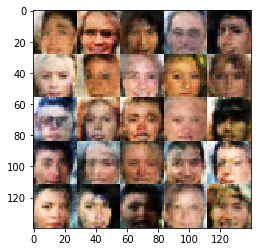

Epoch 1/1... Discriminator Loss: 1.8143... Generator Loss: 0.2688
Epoch 1/1... Discriminator Loss: 1.1433... Generator Loss: 0.6382
Epoch 1/1... Discriminator Loss: 1.2258... Generator Loss: 0.6118
Epoch 1/1... Discriminator Loss: 0.6389... Generator Loss: 1.5567
Epoch 1/1... Discriminator Loss: 2.2536... Generator Loss: 0.1693
Epoch 1/1... Discriminator Loss: 1.1314... Generator Loss: 0.6454
Epoch 1/1... Discriminator Loss: 1.1588... Generator Loss: 0.7781
Epoch 1/1... Discriminator Loss: 1.0335... Generator Loss: 0.7170
Epoch 1/1... Discriminator Loss: 1.4513... Generator Loss: 0.4394
Epoch 1/1... Discriminator Loss: 1.2553... Generator Loss: 0.5225
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


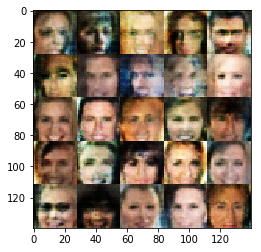

Epoch 1/1... Discriminator Loss: 0.9009... Generator Loss: 0.9650
Epoch 1/1... Discriminator Loss: 0.9706... Generator Loss: 0.8140
Epoch 1/1... Discriminator Loss: 0.6515... Generator Loss: 1.4252
Epoch 1/1... Discriminator Loss: 0.9714... Generator Loss: 0.8225
Epoch 1/1... Discriminator Loss: 2.0255... Generator Loss: 0.2225
Epoch 1/1... Discriminator Loss: 0.6006... Generator Loss: 1.5707
Epoch 1/1... Discriminator Loss: 1.2294... Generator Loss: 0.5963
Epoch 1/1... Discriminator Loss: 0.9979... Generator Loss: 0.7967
Epoch 1/1... Discriminator Loss: 0.9318... Generator Loss: 1.2787
Epoch 1/1... Discriminator Loss: 1.2449... Generator Loss: 0.5271
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


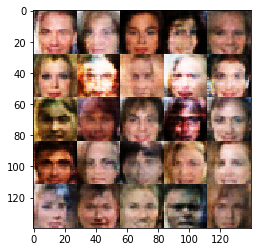

Epoch 1/1... Discriminator Loss: 1.2034... Generator Loss: 0.6016
Epoch 1/1... Discriminator Loss: 1.1309... Generator Loss: 0.6487
Epoch 1/1... Discriminator Loss: 1.3473... Generator Loss: 0.4826
Epoch 1/1... Discriminator Loss: 1.4698... Generator Loss: 0.4103
Epoch 1/1... Discriminator Loss: 0.8081... Generator Loss: 1.0157
Epoch 1/1... Discriminator Loss: 1.8593... Generator Loss: 0.2647
Epoch 1/1... Discriminator Loss: 1.4859... Generator Loss: 0.3956
Epoch 1/1... Discriminator Loss: 1.6885... Generator Loss: 0.3142
Epoch 1/1... Discriminator Loss: 0.8139... Generator Loss: 0.9973
Epoch 1/1... Discriminator Loss: 1.0306... Generator Loss: 0.8054
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


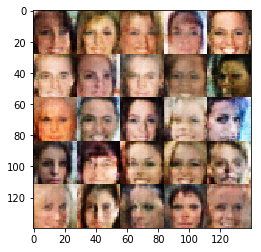

Epoch 1/1... Discriminator Loss: 0.7314... Generator Loss: 1.4785
Epoch 1/1... Discriminator Loss: 1.4403... Generator Loss: 0.4313
Epoch 1/1... Discriminator Loss: 0.9563... Generator Loss: 0.8459
Epoch 1/1... Discriminator Loss: 0.7522... Generator Loss: 1.1671
Epoch 1/1... Discriminator Loss: 0.6505... Generator Loss: 2.0766
Epoch 1/1... Discriminator Loss: 0.8870... Generator Loss: 0.8862
Epoch 1/1... Discriminator Loss: 0.8399... Generator Loss: 2.1058
Epoch 1/1... Discriminator Loss: 1.4371... Generator Loss: 0.4310
Epoch 1/1... Discriminator Loss: 1.2216... Generator Loss: 0.5607
Epoch 1/1... Discriminator Loss: 2.5929... Generator Loss: 0.1114
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


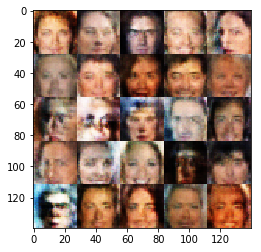

Epoch 1/1... Discriminator Loss: 1.3248... Generator Loss: 0.4664
Epoch 1/1... Discriminator Loss: 0.8170... Generator Loss: 0.9875
Epoch 1/1... Discriminator Loss: 0.7822... Generator Loss: 1.3928
Epoch 1/1... Discriminator Loss: 1.4591... Generator Loss: 0.4270
Epoch 1/1... Discriminator Loss: 0.7363... Generator Loss: 1.8302
Epoch 1/1... Discriminator Loss: 1.2061... Generator Loss: 0.5772
Epoch 1/1... Discriminator Loss: 1.0443... Generator Loss: 0.8563
Epoch 1/1... Discriminator Loss: 0.9019... Generator Loss: 1.8930
Epoch 1/1... Discriminator Loss: 0.8203... Generator Loss: 1.3444
Epoch 1/1... Discriminator Loss: 1.1021... Generator Loss: 0.6442
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


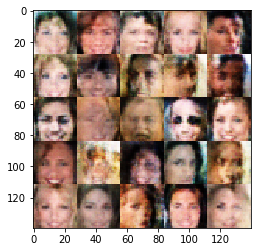

Epoch 1/1... Discriminator Loss: 0.7170... Generator Loss: 1.2621
Epoch 1/1... Discriminator Loss: 1.0931... Generator Loss: 0.6685
Epoch 1/1... Discriminator Loss: 1.2315... Generator Loss: 0.5575
Epoch 1/1... Discriminator Loss: 0.5816... Generator Loss: 2.0560
Epoch 1/1... Discriminator Loss: 0.8241... Generator Loss: 1.0368
Epoch 1/1... Discriminator Loss: 0.9202... Generator Loss: 0.8257
Epoch 1/1... Discriminator Loss: 0.8920... Generator Loss: 1.5777
Epoch 1/1... Discriminator Loss: 0.6871... Generator Loss: 1.5884
Epoch 1/1... Discriminator Loss: 2.1731... Generator Loss: 0.1902
Epoch 1/1... Discriminator Loss: 0.8242... Generator Loss: 1.0053
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


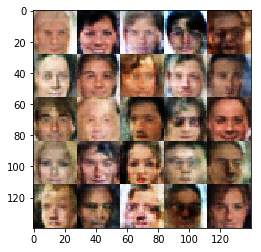

Epoch 1/1... Discriminator Loss: 0.8955... Generator Loss: 1.0637
Epoch 1/1... Discriminator Loss: 1.4173... Generator Loss: 0.4274
Epoch 1/1... Discriminator Loss: 0.7990... Generator Loss: 1.4193
Epoch 1/1... Discriminator Loss: 1.3810... Generator Loss: 0.4849
Epoch 1/1... Discriminator Loss: 1.8081... Generator Loss: 0.2811
Epoch 1/1... Discriminator Loss: 1.0497... Generator Loss: 0.7043
Epoch 1/1... Discriminator Loss: 2.1238... Generator Loss: 0.2233
Epoch 1/1... Discriminator Loss: 1.2560... Generator Loss: 0.5457
Epoch 1/1... Discriminator Loss: 0.5818... Generator Loss: 1.7411
Epoch 1/1... Discriminator Loss: 1.3925... Generator Loss: 0.4642
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


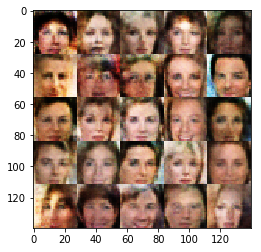

Epoch 1/1... Discriminator Loss: 1.2740... Generator Loss: 0.5140
Epoch 1/1... Discriminator Loss: 1.2011... Generator Loss: 0.6895
Epoch 1/1... Discriminator Loss: 0.8736... Generator Loss: 0.9706
Epoch 1/1... Discriminator Loss: 0.9273... Generator Loss: 0.8307
Epoch 1/1... Discriminator Loss: 2.3184... Generator Loss: 0.1529
Epoch 1/1... Discriminator Loss: 1.7216... Generator Loss: 0.3227
Epoch 1/1... Discriminator Loss: 0.8279... Generator Loss: 0.9576
Epoch 1/1... Discriminator Loss: 1.5293... Generator Loss: 0.3672
Epoch 1/1... Discriminator Loss: 1.0032... Generator Loss: 0.7434
Epoch 1/1... Discriminator Loss: 0.9723... Generator Loss: 0.8461
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


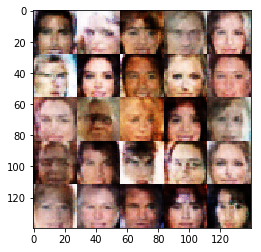

Epoch 1/1... Discriminator Loss: 0.9966... Generator Loss: 0.7733
Epoch 1/1... Discriminator Loss: 0.6155... Generator Loss: 1.6749
Epoch 1/1... Discriminator Loss: 0.7630... Generator Loss: 2.5725
Epoch 1/1... Discriminator Loss: 1.0862... Generator Loss: 0.6599
Epoch 1/1... Discriminator Loss: 1.1025... Generator Loss: 0.6509
Epoch 1/1... Discriminator Loss: 0.9175... Generator Loss: 0.9300
Epoch 1/1... Discriminator Loss: 1.1597... Generator Loss: 0.5839
Epoch 1/1... Discriminator Loss: 1.4176... Generator Loss: 0.4516
Epoch 1/1... Discriminator Loss: 0.8656... Generator Loss: 0.8947
Epoch 1/1... Discriminator Loss: 1.3863... Generator Loss: 0.4386
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


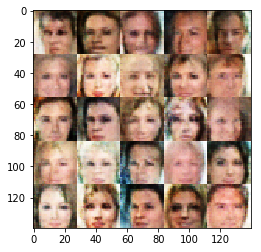

Epoch 1/1... Discriminator Loss: 1.1845... Generator Loss: 0.5679
Epoch 1/1... Discriminator Loss: 1.5271... Generator Loss: 0.3723
Epoch 1/1... Discriminator Loss: 1.2082... Generator Loss: 0.5744
Epoch 1/1... Discriminator Loss: 0.6928... Generator Loss: 1.2117
Epoch 1/1... Discriminator Loss: 1.6594... Generator Loss: 0.3233
Epoch 1/1... Discriminator Loss: 0.9864... Generator Loss: 0.7815
Epoch 1/1... Discriminator Loss: 1.1150... Generator Loss: 0.6280
Epoch 1/1... Discriminator Loss: 0.7580... Generator Loss: 1.1548
Epoch 1/1... Discriminator Loss: 1.1278... Generator Loss: 0.6229
Epoch 1/1... Discriminator Loss: 1.1714... Generator Loss: 0.5896
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


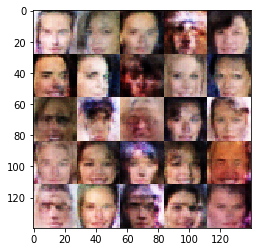

Epoch 1/1... Discriminator Loss: 1.2371... Generator Loss: 0.5546
Epoch 1/1... Discriminator Loss: 1.3220... Generator Loss: 0.4889
Epoch 1/1... Discriminator Loss: 0.7941... Generator Loss: 2.5157
Epoch 1/1... Discriminator Loss: 0.7703... Generator Loss: 1.1153
Epoch 1/1... Discriminator Loss: 1.8181... Generator Loss: 0.2749
Epoch 1/1... Discriminator Loss: 0.9174... Generator Loss: 0.8319
Epoch 1/1... Discriminator Loss: 0.9462... Generator Loss: 0.8588
Epoch 1/1... Discriminator Loss: 0.8551... Generator Loss: 0.9472
Epoch 1/1... Discriminator Loss: 0.8106... Generator Loss: 1.3908
Epoch 1/1... Discriminator Loss: 1.4946... Generator Loss: 0.3938
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


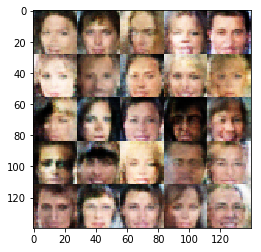

Epoch 1/1... Discriminator Loss: 1.4802... Generator Loss: 0.4021
Epoch 1/1... Discriminator Loss: 1.0559... Generator Loss: 0.6921
Epoch 1/1... Discriminator Loss: 1.0617... Generator Loss: 0.7284
Epoch 1/1... Discriminator Loss: 1.2670... Generator Loss: 0.6003
Epoch 1/1... Discriminator Loss: 0.6528... Generator Loss: 2.1434
Epoch 1/1... Discriminator Loss: 1.8532... Generator Loss: 0.2889
Epoch 1/1... Discriminator Loss: 1.7683... Generator Loss: 0.3280
Epoch 1/1... Discriminator Loss: 1.2564... Generator Loss: 0.5366
Epoch 1/1... Discriminator Loss: 1.0935... Generator Loss: 0.6399
Epoch 1/1... Discriminator Loss: 1.7407... Generator Loss: 0.3071
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


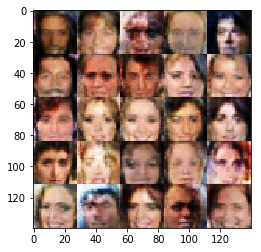

Epoch 1/1... Discriminator Loss: 2.8473... Generator Loss: 0.0983
Epoch 1/1... Discriminator Loss: 0.8357... Generator Loss: 1.4778
Epoch 1/1... Discriminator Loss: 1.5163... Generator Loss: 0.3845
Epoch 1/1... Discriminator Loss: 1.2016... Generator Loss: 0.5906
Epoch 1/1... Discriminator Loss: 1.5237... Generator Loss: 0.4115
Epoch 1/1... Discriminator Loss: 1.6227... Generator Loss: 0.3437
Epoch 1/1... Discriminator Loss: 2.0135... Generator Loss: 0.2159
Epoch 1/1... Discriminator Loss: 1.4752... Generator Loss: 0.3944
Epoch 1/1... Discriminator Loss: 0.9913... Generator Loss: 0.7380
Epoch 1/1... Discriminator Loss: 0.7624... Generator Loss: 1.1005
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


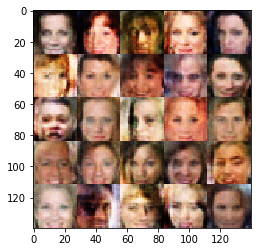

Epoch 1/1... Discriminator Loss: 0.8163... Generator Loss: 1.1121
Epoch 1/1... Discriminator Loss: 0.7750... Generator Loss: 1.3904
Epoch 1/1... Discriminator Loss: 0.8752... Generator Loss: 0.8891
Epoch 1/1... Discriminator Loss: 0.7711... Generator Loss: 1.2112
Epoch 1/1... Discriminator Loss: 0.8332... Generator Loss: 0.9772
Epoch 1/1... Discriminator Loss: 1.7932... Generator Loss: 0.2939
Epoch 1/1... Discriminator Loss: 1.6377... Generator Loss: 0.3593
Epoch 1/1... Discriminator Loss: 1.6233... Generator Loss: 0.3564
Epoch 1/1... Discriminator Loss: 1.3589... Generator Loss: 0.4532
Epoch 1/1... Discriminator Loss: 1.1980... Generator Loss: 0.6321
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


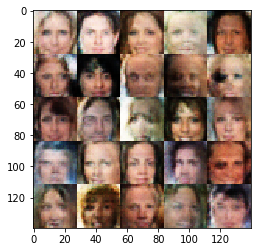

Epoch 1/1... Discriminator Loss: 1.6209... Generator Loss: 0.3384
Epoch 1/1... Discriminator Loss: 0.7970... Generator Loss: 1.0156
Epoch 1/1... Discriminator Loss: 0.7083... Generator Loss: 1.6036
Epoch 1/1... Discriminator Loss: 1.0824... Generator Loss: 0.6607
Epoch 1/1... Discriminator Loss: 0.8160... Generator Loss: 1.3207
Epoch 1/1... Discriminator Loss: 0.7473... Generator Loss: 1.3199
Epoch 1/1... Discriminator Loss: 1.7841... Generator Loss: 0.3629
Epoch 1/1... Discriminator Loss: 0.5481... Generator Loss: 2.3508
Epoch 1/1... Discriminator Loss: 1.2646... Generator Loss: 0.5394
Epoch 1/1... Discriminator Loss: 0.6537... Generator Loss: 2.4181
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


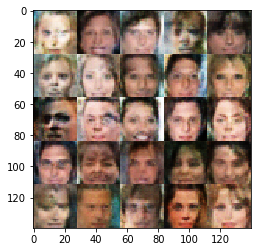

Epoch 1/1... Discriminator Loss: 1.0978... Generator Loss: 2.9439
Epoch 1/1... Discriminator Loss: 1.1106... Generator Loss: 0.6988
Epoch 1/1... Discriminator Loss: 1.2865... Generator Loss: 0.5547
Epoch 1/1... Discriminator Loss: 1.0721... Generator Loss: 0.7119
Epoch 1/1... Discriminator Loss: 1.1074... Generator Loss: 0.6432
Epoch 1/1... Discriminator Loss: 0.9732... Generator Loss: 0.7872
Epoch 1/1... Discriminator Loss: 0.7661... Generator Loss: 2.7603
Epoch 1/1... Discriminator Loss: 0.8282... Generator Loss: 0.9873
Epoch 1/1... Discriminator Loss: 1.2393... Generator Loss: 0.5341
Epoch 1/1... Discriminator Loss: 1.0143... Generator Loss: 0.8242
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


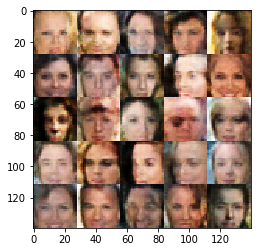

Epoch 1/1... Discriminator Loss: 1.0902... Generator Loss: 0.7054
Epoch 1/1... Discriminator Loss: 1.0837... Generator Loss: 0.6622
Epoch 1/1... Discriminator Loss: 0.8833... Generator Loss: 0.9851
Epoch 1/1... Discriminator Loss: 1.1403... Generator Loss: 0.6114
Epoch 1/1... Discriminator Loss: 0.8646... Generator Loss: 0.9711
Epoch 1/1... Discriminator Loss: 0.5324... Generator Loss: 2.1673
Epoch 1/1... Discriminator Loss: 2.0242... Generator Loss: 0.2257
Epoch 1/1... Discriminator Loss: 1.5116... Generator Loss: 0.3842
Epoch 1/1... Discriminator Loss: 1.4596... Generator Loss: 0.4301
Epoch 1/1... Discriminator Loss: 1.7534... Generator Loss: 0.3056
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


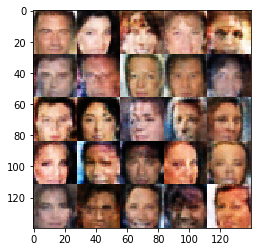

Epoch 1/1... Discriminator Loss: 1.0408... Generator Loss: 0.6849
Epoch 1/1... Discriminator Loss: 1.3787... Generator Loss: 0.4397
Epoch 1/1... Discriminator Loss: 1.0588... Generator Loss: 0.7004
Epoch 1/1... Discriminator Loss: 1.7481... Generator Loss: 0.3088
Epoch 1/1... Discriminator Loss: 0.9310... Generator Loss: 1.8851
Epoch 1/1... Discriminator Loss: 0.6197... Generator Loss: 1.6247
Epoch 1/1... Discriminator Loss: 0.5711... Generator Loss: 1.5597
Epoch 1/1... Discriminator Loss: 1.2238... Generator Loss: 0.5614
Epoch 1/1... Discriminator Loss: 0.8220... Generator Loss: 1.2135
Epoch 1/1... Discriminator Loss: 1.1727... Generator Loss: 0.6351
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


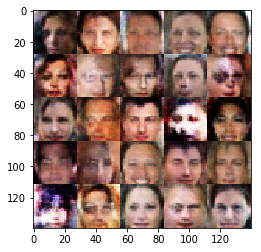

Epoch 1/1... Discriminator Loss: 1.3547... Generator Loss: 0.4775
Epoch 1/1... Discriminator Loss: 0.8475... Generator Loss: 0.9568
Epoch 1/1... Discriminator Loss: 0.8496... Generator Loss: 1.0638
Epoch 1/1... Discriminator Loss: 1.2867... Generator Loss: 0.5068
Epoch 1/1... Discriminator Loss: 1.2169... Generator Loss: 0.5538
Epoch 1/1... Discriminator Loss: 0.9287... Generator Loss: 0.8309
Epoch 1/1... Discriminator Loss: 0.9094... Generator Loss: 1.0316
Epoch 1/1... Discriminator Loss: 2.2397... Generator Loss: 0.1754
Epoch 1/1... Discriminator Loss: 0.6318... Generator Loss: 1.7962
Epoch 1/1... Discriminator Loss: 1.0698... Generator Loss: 0.6793
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


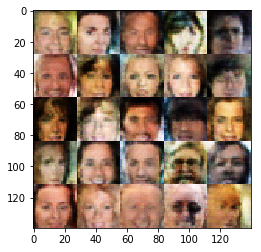

Epoch 1/1... Discriminator Loss: 0.7894... Generator Loss: 1.3338
Epoch 1/1... Discriminator Loss: 1.3446... Generator Loss: 0.4801
Epoch 1/1... Discriminator Loss: 0.6800... Generator Loss: 1.2675
Epoch 1/1... Discriminator Loss: 0.8268... Generator Loss: 1.2565
Epoch 1/1... Discriminator Loss: 0.8004... Generator Loss: 1.0276
Epoch 1/1... Discriminator Loss: 0.5412... Generator Loss: 1.7265
Epoch 1/1... Discriminator Loss: 1.3757... Generator Loss: 0.4568
Epoch 1/1... Discriminator Loss: 1.4020... Generator Loss: 0.4397
Epoch 1/1... Discriminator Loss: 1.0257... Generator Loss: 0.7471
Epoch 1/1... Discriminator Loss: 2.0367... Generator Loss: 0.2147
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


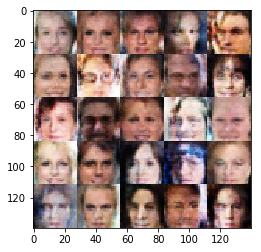

Epoch 1/1... Discriminator Loss: 1.1931... Generator Loss: 0.7625
Epoch 1/1... Discriminator Loss: 1.8537... Generator Loss: 0.2874
Epoch 1/1... Discriminator Loss: 0.9196... Generator Loss: 0.8708
Epoch 1/1... Discriminator Loss: 0.9997... Generator Loss: 0.7629
Epoch 1/1... Discriminator Loss: 1.2970... Generator Loss: 0.5250
Epoch 1/1... Discriminator Loss: 0.8937... Generator Loss: 0.9850
Epoch 1/1... Discriminator Loss: 1.5127... Generator Loss: 0.3846
Epoch 1/1... Discriminator Loss: 0.9453... Generator Loss: 0.7898
Epoch 1/1... Discriminator Loss: 0.7292... Generator Loss: 1.8945
Epoch 1/1... Discriminator Loss: 1.0504... Generator Loss: 0.8542
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


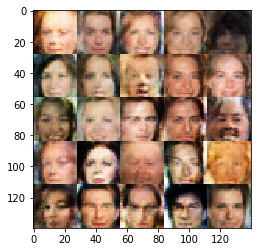

Epoch 1/1... Discriminator Loss: 0.6114... Generator Loss: 1.9046
Epoch 1/1... Discriminator Loss: 1.1757... Generator Loss: 0.5855
Epoch 1/1... Discriminator Loss: 0.7879... Generator Loss: 1.0265
Epoch 1/1... Discriminator Loss: 0.8523... Generator Loss: 0.9265
Epoch 1/1... Discriminator Loss: 1.6918... Generator Loss: 0.3169
Epoch 1/1... Discriminator Loss: 1.1116... Generator Loss: 0.9113
Epoch 1/1... Discriminator Loss: 1.4176... Generator Loss: 0.4783
Epoch 1/1... Discriminator Loss: 0.7704... Generator Loss: 1.1047
Epoch 1/1... Discriminator Loss: 1.1846... Generator Loss: 0.5751
Epoch 1/1... Discriminator Loss: 0.8826... Generator Loss: 0.9148
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


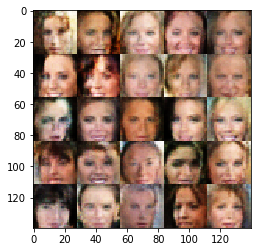

Epoch 1/1... Discriminator Loss: 1.2684... Generator Loss: 0.5569
Epoch 1/1... Discriminator Loss: 0.7069... Generator Loss: 1.5567
Epoch 1/1... Discriminator Loss: 2.0578... Generator Loss: 0.2252
Epoch 1/1... Discriminator Loss: 0.8618... Generator Loss: 0.9643
Epoch 1/1... Discriminator Loss: 1.0192... Generator Loss: 0.7430
Epoch 1/1... Discriminator Loss: 0.8575... Generator Loss: 1.2010
Epoch 1/1... Discriminator Loss: 1.0620... Generator Loss: 0.6677
Epoch 1/1... Discriminator Loss: 1.8384... Generator Loss: 0.2650
Epoch 1/1... Discriminator Loss: 1.3583... Generator Loss: 0.4621
Epoch 1/1... Discriminator Loss: 1.0126... Generator Loss: 0.7514
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


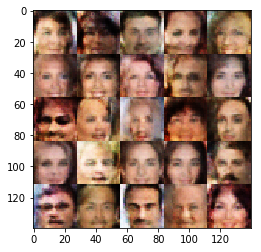

Epoch 1/1... Discriminator Loss: 1.8480... Generator Loss: 0.2752
Epoch 1/1... Discriminator Loss: 1.2482... Generator Loss: 0.5504
Epoch 1/1... Discriminator Loss: 1.4325... Generator Loss: 0.4995
Epoch 1/1... Discriminator Loss: 1.3254... Generator Loss: 0.5112
Epoch 1/1... Discriminator Loss: 0.8249... Generator Loss: 1.2064
Epoch 1/1... Discriminator Loss: 1.5190... Generator Loss: 0.3793
Epoch 1/1... Discriminator Loss: 0.9349... Generator Loss: 0.8192
Epoch 1/1... Discriminator Loss: 1.0218... Generator Loss: 0.7158
Epoch 1/1... Discriminator Loss: 0.8015... Generator Loss: 1.0417
Epoch 1/1... Discriminator Loss: 1.8378... Generator Loss: 0.2971
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


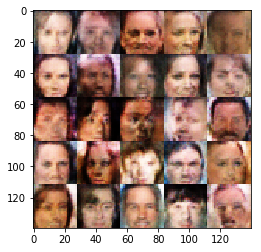

Epoch 1/1... Discriminator Loss: 1.5821... Generator Loss: 0.3649
Epoch 1/1... Discriminator Loss: 1.3825... Generator Loss: 0.4623
Epoch 1/1... Discriminator Loss: 1.3465... Generator Loss: 0.4756
Epoch 1/1... Discriminator Loss: 1.4376... Generator Loss: 0.4476
Epoch 1/1... Discriminator Loss: 1.0633... Generator Loss: 0.6792
Epoch 1/1... Discriminator Loss: 1.3829... Generator Loss: 0.4588
Epoch 1/1... Discriminator Loss: 0.9190... Generator Loss: 0.8599
Epoch 1/1... Discriminator Loss: 1.4032... Generator Loss: 0.4463
Epoch 1/1... Discriminator Loss: 1.5474... Generator Loss: 0.3994
Epoch 1/1... Discriminator Loss: 0.9817... Generator Loss: 0.7634
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


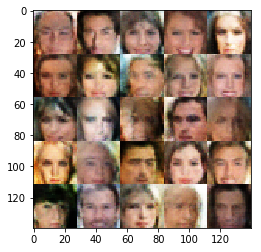

Epoch 1/1... Discriminator Loss: 1.1173... Generator Loss: 0.6320
Epoch 1/1... Discriminator Loss: 1.0290... Generator Loss: 0.7585
Epoch 1/1... Discriminator Loss: 0.8978... Generator Loss: 0.8636
Epoch 1/1... Discriminator Loss: 0.7323... Generator Loss: 1.3389
Epoch 1/1... Discriminator Loss: 1.2776... Generator Loss: 0.5454
Epoch 1/1... Discriminator Loss: 1.9772... Generator Loss: 0.2397
Epoch 1/1... Discriminator Loss: 1.6535... Generator Loss: 0.3356
Epoch 1/1... Discriminator Loss: 1.7685... Generator Loss: 0.2885
Epoch 1/1... Discriminator Loss: 0.8344... Generator Loss: 0.9739
Epoch 1/1... Discriminator Loss: 0.7677... Generator Loss: 1.3170
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


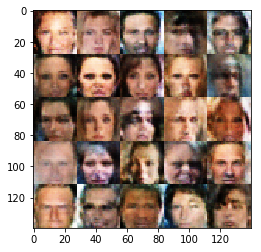

Epoch 1/1... Discriminator Loss: 1.1742... Generator Loss: 0.5908
Epoch 1/1... Discriminator Loss: 1.0001... Generator Loss: 0.7301
Epoch 1/1... Discriminator Loss: 1.3983... Generator Loss: 0.4371
Epoch 1/1... Discriminator Loss: 0.6507... Generator Loss: 1.4030
Epoch 1/1... Discriminator Loss: 1.4616... Generator Loss: 0.4214
Epoch 1/1... Discriminator Loss: 1.2010... Generator Loss: 0.5713
Epoch 1/1... Discriminator Loss: 1.8418... Generator Loss: 0.2589
Epoch 1/1... Discriminator Loss: 0.7034... Generator Loss: 1.4955
Epoch 1/1... Discriminator Loss: 2.2392... Generator Loss: 0.1819
Epoch 1/1... Discriminator Loss: 0.8590... Generator Loss: 1.1096
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


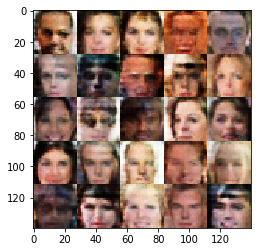

Epoch 1/1... Discriminator Loss: 2.0066... Generator Loss: 0.2121
Epoch 1/1... Discriminator Loss: 0.9551... Generator Loss: 0.8810
Epoch 1/1... Discriminator Loss: 1.6803... Generator Loss: 0.3160
Epoch 1/1... Discriminator Loss: 0.7153... Generator Loss: 1.2017
Epoch 1/1... Discriminator Loss: 0.9041... Generator Loss: 0.8844
Epoch 1/1... Discriminator Loss: 0.8907... Generator Loss: 0.8678
Epoch 1/1... Discriminator Loss: 0.6869... Generator Loss: 1.2948
Epoch 1/1... Discriminator Loss: 1.4748... Generator Loss: 0.3947
Epoch 1/1... Discriminator Loss: 0.8599... Generator Loss: 0.9455
Epoch 1/1... Discriminator Loss: 1.7364... Generator Loss: 0.2916
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


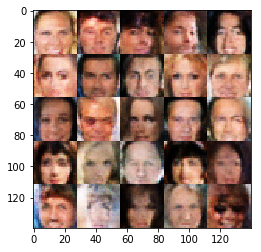

Epoch 1/1... Discriminator Loss: 1.1781... Generator Loss: 0.6291
Epoch 1/1... Discriminator Loss: 0.8705... Generator Loss: 0.9421
Epoch 1/1... Discriminator Loss: 2.1201... Generator Loss: 0.2226
Epoch 1/1... Discriminator Loss: 1.2163... Generator Loss: 0.5944
Epoch 1/1... Discriminator Loss: 1.4052... Generator Loss: 0.5270
Epoch 1/1... Discriminator Loss: 0.6963... Generator Loss: 1.8636
Epoch 1/1... Discriminator Loss: 0.6183... Generator Loss: 1.7488
Epoch 1/1... Discriminator Loss: 0.6707... Generator Loss: 1.4628
Epoch 1/1... Discriminator Loss: 1.9777... Generator Loss: 0.2204
Epoch 1/1... Discriminator Loss: 2.2174... Generator Loss: 0.2126
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


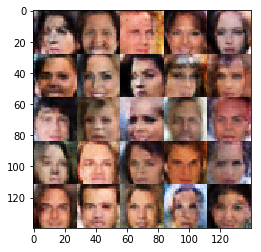

Epoch 1/1... Discriminator Loss: 0.7235... Generator Loss: 1.1768
Epoch 1/1... Discriminator Loss: 0.6461... Generator Loss: 1.4923
Epoch 1/1... Discriminator Loss: 0.8261... Generator Loss: 1.1455
Epoch 1/1... Discriminator Loss: 1.1134... Generator Loss: 0.6602
Epoch 1/1... Discriminator Loss: 2.4017... Generator Loss: 0.1512
Epoch 1/1... Discriminator Loss: 1.7034... Generator Loss: 0.3259
Epoch 1/1... Discriminator Loss: 1.5544... Generator Loss: 0.3661
Epoch 1/1... Discriminator Loss: 0.5985... Generator Loss: 1.5058
Epoch 1/1... Discriminator Loss: 1.1797... Generator Loss: 0.5762
Epoch 1/1... Discriminator Loss: 1.6720... Generator Loss: 0.3244
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


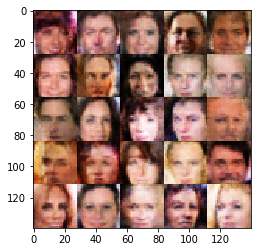

Epoch 1/1... Discriminator Loss: 1.6783... Generator Loss: 0.3137
Epoch 1/1... Discriminator Loss: 1.5213... Generator Loss: 0.3694
Epoch 1/1... Discriminator Loss: 1.5374... Generator Loss: 0.3728
Epoch 1/1... Discriminator Loss: 0.8037... Generator Loss: 1.0106
Epoch 1/1... Discriminator Loss: 1.3710... Generator Loss: 0.4510
Epoch 1/1... Discriminator Loss: 0.9236... Generator Loss: 0.8769
Epoch 1/1... Discriminator Loss: 0.8420... Generator Loss: 0.9477
Epoch 1/1... Discriminator Loss: 1.2634... Generator Loss: 0.5612
Epoch 1/1... Discriminator Loss: 1.1822... Generator Loss: 0.5796
Epoch 1/1... Discriminator Loss: 0.8079... Generator Loss: 1.1629
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


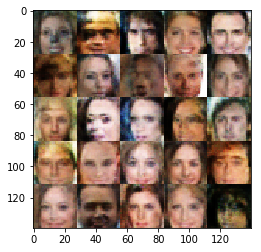

Epoch 1/1... Discriminator Loss: 0.7201... Generator Loss: 1.4201
Epoch 1/1... Discriminator Loss: 1.1281... Generator Loss: 0.6359
Epoch 1/1... Discriminator Loss: 1.0915... Generator Loss: 0.6748
Epoch 1/1... Discriminator Loss: 0.6871... Generator Loss: 2.3672
Epoch 1/1... Discriminator Loss: 0.8677... Generator Loss: 0.9005
Epoch 1/1... Discriminator Loss: 0.8794... Generator Loss: 0.9124
Epoch 1/1... Discriminator Loss: 0.7303... Generator Loss: 1.1411
Epoch 1/1... Discriminator Loss: 1.1861... Generator Loss: 0.5624
Epoch 1/1... Discriminator Loss: 0.7771... Generator Loss: 1.3792
Epoch 1/1... Discriminator Loss: 1.1562... Generator Loss: 0.6276
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


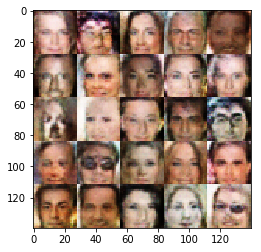

Epoch 1/1... Discriminator Loss: 1.2187... Generator Loss: 0.5685
Epoch 1/1... Discriminator Loss: 3.1043... Generator Loss: 0.0686
Epoch 1/1... Discriminator Loss: 0.8070... Generator Loss: 1.1592
Epoch 1/1... Discriminator Loss: 1.0211... Generator Loss: 0.7902
Epoch 1/1... Discriminator Loss: 1.8051... Generator Loss: 0.2758
Epoch 1/1... Discriminator Loss: 1.4165... Generator Loss: 0.4269
Epoch 1/1... Discriminator Loss: 1.0666... Generator Loss: 0.6839
Epoch 1/1... Discriminator Loss: 1.1510... Generator Loss: 0.5910
Epoch 1/1... Discriminator Loss: 0.6852... Generator Loss: 1.2762
Epoch 1/1... Discriminator Loss: 0.6655... Generator Loss: 1.4127
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


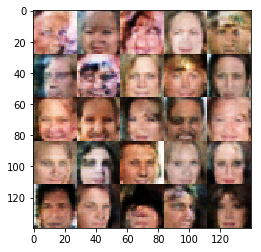

Epoch 1/1... Discriminator Loss: 1.3700... Generator Loss: 0.4770
Epoch 1/1... Discriminator Loss: 0.8028... Generator Loss: 1.0437
Epoch 1/1... Discriminator Loss: 1.4700... Generator Loss: 0.4902
Epoch 1/1... Discriminator Loss: 0.9652... Generator Loss: 0.7879
Epoch 1/1... Discriminator Loss: 0.9659... Generator Loss: 0.8830
Epoch 1/1... Discriminator Loss: 0.8240... Generator Loss: 1.0926
Epoch 1/1... Discriminator Loss: 0.9297... Generator Loss: 0.8852
Epoch 1/1... Discriminator Loss: 1.1497... Generator Loss: 0.5946
Epoch 1/1... Discriminator Loss: 0.9670... Generator Loss: 0.7819
Epoch 1/1... Discriminator Loss: 0.8722... Generator Loss: 1.1358
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


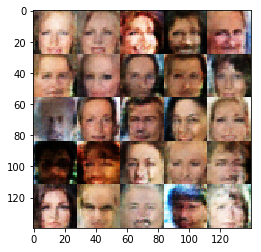

Epoch 1/1... Discriminator Loss: 0.9926... Generator Loss: 0.8296
Epoch 1/1... Discriminator Loss: 2.8721... Generator Loss: 0.0962
Epoch 1/1... Discriminator Loss: 1.4250... Generator Loss: 0.4573
Epoch 1/1... Discriminator Loss: 1.7686... Generator Loss: 0.2941
Epoch 1/1... Discriminator Loss: 0.9345... Generator Loss: 0.8295
Epoch 1/1... Discriminator Loss: 0.8247... Generator Loss: 1.3217
Epoch 1/1... Discriminator Loss: 1.8423... Generator Loss: 0.2812
Epoch 1/1... Discriminator Loss: 1.2350... Generator Loss: 0.6559
Epoch 1/1... Discriminator Loss: 1.6216... Generator Loss: 0.3664
Epoch 1/1... Discriminator Loss: 0.9498... Generator Loss: 0.8146
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


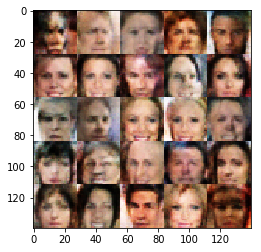

Epoch 1/1... Discriminator Loss: 0.7034... Generator Loss: 1.1968
Epoch 1/1... Discriminator Loss: 0.7678... Generator Loss: 1.0621
Epoch 1/1... Discriminator Loss: 1.0834... Generator Loss: 0.8356
Epoch 1/1... Discriminator Loss: 0.8762... Generator Loss: 1.0465
Epoch 1/1... Discriminator Loss: 1.7653... Generator Loss: 0.2786
Epoch 1/1... Discriminator Loss: 1.2613... Generator Loss: 0.5686
Epoch 1/1... Discriminator Loss: 1.7272... Generator Loss: 0.3006
Epoch 1/1... Discriminator Loss: 1.5470... Generator Loss: 0.4094
Epoch 1/1... Discriminator Loss: 1.9109... Generator Loss: 0.2417
Epoch 1/1... Discriminator Loss: 1.2685... Generator Loss: 0.5162
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


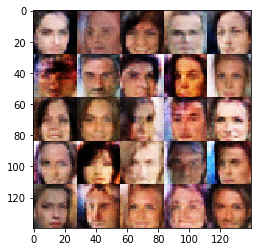

Epoch 1/1... Discriminator Loss: 0.7744... Generator Loss: 1.1169
Epoch 1/1... Discriminator Loss: 1.6419... Generator Loss: 0.3718
Epoch 1/1... Discriminator Loss: 1.0210... Generator Loss: 0.7280
Epoch 1/1... Discriminator Loss: 1.5492... Generator Loss: 0.3926
Epoch 1/1... Discriminator Loss: 1.0410... Generator Loss: 0.7033
Epoch 1/1... Discriminator Loss: 1.2034... Generator Loss: 0.5702
Epoch 1/1... Discriminator Loss: 2.1192... Generator Loss: 0.2530
Epoch 1/1... Discriminator Loss: 0.8842... Generator Loss: 0.9140
Epoch 1/1... Discriminator Loss: 1.1217... Generator Loss: 0.6596
Epoch 1/1... Discriminator Loss: 1.7329... Generator Loss: 0.3285
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


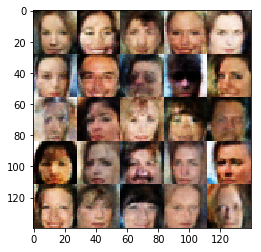

Epoch 1/1... Discriminator Loss: 1.1359... Generator Loss: 0.6098
Epoch 1/1... Discriminator Loss: 0.8935... Generator Loss: 0.8846
Epoch 1/1... Discriminator Loss: 0.9577... Generator Loss: 0.7984
Epoch 1/1... Discriminator Loss: 0.8462... Generator Loss: 0.9515
Epoch 1/1... Discriminator Loss: 1.2756... Generator Loss: 0.5016
Epoch 1/1... Discriminator Loss: 2.0052... Generator Loss: 0.2273
Epoch 1/1... Discriminator Loss: 0.5216... Generator Loss: 2.1963
Epoch 1/1... Discriminator Loss: 1.7061... Generator Loss: 0.3120
Epoch 1/1... Discriminator Loss: 1.6410... Generator Loss: 0.4256
Epoch 1/1... Discriminator Loss: 1.2983... Generator Loss: 0.5425
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


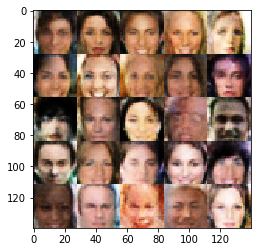

Epoch 1/1... Discriminator Loss: 1.0566... Generator Loss: 0.7060
Epoch 1/1... Discriminator Loss: 0.8511... Generator Loss: 0.9535
Epoch 1/1... Discriminator Loss: 1.5950... Generator Loss: 0.3752
Epoch 1/1... Discriminator Loss: 0.6296... Generator Loss: 1.4420
Epoch 1/1... Discriminator Loss: 0.7652... Generator Loss: 1.1177
Epoch 1/1... Discriminator Loss: 2.2288... Generator Loss: 0.1856
Epoch 1/1... Discriminator Loss: 1.2846... Generator Loss: 0.5157
Epoch 1/1... Discriminator Loss: 1.2841... Generator Loss: 0.5726
Epoch 1/1... Discriminator Loss: 0.9557... Generator Loss: 0.7809
Epoch 1/1... Discriminator Loss: 0.7424... Generator Loss: 1.2910
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


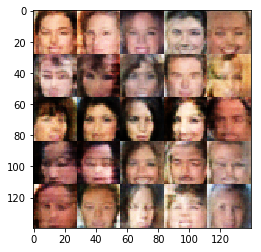

Epoch 1/1... Discriminator Loss: 0.8172... Generator Loss: 1.0680
Epoch 1/1... Discriminator Loss: 0.7840... Generator Loss: 1.1005
Epoch 1/1... Discriminator Loss: 1.9246... Generator Loss: 0.2431
Epoch 1/1... Discriminator Loss: 0.8919... Generator Loss: 0.9272
Epoch 1/1... Discriminator Loss: 0.8106... Generator Loss: 1.2813
Epoch 1/1... Discriminator Loss: 1.4183... Generator Loss: 0.4388
Epoch 1/1... Discriminator Loss: 1.3262... Generator Loss: 0.5300
Epoch 1/1... Discriminator Loss: 0.9063... Generator Loss: 0.9452
Epoch 1/1... Discriminator Loss: 1.5283... Generator Loss: 0.3773
Epoch 1/1... Discriminator Loss: 1.2260... Generator Loss: 0.6686
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


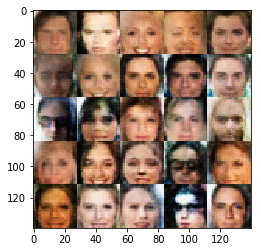

Epoch 1/1... Discriminator Loss: 1.3002... Generator Loss: 0.5038
Epoch 1/1... Discriminator Loss: 1.0572... Generator Loss: 0.7158
Epoch 1/1... Discriminator Loss: 0.9330... Generator Loss: 0.8342
Epoch 1/1... Discriminator Loss: 1.4450... Generator Loss: 0.4544
Epoch 1/1... Discriminator Loss: 1.1135... Generator Loss: 0.6229
Epoch 1/1... Discriminator Loss: 0.5981... Generator Loss: 1.4917
Epoch 1/1... Discriminator Loss: 0.9241... Generator Loss: 0.8376
Epoch 1/1... Discriminator Loss: 1.0613... Generator Loss: 0.6757
Epoch 1/1... Discriminator Loss: 1.3396... Generator Loss: 0.5113
Epoch 1/1... Discriminator Loss: 1.5334... Generator Loss: 0.4190
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


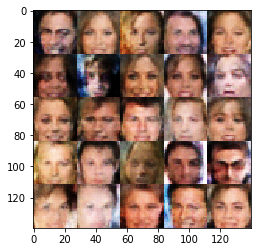

Epoch 1/1... Discriminator Loss: 0.7434... Generator Loss: 1.2368
Epoch 1/1... Discriminator Loss: 1.5278... Generator Loss: 0.4024
Epoch 1/1... Discriminator Loss: 0.7033... Generator Loss: 1.3966
Epoch 1/1... Discriminator Loss: 1.9152... Generator Loss: 0.2571
Epoch 1/1... Discriminator Loss: 1.3238... Generator Loss: 0.6554
Epoch 1/1... Discriminator Loss: 1.1302... Generator Loss: 0.6083
Epoch 1/1... Discriminator Loss: 1.6748... Generator Loss: 0.3160
Epoch 1/1... Discriminator Loss: 0.8079... Generator Loss: 1.0047
Epoch 1/1... Discriminator Loss: 1.0089... Generator Loss: 0.7517
Epoch 1/1... Discriminator Loss: 0.6288... Generator Loss: 1.8026
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


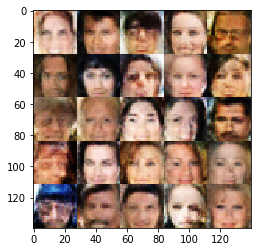

Epoch 1/1... Discriminator Loss: 1.0594... Generator Loss: 0.7344
Epoch 1/1... Discriminator Loss: 1.2582... Generator Loss: 0.5654
Epoch 1/1... Discriminator Loss: 1.4642... Generator Loss: 0.4409
Epoch 1/1... Discriminator Loss: 0.7720... Generator Loss: 1.1123
Epoch 1/1... Discriminator Loss: 0.8665... Generator Loss: 1.0277
Epoch 1/1... Discriminator Loss: 2.0798... Generator Loss: 0.1973
Epoch 1/1... Discriminator Loss: 1.6398... Generator Loss: 0.3517
Epoch 1/1... Discriminator Loss: 0.9701... Generator Loss: 0.7900
Epoch 1/1... Discriminator Loss: 1.3806... Generator Loss: 0.4503
Epoch 1/1... Discriminator Loss: 1.1094... Generator Loss: 0.6543
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


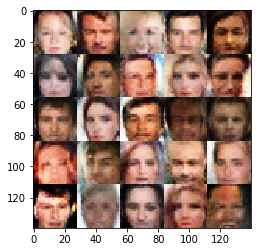

Epoch 1/1... Discriminator Loss: 1.3624... Generator Loss: 0.4531
Epoch 1/1... Discriminator Loss: 0.7757... Generator Loss: 1.0469
Epoch 1/1... Discriminator Loss: 0.6301... Generator Loss: 1.4574
Epoch 1/1... Discriminator Loss: 0.7729... Generator Loss: 2.4227
Epoch 1/1... Discriminator Loss: 1.2280... Generator Loss: 0.5682
Epoch 1/1... Discriminator Loss: 1.6571... Generator Loss: 0.3301
Epoch 1/1... Discriminator Loss: 1.4334... Generator Loss: 0.4765
Epoch 1/1... Discriminator Loss: 1.2817... Generator Loss: 0.5957
Epoch 1/1... Discriminator Loss: 0.6529... Generator Loss: 1.3837
Epoch 1/1... Discriminator Loss: 1.6746... Generator Loss: 0.3144
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


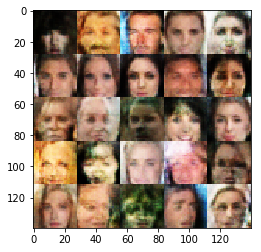

Epoch 1/1... Discriminator Loss: 1.2596... Generator Loss: 0.5291
Epoch 1/1... Discriminator Loss: 0.7085... Generator Loss: 1.1924
Epoch 1/1... Discriminator Loss: 1.6404... Generator Loss: 0.3299
Epoch 1/1... Discriminator Loss: 0.7510... Generator Loss: 1.1053
Epoch 1/1... Discriminator Loss: 0.6171... Generator Loss: 2.2145
Epoch 1/1... Discriminator Loss: 0.9569... Generator Loss: 0.8730
Epoch 1/1... Discriminator Loss: 0.9635... Generator Loss: 0.8328
Epoch 1/1... Discriminator Loss: 1.5415... Generator Loss: 0.4103
Epoch 1/1... Discriminator Loss: 1.6758... Generator Loss: 0.3488
Epoch 1/1... Discriminator Loss: 1.5713... Generator Loss: 0.3575
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


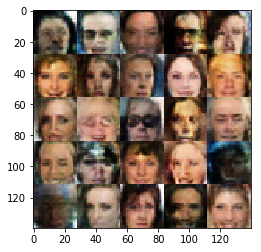

Epoch 1/1... Discriminator Loss: 0.5591... Generator Loss: 1.7568
Epoch 1/1... Discriminator Loss: 1.0049... Generator Loss: 2.1756
Epoch 1/1... Discriminator Loss: 0.9287... Generator Loss: 0.8243
Epoch 1/1... Discriminator Loss: 2.2565... Generator Loss: 0.1861
Epoch 1/1... Discriminator Loss: 2.1637... Generator Loss: 0.1914
Epoch 1/1... Discriminator Loss: 0.8772... Generator Loss: 0.8688
Epoch 1/1... Discriminator Loss: 0.8062... Generator Loss: 1.0607
Epoch 1/1... Discriminator Loss: 1.1964... Generator Loss: 0.5697
Epoch 1/1... Discriminator Loss: 1.9724... Generator Loss: 0.2354
Epoch 1/1... Discriminator Loss: 1.5726... Generator Loss: 0.3647
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


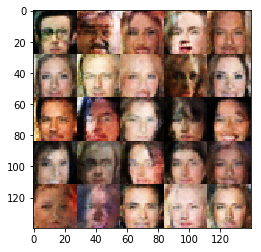

Epoch 1/1... Discriminator Loss: 1.4834... Generator Loss: 0.4141
Epoch 1/1... Discriminator Loss: 1.0760... Generator Loss: 0.7743
Epoch 1/1... Discriminator Loss: 1.4524... Generator Loss: 0.4092
Epoch 1/1... Discriminator Loss: 1.3861... Generator Loss: 0.5857
Epoch 1/1... Discriminator Loss: 0.8208... Generator Loss: 1.0523
Epoch 1/1... Discriminator Loss: 1.5142... Generator Loss: 0.5258
Epoch 1/1... Discriminator Loss: 0.7065... Generator Loss: 2.5776
Epoch 1/1... Discriminator Loss: 1.4791... Generator Loss: 0.4469
Epoch 1/1... Discriminator Loss: 1.2706... Generator Loss: 0.5223
Epoch 1/1... Discriminator Loss: 0.8552... Generator Loss: 1.0516
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


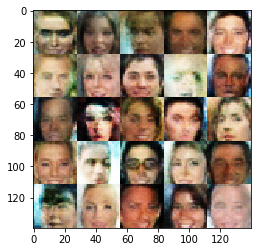

Epoch 1/1... Discriminator Loss: 0.6828... Generator Loss: 1.2628
Epoch 1/1... Discriminator Loss: 1.1096... Generator Loss: 0.7923
Epoch 1/1... Discriminator Loss: 0.8606... Generator Loss: 0.9356
Epoch 1/1... Discriminator Loss: 0.7612... Generator Loss: 1.1801
Epoch 1/1... Discriminator Loss: 1.0803... Generator Loss: 0.6959
Epoch 1/1... Discriminator Loss: 1.4965... Generator Loss: 0.4385
Epoch 1/1... Discriminator Loss: 1.4996... Generator Loss: 0.3932
Epoch 1/1... Discriminator Loss: 0.6682... Generator Loss: 1.4542
Epoch 1/1... Discriminator Loss: 2.0908... Generator Loss: 0.2375
Epoch 1/1... Discriminator Loss: 0.9103... Generator Loss: 0.8354
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


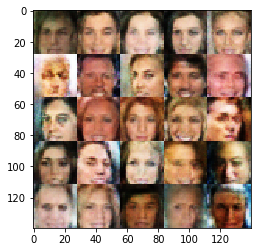

Epoch 1/1... Discriminator Loss: 1.3372... Generator Loss: 0.4885
Epoch 1/1... Discriminator Loss: 1.0762... Generator Loss: 0.6879
Epoch 1/1... Discriminator Loss: 1.5626... Generator Loss: 0.3684
Epoch 1/1... Discriminator Loss: 1.1798... Generator Loss: 0.6128
Epoch 1/1... Discriminator Loss: 1.5458... Generator Loss: 0.4087
Epoch 1/1... Discriminator Loss: 0.7621... Generator Loss: 1.1792
Epoch 1/1... Discriminator Loss: 1.7121... Generator Loss: 0.3157
Epoch 1/1... Discriminator Loss: 1.5074... Generator Loss: 0.3844
Epoch 1/1... Discriminator Loss: 0.7861... Generator Loss: 1.1055
Epoch 1/1... Discriminator Loss: 2.2461... Generator Loss: 0.1858
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


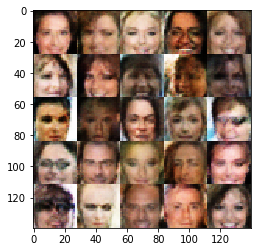

Epoch 1/1... Discriminator Loss: 1.0606... Generator Loss: 0.7297
Epoch 1/1... Discriminator Loss: 1.9651... Generator Loss: 0.2298
Epoch 1/1... Discriminator Loss: 1.0439... Generator Loss: 0.7556
Epoch 1/1... Discriminator Loss: 1.2729... Generator Loss: 0.5279
Epoch 1/1... Discriminator Loss: 0.6083... Generator Loss: 1.9999
Epoch 1/1... Discriminator Loss: 0.9539... Generator Loss: 0.8295
Epoch 1/1... Discriminator Loss: 1.9543... Generator Loss: 0.2967
Epoch 1/1... Discriminator Loss: 1.0582... Generator Loss: 0.7532
Epoch 1/1... Discriminator Loss: 1.0599... Generator Loss: 0.6877
Epoch 1/1... Discriminator Loss: 1.1459... Generator Loss: 0.6768
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


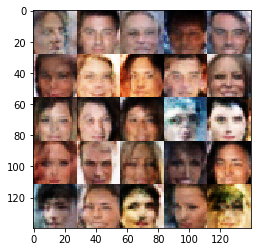

Epoch 1/1... Discriminator Loss: 1.1915... Generator Loss: 0.5591
Epoch 1/1... Discriminator Loss: 1.5604... Generator Loss: 0.3981
Epoch 1/1... Discriminator Loss: 1.0645... Generator Loss: 0.6877
Epoch 1/1... Discriminator Loss: 0.5053... Generator Loss: 2.0212
Epoch 1/1... Discriminator Loss: 1.0431... Generator Loss: 0.7106
Epoch 1/1... Discriminator Loss: 0.7100... Generator Loss: 1.7155
Epoch 1/1... Discriminator Loss: 0.8521... Generator Loss: 0.9632
Epoch 1/1... Discriminator Loss: 1.1573... Generator Loss: 0.6141
Epoch 1/1... Discriminator Loss: 1.4829... Generator Loss: 0.4260
Epoch 1/1... Discriminator Loss: 0.8533... Generator Loss: 0.9228
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


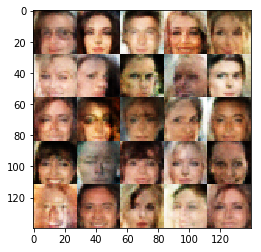

Epoch 1/1... Discriminator Loss: 0.9186... Generator Loss: 0.8463
Epoch 1/1... Discriminator Loss: 1.1815... Generator Loss: 0.5715
Epoch 1/1... Discriminator Loss: 0.6857... Generator Loss: 1.3928
Epoch 1/1... Discriminator Loss: 2.0291... Generator Loss: 0.2327
Epoch 1/1... Discriminator Loss: 1.0094... Generator Loss: 0.7267
Epoch 1/1... Discriminator Loss: 1.6983... Generator Loss: 0.2998
Epoch 1/1... Discriminator Loss: 1.6353... Generator Loss: 0.3696
Epoch 1/1... Discriminator Loss: 0.9359... Generator Loss: 0.8215
Epoch 1/1... Discriminator Loss: 0.6933... Generator Loss: 1.2633
Epoch 1/1... Discriminator Loss: 0.6131... Generator Loss: 2.3698
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


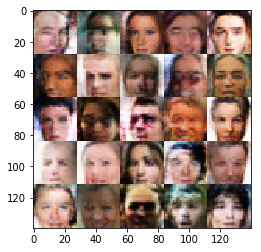

Epoch 1/1... Discriminator Loss: 0.8674... Generator Loss: 0.9138
Epoch 1/1... Discriminator Loss: 0.5561... Generator Loss: 2.9680
Epoch 1/1... Discriminator Loss: 1.6337... Generator Loss: 0.3261
Epoch 1/1... Discriminator Loss: 0.6971... Generator Loss: 1.2648
Epoch 1/1... Discriminator Loss: 1.4509... Generator Loss: 0.4018
Epoch 1/1... Discriminator Loss: 0.9921... Generator Loss: 0.7815
Epoch 1/1... Discriminator Loss: 1.2089... Generator Loss: 0.5830
Epoch 1/1... Discriminator Loss: 2.1083... Generator Loss: 0.2041
Epoch 1/1... Discriminator Loss: 1.0014... Generator Loss: 0.7987
Epoch 1/1... Discriminator Loss: 0.7830... Generator Loss: 2.0441
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


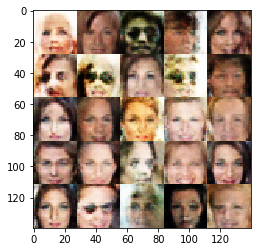

Epoch 1/1... Discriminator Loss: 0.8266... Generator Loss: 0.9775
Epoch 1/1... Discriminator Loss: 1.2559... Generator Loss: 0.6173
Epoch 1/1... Discriminator Loss: 1.7886... Generator Loss: 0.3053
Epoch 1/1... Discriminator Loss: 1.2601... Generator Loss: 0.5137
Epoch 1/1... Discriminator Loss: 1.4665... Generator Loss: 0.4643
Epoch 1/1... Discriminator Loss: 1.3371... Generator Loss: 0.5330
Epoch 1/1... Discriminator Loss: 1.5223... Generator Loss: 0.3997
Epoch 1/1... Discriminator Loss: 1.1926... Generator Loss: 0.6109
Epoch 1/1... Discriminator Loss: 0.8367... Generator Loss: 1.1370
Epoch 1/1... Discriminator Loss: 2.0788... Generator Loss: 0.2143
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


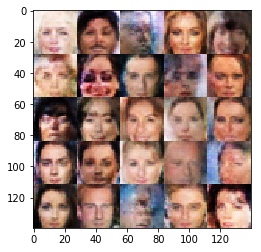

Epoch 1/1... Discriminator Loss: 0.9878... Generator Loss: 0.8452
Epoch 1/1... Discriminator Loss: 1.1376... Generator Loss: 0.6175
Epoch 1/1... Discriminator Loss: 1.3343... Generator Loss: 0.5728
Epoch 1/1... Discriminator Loss: 0.7399... Generator Loss: 1.2100
Epoch 1/1... Discriminator Loss: 2.0108... Generator Loss: 0.2226
Epoch 1/1... Discriminator Loss: 1.1412... Generator Loss: 0.6329
Epoch 1/1... Discriminator Loss: 1.6775... Generator Loss: 0.3339
Epoch 1/1... Discriminator Loss: 1.2132... Generator Loss: 0.5859
Epoch 1/1... Discriminator Loss: 0.7744... Generator Loss: 1.0962
Epoch 1/1... Discriminator Loss: 1.0989... Generator Loss: 0.7755
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


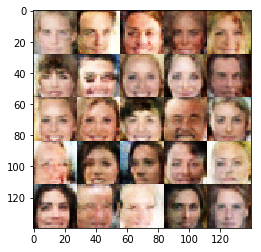

Epoch 1/1... Discriminator Loss: 1.4580... Generator Loss: 0.4141
Epoch 1/1... Discriminator Loss: 0.8580... Generator Loss: 0.9698
Epoch 1/1... Discriminator Loss: 2.2734... Generator Loss: 0.1772
Epoch 1/1... Discriminator Loss: 1.7410... Generator Loss: 0.2914
Epoch 1/1... Discriminator Loss: 1.3085... Generator Loss: 0.4894
Epoch 1/1... Discriminator Loss: 0.8622... Generator Loss: 0.9663
Epoch 1/1... Discriminator Loss: 0.8524... Generator Loss: 0.9469
Epoch 1/1... Discriminator Loss: 1.6066... Generator Loss: 0.3333
Epoch 1/1... Discriminator Loss: 0.9181... Generator Loss: 0.8464
Epoch 1/1... Discriminator Loss: 1.6590... Generator Loss: 0.3323
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


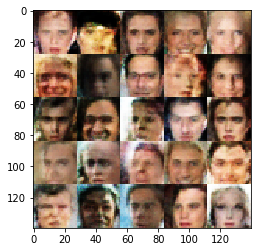

Epoch 1/1... Discriminator Loss: 0.8789... Generator Loss: 1.0057
Epoch 1/1... Discriminator Loss: 0.7777... Generator Loss: 1.6290
Epoch 1/1... Discriminator Loss: 1.0152... Generator Loss: 0.7666
Epoch 1/1... Discriminator Loss: 0.6507... Generator Loss: 1.5578
Epoch 1/1... Discriminator Loss: 1.3914... Generator Loss: 0.4594
Epoch 1/1... Discriminator Loss: 0.6216... Generator Loss: 1.5471
Epoch 1/1... Discriminator Loss: 0.6654... Generator Loss: 1.7584
Epoch 1/1... Discriminator Loss: 0.9981... Generator Loss: 0.8078
Epoch 1/1... Discriminator Loss: 0.5800... Generator Loss: 3.1552
Epoch 1/1... Discriminator Loss: 0.9632... Generator Loss: 0.7967
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


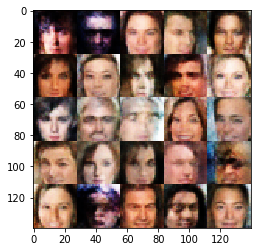

Epoch 1/1... Discriminator Loss: 1.2393... Generator Loss: 0.5377
Epoch 1/1... Discriminator Loss: 0.8419... Generator Loss: 1.0301
Epoch 1/1... Discriminator Loss: 1.1491... Generator Loss: 0.6610
Epoch 1/1... Discriminator Loss: 2.0441... Generator Loss: 0.2072
Epoch 1/1... Discriminator Loss: 1.0044... Generator Loss: 0.8000
Epoch 1/1... Discriminator Loss: 0.7982... Generator Loss: 1.0972
Epoch 1/1... Discriminator Loss: 0.6188... Generator Loss: 1.6101
Epoch 1/1... Discriminator Loss: 1.1119... Generator Loss: 0.6449
Epoch 1/1... Discriminator Loss: 0.9075... Generator Loss: 0.8362
Epoch 1/1... Discriminator Loss: 1.4400... Generator Loss: 0.4401
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


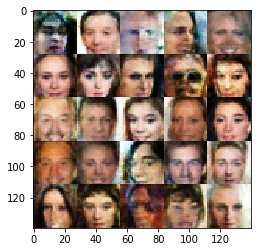

Epoch 1/1... Discriminator Loss: 1.4075... Generator Loss: 0.4608
Epoch 1/1... Discriminator Loss: 0.7395... Generator Loss: 1.4705
Epoch 1/1... Discriminator Loss: 1.5202... Generator Loss: 0.3739
Epoch 1/1... Discriminator Loss: 0.6936... Generator Loss: 1.3041
Epoch 1/1... Discriminator Loss: 1.7766... Generator Loss: 0.3023
Epoch 1/1... Discriminator Loss: 1.6257... Generator Loss: 0.4398
Epoch 1/1... Discriminator Loss: 1.2727... Generator Loss: 0.5376
Epoch 1/1... Discriminator Loss: 1.3492... Generator Loss: 0.4769
Epoch 1/1... Discriminator Loss: 0.6997... Generator Loss: 1.2681
Epoch 1/1... Discriminator Loss: 1.1675... Generator Loss: 0.5974
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


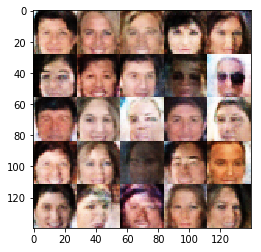

Epoch 1/1... Discriminator Loss: 0.5885... Generator Loss: 1.8229
Epoch 1/1... Discriminator Loss: 1.5336... Generator Loss: 0.3796
Epoch 1/1... Discriminator Loss: 0.9033... Generator Loss: 0.8431
Epoch 1/1... Discriminator Loss: 1.3383... Generator Loss: 0.4923
Epoch 1/1... Discriminator Loss: 1.0751... Generator Loss: 0.6850
Epoch 1/1... Discriminator Loss: 1.2883... Generator Loss: 0.5174
Epoch 1/1... Discriminator Loss: 1.9230... Generator Loss: 0.2578
Epoch 1/1... Discriminator Loss: 1.7788... Generator Loss: 0.3123
Epoch 1/1... Discriminator Loss: 2.0502... Generator Loss: 0.2362
Epoch 1/1... Discriminator Loss: 0.8795... Generator Loss: 0.9349
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


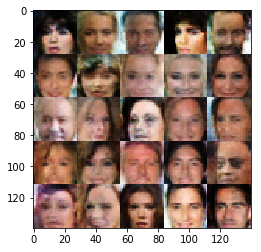

Epoch 1/1... Discriminator Loss: 0.8319... Generator Loss: 1.1840
Epoch 1/1... Discriminator Loss: 0.7506... Generator Loss: 1.3040
Epoch 1/1... Discriminator Loss: 1.0603... Generator Loss: 0.6999
Epoch 1/1... Discriminator Loss: 0.7445... Generator Loss: 1.1502
Epoch 1/1... Discriminator Loss: 0.8954... Generator Loss: 0.8764
Epoch 1/1... Discriminator Loss: 1.1301... Generator Loss: 0.6107
Epoch 1/1... Discriminator Loss: 1.2672... Generator Loss: 0.5598
Epoch 1/1... Discriminator Loss: 1.3383... Generator Loss: 0.4805
Epoch 1/1... Discriminator Loss: 0.6829... Generator Loss: 1.5668
Epoch 1/1... Discriminator Loss: 1.0690... Generator Loss: 0.7145
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


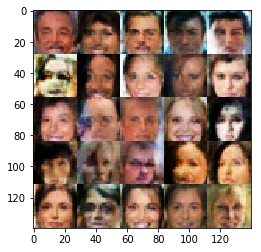

Epoch 1/1... Discriminator Loss: 1.4464... Generator Loss: 0.4050
Epoch 1/1... Discriminator Loss: 0.6972... Generator Loss: 1.3272
Epoch 1/1... Discriminator Loss: 1.2919... Generator Loss: 0.5684
Epoch 1/1... Discriminator Loss: 1.6627... Generator Loss: 0.3459
Epoch 1/1... Discriminator Loss: 1.9021... Generator Loss: 0.3408
Epoch 1/1... Discriminator Loss: 1.1770... Generator Loss: 0.5956
Epoch 1/1... Discriminator Loss: 0.7203... Generator Loss: 1.2040
Epoch 1/1... Discriminator Loss: 2.4637... Generator Loss: 0.1437
Epoch 1/1... Discriminator Loss: 2.1566... Generator Loss: 0.1836
Epoch 1/1... Discriminator Loss: 0.8682... Generator Loss: 1.5820
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


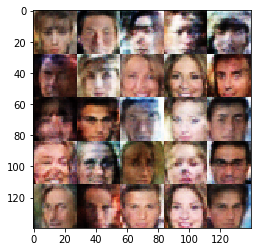

Epoch 1/1... Discriminator Loss: 0.9879... Generator Loss: 0.8281
Epoch 1/1... Discriminator Loss: 1.2084... Generator Loss: 0.5697
Epoch 1/1... Discriminator Loss: 1.5486... Generator Loss: 0.3662
Epoch 1/1... Discriminator Loss: 1.0537... Generator Loss: 0.6956
Epoch 1/1... Discriminator Loss: 1.0222... Generator Loss: 0.7416
Epoch 1/1... Discriminator Loss: 1.1456... Generator Loss: 0.6311
Epoch 1/1... Discriminator Loss: 0.6883... Generator Loss: 2.0687
Epoch 1/1... Discriminator Loss: 1.0551... Generator Loss: 0.7758
Epoch 1/1... Discriminator Loss: 1.2332... Generator Loss: 0.6265
Epoch 1/1... Discriminator Loss: 1.1016... Generator Loss: 0.6447
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


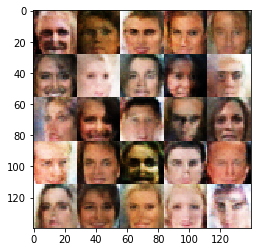

Epoch 1/1... Discriminator Loss: 0.8874... Generator Loss: 0.9075
Epoch 1/1... Discriminator Loss: 1.6208... Generator Loss: 0.3930
Epoch 1/1... Discriminator Loss: 0.7601... Generator Loss: 2.0976
Epoch 1/1... Discriminator Loss: 0.6585... Generator Loss: 1.5735
Epoch 1/1... Discriminator Loss: 1.3874... Generator Loss: 0.4626
Epoch 1/1... Discriminator Loss: 0.7700... Generator Loss: 1.2815
Epoch 1/1... Discriminator Loss: 1.6687... Generator Loss: 0.3736
Epoch 1/1... Discriminator Loss: 2.1487... Generator Loss: 0.2191
Epoch 1/1... Discriminator Loss: 1.5121... Generator Loss: 0.4458
Epoch 1/1... Discriminator Loss: 1.6790... Generator Loss: 0.3403
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


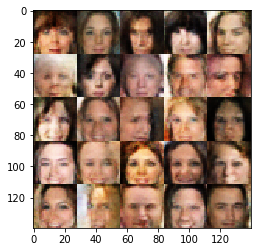

Epoch 1/1... Discriminator Loss: 2.1141... Generator Loss: 0.2063
Epoch 1/1... Discriminator Loss: 2.2484... Generator Loss: 0.1976
Epoch 1/1... Discriminator Loss: 0.6773... Generator Loss: 1.3269
Epoch 1/1... Discriminator Loss: 0.9351... Generator Loss: 0.8607
Epoch 1/1... Discriminator Loss: 1.0588... Generator Loss: 0.6792
Epoch 1/1... Discriminator Loss: 1.2885... Generator Loss: 0.4975
Epoch 1/1... Discriminator Loss: 1.3945... Generator Loss: 0.4828
Epoch 1/1... Discriminator Loss: 1.3977... Generator Loss: 0.4375
Epoch 1/1... Discriminator Loss: 0.8134... Generator Loss: 1.0014
Epoch 1/1... Discriminator Loss: 0.8794... Generator Loss: 0.9076
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


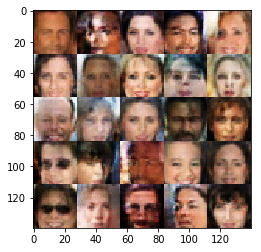

Epoch 1/1... Discriminator Loss: 2.1503... Generator Loss: 0.1943
Epoch 1/1... Discriminator Loss: 1.1626... Generator Loss: 0.5975
Epoch 1/1... Discriminator Loss: 0.4961... Generator Loss: 2.2023
Epoch 1/1... Discriminator Loss: 1.7717... Generator Loss: 0.2933
Epoch 1/1... Discriminator Loss: 2.1632... Generator Loss: 0.2227
Epoch 1/1... Discriminator Loss: 0.8311... Generator Loss: 1.1910
Epoch 1/1... Discriminator Loss: 1.0926... Generator Loss: 0.7249
Epoch 1/1... Discriminator Loss: 1.4086... Generator Loss: 0.4853
Epoch 1/1... Discriminator Loss: 0.9717... Generator Loss: 0.8358
Epoch 1/1... Discriminator Loss: 1.8649... Generator Loss: 0.2791
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


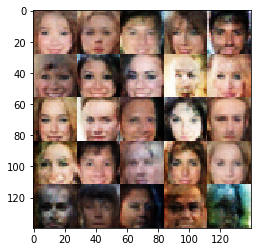

Epoch 1/1... Discriminator Loss: 1.4175... Generator Loss: 0.4348
Epoch 1/1... Discriminator Loss: 1.3936... Generator Loss: 0.4525
Epoch 1/1... Discriminator Loss: 2.4006... Generator Loss: 0.1462
Epoch 1/1... Discriminator Loss: 1.5176... Generator Loss: 0.3821
Epoch 1/1... Discriminator Loss: 0.9212... Generator Loss: 0.8467
Epoch 1/1... Discriminator Loss: 1.4279... Generator Loss: 0.4416
Epoch 1/1... Discriminator Loss: 1.1411... Generator Loss: 0.6374
Epoch 1/1... Discriminator Loss: 1.2596... Generator Loss: 0.5202
Epoch 1/1... Discriminator Loss: 1.7660... Generator Loss: 0.2923
Epoch 1/1... Discriminator Loss: 0.9425... Generator Loss: 0.8747
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


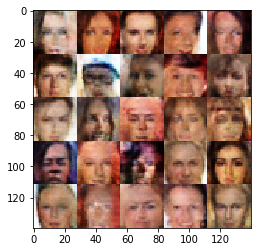

Epoch 1/1... Discriminator Loss: 1.1113... Generator Loss: 0.6632
Epoch 1/1... Discriminator Loss: 0.5967... Generator Loss: 1.5061
Epoch 1/1... Discriminator Loss: 1.1489... Generator Loss: 0.7195
Epoch 1/1... Discriminator Loss: 0.7043... Generator Loss: 1.6098
Epoch 1/1... Discriminator Loss: 0.9548... Generator Loss: 1.0242
Epoch 1/1... Discriminator Loss: 0.6938... Generator Loss: 1.3182
Epoch 1/1... Discriminator Loss: 1.1279... Generator Loss: 0.7111
Epoch 1/1... Discriminator Loss: 0.9301... Generator Loss: 0.9256
Epoch 1/1... Discriminator Loss: 0.8161... Generator Loss: 1.0393
Epoch 1/1... Discriminator Loss: 1.3034... Generator Loss: 0.4918
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


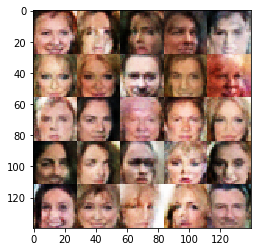

Epoch 1/1... Discriminator Loss: 0.9658... Generator Loss: 0.7819
Epoch 1/1... Discriminator Loss: 0.6591... Generator Loss: 1.5103
Epoch 1/1... Discriminator Loss: 0.7707... Generator Loss: 1.2696
Epoch 1/1... Discriminator Loss: 1.5034... Generator Loss: 0.4191
Epoch 1/1... Discriminator Loss: 0.9951... Generator Loss: 0.7453
Epoch 1/1... Discriminator Loss: 1.0324... Generator Loss: 0.7358
Epoch 1/1... Discriminator Loss: 1.6343... Generator Loss: 0.4004
Epoch 1/1... Discriminator Loss: 1.4210... Generator Loss: 0.4749
Epoch 1/1... Discriminator Loss: 1.3221... Generator Loss: 0.5087
Epoch 1/1... Discriminator Loss: 0.6309... Generator Loss: 2.3426
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


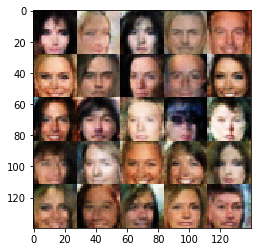

Epoch 1/1... Discriminator Loss: 1.7472... Generator Loss: 0.2901
Epoch 1/1... Discriminator Loss: 1.2807... Generator Loss: 0.5347
Epoch 1/1... Discriminator Loss: 1.0924... Generator Loss: 0.6484
Epoch 1/1... Discriminator Loss: 1.3535... Generator Loss: 0.4956
Epoch 1/1... Discriminator Loss: 1.7898... Generator Loss: 0.2977
Epoch 1/1... Discriminator Loss: 1.2630... Generator Loss: 0.5858
Epoch 1/1... Discriminator Loss: 0.7791... Generator Loss: 1.0507
Epoch 1/1... Discriminator Loss: 1.6498... Generator Loss: 0.3272
Epoch 1/1... Discriminator Loss: 1.0743... Generator Loss: 0.6585
Epoch 1/1... Discriminator Loss: 0.9316... Generator Loss: 0.8209
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


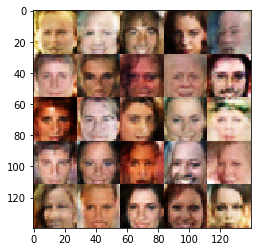

Epoch 1/1... Discriminator Loss: 0.6443... Generator Loss: 1.6024
Epoch 1/1... Discriminator Loss: 0.9921... Generator Loss: 0.7647
Epoch 1/1... Discriminator Loss: 0.6514... Generator Loss: 1.4472
Epoch 1/1... Discriminator Loss: 0.7083... Generator Loss: 1.2105
Epoch 1/1... Discriminator Loss: 1.0619... Generator Loss: 0.7211
Epoch 1/1... Discriminator Loss: 1.9048... Generator Loss: 0.2616
Epoch 1/1... Discriminator Loss: 0.7063... Generator Loss: 2.3854
Epoch 1/1... Discriminator Loss: 1.0559... Generator Loss: 0.7018
Epoch 1/1... Discriminator Loss: 0.7714... Generator Loss: 1.8946
Epoch 1/1... Discriminator Loss: 1.7724... Generator Loss: 0.3072
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


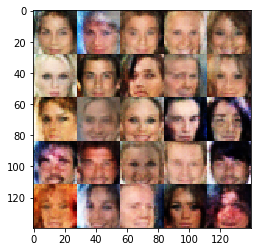

Epoch 1/1... Discriminator Loss: 1.3298... Generator Loss: 0.4706
Epoch 1/1... Discriminator Loss: 1.5583... Generator Loss: 0.3897
Epoch 1/1... Discriminator Loss: 1.8042... Generator Loss: 0.2750
Epoch 1/1... Discriminator Loss: 0.6702... Generator Loss: 1.3581
Epoch 1/1... Discriminator Loss: 0.9806... Generator Loss: 0.7727
Epoch 1/1... Discriminator Loss: 1.2249... Generator Loss: 0.5285
Epoch 1/1... Discriminator Loss: 1.3525... Generator Loss: 0.4874
Epoch 1/1... Discriminator Loss: 0.8398... Generator Loss: 0.9539
Epoch 1/1... Discriminator Loss: 1.2424... Generator Loss: 0.6619
Epoch 1/1... Discriminator Loss: 1.5563... Generator Loss: 0.3753
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


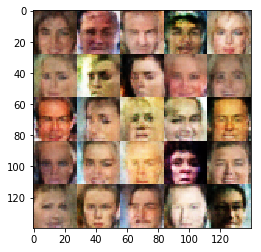

Epoch 1/1... Discriminator Loss: 1.3525... Generator Loss: 0.5325
Epoch 1/1... Discriminator Loss: 1.6134... Generator Loss: 0.3363
Epoch 1/1... Discriminator Loss: 0.8064... Generator Loss: 1.1331
Epoch 1/1... Discriminator Loss: 0.7417... Generator Loss: 1.1262
Epoch 1/1... Discriminator Loss: 1.8886... Generator Loss: 0.2648
Epoch 1/1... Discriminator Loss: 1.4011... Generator Loss: 0.4563
Epoch 1/1... Discriminator Loss: 0.9715... Generator Loss: 0.7933
Epoch 1/1... Discriminator Loss: 1.0311... Generator Loss: 0.7068
Epoch 1/1... Discriminator Loss: 0.6070... Generator Loss: 1.6562
Epoch 1/1... Discriminator Loss: 0.7765... Generator Loss: 1.5626
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


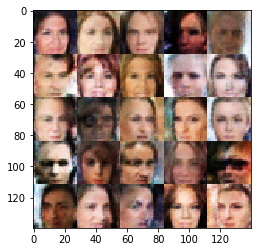

Epoch 1/1... Discriminator Loss: 1.6443... Generator Loss: 0.3504
Epoch 1/1... Discriminator Loss: 1.0358... Generator Loss: 0.7249
Epoch 1/1... Discriminator Loss: 1.3245... Generator Loss: 0.4924
Epoch 1/1... Discriminator Loss: 1.2018... Generator Loss: 0.6374
Epoch 1/1... Discriminator Loss: 0.6258... Generator Loss: 1.4594
Epoch 1/1... Discriminator Loss: 0.9028... Generator Loss: 0.8943
Epoch 1/1... Discriminator Loss: 0.9712... Generator Loss: 0.7919
Epoch 1/1... Discriminator Loss: 1.0764... Generator Loss: 0.6665
Epoch 1/1... Discriminator Loss: 0.7669... Generator Loss: 1.0841
Epoch 1/1... Discriminator Loss: 0.5918... Generator Loss: 1.5399
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


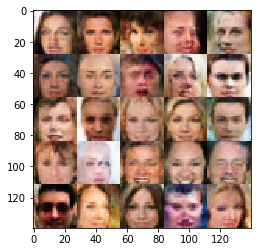

Epoch 1/1... Discriminator Loss: 0.8481... Generator Loss: 0.9325
Epoch 1/1... Discriminator Loss: 0.8132... Generator Loss: 0.9822
Epoch 1/1... Discriminator Loss: 2.1200... Generator Loss: 0.1918
Epoch 1/1... Discriminator Loss: 2.0536... Generator Loss: 0.2243
Epoch 1/1... Discriminator Loss: 1.4613... Generator Loss: 0.3942
Epoch 1/1... Discriminator Loss: 0.9585... Generator Loss: 0.8407
Epoch 1/1... Discriminator Loss: 0.9260... Generator Loss: 0.8386
Epoch 1/1... Discriminator Loss: 0.8102... Generator Loss: 0.9986
Epoch 1/1... Discriminator Loss: 1.8456... Generator Loss: 0.2730
Epoch 1/1... Discriminator Loss: 0.9919... Generator Loss: 0.7432
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


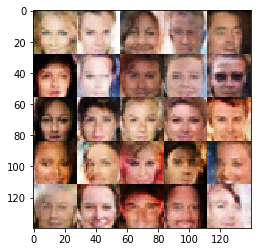

Epoch 1/1... Discriminator Loss: 0.8966... Generator Loss: 0.8756
Epoch 1/1... Discriminator Loss: 1.3516... Generator Loss: 0.4625
Epoch 1/1... Discriminator Loss: 2.0226... Generator Loss: 0.2275
Epoch 1/1... Discriminator Loss: 0.7000... Generator Loss: 1.2382
Epoch 1/1... Discriminator Loss: 1.8480... Generator Loss: 0.2643
Epoch 1/1... Discriminator Loss: 0.7944... Generator Loss: 1.0631
Epoch 1/1... Discriminator Loss: 0.6609... Generator Loss: 1.7328
Epoch 1/1... Discriminator Loss: 0.8688... Generator Loss: 0.9407
Epoch 1/1... Discriminator Loss: 0.7123... Generator Loss: 1.2268
Epoch 1/1... Discriminator Loss: 1.3707... Generator Loss: 0.4649
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


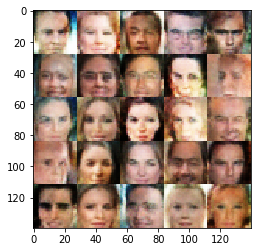

Epoch 1/1... Discriminator Loss: 1.2359... Generator Loss: 0.5406
Epoch 1/1... Discriminator Loss: 1.1972... Generator Loss: 0.5646
Epoch 1/1... Discriminator Loss: 1.2398... Generator Loss: 0.5353
Epoch 1/1... Discriminator Loss: 1.5554... Generator Loss: 0.3536
Epoch 1/1... Discriminator Loss: 0.8272... Generator Loss: 0.9938
Epoch 1/1... Discriminator Loss: 1.1231... Generator Loss: 0.6593
Epoch 1/1... Discriminator Loss: 1.0660... Generator Loss: 0.6575
Epoch 1/1... Discriminator Loss: 0.7547... Generator Loss: 1.1504
Epoch 1/1... Discriminator Loss: 0.9010... Generator Loss: 0.8555
Epoch 1/1... Discriminator Loss: 1.0761... Generator Loss: 0.7042
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


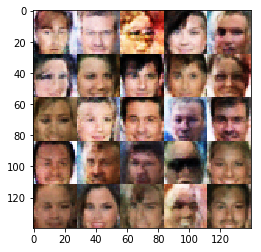

Epoch 1/1... Discriminator Loss: 2.4917... Generator Loss: 0.1384
Epoch 1/1... Discriminator Loss: 0.8012... Generator Loss: 1.1839
Epoch 1/1... Discriminator Loss: 0.7042... Generator Loss: 1.2393
Epoch 1/1... Discriminator Loss: 1.6939... Generator Loss: 0.3676
Epoch 1/1... Discriminator Loss: 0.9685... Generator Loss: 0.7895
Epoch 1/1... Discriminator Loss: 0.6868... Generator Loss: 1.2664
Epoch 1/1... Discriminator Loss: 0.7134... Generator Loss: 1.1651
Epoch 1/1... Discriminator Loss: 0.9977... Generator Loss: 0.7868
Epoch 1/1... Discriminator Loss: 1.9369... Generator Loss: 0.2359
Epoch 1/1... Discriminator Loss: 2.3325... Generator Loss: 0.1916
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


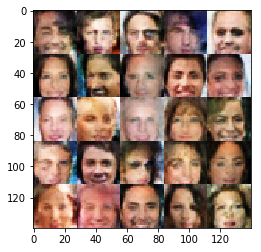

Epoch 1/1... Discriminator Loss: 1.3363... Generator Loss: 0.5096
Epoch 1/1... Discriminator Loss: 1.5564... Generator Loss: 0.3712
Epoch 1/1... Discriminator Loss: 1.2055... Generator Loss: 0.6115
Epoch 1/1... Discriminator Loss: 1.3337... Generator Loss: 0.4684
Epoch 1/1... Discriminator Loss: 1.5098... Generator Loss: 0.3776
Epoch 1/1... Discriminator Loss: 1.0109... Generator Loss: 0.7398
Epoch 1/1... Discriminator Loss: 1.2414... Generator Loss: 0.5571
Epoch 1/1... Discriminator Loss: 2.0854... Generator Loss: 0.2140
Epoch 1/1... Discriminator Loss: 1.4881... Generator Loss: 0.4104
Epoch 1/1... Discriminator Loss: 1.0341... Generator Loss: 0.7213
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


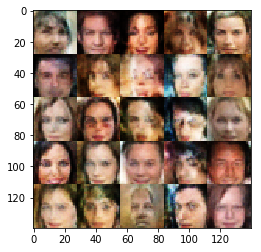

Epoch 1/1... Discriminator Loss: 0.9870... Generator Loss: 0.7509
Epoch 1/1... Discriminator Loss: 1.6403... Generator Loss: 0.3731
Epoch 1/1... Discriminator Loss: 0.8866... Generator Loss: 0.8656
Epoch 1/1... Discriminator Loss: 0.7600... Generator Loss: 1.1012
Epoch 1/1... Discriminator Loss: 1.5844... Generator Loss: 0.3528
Epoch 1/1... Discriminator Loss: 1.4191... Generator Loss: 0.4325
Epoch 1/1... Discriminator Loss: 0.7096... Generator Loss: 1.4302
Epoch 1/1... Discriminator Loss: 1.2199... Generator Loss: 0.8008
Epoch 1/1... Discriminator Loss: 0.9263... Generator Loss: 0.8659
Epoch 1/1... Discriminator Loss: 1.8901... Generator Loss: 0.2475
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


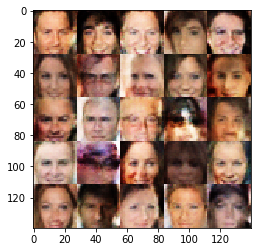

Epoch 1/1... Discriminator Loss: 1.9673... Generator Loss: 0.2382
Epoch 1/1... Discriminator Loss: 1.5697... Generator Loss: 0.3873
Epoch 1/1... Discriminator Loss: 3.0708... Generator Loss: 0.0786
Epoch 1/1... Discriminator Loss: 1.7615... Generator Loss: 0.3220
Epoch 1/1... Discriminator Loss: 1.0009... Generator Loss: 0.7692
Epoch 1/1... Discriminator Loss: 1.2700... Generator Loss: 0.5153
Epoch 1/1... Discriminator Loss: 2.1079... Generator Loss: 0.2088
Epoch 1/1... Discriminator Loss: 0.9100... Generator Loss: 0.8953
Epoch 1/1... Discriminator Loss: 1.3115... Generator Loss: 0.4887
Epoch 1/1... Discriminator Loss: 1.2928... Generator Loss: 0.5043
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


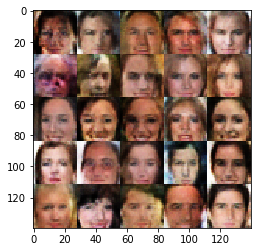

Epoch 1/1... Discriminator Loss: 0.6668... Generator Loss: 1.3476
Epoch 1/1... Discriminator Loss: 1.8482... Generator Loss: 0.2596
Epoch 1/1... Discriminator Loss: 1.9235... Generator Loss: 0.2666
Epoch 1/1... Discriminator Loss: 1.7931... Generator Loss: 0.2851
Epoch 1/1... Discriminator Loss: 1.1614... Generator Loss: 0.6086
Epoch 1/1... Discriminator Loss: 1.6381... Generator Loss: 0.3914
Epoch 1/1... Discriminator Loss: 2.0728... Generator Loss: 0.2365
Epoch 1/1... Discriminator Loss: 1.5219... Generator Loss: 0.3817
Epoch 1/1... Discriminator Loss: 0.7302... Generator Loss: 1.2958
Epoch 1/1... Discriminator Loss: 0.9062... Generator Loss: 0.8606
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


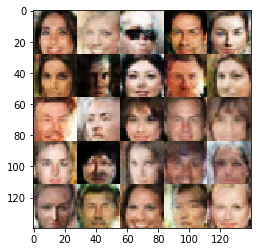

Epoch 1/1... Discriminator Loss: 0.9559... Generator Loss: 0.8359
Epoch 1/1... Discriminator Loss: 1.1618... Generator Loss: 0.5994
Epoch 1/1... Discriminator Loss: 0.5836... Generator Loss: 1.5705
Epoch 1/1... Discriminator Loss: 0.9464... Generator Loss: 0.8362
Epoch 1/1... Discriminator Loss: 2.0956... Generator Loss: 0.2120
Epoch 1/1... Discriminator Loss: 0.9929... Generator Loss: 0.7676
Epoch 1/1... Discriminator Loss: 0.8765... Generator Loss: 0.9208
Epoch 1/1... Discriminator Loss: 1.1447... Generator Loss: 0.6254
Epoch 1/1... Discriminator Loss: 1.3584... Generator Loss: 0.4767
Epoch 1/1... Discriminator Loss: 1.0915... Generator Loss: 0.6727
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


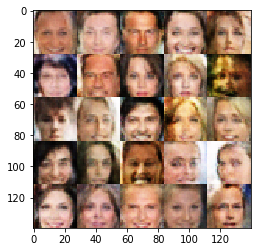

Epoch 1/1... Discriminator Loss: 2.0501... Generator Loss: 0.2290
Epoch 1/1... Discriminator Loss: 1.0647... Generator Loss: 0.6976
Epoch 1/1... Discriminator Loss: 1.4056... Generator Loss: 0.4353
Epoch 1/1... Discriminator Loss: 0.8456... Generator Loss: 0.9368
Epoch 1/1... Discriminator Loss: 1.3682... Generator Loss: 0.4780
Epoch 1/1... Discriminator Loss: 1.4091... Generator Loss: 0.4551
Epoch 1/1... Discriminator Loss: 1.2428... Generator Loss: 0.5330
Epoch 1/1... Discriminator Loss: 1.0977... Generator Loss: 0.6781
Epoch 1/1... Discriminator Loss: 0.8449... Generator Loss: 0.9815
Epoch 1/1... Discriminator Loss: 1.3914... Generator Loss: 0.4616
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


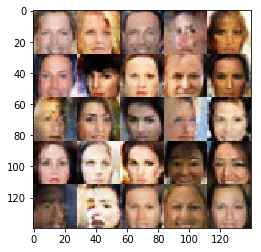

Epoch 1/1... Discriminator Loss: 1.7183... Generator Loss: 0.3005
Epoch 1/1... Discriminator Loss: 1.8170... Generator Loss: 0.2763
Epoch 1/1... Discriminator Loss: 1.0308... Generator Loss: 0.7154
Epoch 1/1... Discriminator Loss: 1.2705... Generator Loss: 0.5600
Epoch 1/1... Discriminator Loss: 2.2296... Generator Loss: 0.1877
Epoch 1/1... Discriminator Loss: 0.9077... Generator Loss: 0.8506
Epoch 1/1... Discriminator Loss: 2.3026... Generator Loss: 0.1689
Epoch 1/1... Discriminator Loss: 0.6652... Generator Loss: 1.5674
Epoch 1/1... Discriminator Loss: 1.8308... Generator Loss: 0.2595
Epoch 1/1... Discriminator Loss: 0.7892... Generator Loss: 1.0408
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


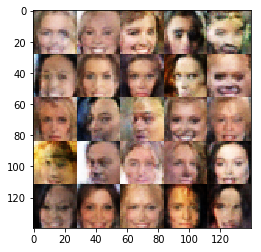

Epoch 1/1... Discriminator Loss: 0.7253... Generator Loss: 1.2336
Epoch 1/1... Discriminator Loss: 1.3806... Generator Loss: 0.4475
Epoch 1/1... Discriminator Loss: 0.7347... Generator Loss: 1.4770
Epoch 1/1... Discriminator Loss: 1.3100... Generator Loss: 0.4835
Epoch 1/1... Discriminator Loss: 1.8138... Generator Loss: 0.2721
Epoch 1/1... Discriminator Loss: 1.5287... Generator Loss: 0.3831
Epoch 1/1... Discriminator Loss: 0.9815... Generator Loss: 0.7361
Epoch 1/1... Discriminator Loss: 0.8429... Generator Loss: 1.0875
Epoch 1/1... Discriminator Loss: 1.3487... Generator Loss: 0.4530
Epoch 1/1... Discriminator Loss: 2.2290... Generator Loss: 0.1753
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


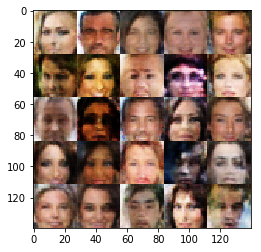

Epoch 1/1... Discriminator Loss: 0.9127... Generator Loss: 1.1807
Epoch 1/1... Discriminator Loss: 0.7708... Generator Loss: 1.1460
Epoch 1/1... Discriminator Loss: 0.8093... Generator Loss: 1.0204
Epoch 1/1... Discriminator Loss: 1.3584... Generator Loss: 0.4765
Epoch 1/1... Discriminator Loss: 0.7574... Generator Loss: 1.1335
Epoch 1/1... Discriminator Loss: 0.7930... Generator Loss: 3.2341
Epoch 1/1... Discriminator Loss: 0.6503... Generator Loss: 1.6221
Epoch 1/1... Discriminator Loss: 1.2529... Generator Loss: 0.5147
Epoch 1/1... Discriminator Loss: 0.6838... Generator Loss: 1.4239
Epoch 1/1... Discriminator Loss: 1.5210... Generator Loss: 0.3779
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


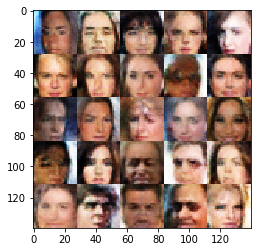

Epoch 1/1... Discriminator Loss: 1.5557... Generator Loss: 0.3942
Epoch 1/1... Discriminator Loss: 0.9874... Generator Loss: 0.7666
Epoch 1/1... Discriminator Loss: 0.8668... Generator Loss: 1.1142
Epoch 1/1... Discriminator Loss: 0.6798... Generator Loss: 1.5251
Epoch 1/1... Discriminator Loss: 1.3603... Generator Loss: 0.5061
Epoch 1/1... Discriminator Loss: 0.6914... Generator Loss: 1.7322
Epoch 1/1... Discriminator Loss: 2.7478... Generator Loss: 0.1135
Epoch 1/1... Discriminator Loss: 0.6282... Generator Loss: 1.6009
Epoch 1/1... Discriminator Loss: 1.4148... Generator Loss: 0.4841
Epoch 1/1... Discriminator Loss: 1.2199... Generator Loss: 0.5476
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


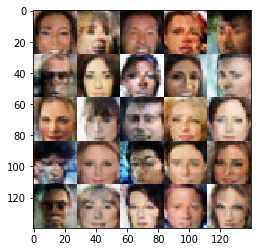

Epoch 1/1... Discriminator Loss: 1.4535... Generator Loss: 0.3978
Epoch 1/1... Discriminator Loss: 1.5141... Generator Loss: 0.3872
Epoch 1/1... Discriminator Loss: 1.2021... Generator Loss: 0.5895
Epoch 1/1... Discriminator Loss: 2.1924... Generator Loss: 0.1845
Epoch 1/1... Discriminator Loss: 0.5741... Generator Loss: 2.3640
Epoch 1/1... Discriminator Loss: 0.7879... Generator Loss: 1.5606
Epoch 1/1... Discriminator Loss: 1.0322... Generator Loss: 0.7350
Epoch 1/1... Discriminator Loss: 0.5961... Generator Loss: 1.8898
Epoch 1/1... Discriminator Loss: 1.4443... Generator Loss: 0.4342
Epoch 1/1... Discriminator Loss: 0.7609... Generator Loss: 1.2979
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


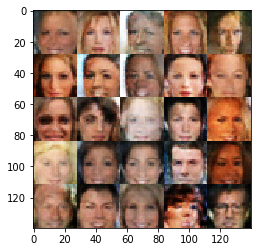

Epoch 1/1... Discriminator Loss: 1.4021... Generator Loss: 0.4455
Epoch 1/1... Discriminator Loss: 1.9619... Generator Loss: 0.2642
Epoch 1/1... Discriminator Loss: 1.7961... Generator Loss: 0.2736
Epoch 1/1... Discriminator Loss: 1.8628... Generator Loss: 0.2750
Epoch 1/1... Discriminator Loss: 1.4375... Generator Loss: 0.5088
Epoch 1/1... Discriminator Loss: 0.5492... Generator Loss: 1.6563
Epoch 1/1... Discriminator Loss: 1.2838... Generator Loss: 0.5033
Epoch 1/1... Discriminator Loss: 0.8113... Generator Loss: 0.9848
Epoch 1/1... Discriminator Loss: 1.0315... Generator Loss: 0.7616
Epoch 1/1... Discriminator Loss: 1.2058... Generator Loss: 0.5845
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


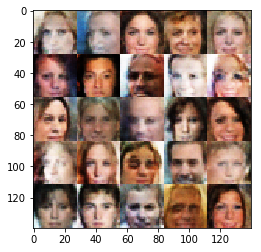

Epoch 1/1... Discriminator Loss: 1.4033... Generator Loss: 0.4351
Epoch 1/1... Discriminator Loss: 0.9351... Generator Loss: 0.8075
Epoch 1/1... Discriminator Loss: 1.6015... Generator Loss: 0.3444
Epoch 1/1... Discriminator Loss: 0.9287... Generator Loss: 0.8210
Epoch 1/1... Discriminator Loss: 1.3218... Generator Loss: 0.6027
Epoch 1/1... Discriminator Loss: 0.6147... Generator Loss: 2.1174
Epoch 1/1... Discriminator Loss: 1.6468... Generator Loss: 0.3982
Epoch 1/1... Discriminator Loss: 1.7883... Generator Loss: 0.3099
Epoch 1/1... Discriminator Loss: 1.2493... Generator Loss: 0.5424
Epoch 1/1... Discriminator Loss: 0.7498... Generator Loss: 1.1045
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


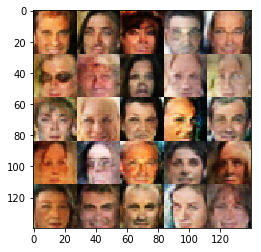

Epoch 1/1... Discriminator Loss: 1.1685... Generator Loss: 0.6904
Epoch 1/1... Discriminator Loss: 1.3534... Generator Loss: 0.4622
Epoch 1/1... Discriminator Loss: 1.6977... Generator Loss: 0.3362
Epoch 1/1... Discriminator Loss: 0.9857... Generator Loss: 0.9098
Epoch 1/1... Discriminator Loss: 0.6651... Generator Loss: 1.3616
Epoch 1/1... Discriminator Loss: 1.5881... Generator Loss: 0.3734
Epoch 1/1... Discriminator Loss: 1.4641... Generator Loss: 0.4414
Epoch 1/1... Discriminator Loss: 1.6363... Generator Loss: 0.3389
Epoch 1/1... Discriminator Loss: 1.1465... Generator Loss: 0.6242
Epoch 1/1... Discriminator Loss: 1.3083... Generator Loss: 0.5905
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


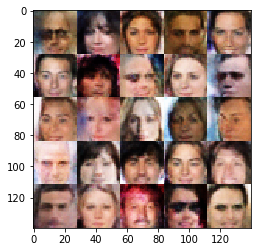

Epoch 1/1... Discriminator Loss: 1.5540... Generator Loss: 0.3587
Epoch 1/1... Discriminator Loss: 1.4475... Generator Loss: 0.4057
Epoch 1/1... Discriminator Loss: 1.8748... Generator Loss: 0.2571
Epoch 1/1... Discriminator Loss: 1.4797... Generator Loss: 0.4645
Epoch 1/1... Discriminator Loss: 1.2372... Generator Loss: 0.5300
Epoch 1/1... Discriminator Loss: 1.4680... Generator Loss: 0.4766
Epoch 1/1... Discriminator Loss: 0.9234... Generator Loss: 0.8705
Epoch 1/1... Discriminator Loss: 1.9886... Generator Loss: 0.2529
Epoch 1/1... Discriminator Loss: 0.6346... Generator Loss: 1.4046
Epoch 1/1... Discriminator Loss: 2.0094... Generator Loss: 0.2135
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


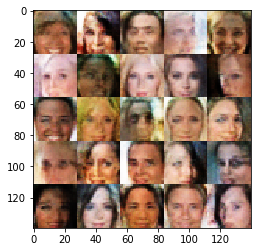

Epoch 1/1... Discriminator Loss: 2.2054... Generator Loss: 0.1887
Epoch 1/1... Discriminator Loss: 1.0059... Generator Loss: 0.7515
Epoch 1/1... Discriminator Loss: 2.4452... Generator Loss: 0.1459
Epoch 1/1... Discriminator Loss: 0.7963... Generator Loss: 1.0333
Epoch 1/1... Discriminator Loss: 0.8978... Generator Loss: 0.8847
Epoch 1/1... Discriminator Loss: 0.5912... Generator Loss: 1.5456
Epoch 1/1... Discriminator Loss: 1.4480... Generator Loss: 0.4773
Epoch 1/1... Discriminator Loss: 1.2656... Generator Loss: 0.5253
Epoch 1/1... Discriminator Loss: 0.8202... Generator Loss: 1.0394
Epoch 1/1... Discriminator Loss: 1.7241... Generator Loss: 0.2952
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


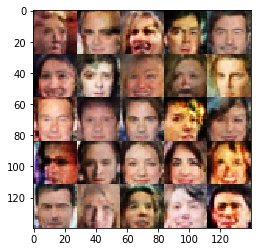

Epoch 1/1... Discriminator Loss: 1.3344... Generator Loss: 0.4799
Epoch 1/1... Discriminator Loss: 0.9691... Generator Loss: 0.8158
Epoch 1/1... Discriminator Loss: 1.0611... Generator Loss: 0.7198
Epoch 1/1... Discriminator Loss: 1.3821... Generator Loss: 0.5003
Epoch 1/1... Discriminator Loss: 0.7999... Generator Loss: 1.0168
Epoch 1/1... Discriminator Loss: 0.9521... Generator Loss: 0.8094
Epoch 1/1... Discriminator Loss: 0.7404... Generator Loss: 1.2046
Epoch 1/1... Discriminator Loss: 0.8670... Generator Loss: 0.9244
Epoch 1/1... Discriminator Loss: 0.6030... Generator Loss: 2.8018
Epoch 1/1... Discriminator Loss: 0.6737... Generator Loss: 1.4930
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


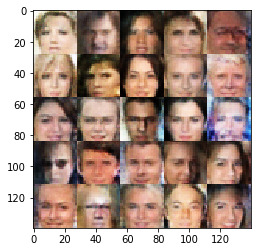

Epoch 1/1... Discriminator Loss: 2.0484... Generator Loss: 0.2172
Epoch 1/1... Discriminator Loss: 1.4023... Generator Loss: 0.4586
Epoch 1/1... Discriminator Loss: 1.1491... Generator Loss: 0.6124
Epoch 1/1... Discriminator Loss: 0.9714... Generator Loss: 0.9319
Epoch 1/1... Discriminator Loss: 0.7098... Generator Loss: 1.2279
Epoch 1/1... Discriminator Loss: 0.8350... Generator Loss: 1.1323
Epoch 1/1... Discriminator Loss: 0.7428... Generator Loss: 1.3002
Epoch 1/1... Discriminator Loss: 1.2149... Generator Loss: 0.5562
Epoch 1/1... Discriminator Loss: 0.4629... Generator Loss: 2.4748
Epoch 1/1... Discriminator Loss: 0.7866... Generator Loss: 1.0615
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


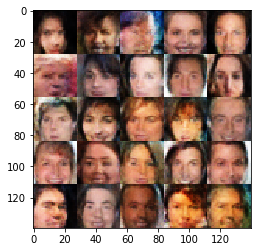

Epoch 1/1... Discriminator Loss: 2.2759... Generator Loss: 0.1778
Epoch 1/1... Discriminator Loss: 0.7646... Generator Loss: 1.2195
Epoch 1/1... Discriminator Loss: 0.9285... Generator Loss: 0.7977
Epoch 1/1... Discriminator Loss: 1.3189... Generator Loss: 0.4874
Epoch 1/1... Discriminator Loss: 1.0834... Generator Loss: 0.6534
Epoch 1/1... Discriminator Loss: 2.8126... Generator Loss: 0.1147
Epoch 1/1... Discriminator Loss: 1.3014... Generator Loss: 0.5899
Epoch 1/1... Discriminator Loss: 0.8996... Generator Loss: 0.8563
Epoch 1/1... Discriminator Loss: 0.8865... Generator Loss: 0.9079
Epoch 1/1... Discriminator Loss: 0.6832... Generator Loss: 1.3483
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


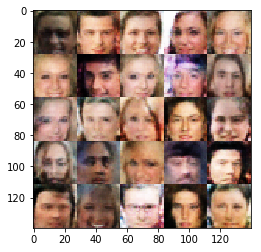

Epoch 1/1... Discriminator Loss: 0.8004... Generator Loss: 1.0302
Epoch 1/1... Discriminator Loss: 0.8564... Generator Loss: 0.9413
Epoch 1/1... Discriminator Loss: 1.5692... Generator Loss: 0.3540
Epoch 1/1... Discriminator Loss: 1.6379... Generator Loss: 0.3208
Epoch 1/1... Discriminator Loss: 0.8940... Generator Loss: 0.9260
Epoch 1/1... Discriminator Loss: 1.0910... Generator Loss: 0.6755
Epoch 1/1... Discriminator Loss: 1.4475... Generator Loss: 0.4915
Epoch 1/1... Discriminator Loss: 0.6464... Generator Loss: 1.6281
Epoch 1/1... Discriminator Loss: 0.8230... Generator Loss: 1.0318
Epoch 1/1... Discriminator Loss: 1.2249... Generator Loss: 0.6029
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


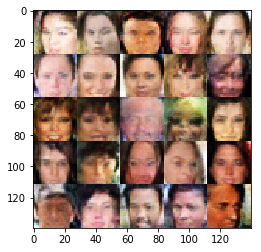

Epoch 1/1... Discriminator Loss: 0.9229... Generator Loss: 0.8524
Epoch 1/1... Discriminator Loss: 2.2473... Generator Loss: 0.2007
Epoch 1/1... Discriminator Loss: 0.9905... Generator Loss: 0.7647
Epoch 1/1... Discriminator Loss: 1.3718... Generator Loss: 0.4792
Epoch 1/1... Discriminator Loss: 0.6807... Generator Loss: 1.3639
Epoch 1/1... Discriminator Loss: 2.1569... Generator Loss: 0.1885
Epoch 1/1... Discriminator Loss: 0.8494... Generator Loss: 0.9550
Epoch 1/1... Discriminator Loss: 1.2337... Generator Loss: 0.6131
Epoch 1/1... Discriminator Loss: 0.7341... Generator Loss: 1.1521
Epoch 1/1... Discriminator Loss: 1.0781... Generator Loss: 0.7356
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


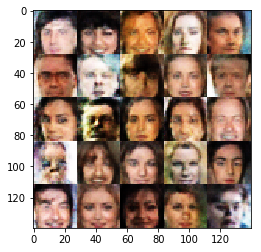

Epoch 1/1... Discriminator Loss: 1.5443... Generator Loss: 0.3658
Epoch 1/1... Discriminator Loss: 0.8732... Generator Loss: 0.9077
Epoch 1/1... Discriminator Loss: 0.8086... Generator Loss: 1.4635
Epoch 1/1... Discriminator Loss: 0.6463... Generator Loss: 1.5307
Epoch 1/1... Discriminator Loss: 0.8639... Generator Loss: 1.0341
Epoch 1/1... Discriminator Loss: 1.4723... Generator Loss: 0.4653
Epoch 1/1... Discriminator Loss: 1.2287... Generator Loss: 0.5592
Epoch 1/1... Discriminator Loss: 1.4696... Generator Loss: 0.4726
Epoch 1/1... Discriminator Loss: 0.9877... Generator Loss: 0.7925
Epoch 1/1... Discriminator Loss: 1.1109... Generator Loss: 0.6521
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


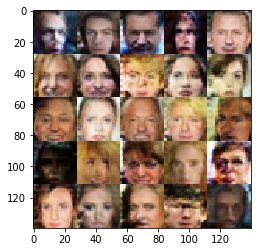

Epoch 1/1... Discriminator Loss: 1.2833... Generator Loss: 0.5349
Epoch 1/1... Discriminator Loss: 2.1611... Generator Loss: 0.1993
Epoch 1/1... Discriminator Loss: 1.3872... Generator Loss: 0.5088
Epoch 1/1... Discriminator Loss: 1.0443... Generator Loss: 0.7359
Epoch 1/1... Discriminator Loss: 1.0457... Generator Loss: 0.7419
Epoch 1/1... Discriminator Loss: 1.1502... Generator Loss: 0.5863
Epoch 1/1... Discriminator Loss: 1.1054... Generator Loss: 0.6447
Epoch 1/1... Discriminator Loss: 1.1346... Generator Loss: 0.6259
Epoch 1/1... Discriminator Loss: 0.8734... Generator Loss: 1.2121
Epoch 1/1... Discriminator Loss: 1.1067... Generator Loss: 0.6400
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


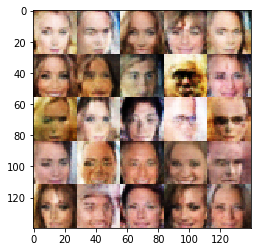

Epoch 1/1... Discriminator Loss: 1.7094... Generator Loss: 0.4136
Epoch 1/1... Discriminator Loss: 2.1558... Generator Loss: 0.1989
Epoch 1/1... Discriminator Loss: 1.4800... Generator Loss: 0.3982
Epoch 1/1... Discriminator Loss: 0.9684... Generator Loss: 1.1570
Epoch 1/1... Discriminator Loss: 1.6719... Generator Loss: 0.3467
Epoch 1/1... Discriminator Loss: 1.1148... Generator Loss: 0.6376
Epoch 1/1... Discriminator Loss: 0.7431... Generator Loss: 1.1103
Epoch 1/1... Discriminator Loss: 1.1197... Generator Loss: 0.6298
Epoch 1/1... Discriminator Loss: 1.7199... Generator Loss: 0.3207
Epoch 1/1... Discriminator Loss: 1.8767... Generator Loss: 0.2874
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


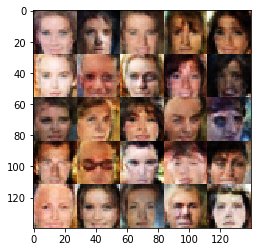

Epoch 1/1... Discriminator Loss: 0.9661... Generator Loss: 0.8845
Epoch 1/1... Discriminator Loss: 2.8419... Generator Loss: 0.0988
Epoch 1/1... Discriminator Loss: 0.8037... Generator Loss: 1.1147
Epoch 1/1... Discriminator Loss: 0.8743... Generator Loss: 1.0223
Epoch 1/1... Discriminator Loss: 0.6953... Generator Loss: 1.5248
Epoch 1/1... Discriminator Loss: 2.2713... Generator Loss: 0.2071
Epoch 1/1... Discriminator Loss: 1.3566... Generator Loss: 0.4656
Epoch 1/1... Discriminator Loss: 0.7564... Generator Loss: 1.4064
Epoch 1/1... Discriminator Loss: 0.6342... Generator Loss: 1.8822
Epoch 1/1... Discriminator Loss: 1.5588... Generator Loss: 0.4315
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


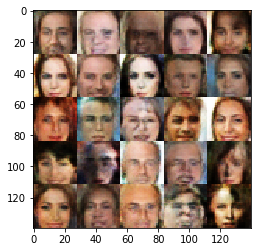

Epoch 1/1... Discriminator Loss: 1.2617... Generator Loss: 0.5089
Epoch 1/1... Discriminator Loss: 2.1275... Generator Loss: 0.2063
Epoch 1/1... Discriminator Loss: 0.8948... Generator Loss: 0.8682
Epoch 1/1... Discriminator Loss: 0.9468... Generator Loss: 0.7864
Epoch 1/1... Discriminator Loss: 2.1353... Generator Loss: 0.2045
Epoch 1/1... Discriminator Loss: 0.9656... Generator Loss: 0.7963
Epoch 1/1... Discriminator Loss: 1.6104... Generator Loss: 0.3752
Epoch 1/1... Discriminator Loss: 0.9718... Generator Loss: 0.7826
Epoch 1/1... Discriminator Loss: 0.6983... Generator Loss: 2.1488
Epoch 1/1... Discriminator Loss: 0.7597... Generator Loss: 1.0962
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


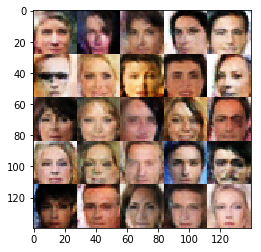

Epoch 1/1... Discriminator Loss: 2.7571... Generator Loss: 0.1101
Epoch 1/1... Discriminator Loss: 0.8892... Generator Loss: 0.9714
Epoch 1/1... Discriminator Loss: 1.2238... Generator Loss: 0.5911
Epoch 1/1... Discriminator Loss: 1.1015... Generator Loss: 0.6937
Epoch 1/1... Discriminator Loss: 0.9443... Generator Loss: 0.9006
Epoch 1/1... Discriminator Loss: 2.0542... Generator Loss: 0.2356
Epoch 1/1... Discriminator Loss: 1.3430... Generator Loss: 0.5032
Epoch 1/1... Discriminator Loss: 0.8002... Generator Loss: 1.2230
Epoch 1/1... Discriminator Loss: 2.5638... Generator Loss: 0.1387
Epoch 1/1... Discriminator Loss: 0.9942... Generator Loss: 0.8394
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


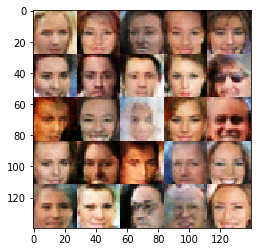

Epoch 1/1... Discriminator Loss: 1.3058... Generator Loss: 0.5355
Epoch 1/1... Discriminator Loss: 0.7146... Generator Loss: 2.3475
Epoch 1/1... Discriminator Loss: 0.9357... Generator Loss: 0.8342
Epoch 1/1... Discriminator Loss: 1.9097... Generator Loss: 0.2473
Epoch 1/1... Discriminator Loss: 0.8881... Generator Loss: 0.8790
Epoch 1/1... Discriminator Loss: 0.7193... Generator Loss: 1.1958
Epoch 1/1... Discriminator Loss: 2.0190... Generator Loss: 0.2247
Epoch 1/1... Discriminator Loss: 0.7928... Generator Loss: 1.0257
Epoch 1/1... Discriminator Loss: 1.0069... Generator Loss: 0.7426
Epoch 1/1... Discriminator Loss: 1.3172... Generator Loss: 0.5332
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


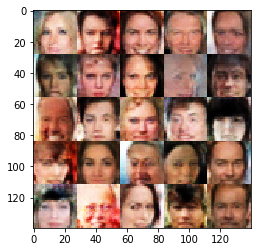

Epoch 1/1... Discriminator Loss: 1.6294... Generator Loss: 0.3463
Epoch 1/1... Discriminator Loss: 0.7293... Generator Loss: 1.6685
Epoch 1/1... Discriminator Loss: 0.7984... Generator Loss: 1.0319
Epoch 1/1... Discriminator Loss: 1.0086... Generator Loss: 0.7388
Epoch 1/1... Discriminator Loss: 1.2218... Generator Loss: 0.5500
Epoch 1/1... Discriminator Loss: 0.8489... Generator Loss: 1.0229
Epoch 1/1... Discriminator Loss: 0.8094... Generator Loss: 1.5716
Epoch 1/1... Discriminator Loss: 0.6651... Generator Loss: 2.2142
Epoch 1/1... Discriminator Loss: 0.6247... Generator Loss: 1.9630
Epoch 1/1... Discriminator Loss: 1.5526... Generator Loss: 0.3921
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


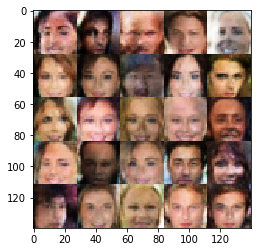

Epoch 1/1... Discriminator Loss: 0.6653... Generator Loss: 1.2868
Epoch 1/1... Discriminator Loss: 0.7914... Generator Loss: 1.0328
Epoch 1/1... Discriminator Loss: 2.2069... Generator Loss: 0.1891
Epoch 1/1... Discriminator Loss: 1.5033... Generator Loss: 0.4253
Epoch 1/1... Discriminator Loss: 0.9517... Generator Loss: 0.7922
Epoch 1/1... Discriminator Loss: 1.7324... Generator Loss: 0.2932
Epoch 1/1... Discriminator Loss: 2.2532... Generator Loss: 0.1772
Epoch 1/1... Discriminator Loss: 1.0078... Generator Loss: 0.7466
Epoch 1/1... Discriminator Loss: 2.0466... Generator Loss: 0.2615
Epoch 1/1... Discriminator Loss: 1.1354... Generator Loss: 0.6501
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


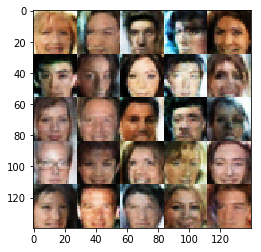

Epoch 1/1... Discriminator Loss: 0.9894... Generator Loss: 0.8210
Epoch 1/1... Discriminator Loss: 1.9280... Generator Loss: 0.2390
Epoch 1/1... Discriminator Loss: 0.9969... Generator Loss: 0.7490
Epoch 1/1... Discriminator Loss: 1.4067... Generator Loss: 0.5556
Epoch 1/1... Discriminator Loss: 1.3470... Generator Loss: 0.4712
Epoch 1/1... Discriminator Loss: 1.1029... Generator Loss: 0.6408
Epoch 1/1... Discriminator Loss: 0.9014... Generator Loss: 0.8769
Epoch 1/1... Discriminator Loss: 0.9501... Generator Loss: 0.7874
Epoch 1/1... Discriminator Loss: 1.3875... Generator Loss: 0.4439
Epoch 1/1... Discriminator Loss: 2.0209... Generator Loss: 0.2406
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


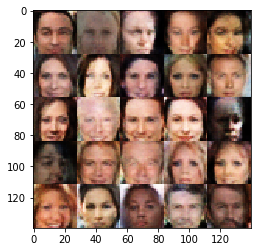

Epoch 1/1... Discriminator Loss: 0.6325... Generator Loss: 1.4562
Epoch 1/1... Discriminator Loss: 1.2336... Generator Loss: 0.5311
Epoch 1/1... Discriminator Loss: 1.0428... Generator Loss: 0.7432
Epoch 1/1... Discriminator Loss: 1.8935... Generator Loss: 0.2742
Epoch 1/1... Discriminator Loss: 1.3023... Generator Loss: 0.5266
Epoch 1/1... Discriminator Loss: 1.0661... Generator Loss: 0.7251
Epoch 1/1... Discriminator Loss: 0.9904... Generator Loss: 0.7401
Epoch 1/1... Discriminator Loss: 0.7412... Generator Loss: 1.3899
Epoch 1/1... Discriminator Loss: 1.8279... Generator Loss: 0.2756
Epoch 1/1... Discriminator Loss: 1.9336... Generator Loss: 0.2631
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


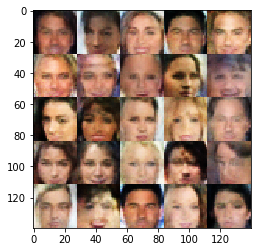

Epoch 1/1... Discriminator Loss: 1.4558... Generator Loss: 0.4254
Epoch 1/1... Discriminator Loss: 1.3763... Generator Loss: 0.4579
Epoch 1/1... Discriminator Loss: 2.0396... Generator Loss: 0.2108
Epoch 1/1... Discriminator Loss: 1.6086... Generator Loss: 0.3925
Epoch 1/1... Discriminator Loss: 0.7425... Generator Loss: 1.2142
Epoch 1/1... Discriminator Loss: 3.6315... Generator Loss: 0.0482
Epoch 1/1... Discriminator Loss: 0.9475... Generator Loss: 0.8990
Epoch 1/1... Discriminator Loss: 0.7341... Generator Loss: 1.1802
Epoch 1/1... Discriminator Loss: 0.9641... Generator Loss: 0.8611
Epoch 1/1... Discriminator Loss: 0.8265... Generator Loss: 0.9632
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


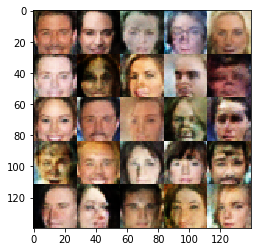

Epoch 1/1... Discriminator Loss: 2.0036... Generator Loss: 0.2314
Epoch 1/1... Discriminator Loss: 1.6879... Generator Loss: 0.3373
Epoch 1/1... Discriminator Loss: 0.4680... Generator Loss: 2.2542
Epoch 1/1... Discriminator Loss: 1.5568... Generator Loss: 0.4497
Epoch 1/1... Discriminator Loss: 1.5193... Generator Loss: 0.3873
Epoch 1/1... Discriminator Loss: 0.6936... Generator Loss: 1.2983
Epoch 1/1... Discriminator Loss: 1.5196... Generator Loss: 0.4084
Epoch 1/1... Discriminator Loss: 0.9469... Generator Loss: 0.8210
Epoch 1/1... Discriminator Loss: 1.1046... Generator Loss: 0.6611
Epoch 1/1... Discriminator Loss: 2.5619... Generator Loss: 0.1452
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


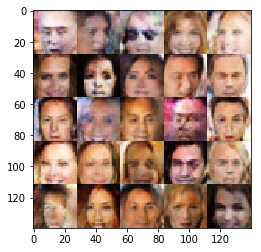

Epoch 1/1... Discriminator Loss: 1.1281... Generator Loss: 0.6226
Epoch 1/1... Discriminator Loss: 1.2210... Generator Loss: 0.5715
Epoch 1/1... Discriminator Loss: 0.7733... Generator Loss: 1.0494
Epoch 1/1... Discriminator Loss: 1.2602... Generator Loss: 0.5133
Epoch 1/1... Discriminator Loss: 1.1936... Generator Loss: 0.6486
Epoch 1/1... Discriminator Loss: 1.3504... Generator Loss: 0.5542
Epoch 1/1... Discriminator Loss: 0.6125... Generator Loss: 1.6022
Epoch 1/1... Discriminator Loss: 1.1572... Generator Loss: 0.5876
Epoch 1/1... Discriminator Loss: 0.8232... Generator Loss: 1.0362
Epoch 1/1... Discriminator Loss: 1.2095... Generator Loss: 0.5591
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


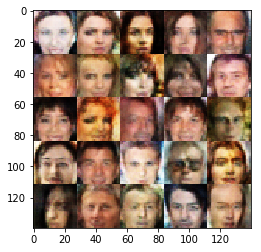

Epoch 1/1... Discriminator Loss: 0.6026... Generator Loss: 1.6398
Epoch 1/1... Discriminator Loss: 1.3280... Generator Loss: 0.5457
Epoch 1/1... Discriminator Loss: 2.1451... Generator Loss: 0.2062
Epoch 1/1... Discriminator Loss: 1.4659... Generator Loss: 0.4285
Epoch 1/1... Discriminator Loss: 0.4808... Generator Loss: 2.9783
Epoch 1/1... Discriminator Loss: 0.7840... Generator Loss: 1.0751
Epoch 1/1... Discriminator Loss: 2.1434... Generator Loss: 0.1937
Epoch 1/1... Discriminator Loss: 0.8876... Generator Loss: 1.0240
Epoch 1/1... Discriminator Loss: 1.0560... Generator Loss: 0.7524
Epoch 1/1... Discriminator Loss: 0.8063... Generator Loss: 1.0422
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


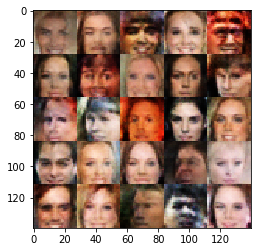

Epoch 1/1... Discriminator Loss: 1.1790... Generator Loss: 0.6255
Epoch 1/1... Discriminator Loss: 0.8757... Generator Loss: 0.8844
Epoch 1/1... Discriminator Loss: 0.8203... Generator Loss: 1.0237
Epoch 1/1... Discriminator Loss: 0.8984... Generator Loss: 0.8880
Epoch 1/1... Discriminator Loss: 1.1136... Generator Loss: 0.6466
Epoch 1/1... Discriminator Loss: 1.5855... Generator Loss: 0.3718
Epoch 1/1... Discriminator Loss: 1.9106... Generator Loss: 0.2432
Epoch 1/1... Discriminator Loss: 1.5735... Generator Loss: 0.3612
Epoch 1/1... Discriminator Loss: 0.6992... Generator Loss: 1.8147
Epoch 1/1... Discriminator Loss: 0.9673... Generator Loss: 1.1989
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


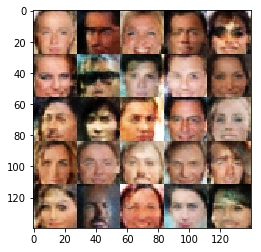

Epoch 1/1... Discriminator Loss: 0.6833... Generator Loss: 1.8931
Epoch 1/1... Discriminator Loss: 1.5307... Generator Loss: 0.4643
Epoch 1/1... Discriminator Loss: 0.6286... Generator Loss: 2.5139
Epoch 1/1... Discriminator Loss: 1.2606... Generator Loss: 0.7572
Epoch 1/1... Discriminator Loss: 0.8699... Generator Loss: 0.9242
Epoch 1/1... Discriminator Loss: 1.3324... Generator Loss: 0.4945
Epoch 1/1... Discriminator Loss: 0.6929... Generator Loss: 1.5000
Epoch 1/1... Discriminator Loss: 1.3802... Generator Loss: 0.4620
Epoch 1/1... Discriminator Loss: 0.8310... Generator Loss: 1.0161
Epoch 1/1... Discriminator Loss: 1.9072... Generator Loss: 0.2567
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


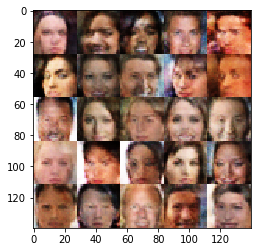

Epoch 1/1... Discriminator Loss: 0.8689... Generator Loss: 0.9134
Epoch 1/1... Discriminator Loss: 1.0682... Generator Loss: 0.6755
Epoch 1/1... Discriminator Loss: 1.2866... Generator Loss: 0.5485
Epoch 1/1... Discriminator Loss: 1.1317... Generator Loss: 0.6136
Epoch 1/1... Discriminator Loss: 1.7899... Generator Loss: 0.3263
Epoch 1/1... Discriminator Loss: 1.1556... Generator Loss: 0.6177
Epoch 1/1... Discriminator Loss: 0.8125... Generator Loss: 1.0424
Epoch 1/1... Discriminator Loss: 0.5741... Generator Loss: 1.6083
Epoch 1/1... Discriminator Loss: 1.7851... Generator Loss: 0.2743
Epoch 1/1... Discriminator Loss: 1.3165... Generator Loss: 0.4945
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


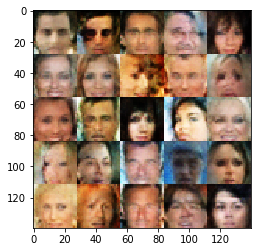

Epoch 1/1... Discriminator Loss: 1.1031... Generator Loss: 0.6704
Epoch 1/1... Discriminator Loss: 0.8470... Generator Loss: 0.9743
Epoch 1/1... Discriminator Loss: 1.0244... Generator Loss: 0.7216
Epoch 1/1... Discriminator Loss: 1.0658... Generator Loss: 0.6844
Epoch 1/1... Discriminator Loss: 1.1390... Generator Loss: 0.6290
Epoch 1/1... Discriminator Loss: 0.6286... Generator Loss: 2.3130
Epoch 1/1... Discriminator Loss: 0.8401... Generator Loss: 0.9376
Epoch 1/1... Discriminator Loss: 1.4678... Generator Loss: 0.4173
Epoch 1/1... Discriminator Loss: 2.0764... Generator Loss: 0.2008
Epoch 1/1... Discriminator Loss: 0.9870... Generator Loss: 0.8322
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


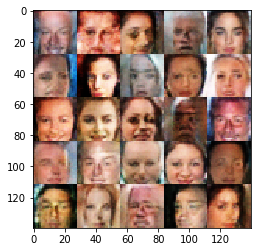

Epoch 1/1... Discriminator Loss: 0.7394... Generator Loss: 1.2120
Epoch 1/1... Discriminator Loss: 0.6501... Generator Loss: 1.3793
Epoch 1/1... Discriminator Loss: 1.3590... Generator Loss: 0.4670
Epoch 1/1... Discriminator Loss: 1.1593... Generator Loss: 0.5945
Epoch 1/1... Discriminator Loss: 1.3897... Generator Loss: 0.4426
Epoch 1/1... Discriminator Loss: 1.0034... Generator Loss: 0.7911
Epoch 1/1... Discriminator Loss: 0.5594... Generator Loss: 1.9347
Epoch 1/1... Discriminator Loss: 1.4997... Generator Loss: 0.3870
Epoch 1/1... Discriminator Loss: 1.6393... Generator Loss: 0.3308
Epoch 1/1... Discriminator Loss: 0.5113... Generator Loss: 1.9893
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


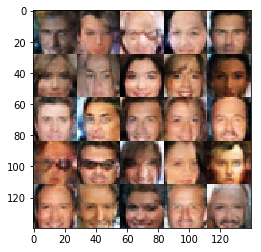

Epoch 1/1... Discriminator Loss: 1.1297... Generator Loss: 0.6307
Epoch 1/1... Discriminator Loss: 1.3084... Generator Loss: 0.5239
Epoch 1/1... Discriminator Loss: 1.1937... Generator Loss: 0.5529
Epoch 1/1... Discriminator Loss: 0.6897... Generator Loss: 1.4510
Epoch 1/1... Discriminator Loss: 1.5557... Generator Loss: 0.3742
Epoch 1/1... Discriminator Loss: 1.4229... Generator Loss: 0.4311
Epoch 1/1... Discriminator Loss: 1.4518... Generator Loss: 0.4789
Epoch 1/1... Discriminator Loss: 1.1488... Generator Loss: 0.6332
Epoch 1/1... Discriminator Loss: 1.2777... Generator Loss: 0.5043
Epoch 1/1... Discriminator Loss: 1.8680... Generator Loss: 0.2695
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


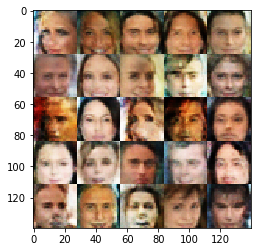

Epoch 1/1... Discriminator Loss: 0.4753... Generator Loss: 2.8825
Epoch 1/1... Discriminator Loss: 1.0020... Generator Loss: 0.7852
Epoch 1/1... Discriminator Loss: 1.8392... Generator Loss: 0.2732
Epoch 1/1... Discriminator Loss: 2.1874... Generator Loss: 0.2306
Epoch 1/1... Discriminator Loss: 1.5318... Generator Loss: 0.3783
Epoch 1/1... Discriminator Loss: 1.1772... Generator Loss: 0.5765
Epoch 1/1... Discriminator Loss: 0.8809... Generator Loss: 1.3130
Epoch 1/1... Discriminator Loss: 2.1417... Generator Loss: 0.1957
Epoch 1/1... Discriminator Loss: 1.6741... Generator Loss: 0.3425
Epoch 1/1... Discriminator Loss: 1.7460... Generator Loss: 0.3190
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


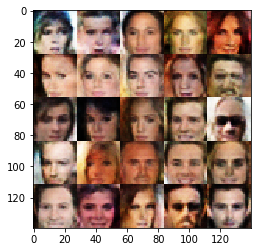

Epoch 1/1... Discriminator Loss: 1.2847... Generator Loss: 0.5141
Epoch 1/1... Discriminator Loss: 0.9919... Generator Loss: 0.7421
Epoch 1/1... Discriminator Loss: 1.4576... Generator Loss: 0.4505
Epoch 1/1... Discriminator Loss: 0.9554... Generator Loss: 0.8039
Epoch 1/1... Discriminator Loss: 1.5498... Generator Loss: 0.3990
Epoch 1/1... Discriminator Loss: 0.7101... Generator Loss: 1.1966
Epoch 1/1... Discriminator Loss: 1.5286... Generator Loss: 0.3764
Epoch 1/1... Discriminator Loss: 0.8755... Generator Loss: 1.1450
Epoch 1/1... Discriminator Loss: 1.4486... Generator Loss: 0.4269
Epoch 1/1... Discriminator Loss: 1.3213... Generator Loss: 0.5484
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


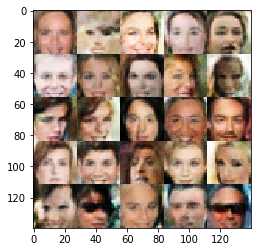

Epoch 1/1... Discriminator Loss: 1.0205... Generator Loss: 0.7457
Epoch 1/1... Discriminator Loss: 1.4721... Generator Loss: 0.4859
Epoch 1/1... Discriminator Loss: 1.4304... Generator Loss: 0.4543
Epoch 1/1... Discriminator Loss: 0.9050... Generator Loss: 0.8855
Epoch 1/1... Discriminator Loss: 0.9002... Generator Loss: 0.9081
Epoch 1/1... Discriminator Loss: 1.6032... Generator Loss: 0.3655
Epoch 1/1... Discriminator Loss: 1.4831... Generator Loss: 0.4056
Epoch 1/1... Discriminator Loss: 0.6426... Generator Loss: 1.3813
Epoch 1/1... Discriminator Loss: 1.0606... Generator Loss: 0.7037
Epoch 1/1... Discriminator Loss: 0.8405... Generator Loss: 0.9758
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


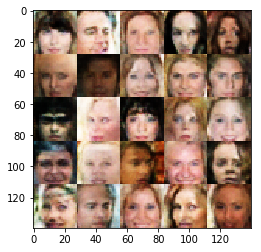

Epoch 1/1... Discriminator Loss: 1.2995... Generator Loss: 0.4971
Epoch 1/1... Discriminator Loss: 0.7204... Generator Loss: 1.2253
Epoch 1/1... Discriminator Loss: 0.9966... Generator Loss: 0.7871
Epoch 1/1... Discriminator Loss: 1.3986... Generator Loss: 0.4938
Epoch 1/1... Discriminator Loss: 0.8226... Generator Loss: 1.5851
Epoch 1/1... Discriminator Loss: 1.1199... Generator Loss: 0.6236
Epoch 1/1... Discriminator Loss: 0.8033... Generator Loss: 1.0111
Epoch 1/1... Discriminator Loss: 1.4208... Generator Loss: 0.5449
Epoch 1/1... Discriminator Loss: 2.0866... Generator Loss: 0.2129
Epoch 1/1... Discriminator Loss: 1.0251... Generator Loss: 0.7359
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


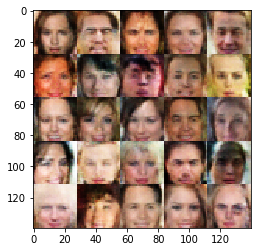

Epoch 1/1... Discriminator Loss: 1.7411... Generator Loss: 0.3038
Epoch 1/1... Discriminator Loss: 1.5596... Generator Loss: 0.3605
Epoch 1/1... Discriminator Loss: 0.5148... Generator Loss: 2.8152
Epoch 1/1... Discriminator Loss: 1.6720... Generator Loss: 0.3593
Epoch 1/1... Discriminator Loss: 0.8804... Generator Loss: 1.0007
Epoch 1/1... Discriminator Loss: 1.3672... Generator Loss: 0.4588
Epoch 1/1... Discriminator Loss: 0.9048... Generator Loss: 0.8498
Epoch 1/1... Discriminator Loss: 0.7424... Generator Loss: 1.1379
Epoch 1/1... Discriminator Loss: 2.2946... Generator Loss: 0.1588
Epoch 1/1... Discriminator Loss: 0.8765... Generator Loss: 0.9968
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


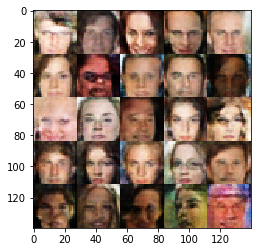

Epoch 1/1... Discriminator Loss: 0.5878... Generator Loss: 1.5327
Epoch 1/1... Discriminator Loss: 1.0818... Generator Loss: 0.6930
Epoch 1/1... Discriminator Loss: 0.7859... Generator Loss: 1.0389
Epoch 1/1... Discriminator Loss: 1.7044... Generator Loss: 0.3069
Epoch 1/1... Discriminator Loss: 0.6204... Generator Loss: 1.6845
Epoch 1/1... Discriminator Loss: 2.0650... Generator Loss: 0.2192
Epoch 1/1... Discriminator Loss: 1.7788... Generator Loss: 0.3064
Epoch 1/1... Discriminator Loss: 1.7555... Generator Loss: 0.3094
Epoch 1/1... Discriminator Loss: 1.9712... Generator Loss: 0.2597
Epoch 1/1... Discriminator Loss: 1.4908... Generator Loss: 0.4294
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


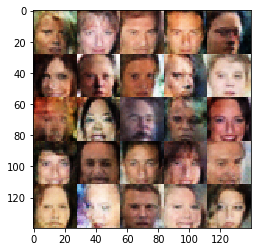

Epoch 1/1... Discriminator Loss: 0.9967... Generator Loss: 0.8037
Epoch 1/1... Discriminator Loss: 2.3484... Generator Loss: 0.1534
Epoch 1/1... Discriminator Loss: 1.1670... Generator Loss: 0.7276
Epoch 1/1... Discriminator Loss: 0.8585... Generator Loss: 0.9305
Epoch 1/1... Discriminator Loss: 0.7953... Generator Loss: 1.0336
Epoch 1/1... Discriminator Loss: 1.6852... Generator Loss: 0.3594
Epoch 1/1... Discriminator Loss: 0.5584... Generator Loss: 1.6800
Epoch 1/1... Discriminator Loss: 0.5964... Generator Loss: 1.5463
Epoch 1/1... Discriminator Loss: 0.7126... Generator Loss: 1.3391
Epoch 1/1... Discriminator Loss: 1.3122... Generator Loss: 0.5213
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


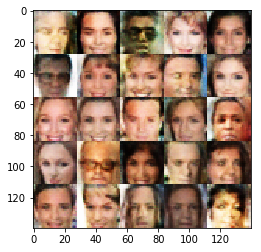

Epoch 1/1... Discriminator Loss: 1.5933... Generator Loss: 0.3524
Epoch 1/1... Discriminator Loss: 0.9627... Generator Loss: 0.9240
Epoch 1/1... Discriminator Loss: 1.3053... Generator Loss: 0.5128
Epoch 1/1... Discriminator Loss: 1.1898... Generator Loss: 0.5698
Epoch 1/1... Discriminator Loss: 1.0518... Generator Loss: 0.7596
Epoch 1/1... Discriminator Loss: 1.9450... Generator Loss: 0.2339
Epoch 1/1... Discriminator Loss: 0.5348... Generator Loss: 1.8068
Epoch 1/1... Discriminator Loss: 0.7911... Generator Loss: 1.0805
Epoch 1/1... Discriminator Loss: 0.9905... Generator Loss: 0.8181
Epoch 1/1... Discriminator Loss: 1.6682... Generator Loss: 0.3426
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


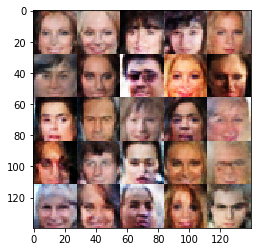

Epoch 1/1... Discriminator Loss: 1.1133... Generator Loss: 0.6808
Epoch 1/1... Discriminator Loss: 0.6994... Generator Loss: 3.3792
Epoch 1/1... Discriminator Loss: 1.4716... Generator Loss: 0.4416
Epoch 1/1... Discriminator Loss: 2.2178... Generator Loss: 0.1733
Epoch 1/1... Discriminator Loss: 0.8528... Generator Loss: 0.9362
Epoch 1/1... Discriminator Loss: 1.7692... Generator Loss: 0.3146
Epoch 1/1... Discriminator Loss: 2.1693... Generator Loss: 0.1850
Epoch 1/1... Discriminator Loss: 0.8290... Generator Loss: 0.9833
Epoch 1/1... Discriminator Loss: 0.7603... Generator Loss: 1.0710
Epoch 1/1... Discriminator Loss: 1.0017... Generator Loss: 0.7542
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


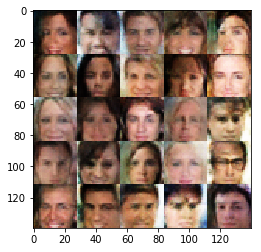

Epoch 1/1... Discriminator Loss: 1.7652... Generator Loss: 0.2944
Epoch 1/1... Discriminator Loss: 2.3515... Generator Loss: 0.1636
Epoch 1/1... Discriminator Loss: 1.2946... Generator Loss: 0.5317
Epoch 1/1... Discriminator Loss: 2.3455... Generator Loss: 0.1589
Epoch 1/1... Discriminator Loss: 0.7245... Generator Loss: 2.0373
Epoch 1/1... Discriminator Loss: 2.4429... Generator Loss: 0.1560
Epoch 1/1... Discriminator Loss: 0.8091... Generator Loss: 1.0097
Epoch 1/1... Discriminator Loss: 1.0206... Generator Loss: 0.7322
Epoch 1/1... Discriminator Loss: 0.7290... Generator Loss: 1.1515
Epoch 1/1... Discriminator Loss: 1.1815... Generator Loss: 0.5834
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


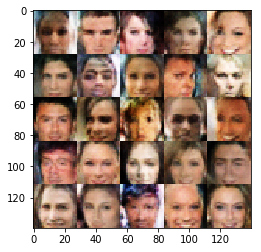

Epoch 1/1... Discriminator Loss: 1.0027... Generator Loss: 0.8282
Epoch 1/1... Discriminator Loss: 0.6082... Generator Loss: 2.0939
Epoch 1/1... Discriminator Loss: 0.9892... Generator Loss: 0.8053
Epoch 1/1... Discriminator Loss: 1.0860... Generator Loss: 0.6877
Epoch 1/1... Discriminator Loss: 1.6310... Generator Loss: 0.3570
Epoch 1/1... Discriminator Loss: 1.9923... Generator Loss: 0.2547
Epoch 1/1... Discriminator Loss: 1.2829... Generator Loss: 0.5172
Epoch 1/1... Discriminator Loss: 1.0022... Generator Loss: 0.7316
Epoch 1/1... Discriminator Loss: 1.5627... Generator Loss: 0.3850
Epoch 1/1... Discriminator Loss: 0.7962... Generator Loss: 1.1229
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


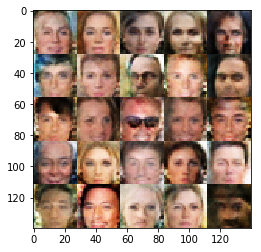

Epoch 1/1... Discriminator Loss: 2.0927... Generator Loss: 0.2149
Epoch 1/1... Discriminator Loss: 1.1922... Generator Loss: 0.5711
Epoch 1/1... Discriminator Loss: 1.8609... Generator Loss: 0.2580
Epoch 1/1... Discriminator Loss: 0.8553... Generator Loss: 1.0263
Epoch 1/1... Discriminator Loss: 0.8180... Generator Loss: 0.9887
Epoch 1/1... Discriminator Loss: 1.7542... Generator Loss: 0.3168
Epoch 1/1... Discriminator Loss: 1.1902... Generator Loss: 0.6001
Epoch 1/1... Discriminator Loss: 0.6904... Generator Loss: 1.2814
Epoch 1/1... Discriminator Loss: 1.2692... Generator Loss: 0.5380
Epoch 1/1... Discriminator Loss: 1.8073... Generator Loss: 0.2783
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


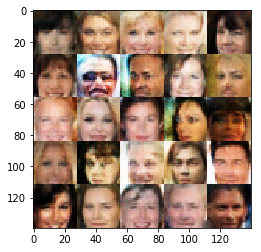

Epoch 1/1... Discriminator Loss: 0.5590... Generator Loss: 1.7213
Epoch 1/1... Discriminator Loss: 0.8588... Generator Loss: 0.9952
Epoch 1/1... Discriminator Loss: 0.8321... Generator Loss: 0.9943
Epoch 1/1... Discriminator Loss: 1.3914... Generator Loss: 0.4793
Epoch 1/1... Discriminator Loss: 0.5748... Generator Loss: 1.7854
Epoch 1/1... Discriminator Loss: 2.0716... Generator Loss: 0.2072
Epoch 1/1... Discriminator Loss: 1.1397... Generator Loss: 0.6526
Epoch 1/1... Discriminator Loss: 1.2763... Generator Loss: 0.5289
Epoch 1/1... Discriminator Loss: 1.5208... Generator Loss: 0.3912
Epoch 1/1... Discriminator Loss: 1.0380... Generator Loss: 0.7182
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


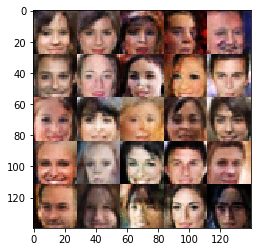

Epoch 1/1... Discriminator Loss: 0.8148... Generator Loss: 1.0190
Epoch 1/1... Discriminator Loss: 0.9409... Generator Loss: 0.9418
Epoch 1/1... Discriminator Loss: 1.2500... Generator Loss: 0.5444
Epoch 1/1... Discriminator Loss: 1.1515... Generator Loss: 0.6531
Epoch 1/1... Discriminator Loss: 1.1335... Generator Loss: 0.6403
Epoch 1/1... Discriminator Loss: 1.2809... Generator Loss: 0.5389
Epoch 1/1... Discriminator Loss: 1.4605... Generator Loss: 0.4382
Epoch 1/1... Discriminator Loss: 0.9391... Generator Loss: 0.8386
Epoch 1/1... Discriminator Loss: 1.0164... Generator Loss: 0.8353
Epoch 1/1... Discriminator Loss: 1.5518... Generator Loss: 0.4052
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


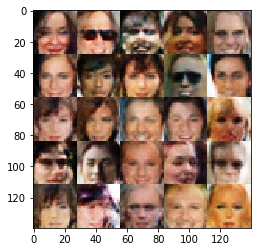

Epoch 1/1... Discriminator Loss: 0.8357... Generator Loss: 1.0567
Epoch 1/1... Discriminator Loss: 1.7882... Generator Loss: 0.2878
Epoch 1/1... Discriminator Loss: 1.4693... Generator Loss: 0.4087
Epoch 1/1... Discriminator Loss: 1.8525... Generator Loss: 0.3140
Epoch 1/1... Discriminator Loss: 1.2715... Generator Loss: 0.5674
Epoch 1/1... Discriminator Loss: 0.6607... Generator Loss: 1.4355
Epoch 1/1... Discriminator Loss: 0.9975... Generator Loss: 0.7481
Epoch 1/1... Discriminator Loss: 1.1831... Generator Loss: 0.6623
Epoch 1/1... Discriminator Loss: 1.5449... Generator Loss: 0.3874
Epoch 1/1... Discriminator Loss: 1.1622... Generator Loss: 0.6535
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


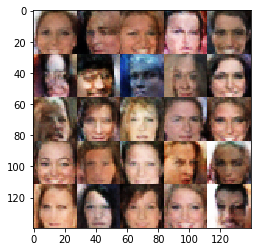

Epoch 1/1... Discriminator Loss: 2.2736... Generator Loss: 0.1762
Epoch 1/1... Discriminator Loss: 0.6194... Generator Loss: 1.7726
Epoch 1/1... Discriminator Loss: 0.9561... Generator Loss: 0.8153
Epoch 1/1... Discriminator Loss: 0.8191... Generator Loss: 1.0404
Epoch 1/1... Discriminator Loss: 1.1967... Generator Loss: 0.6901
Epoch 1/1... Discriminator Loss: 1.5795... Generator Loss: 0.4346
Epoch 1/1... Discriminator Loss: 0.5509... Generator Loss: 1.7650
Epoch 1/1... Discriminator Loss: 0.7876... Generator Loss: 1.0579
Epoch 1/1... Discriminator Loss: 1.7488... Generator Loss: 0.3779
Epoch 1/1... Discriminator Loss: 1.1854... Generator Loss: 0.6248
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


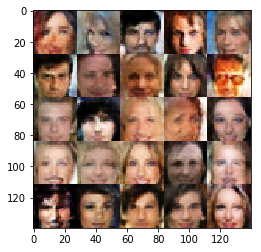

Epoch 1/1... Discriminator Loss: 1.3105... Generator Loss: 0.4822
Epoch 1/1... Discriminator Loss: 1.0482... Generator Loss: 0.7307
Epoch 1/1... Discriminator Loss: 1.9417... Generator Loss: 0.2525
Epoch 1/1... Discriminator Loss: 1.5143... Generator Loss: 0.3730
Epoch 1/1... Discriminator Loss: 0.5552... Generator Loss: 1.6837
Epoch 1/1... Discriminator Loss: 1.9532... Generator Loss: 0.2932
Epoch 1/1... Discriminator Loss: 1.0796... Generator Loss: 0.6928
Epoch 1/1... Discriminator Loss: 1.6562... Generator Loss: 0.3275
Epoch 1/1... Discriminator Loss: 0.5869... Generator Loss: 2.1344
Epoch 1/1... Discriminator Loss: 1.3646... Generator Loss: 0.4871
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


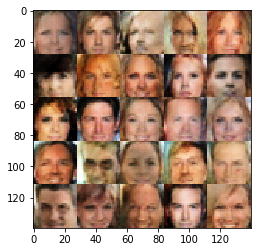

Epoch 1/1... Discriminator Loss: 1.1547... Generator Loss: 0.6103
Epoch 1/1... Discriminator Loss: 1.6503... Generator Loss: 0.3992
Epoch 1/1... Discriminator Loss: 0.9729... Generator Loss: 1.0200
Epoch 1/1... Discriminator Loss: 1.0148... Generator Loss: 0.7287
Epoch 1/1... Discriminator Loss: 1.7049... Generator Loss: 0.3672
Epoch 1/1... Discriminator Loss: 0.7943... Generator Loss: 1.0440
Epoch 1/1... Discriminator Loss: 1.1794... Generator Loss: 0.5909
Epoch 1/1... Discriminator Loss: 1.6451... Generator Loss: 0.3435
Epoch 1/1... Discriminator Loss: 1.1577... Generator Loss: 0.6114
Epoch 1/1... Discriminator Loss: 0.7084... Generator Loss: 1.3256
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


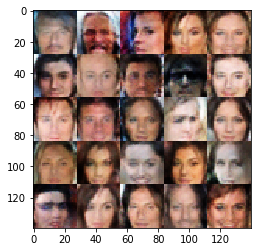

Epoch 1/1... Discriminator Loss: 0.6700... Generator Loss: 1.7367
Epoch 1/1... Discriminator Loss: 0.9753... Generator Loss: 0.8197
Epoch 1/1... Discriminator Loss: 1.4024... Generator Loss: 0.4452
Epoch 1/1... Discriminator Loss: 3.3228... Generator Loss: 0.0659
Epoch 1/1... Discriminator Loss: 1.3216... Generator Loss: 0.4856
Epoch 1/1... Discriminator Loss: 1.4223... Generator Loss: 0.4267
Epoch 1/1... Discriminator Loss: 1.2988... Generator Loss: 0.5079
Epoch 1/1... Discriminator Loss: 1.1591... Generator Loss: 0.5852
Epoch 1/1... Discriminator Loss: 0.7336... Generator Loss: 2.4497
Epoch 1/1... Discriminator Loss: 0.7412... Generator Loss: 1.2168
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


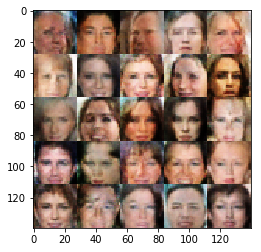

Epoch 1/1... Discriminator Loss: 1.5250... Generator Loss: 0.3764
Epoch 1/1... Discriminator Loss: 0.7058... Generator Loss: 1.3998
Epoch 1/1... Discriminator Loss: 2.0304... Generator Loss: 0.2174
Epoch 1/1... Discriminator Loss: 0.9703... Generator Loss: 0.7891
Epoch 1/1... Discriminator Loss: 0.7682... Generator Loss: 1.0511
Epoch 1/1... Discriminator Loss: 1.1823... Generator Loss: 0.5945
Epoch 1/1... Discriminator Loss: 0.9331... Generator Loss: 0.8177
Epoch 1/1... Discriminator Loss: 0.6186... Generator Loss: 1.4350
Epoch 1/1... Discriminator Loss: 2.2462... Generator Loss: 0.1898
Epoch 1/1... Discriminator Loss: 1.9448... Generator Loss: 0.2465
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


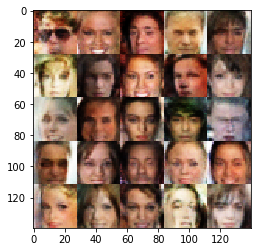

Epoch 1/1... Discriminator Loss: 0.6076... Generator Loss: 1.4886
Epoch 1/1... Discriminator Loss: 0.6610... Generator Loss: 1.3238
Epoch 1/1... Discriminator Loss: 1.4148... Generator Loss: 0.4290
Epoch 1/1... Discriminator Loss: 0.8235... Generator Loss: 0.9834
Epoch 1/1... Discriminator Loss: 0.9668... Generator Loss: 0.7853
Epoch 1/1... Discriminator Loss: 0.5757... Generator Loss: 1.9392
Epoch 1/1... Discriminator Loss: 2.1241... Generator Loss: 0.2107
Epoch 1/1... Discriminator Loss: 0.6387... Generator Loss: 1.9289
Epoch 1/1... Discriminator Loss: 0.8760... Generator Loss: 0.8959
Epoch 1/1... Discriminator Loss: 0.8599... Generator Loss: 1.0235
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


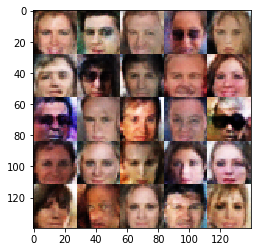

Epoch 1/1... Discriminator Loss: 0.9794... Generator Loss: 0.7557
Epoch 1/1... Discriminator Loss: 1.1206... Generator Loss: 0.6601
Epoch 1/1... Discriminator Loss: 2.1029... Generator Loss: 0.2336
Epoch 1/1... Discriminator Loss: 0.8843... Generator Loss: 0.8888
Epoch 1/1... Discriminator Loss: 1.5732... Generator Loss: 0.3950
Epoch 1/1... Discriminator Loss: 0.8282... Generator Loss: 1.2275
Epoch 1/1... Discriminator Loss: 1.3760... Generator Loss: 0.4458
Epoch 1/1... Discriminator Loss: 0.6570... Generator Loss: 1.3357
Epoch 1/1... Discriminator Loss: 1.2484... Generator Loss: 0.5334
Epoch 1/1... Discriminator Loss: 0.8452... Generator Loss: 1.0027
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


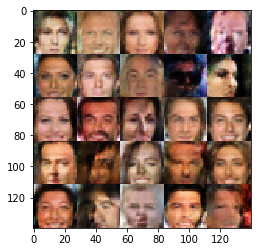

Epoch 1/1... Discriminator Loss: 1.3489... Generator Loss: 0.5138
Epoch 1/1... Discriminator Loss: 1.5374... Generator Loss: 0.4011
Epoch 1/1... Discriminator Loss: 1.3122... Generator Loss: 0.5311
Epoch 1/1... Discriminator Loss: 2.4953... Generator Loss: 0.1393
Epoch 1/1... Discriminator Loss: 1.0054... Generator Loss: 0.8319
Epoch 1/1... Discriminator Loss: 1.3125... Generator Loss: 0.5085
Epoch 1/1... Discriminator Loss: 1.3100... Generator Loss: 0.5389
Epoch 1/1... Discriminator Loss: 0.9242... Generator Loss: 0.9002
Epoch 1/1... Discriminator Loss: 2.3579... Generator Loss: 0.1622
Epoch 1/1... Discriminator Loss: 2.3441... Generator Loss: 0.1886
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


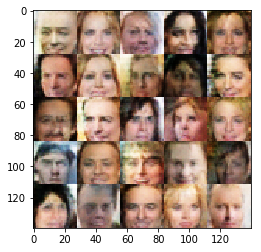

Epoch 1/1... Discriminator Loss: 1.0260... Generator Loss: 0.7637
Epoch 1/1... Discriminator Loss: 1.7972... Generator Loss: 0.3517
Epoch 1/1... Discriminator Loss: 1.6929... Generator Loss: 0.3316
Epoch 1/1... Discriminator Loss: 0.9982... Generator Loss: 0.7668
Epoch 1/1... Discriminator Loss: 1.2478... Generator Loss: 0.5712
Epoch 1/1... Discriminator Loss: 1.0914... Generator Loss: 0.6397
Epoch 1/1... Discriminator Loss: 0.7607... Generator Loss: 1.1364
Epoch 1/1... Discriminator Loss: 1.3327... Generator Loss: 0.4731
Epoch 1/1... Discriminator Loss: 2.2255... Generator Loss: 0.1884
Epoch 1/1... Discriminator Loss: 0.8589... Generator Loss: 0.9311
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


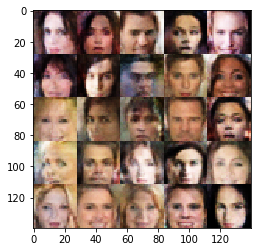

Epoch 1/1... Discriminator Loss: 1.7749... Generator Loss: 0.3254
Epoch 1/1... Discriminator Loss: 1.1537... Generator Loss: 0.6127
Epoch 1/1... Discriminator Loss: 0.8123... Generator Loss: 1.0798
Epoch 1/1... Discriminator Loss: 2.5025... Generator Loss: 0.1457
Epoch 1/1... Discriminator Loss: 1.5188... Generator Loss: 0.3832
Epoch 1/1... Discriminator Loss: 1.3044... Generator Loss: 0.5067
Epoch 1/1... Discriminator Loss: 1.4733... Generator Loss: 0.4005
Epoch 1/1... Discriminator Loss: 1.5805... Generator Loss: 0.3580
Epoch 1/1... Discriminator Loss: 1.0943... Generator Loss: 0.6743
Epoch 1/1... Discriminator Loss: 0.7845... Generator Loss: 1.0481
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


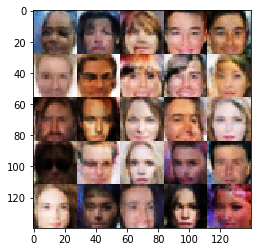

Epoch 1/1... Discriminator Loss: 0.8628... Generator Loss: 0.9241
Epoch 1/1... Discriminator Loss: 0.8305... Generator Loss: 1.0291
Epoch 1/1... Discriminator Loss: 0.6496... Generator Loss: 1.3811
Epoch 1/1... Discriminator Loss: 0.6998... Generator Loss: 1.3895
Epoch 1/1... Discriminator Loss: 0.6178... Generator Loss: 1.6149
Epoch 1/1... Discriminator Loss: 0.9090... Generator Loss: 0.8357
Epoch 1/1... Discriminator Loss: 1.9422... Generator Loss: 0.2815
Epoch 1/1... Discriminator Loss: 0.7906... Generator Loss: 1.0411
Epoch 1/1... Discriminator Loss: 1.5151... Generator Loss: 0.4014
Epoch 1/1... Discriminator Loss: 0.7129... Generator Loss: 1.5236
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


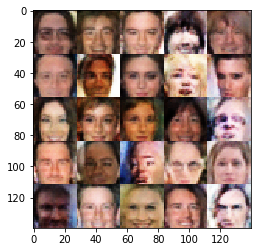

Epoch 1/1... Discriminator Loss: 1.9074... Generator Loss: 0.2929
Epoch 1/1... Discriminator Loss: 0.7398... Generator Loss: 1.1916
Epoch 1/1... Discriminator Loss: 1.1477... Generator Loss: 0.6363
Epoch 1/1... Discriminator Loss: 0.7018... Generator Loss: 1.6853
Epoch 1/1... Discriminator Loss: 1.0872... Generator Loss: 0.7804
Epoch 1/1... Discriminator Loss: 1.1244... Generator Loss: 0.6338
Epoch 1/1... Discriminator Loss: 0.9410... Generator Loss: 0.9457
Epoch 1/1... Discriminator Loss: 1.0548... Generator Loss: 0.6946
Epoch 1/1... Discriminator Loss: 1.6688... Generator Loss: 0.3562
Epoch 1/1... Discriminator Loss: 1.0246... Generator Loss: 0.7651
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


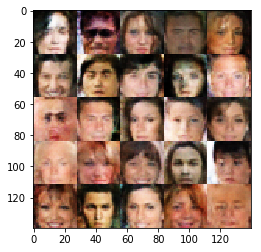

Epoch 1/1... Discriminator Loss: 1.2059... Generator Loss: 0.5697
Epoch 1/1... Discriminator Loss: 0.8921... Generator Loss: 0.9550
Epoch 1/1... Discriminator Loss: 2.2388... Generator Loss: 0.3118
Epoch 1/1... Discriminator Loss: 0.6703... Generator Loss: 1.2725
Epoch 1/1... Discriminator Loss: 1.5163... Generator Loss: 0.3931
Epoch 1/1... Discriminator Loss: 1.9309... Generator Loss: 0.2559
Epoch 1/1... Discriminator Loss: 1.0341... Generator Loss: 0.7063
Epoch 1/1... Discriminator Loss: 1.4190... Generator Loss: 0.4370
Epoch 1/1... Discriminator Loss: 0.4921... Generator Loss: 1.9687
Epoch 1/1... Discriminator Loss: 0.6708... Generator Loss: 1.3116
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


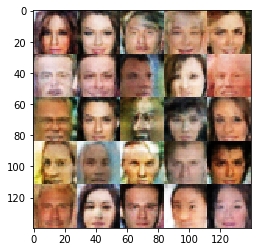

Epoch 1/1... Discriminator Loss: 1.7756... Generator Loss: 0.3201
Epoch 1/1... Discriminator Loss: 0.7315... Generator Loss: 1.1610
Epoch 1/1... Discriminator Loss: 1.3606... Generator Loss: 0.4631
Epoch 1/1... Discriminator Loss: 1.4263... Generator Loss: 0.4177
Epoch 1/1... Discriminator Loss: 0.7958... Generator Loss: 1.1057
Epoch 1/1... Discriminator Loss: 0.9299... Generator Loss: 0.8791
Epoch 1/1... Discriminator Loss: 1.2518... Generator Loss: 0.7935
Epoch 1/1... Discriminator Loss: 1.2872... Generator Loss: 0.6149
Epoch 1/1... Discriminator Loss: 1.9868... Generator Loss: 0.2184
Epoch 1/1... Discriminator Loss: 1.5105... Generator Loss: 0.4036
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


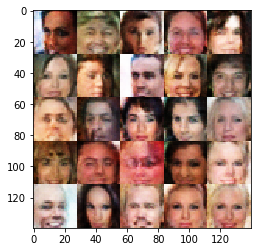

Epoch 1/1... Discriminator Loss: 1.0724... Generator Loss: 0.6666
Epoch 1/1... Discriminator Loss: 1.2261... Generator Loss: 0.6061
Epoch 1/1... Discriminator Loss: 1.0268... Generator Loss: 0.7536
Epoch 1/1... Discriminator Loss: 0.6308... Generator Loss: 1.4597
Epoch 1/1... Discriminator Loss: 1.3225... Generator Loss: 0.5386
Epoch 1/1... Discriminator Loss: 0.7596... Generator Loss: 1.0843
Epoch 1/1... Discriminator Loss: 0.7158... Generator Loss: 1.1877
Epoch 1/1... Discriminator Loss: 2.2636... Generator Loss: 0.1731
Epoch 1/1... Discriminator Loss: 1.4706... Generator Loss: 0.4247
Epoch 1/1... Discriminator Loss: 0.7120... Generator Loss: 1.1947
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


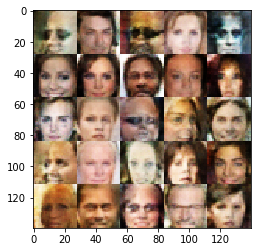

Epoch 1/1... Discriminator Loss: 1.9250... Generator Loss: 0.2494
Epoch 1/1... Discriminator Loss: 2.0132... Generator Loss: 0.2279
Epoch 1/1... Discriminator Loss: 0.8084... Generator Loss: 1.0151
Epoch 1/1... Discriminator Loss: 1.1273... Generator Loss: 0.6211
Epoch 1/1... Discriminator Loss: 1.6788... Generator Loss: 0.3210
Epoch 1/1... Discriminator Loss: 1.0177... Generator Loss: 0.7153
Epoch 1/1... Discriminator Loss: 1.0029... Generator Loss: 0.8152
Epoch 1/1... Discriminator Loss: 1.3558... Generator Loss: 0.5311
Epoch 1/1... Discriminator Loss: 0.7950... Generator Loss: 1.0291
Epoch 1/1... Discriminator Loss: 0.5452... Generator Loss: 2.0421
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


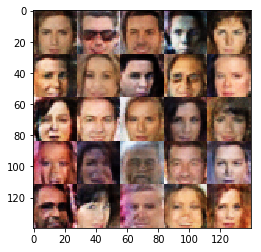

Epoch 1/1... Discriminator Loss: 0.7932... Generator Loss: 1.0657
Epoch 1/1... Discriminator Loss: 0.8227... Generator Loss: 0.9965
Epoch 1/1... Discriminator Loss: 0.5493... Generator Loss: 1.6913
Epoch 1/1... Discriminator Loss: 2.4310... Generator Loss: 0.1499
Epoch 1/1... Discriminator Loss: 1.3384... Generator Loss: 0.5527
Epoch 1/1... Discriminator Loss: 0.8687... Generator Loss: 0.9670
Epoch 1/1... Discriminator Loss: 0.6937... Generator Loss: 1.5851
Epoch 1/1... Discriminator Loss: 1.5056... Generator Loss: 0.3905
Epoch 1/1... Discriminator Loss: 0.9120... Generator Loss: 0.8620
Epoch 1/1... Discriminator Loss: 1.0495... Generator Loss: 0.6986
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


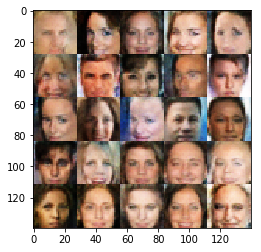

Epoch 1/1... Discriminator Loss: 1.1432... Generator Loss: 0.7073
Epoch 1/1... Discriminator Loss: 0.9083... Generator Loss: 0.8496
Epoch 1/1... Discriminator Loss: 1.4940... Generator Loss: 0.3789
Epoch 1/1... Discriminator Loss: 1.8359... Generator Loss: 0.2891
Epoch 1/1... Discriminator Loss: 0.5637... Generator Loss: 1.7576
Epoch 1/1... Discriminator Loss: 1.1062... Generator Loss: 0.6454
Epoch 1/1... Discriminator Loss: 1.2140... Generator Loss: 0.5602
Epoch 1/1... Discriminator Loss: 1.0440... Generator Loss: 0.6995
Epoch 1/1... Discriminator Loss: 1.9014... Generator Loss: 0.2831
Epoch 1/1... Discriminator Loss: 1.1062... Generator Loss: 0.6410
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


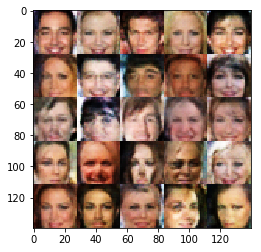

Epoch 1/1... Discriminator Loss: 0.9085... Generator Loss: 0.9617
Epoch 1/1... Discriminator Loss: 1.0181... Generator Loss: 0.8558
Epoch 1/1... Discriminator Loss: 2.5296... Generator Loss: 0.1447
Epoch 1/1... Discriminator Loss: 1.0587... Generator Loss: 0.7846
Epoch 1/1... Discriminator Loss: 1.3083... Generator Loss: 0.5081
Epoch 1/1... Discriminator Loss: 0.9445... Generator Loss: 0.8598
Epoch 1/1... Discriminator Loss: 1.1458... Generator Loss: 0.6727
Epoch 1/1... Discriminator Loss: 0.6448... Generator Loss: 1.7767
Epoch 1/1... Discriminator Loss: 0.6951... Generator Loss: 1.2316
Epoch 1/1... Discriminator Loss: 0.8362... Generator Loss: 0.9800
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


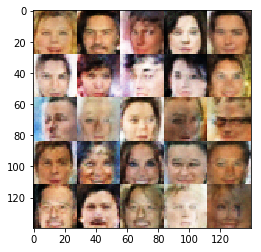

Epoch 1/1... Discriminator Loss: 0.6779... Generator Loss: 1.4685
Epoch 1/1... Discriminator Loss: 2.0478... Generator Loss: 0.2141
Epoch 1/1... Discriminator Loss: 0.7419... Generator Loss: 1.4189
Epoch 1/1... Discriminator Loss: 0.5520... Generator Loss: 1.7921
Epoch 1/1... Discriminator Loss: 0.8068... Generator Loss: 1.0264
Epoch 1/1... Discriminator Loss: 1.3288... Generator Loss: 0.4912
Epoch 1/1... Discriminator Loss: 1.1308... Generator Loss: 0.6525
Epoch 1/1... Discriminator Loss: 0.7490... Generator Loss: 1.1653
Epoch 1/1... Discriminator Loss: 0.5142... Generator Loss: 1.9459
Epoch 1/1... Discriminator Loss: 1.5555... Generator Loss: 0.3914
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


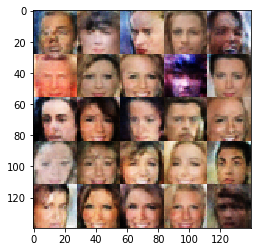

Epoch 1/1... Discriminator Loss: 1.3166... Generator Loss: 0.4991
Epoch 1/1... Discriminator Loss: 0.7062... Generator Loss: 1.4233
Epoch 1/1... Discriminator Loss: 0.7524... Generator Loss: 1.2545
Epoch 1/1... Discriminator Loss: 0.7926... Generator Loss: 1.0130
Epoch 1/1... Discriminator Loss: 1.0891... Generator Loss: 0.6735
Epoch 1/1... Discriminator Loss: 0.9792... Generator Loss: 3.2565
Epoch 1/1... Discriminator Loss: 1.4027... Generator Loss: 0.4659
Epoch 1/1... Discriminator Loss: 0.8359... Generator Loss: 0.9542
Epoch 1/1... Discriminator Loss: 1.1952... Generator Loss: 0.5668
Epoch 1/1... Discriminator Loss: 1.9671... Generator Loss: 0.2438
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


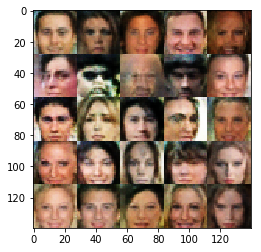

Epoch 1/1... Discriminator Loss: 1.3548... Generator Loss: 0.5077
Epoch 1/1... Discriminator Loss: 1.2751... Generator Loss: 0.5582
Epoch 1/1... Discriminator Loss: 1.0659... Generator Loss: 0.6968
Epoch 1/1... Discriminator Loss: 0.7276... Generator Loss: 1.1516
Epoch 1/1... Discriminator Loss: 1.0025... Generator Loss: 0.7501
Epoch 1/1... Discriminator Loss: 1.0051... Generator Loss: 0.7413
Epoch 1/1... Discriminator Loss: 1.1833... Generator Loss: 0.6033
Epoch 1/1... Discriminator Loss: 1.4520... Generator Loss: 0.4623
Epoch 1/1... Discriminator Loss: 1.1519... Generator Loss: 0.7164
Epoch 1/1... Discriminator Loss: 1.8930... Generator Loss: 0.2716
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


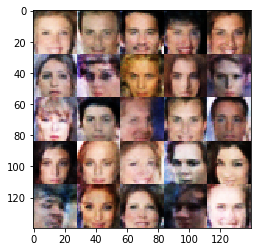

Epoch 1/1... Discriminator Loss: 1.7660... Generator Loss: 0.3120
Epoch 1/1... Discriminator Loss: 2.0030... Generator Loss: 0.2256
Epoch 1/1... Discriminator Loss: 1.1077... Generator Loss: 0.6443
Epoch 1/1... Discriminator Loss: 0.6571... Generator Loss: 1.3671
Epoch 1/1... Discriminator Loss: 1.5961... Generator Loss: 0.3876
Epoch 1/1... Discriminator Loss: 0.7771... Generator Loss: 1.0841
Epoch 1/1... Discriminator Loss: 0.9569... Generator Loss: 0.7708
Epoch 1/1... Discriminator Loss: 0.6974... Generator Loss: 1.2426
Epoch 1/1... Discriminator Loss: 0.6006... Generator Loss: 1.5921
Epoch 1/1... Discriminator Loss: 1.0694... Generator Loss: 0.6618
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


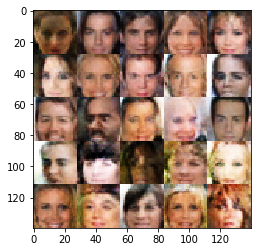

Epoch 1/1... Discriminator Loss: 1.0062... Generator Loss: 0.7458
Epoch 1/1... Discriminator Loss: 1.0314... Generator Loss: 0.7223
Epoch 1/1... Discriminator Loss: 0.5929... Generator Loss: 1.6188
Epoch 1/1... Discriminator Loss: 1.3439... Generator Loss: 0.5099
Epoch 1/1... Discriminator Loss: 1.0554... Generator Loss: 0.7036
Epoch 1/1... Discriminator Loss: 1.2292... Generator Loss: 0.5436
Epoch 1/1... Discriminator Loss: 1.1311... Generator Loss: 0.6014
Epoch 1/1... Discriminator Loss: 1.1976... Generator Loss: 0.5707
Epoch 1/1... Discriminator Loss: 0.7269... Generator Loss: 1.2585
Epoch 1/1... Discriminator Loss: 0.7700... Generator Loss: 1.0457
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


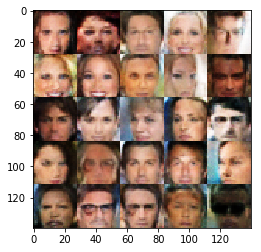

Epoch 1/1... Discriminator Loss: 1.4257... Generator Loss: 0.4272
Epoch 1/1... Discriminator Loss: 1.2775... Generator Loss: 0.6492
Epoch 1/1... Discriminator Loss: 1.9680... Generator Loss: 0.2650
Epoch 1/1... Discriminator Loss: 0.7682... Generator Loss: 1.4697
Epoch 1/1... Discriminator Loss: 0.5628... Generator Loss: 2.0841
Epoch 1/1... Discriminator Loss: 2.0504... Generator Loss: 0.2453
Epoch 1/1... Discriminator Loss: 1.4573... Generator Loss: 0.4134
Epoch 1/1... Discriminator Loss: 0.6853... Generator Loss: 1.2488
Epoch 1/1... Discriminator Loss: 1.0923... Generator Loss: 0.6616
Epoch 1/1... Discriminator Loss: 0.9385... Generator Loss: 0.8159
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


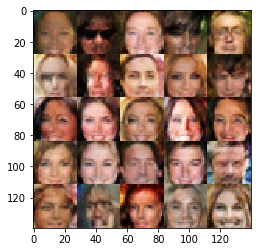

Epoch 1/1... Discriminator Loss: 0.6637... Generator Loss: 1.2720
Epoch 1/1... Discriminator Loss: 1.9721... Generator Loss: 0.2390
Epoch 1/1... Discriminator Loss: 0.8402... Generator Loss: 0.9367
Epoch 1/1... Discriminator Loss: 0.8073... Generator Loss: 1.0514
Epoch 1/1... Discriminator Loss: 0.7085... Generator Loss: 1.2254
Epoch 1/1... Discriminator Loss: 1.9292... Generator Loss: 0.2582
Epoch 1/1... Discriminator Loss: 0.9692... Generator Loss: 0.8367
Epoch 1/1... Discriminator Loss: 1.2750... Generator Loss: 0.5463
Epoch 1/1... Discriminator Loss: 0.9900... Generator Loss: 0.8072
Epoch 1/1... Discriminator Loss: 1.0051... Generator Loss: 0.7418
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


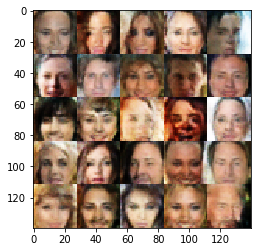

Epoch 1/1... Discriminator Loss: 0.5621... Generator Loss: 1.6468
Epoch 1/1... Discriminator Loss: 1.1167... Generator Loss: 0.6607
Epoch 1/1... Discriminator Loss: 2.0287... Generator Loss: 0.2397
Epoch 1/1... Discriminator Loss: 0.7341... Generator Loss: 1.1526
Epoch 1/1... Discriminator Loss: 1.5124... Generator Loss: 0.4272
Epoch 1/1... Discriminator Loss: 0.9766... Generator Loss: 0.7844
Epoch 1/1... Discriminator Loss: 0.8576... Generator Loss: 0.9729
Epoch 1/1... Discriminator Loss: 0.9882... Generator Loss: 0.8524
Epoch 1/1... Discriminator Loss: 0.6918... Generator Loss: 1.5351
Epoch 1/1... Discriminator Loss: 1.0999... Generator Loss: 0.6329
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


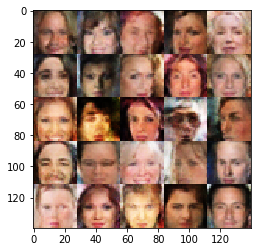

Epoch 1/1... Discriminator Loss: 1.7135... Generator Loss: 0.3355
Epoch 1/1... Discriminator Loss: 1.3390... Generator Loss: 0.4950
Epoch 1/1... Discriminator Loss: 1.0013... Generator Loss: 0.7968
Epoch 1/1... Discriminator Loss: 1.4297... Generator Loss: 0.4803
Epoch 1/1... Discriminator Loss: 0.6404... Generator Loss: 1.3649
Epoch 1/1... Discriminator Loss: 0.7909... Generator Loss: 1.0363
Epoch 1/1... Discriminator Loss: 0.9611... Generator Loss: 0.7918
Epoch 1/1... Discriminator Loss: 2.0764... Generator Loss: 0.2499
Epoch 1/1... Discriminator Loss: 2.3520... Generator Loss: 0.1801
Epoch 1/1... Discriminator Loss: 1.0256... Generator Loss: 0.7119
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


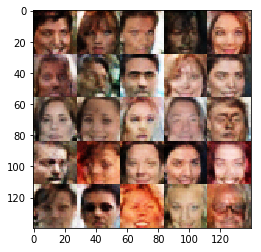

Epoch 1/1... Discriminator Loss: 1.5235... Generator Loss: 0.3994
Epoch 1/1... Discriminator Loss: 1.0232... Generator Loss: 0.7401
Epoch 1/1... Discriminator Loss: 0.7419... Generator Loss: 1.1138
Epoch 1/1... Discriminator Loss: 1.2592... Generator Loss: 0.5542
Epoch 1/1... Discriminator Loss: 1.9654... Generator Loss: 0.2403
Epoch 1/1... Discriminator Loss: 0.9891... Generator Loss: 0.8710
Epoch 1/1... Discriminator Loss: 1.7670... Generator Loss: 0.2960
Epoch 1/1... Discriminator Loss: 1.0678... Generator Loss: 0.6590
Epoch 1/1... Discriminator Loss: 1.2432... Generator Loss: 0.5582
Epoch 1/1... Discriminator Loss: 1.5618... Generator Loss: 0.3786
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


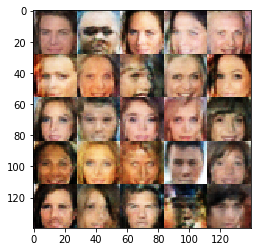

Epoch 1/1... Discriminator Loss: 1.3023... Generator Loss: 0.5338
Epoch 1/1... Discriminator Loss: 0.6938... Generator Loss: 1.2192
Epoch 1/1... Discriminator Loss: 0.6627... Generator Loss: 1.3222
Epoch 1/1... Discriminator Loss: 1.0150... Generator Loss: 0.7519
Epoch 1/1... Discriminator Loss: 0.4872... Generator Loss: 2.2625
Epoch 1/1... Discriminator Loss: 0.9720... Generator Loss: 0.8136
Epoch 1/1... Discriminator Loss: 0.5179... Generator Loss: 1.9160
Epoch 1/1... Discriminator Loss: 0.7767... Generator Loss: 1.1035
Epoch 1/1... Discriminator Loss: 2.0388... Generator Loss: 0.2469
Epoch 1/1... Discriminator Loss: 0.5125... Generator Loss: 1.9388
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


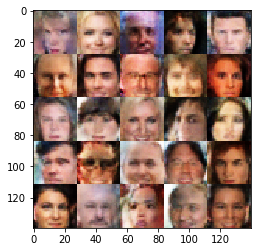

Epoch 1/1... Discriminator Loss: 2.1899... Generator Loss: 0.1953
Epoch 1/1... Discriminator Loss: 1.1897... Generator Loss: 0.6474
Epoch 1/1... Discriminator Loss: 1.1865... Generator Loss: 0.5742
Epoch 1/1... Discriminator Loss: 0.6176... Generator Loss: 1.5376
Epoch 1/1... Discriminator Loss: 2.1827... Generator Loss: 0.1955
Epoch 1/1... Discriminator Loss: 1.7569... Generator Loss: 0.3121
Epoch 1/1... Discriminator Loss: 0.8111... Generator Loss: 0.9763
Epoch 1/1... Discriminator Loss: 1.5645... Generator Loss: 0.3807
Epoch 1/1... Discriminator Loss: 2.1100... Generator Loss: 0.2033
Epoch 1/1... Discriminator Loss: 0.8173... Generator Loss: 0.9668
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


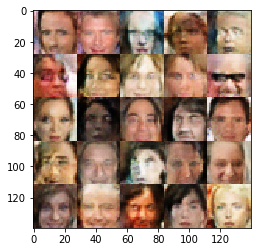

Epoch 1/1... Discriminator Loss: 0.8109... Generator Loss: 1.0150
Epoch 1/1... Discriminator Loss: 0.9490... Generator Loss: 0.9393
Epoch 1/1... Discriminator Loss: 1.2807... Generator Loss: 0.5206
Epoch 1/1... Discriminator Loss: 1.4907... Generator Loss: 0.4803
Epoch 1/1... Discriminator Loss: 0.6283... Generator Loss: 1.4891
Epoch 1/1... Discriminator Loss: 0.7971... Generator Loss: 1.0444
Epoch 1/1... Discriminator Loss: 1.0651... Generator Loss: 0.6972
Epoch 1/1... Discriminator Loss: 0.5502... Generator Loss: 2.0580
Epoch 1/1... Discriminator Loss: 1.4942... Generator Loss: 0.3903
Epoch 1/1... Discriminator Loss: 1.2165... Generator Loss: 0.6150
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


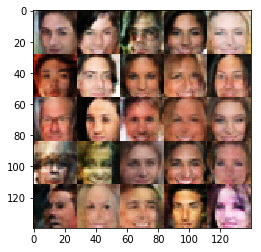

Epoch 1/1... Discriminator Loss: 1.2527... Generator Loss: 0.5330
Epoch 1/1... Discriminator Loss: 0.6077... Generator Loss: 1.4921
Epoch 1/1... Discriminator Loss: 0.8067... Generator Loss: 0.9914
Epoch 1/1... Discriminator Loss: 2.1308... Generator Loss: 0.2015
Epoch 1/1... Discriminator Loss: 0.5551... Generator Loss: 1.9254
Epoch 1/1... Discriminator Loss: 0.7449... Generator Loss: 1.2858
Epoch 1/1... Discriminator Loss: 1.3030... Generator Loss: 0.5212
Epoch 1/1... Discriminator Loss: 1.6078... Generator Loss: 0.3426
Epoch 1/1... Discriminator Loss: 1.0412... Generator Loss: 0.7386
Epoch 1/1... Discriminator Loss: 1.6911... Generator Loss: 0.3207
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


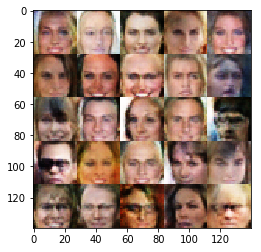

Epoch 1/1... Discriminator Loss: 0.8120... Generator Loss: 0.9822
Epoch 1/1... Discriminator Loss: 1.4128... Generator Loss: 0.5086
Epoch 1/1... Discriminator Loss: 0.5807... Generator Loss: 2.7329
Epoch 1/1... Discriminator Loss: 0.9255... Generator Loss: 0.8576
Epoch 1/1... Discriminator Loss: 0.9299... Generator Loss: 0.9162
Epoch 1/1... Discriminator Loss: 0.6503... Generator Loss: 1.4491
Epoch 1/1... Discriminator Loss: 1.0140... Generator Loss: 0.8221
Epoch 1/1... Discriminator Loss: 0.9905... Generator Loss: 0.7956
Epoch 1/1... Discriminator Loss: 1.4943... Generator Loss: 0.3970
Epoch 1/1... Discriminator Loss: 1.5219... Generator Loss: 0.3899
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


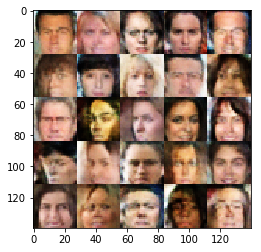

Epoch 1/1... Discriminator Loss: 0.5321... Generator Loss: 1.7805
Epoch 1/1... Discriminator Loss: 1.1366... Generator Loss: 0.6705
Epoch 1/1... Discriminator Loss: 0.9246... Generator Loss: 0.8341
Epoch 1/1... Discriminator Loss: 0.9283... Generator Loss: 0.8580
Epoch 1/1... Discriminator Loss: 0.5809... Generator Loss: 1.5759
Epoch 1/1... Discriminator Loss: 2.7952... Generator Loss: 0.1084
Epoch 1/1... Discriminator Loss: 1.1705... Generator Loss: 0.5766
Epoch 1/1... Discriminator Loss: 0.8329... Generator Loss: 0.9589
Epoch 1/1... Discriminator Loss: 0.5680... Generator Loss: 1.7640
Epoch 1/1... Discriminator Loss: 1.2497... Generator Loss: 0.5176
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


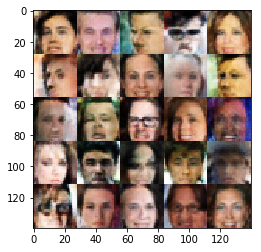

Epoch 1/1... Discriminator Loss: 1.8588... Generator Loss: 0.2909
Epoch 1/1... Discriminator Loss: 1.4567... Generator Loss: 0.4225
Epoch 1/1... Discriminator Loss: 1.1634... Generator Loss: 0.5897
Epoch 1/1... Discriminator Loss: 1.8400... Generator Loss: 0.2771
Epoch 1/1... Discriminator Loss: 0.7317... Generator Loss: 1.1762
Epoch 1/1... Discriminator Loss: 1.3771... Generator Loss: 0.4718
Epoch 1/1... Discriminator Loss: 1.0423... Generator Loss: 0.7138
Epoch 1/1... Discriminator Loss: 0.6362... Generator Loss: 1.8302
Epoch 1/1... Discriminator Loss: 1.2997... Generator Loss: 0.4825
Epoch 1/1... Discriminator Loss: 1.9551... Generator Loss: 0.2868
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


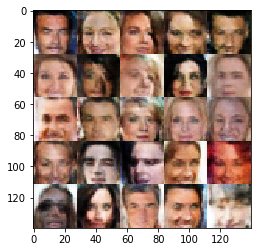

Epoch 1/1... Discriminator Loss: 0.4236... Generator Loss: 3.1132
Epoch 1/1... Discriminator Loss: 1.5948... Generator Loss: 0.3779
Epoch 1/1... Discriminator Loss: 0.8590... Generator Loss: 0.9322
Epoch 1/1... Discriminator Loss: 0.6000... Generator Loss: 1.4870
Epoch 1/1... Discriminator Loss: 1.3024... Generator Loss: 0.4951
Epoch 1/1... Discriminator Loss: 1.0618... Generator Loss: 0.6833
Epoch 1/1... Discriminator Loss: 1.1414... Generator Loss: 0.6381
Epoch 1/1... Discriminator Loss: 1.5459... Generator Loss: 0.3722
Epoch 1/1... Discriminator Loss: 0.7179... Generator Loss: 1.2968
Epoch 1/1... Discriminator Loss: 1.4991... Generator Loss: 0.4658
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


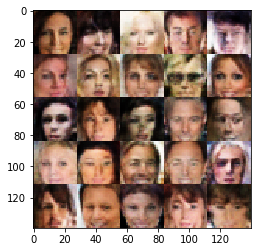

Epoch 1/1... Discriminator Loss: 0.7794... Generator Loss: 1.1783
Epoch 1/1... Discriminator Loss: 1.7786... Generator Loss: 0.2851
Epoch 1/1... Discriminator Loss: 0.6793... Generator Loss: 1.2653
Epoch 1/1... Discriminator Loss: 1.3169... Generator Loss: 0.4821
Epoch 1/1... Discriminator Loss: 1.3575... Generator Loss: 0.4661
Epoch 1/1... Discriminator Loss: 0.7027... Generator Loss: 1.1765
Epoch 1/1... Discriminator Loss: 0.7589... Generator Loss: 1.0920
Epoch 1/1... Discriminator Loss: 0.5925... Generator Loss: 1.7008
Epoch 1/1... Discriminator Loss: 0.8775... Generator Loss: 0.9078
Epoch 1/1... Discriminator Loss: 1.0207... Generator Loss: 0.7016
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


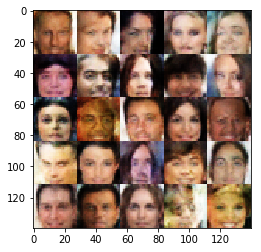

Epoch 1/1... Discriminator Loss: 1.0910... Generator Loss: 0.6622
Epoch 1/1... Discriminator Loss: 1.9651... Generator Loss: 0.2489
Epoch 1/1... Discriminator Loss: 1.6294... Generator Loss: 0.3618
Epoch 1/1... Discriminator Loss: 1.2222... Generator Loss: 0.6441
Epoch 1/1... Discriminator Loss: 0.7166... Generator Loss: 1.2452
Epoch 1/1... Discriminator Loss: 0.7230... Generator Loss: 1.1766
Epoch 1/1... Discriminator Loss: 1.1893... Generator Loss: 0.6234
Epoch 1/1... Discriminator Loss: 0.6106... Generator Loss: 1.5114
Epoch 1/1... Discriminator Loss: 0.8389... Generator Loss: 0.9598
Epoch 1/1... Discriminator Loss: 1.2726... Generator Loss: 0.5013
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


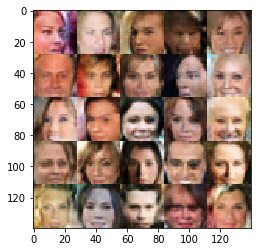

Epoch 1/1... Discriminator Loss: 2.3214... Generator Loss: 0.1874
Epoch 1/1... Discriminator Loss: 0.7347... Generator Loss: 1.1581
Epoch 1/1... Discriminator Loss: 0.5068... Generator Loss: 2.3502
Epoch 1/1... Discriminator Loss: 0.7710... Generator Loss: 1.0955
Epoch 1/1... Discriminator Loss: 0.6468... Generator Loss: 1.4178
Epoch 1/1... Discriminator Loss: 0.9108... Generator Loss: 0.8392
Epoch 1/1... Discriminator Loss: 1.9023... Generator Loss: 0.2782
Epoch 1/1... Discriminator Loss: 1.0773... Generator Loss: 0.6785
Epoch 1/1... Discriminator Loss: 1.0171... Generator Loss: 0.7404
Epoch 1/1... Discriminator Loss: 1.0977... Generator Loss: 0.6526
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


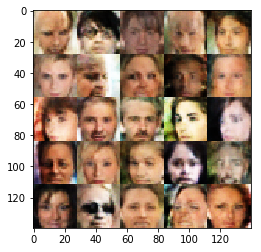

Epoch 1/1... Discriminator Loss: 1.8772... Generator Loss: 0.2749
Epoch 1/1... Discriminator Loss: 0.6669... Generator Loss: 1.3684
Epoch 1/1... Discriminator Loss: 0.7946... Generator Loss: 1.2190
Epoch 1/1... Discriminator Loss: 0.7754... Generator Loss: 1.0716
Epoch 1/1... Discriminator Loss: 1.0986... Generator Loss: 0.6488
Epoch 1/1... Discriminator Loss: 1.2722... Generator Loss: 0.5190
Epoch 1/1... Discriminator Loss: 0.5584... Generator Loss: 1.6674
Epoch 1/1... Discriminator Loss: 1.5876... Generator Loss: 0.3899
Epoch 1/1... Discriminator Loss: 0.6117... Generator Loss: 1.9618
Epoch 1/1... Discriminator Loss: 0.5974... Generator Loss: 1.4844
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


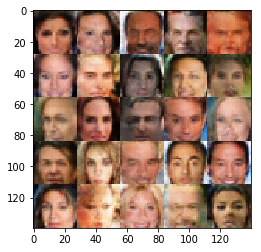

Epoch 1/1... Discriminator Loss: 0.8615... Generator Loss: 0.8993
Epoch 1/1... Discriminator Loss: 0.7498... Generator Loss: 1.2290
Epoch 1/1... Discriminator Loss: 1.1464... Generator Loss: 0.6019
Epoch 1/1... Discriminator Loss: 1.5595... Generator Loss: 0.4273
Epoch 1/1... Discriminator Loss: 1.7705... Generator Loss: 0.3690
Epoch 1/1... Discriminator Loss: 0.8767... Generator Loss: 0.9297
Epoch 1/1... Discriminator Loss: 0.7809... Generator Loss: 1.1089
Epoch 1/1... Discriminator Loss: 1.3226... Generator Loss: 0.5002
Epoch 1/1... Discriminator Loss: 1.0208... Generator Loss: 0.7748
Epoch 1/1... Discriminator Loss: 0.8330... Generator Loss: 0.9744
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


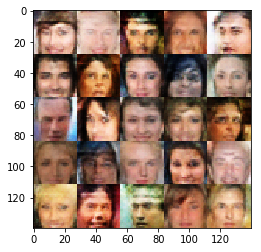

Epoch 1/1... Discriminator Loss: 1.9285... Generator Loss: 0.2839
Epoch 1/1... Discriminator Loss: 1.0394... Generator Loss: 0.7680
Epoch 1/1... Discriminator Loss: 0.5418... Generator Loss: 1.8182
Epoch 1/1... Discriminator Loss: 2.0693... Generator Loss: 0.2676
Epoch 1/1... Discriminator Loss: 1.1081... Generator Loss: 0.7437
Epoch 1/1... Discriminator Loss: 0.5499... Generator Loss: 2.1074
Epoch 1/1... Discriminator Loss: 0.7765... Generator Loss: 1.0994
Epoch 1/1... Discriminator Loss: 0.7956... Generator Loss: 0.9976
Epoch 1/1... Discriminator Loss: 0.9927... Generator Loss: 0.7666
Epoch 1/1... Discriminator Loss: 0.9956... Generator Loss: 0.7994
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


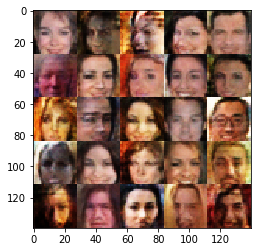

Epoch 1/1... Discriminator Loss: 1.0861... Generator Loss: 0.6607
Epoch 1/1... Discriminator Loss: 0.8977... Generator Loss: 0.9009
Epoch 1/1... Discriminator Loss: 0.8405... Generator Loss: 1.1374
Epoch 1/1... Discriminator Loss: 0.7467... Generator Loss: 1.1335
Epoch 1/1... Discriminator Loss: 0.6200... Generator Loss: 1.7763
Epoch 1/1... Discriminator Loss: 0.5388... Generator Loss: 1.8469
Epoch 1/1... Discriminator Loss: 1.6195... Generator Loss: 0.3691
Epoch 1/1... Discriminator Loss: 0.8180... Generator Loss: 0.9677
Epoch 1/1... Discriminator Loss: 2.0256... Generator Loss: 0.2098
Epoch 1/1... Discriminator Loss: 1.0471... Generator Loss: 0.7504
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


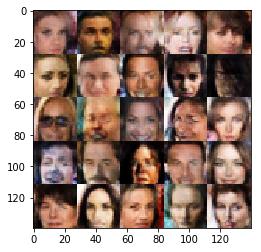

Epoch 1/1... Discriminator Loss: 0.7658... Generator Loss: 1.1049
Epoch 1/1... Discriminator Loss: 0.9765... Generator Loss: 0.8184
Epoch 1/1... Discriminator Loss: 1.1450... Generator Loss: 0.6169
Epoch 1/1... Discriminator Loss: 1.4619... Generator Loss: 0.4103
Epoch 1/1... Discriminator Loss: 0.6288... Generator Loss: 1.5181
Epoch 1/1... Discriminator Loss: 0.6184... Generator Loss: 2.1619
Epoch 1/1... Discriminator Loss: 0.4838... Generator Loss: 2.2755
Epoch 1/1... Discriminator Loss: 0.5924... Generator Loss: 1.4924
Epoch 1/1... Discriminator Loss: 1.7852... Generator Loss: 0.2849
Epoch 1/1... Discriminator Loss: 0.7200... Generator Loss: 1.1517
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


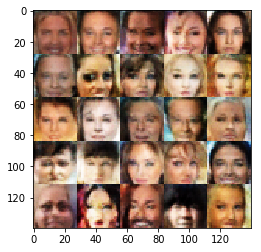

Epoch 1/1... Discriminator Loss: 0.5533... Generator Loss: 1.6700
Epoch 1/1... Discriminator Loss: 0.6316... Generator Loss: 1.3600
Epoch 1/1... Discriminator Loss: 0.7932... Generator Loss: 1.5807
Epoch 1/1... Discriminator Loss: 1.2274... Generator Loss: 0.5853
Epoch 1/1... Discriminator Loss: 1.0808... Generator Loss: 0.6793
Epoch 1/1... Discriminator Loss: 1.6869... Generator Loss: 0.3485
Epoch 1/1... Discriminator Loss: 1.0539... Generator Loss: 0.7274
Epoch 1/1... Discriminator Loss: 0.9618... Generator Loss: 0.7979
Epoch 1/1... Discriminator Loss: 1.9167... Generator Loss: 0.2658
Epoch 1/1... Discriminator Loss: 0.8120... Generator Loss: 0.9730
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


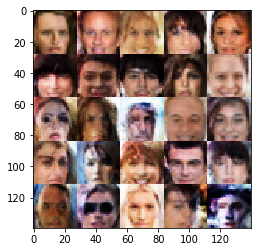

Epoch 1/1... Discriminator Loss: 0.6835... Generator Loss: 1.3256
Epoch 1/1... Discriminator Loss: 0.9552... Generator Loss: 0.8024
Epoch 1/1... Discriminator Loss: 1.6633... Generator Loss: 0.3465
Epoch 1/1... Discriminator Loss: 1.1163... Generator Loss: 0.6654
Epoch 1/1... Discriminator Loss: 1.2534... Generator Loss: 0.5261
Epoch 1/1... Discriminator Loss: 0.7129... Generator Loss: 1.2199
Epoch 1/1... Discriminator Loss: 0.6634... Generator Loss: 1.3005
Epoch 1/1... Discriminator Loss: 0.7129... Generator Loss: 1.2034
Epoch 1/1... Discriminator Loss: 0.6852... Generator Loss: 1.3185
Epoch 1/1... Discriminator Loss: 0.8602... Generator Loss: 0.9495
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


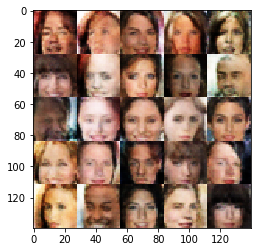

Epoch 1/1... Discriminator Loss: 0.7939... Generator Loss: 1.0309
Epoch 1/1... Discriminator Loss: 0.8141... Generator Loss: 1.0195
Epoch 1/1... Discriminator Loss: 0.6456... Generator Loss: 1.4777
Epoch 1/1... Discriminator Loss: 0.6943... Generator Loss: 1.7367
Epoch 1/1... Discriminator Loss: 0.6418... Generator Loss: 1.4441
Epoch 1/1... Discriminator Loss: 1.1930... Generator Loss: 0.5777
Epoch 1/1... Discriminator Loss: 1.1160... Generator Loss: 0.6489
Epoch 1/1... Discriminator Loss: 1.2680... Generator Loss: 0.5643
Epoch 1/1... Discriminator Loss: 0.7230... Generator Loss: 1.1373
Epoch 1/1... Discriminator Loss: 1.1489... Generator Loss: 0.5949
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


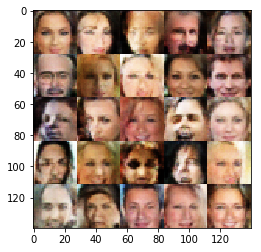

Epoch 1/1... Discriminator Loss: 0.7329... Generator Loss: 1.1730
Epoch 1/1... Discriminator Loss: 2.2171... Generator Loss: 0.2000
Epoch 1/1... Discriminator Loss: 0.6460... Generator Loss: 1.5285
Epoch 1/1... Discriminator Loss: 1.5510... Generator Loss: 0.3739
Epoch 1/1... Discriminator Loss: 0.4975... Generator Loss: 2.0458
Epoch 1/1... Discriminator Loss: 0.8172... Generator Loss: 1.0139
Epoch 1/1... Discriminator Loss: 0.6628... Generator Loss: 1.3106
Epoch 1/1... Discriminator Loss: 0.6959... Generator Loss: 1.9905
Epoch 1/1... Discriminator Loss: 0.4185... Generator Loss: 3.0743
Epoch 1/1... Discriminator Loss: 0.5460... Generator Loss: 1.7651
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


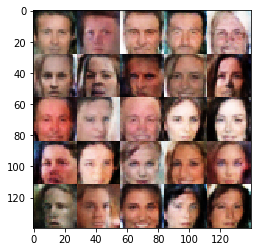

Epoch 1/1... Discriminator Loss: 1.1849... Generator Loss: 0.5690
Epoch 1/1... Discriminator Loss: 1.1178... Generator Loss: 0.6220
Epoch 1/1... Discriminator Loss: 1.2918... Generator Loss: 0.5352
Epoch 1/1... Discriminator Loss: 0.4093... Generator Loss: 2.9658
Epoch 1/1... Discriminator Loss: 1.1244... Generator Loss: 0.6217
Epoch 1/1... Discriminator Loss: 1.5461... Generator Loss: 0.4017
Epoch 1/1... Discriminator Loss: 1.4737... Generator Loss: 0.4161
Epoch 1/1... Discriminator Loss: 1.9919... Generator Loss: 0.2651
Epoch 1/1... Discriminator Loss: 1.7899... Generator Loss: 0.3039
Epoch 1/1... Discriminator Loss: 0.5550... Generator Loss: 2.1075
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


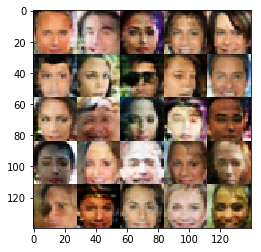

Epoch 1/1... Discriminator Loss: 1.1504... Generator Loss: 0.6446
Epoch 1/1... Discriminator Loss: 0.8372... Generator Loss: 0.9671
Epoch 1/1... Discriminator Loss: 1.0746... Generator Loss: 0.6720
Epoch 1/1... Discriminator Loss: 1.4282... Generator Loss: 0.4232
Epoch 1/1... Discriminator Loss: 1.1125... Generator Loss: 0.6775
Epoch 1/1... Discriminator Loss: 1.2942... Generator Loss: 0.5293
Epoch 1/1... Discriminator Loss: 0.7693... Generator Loss: 1.0553
Epoch 1/1... Discriminator Loss: 1.7668... Generator Loss: 0.2932
Epoch 1/1... Discriminator Loss: 0.7953... Generator Loss: 1.0709
Epoch 1/1... Discriminator Loss: 1.0613... Generator Loss: 0.7294
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


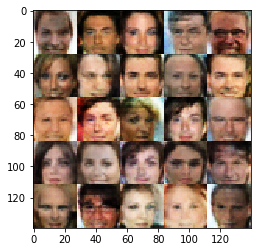

Epoch 1/1... Discriminator Loss: 1.4769... Generator Loss: 0.5133
Epoch 1/1... Discriminator Loss: 0.6779... Generator Loss: 2.9102
Epoch 1/1... Discriminator Loss: 0.8851... Generator Loss: 0.9516
Epoch 1/1... Discriminator Loss: 1.6009... Generator Loss: 0.3741
Epoch 1/1... Discriminator Loss: 1.3597... Generator Loss: 0.4690
Epoch 1/1... Discriminator Loss: 0.8418... Generator Loss: 0.9568
Epoch 1/1... Discriminator Loss: 1.8823... Generator Loss: 0.3224
Epoch 1/1... Discriminator Loss: 0.9081... Generator Loss: 0.8545
Epoch 1/1... Discriminator Loss: 0.5431... Generator Loss: 1.7627
Epoch 1/1... Discriminator Loss: 0.7443... Generator Loss: 1.1441
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


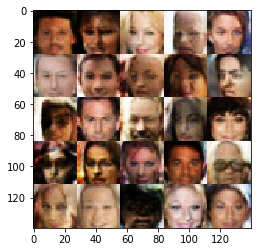

Epoch 1/1... Discriminator Loss: 1.3997... Generator Loss: 0.4522
Epoch 1/1... Discriminator Loss: 1.0385... Generator Loss: 0.7147
Epoch 1/1... Discriminator Loss: 0.9242... Generator Loss: 0.8296
Epoch 1/1... Discriminator Loss: 1.2278... Generator Loss: 0.5927
Epoch 1/1... Discriminator Loss: 0.6410... Generator Loss: 1.3453
Epoch 1/1... Discriminator Loss: 0.6410... Generator Loss: 1.4069
Epoch 1/1... Discriminator Loss: 0.7296... Generator Loss: 1.1594
Epoch 1/1... Discriminator Loss: 0.7484... Generator Loss: 1.1018
Epoch 1/1... Discriminator Loss: 1.6924... Generator Loss: 0.3265
Epoch 1/1... Discriminator Loss: 0.7365... Generator Loss: 1.4118
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


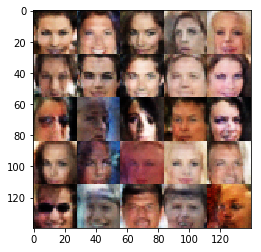

Epoch 1/1... Discriminator Loss: 1.8765... Generator Loss: 0.2630
Epoch 1/1... Discriminator Loss: 1.0933... Generator Loss: 0.6493
Epoch 1/1... Discriminator Loss: 1.2429... Generator Loss: 0.5448
Epoch 1/1... Discriminator Loss: 0.9108... Generator Loss: 0.8570
Epoch 1/1... Discriminator Loss: 0.8701... Generator Loss: 0.9411
Epoch 1/1... Discriminator Loss: 0.8181... Generator Loss: 1.0787
Epoch 1/1... Discriminator Loss: 1.6807... Generator Loss: 0.3597
Epoch 1/1... Discriminator Loss: 1.0481... Generator Loss: 0.6923
Epoch 1/1... Discriminator Loss: 0.4877... Generator Loss: 2.1054
Epoch 1/1... Discriminator Loss: 0.7221... Generator Loss: 1.2957
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


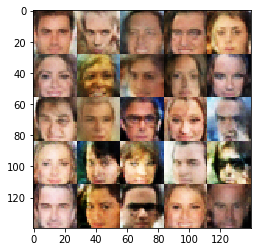

Epoch 1/1... Discriminator Loss: 0.9355... Generator Loss: 0.8848
Epoch 1/1... Discriminator Loss: 0.9478... Generator Loss: 0.9252
Epoch 1/1... Discriminator Loss: 1.1812... Generator Loss: 0.6738
Epoch 1/1... Discriminator Loss: 0.6725... Generator Loss: 1.3344
Epoch 1/1... Discriminator Loss: 0.7734... Generator Loss: 1.1057
Epoch 1/1... Discriminator Loss: 1.3460... Generator Loss: 0.4802
Epoch 1/1... Discriminator Loss: 0.5468... Generator Loss: 1.6961
Epoch 1/1... Discriminator Loss: 0.6476... Generator Loss: 1.5812
Epoch 1/1... Discriminator Loss: 0.9211... Generator Loss: 0.9762
Epoch 1/1... Discriminator Loss: 0.6589... Generator Loss: 1.3698
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


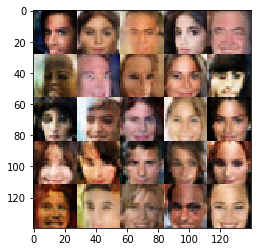

Epoch 1/1... Discriminator Loss: 0.5746... Generator Loss: 1.6019
Epoch 1/1... Discriminator Loss: 1.1821... Generator Loss: 0.6580
Epoch 1/1... Discriminator Loss: 1.9106... Generator Loss: 0.2658
Epoch 1/1... Discriminator Loss: 0.9629... Generator Loss: 0.9111
Epoch 1/1... Discriminator Loss: 0.9728... Generator Loss: 0.8382
Epoch 1/1... Discriminator Loss: 1.2963... Generator Loss: 0.5974
Epoch 1/1... Discriminator Loss: 0.7339... Generator Loss: 1.1293
Epoch 1/1... Discriminator Loss: 0.5375... Generator Loss: 1.8154
Epoch 1/1... Discriminator Loss: 1.4118... Generator Loss: 0.4834
Epoch 1/1... Discriminator Loss: 0.7238... Generator Loss: 1.4479
(?, 100)
(?, 2048)
(?, 2, 2, 512)
(?, 7, 7, 256)
(?, 14, 14, 128)
(?, 28, 28, 3)


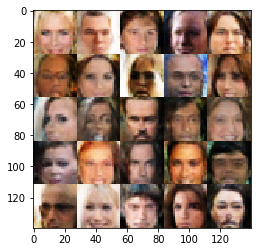

Epoch 1/1... Discriminator Loss: 0.7381... Generator Loss: 1.1421
Epoch 1/1... Discriminator Loss: 1.3849... Generator Loss: 0.4940
Epoch 1/1... Discriminator Loss: 0.7147... Generator Loss: 1.2035


In [101]:
batch_size = 8
z_dim = 100
learning_rate = .0001
beta1 = .1


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.